# 1. Importing the necessary libraries for analysis and visualizations

In [1]:
# importing the necessary libraries for analysis and visualizations
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns
import math
from datetime import datetime
import matplotlib.dates as mdates
from dateutil.relativedelta import relativedelta
from sklearn.preprocessing import MinMaxScaler
import copy

import warnings
warnings.filterwarnings("ignore")

# 2. Reading the data and preprocessing

In [2]:
# reading the data to a dataframe
df = pd.read_csv('all_ticks_wide.csv')

# converting to pd datetime
df['timestamp'] = pd.to_datetime(df['timestamp'])

# getting year, month, day as features
df['year'] = df['timestamp'].dt.year
df['month'] = df['timestamp'].dt.month
df['day'] = df['timestamp'].dt.day

df

,timestamp,AEFES,AKBNK,AKSA,AKSEN,ALARK,ALBRK,ANACM,ARCLK,ASELS,...,USAK,VAKBN,VESTL,YATAS,YKBNK,YUNSA,ZOREN,year,month,day
0,2012-09-17 06:45:00+00:00,22.3978,5.2084,1.7102,3.87,1.4683,1.1356,1.0634,6.9909,2.9948,...,1.0382,3.8620,1.90,0.4172,2.5438,2.2619,0.7789,2012,9,17
1,2012-09-17 07:00:00+00:00,22.3978,5.1938,1.7066,3.86,1.4574,1.1275,1.0634,6.9259,2.9948,...,1.0382,3.8529,1.90,0.4229,2.5266,2.2462,0.7789,2012,9,17
2,2012-09-17 07:15:00+00:00,22.3978,5.2084,1.7102,NaN,1.4610,1.1356,1.0679,6.9909,2.9855,...,1.0463,3.8436,1.91,0.4229,2.5266,2.2566,0.7789,2012,9,17
3,2012-09-17 07:30:00+00:00,22.3978,5.1938,1.7102,3.86,1.4537,1.1275,1.0679,6.9584,2.9855,...,1.0382,3.8529,1.91,0.4286,2.5324,2.2619,0.7860,2012,9,17
4,2012-09-17 07:45:00+00:00,22.5649,5.2084,1.7102,3.87,1.4574,1.1356,1.0725,6.9909,2.9760,...,1.0382,3.8620,1.90,0.4286,2.5324,2.2619,0.7789,2012,9,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50007,2019-07-23 14:00:00+00:00,20.4800,7.7300,9.1400,2.47,3.2300,1.2100,2.8400,20.3000,NaN,...,1.0500,4.8600,9.98,5.3500,2.7500,4.2500,NaN,2019,7,23
50008,2019-07-23 14:15:00+00:00,20.5000,7.7200,9.1400,2.47,3.2200,1.2100,2.8400,20.3200,NaN,...,1.0500,4.8600,9.98,5.3400,2.7500,4.2400,NaN,2019,7,23
50009,2019-07-23 14:30:00+00:00,20.5000,7.7400,9.1300,2.46,3.2300,1.2100,2.8300,20.3400,NaN,...,1.0500,4.8600,9.96,5.3400,2.7600,4.2400,NaN,2019,7,23
50010,2019-07-23 14:45:00+00:00,20.4000,7.7000,9.1400,2.47,3.2400,1.2100,2.8200,20.3800,NaN,...,1.0400,4.8600,9.94,5.3400,2.7700,4.2400,NaN,2019,7,23


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50012 entries, 0 to 50011
Data columns (total 64 columns):
 #   Column     Non-Null Count  Dtype              
---  ------     --------------  -----              
 0   timestamp  50012 non-null  datetime64[ns, UTC]
 1   AEFES      48131 non-null  float64            
 2   AKBNK      49209 non-null  float64            
 3   AKSA       48594 non-null  float64            
 4   AKSEN      48171 non-null  float64            
 5   ALARK      48335 non-null  float64            
 6   ALBRK      46862 non-null  float64            
 7   ANACM      48165 non-null  float64            
 8   ARCLK      49045 non-null  float64            
 9   ASELS      48803 non-null  float64            
 10  ASUZU      48433 non-null  float64            
 11  AYGAZ      48119 non-null  float64            
 12  BAGFS      48650 non-null  float64            
 13  BANVT      47951 non-null  float64            
 14  BRISA      48937 non-null  float64            
 15  CC

In [4]:
# function to fill null values
# it takes the 
def fill_null_values_with_average(df, timestamp):
    filled_df = df.copy()
    other_columns = list(filled_df.columns.difference([timestamp]))
    for column in other_columns:
        # creating a mask for NaN values in the column
        null_mask = filled_df[column].isnull()
        # finding the first non-null value before each NaN
        before = filled_df[column].where(~null_mask).ffill()
        # finding the first non-null value after each NaN
        after = filled_df[column].where(~null_mask[::-1]).bfill()[::-1]
        # taking the average of them
        average = (before + after) / 2
        # filling the nan
        filled_df[column].fillna(average, inplace=True)
    return filled_df

# filling the nan
filled_df = fill_null_values_with_average(df, 'timestamp')
filled_df

,timestamp,AEFES,AKBNK,AKSA,AKSEN,ALARK,ALBRK,ANACM,ARCLK,ASELS,...,USAK,VAKBN,VESTL,YATAS,YKBNK,YUNSA,ZOREN,year,month,day
0,2012-09-17 06:45:00+00:00,22.3978,5.2084,1.7102,3.87,1.4683,1.1356,1.0634,6.9909,2.9948,...,1.0382,3.8620,1.90,0.4172,2.5438,2.2619,0.7789,2012,9,17
1,2012-09-17 07:00:00+00:00,22.3978,5.1938,1.7066,3.86,1.4574,1.1275,1.0634,6.9259,2.9948,...,1.0382,3.8529,1.90,0.4229,2.5266,2.2462,0.7789,2012,9,17
2,2012-09-17 07:15:00+00:00,22.3978,5.2084,1.7102,3.86,1.4610,1.1356,1.0679,6.9909,2.9855,...,1.0463,3.8436,1.91,0.4229,2.5266,2.2566,0.7789,2012,9,17
3,2012-09-17 07:30:00+00:00,22.3978,5.1938,1.7102,3.86,1.4537,1.1275,1.0679,6.9584,2.9855,...,1.0382,3.8529,1.91,0.4286,2.5324,2.2619,0.7860,2012,9,17
4,2012-09-17 07:45:00+00:00,22.5649,5.2084,1.7102,3.87,1.4574,1.1356,1.0725,6.9909,2.9760,...,1.0382,3.8620,1.90,0.4286,2.5324,2.2619,0.7789,2012,9,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50007,2019-07-23 14:00:00+00:00,20.4800,7.7300,9.1400,2.47,3.2300,1.2100,2.8400,20.3000,NaN,...,1.0500,4.8600,9.98,5.3500,2.7500,4.2500,NaN,2019,7,23
50008,2019-07-23 14:15:00+00:00,20.5000,7.7200,9.1400,2.47,3.2200,1.2100,2.8400,20.3200,NaN,...,1.0500,4.8600,9.98,5.3400,2.7500,4.2400,NaN,2019,7,23
50009,2019-07-23 14:30:00+00:00,20.5000,7.7400,9.1300,2.46,3.2300,1.2100,2.8300,20.3400,NaN,...,1.0500,4.8600,9.96,5.3400,2.7600,4.2400,NaN,2019,7,23
50010,2019-07-23 14:45:00+00:00,20.4000,7.7000,9.1400,2.47,3.2400,1.2100,2.8200,20.3800,NaN,...,1.0400,4.8600,9.94,5.3400,2.7700,4.2400,NaN,2019,7,23


In [5]:
# info about number of outliers
filled_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50012 entries, 0 to 50011
Data columns (total 64 columns):
 #   Column     Non-Null Count  Dtype              
---  ------     --------------  -----              
 0   timestamp  50012 non-null  datetime64[ns, UTC]
 1   AEFES      50012 non-null  float64            
 2   AKBNK      50012 non-null  float64            
 3   AKSA       50012 non-null  float64            
 4   AKSEN      50012 non-null  float64            
 5   ALARK      50012 non-null  float64            
 6   ALBRK      50012 non-null  float64            
 7   ANACM      50012 non-null  float64            
 8   ARCLK      50012 non-null  float64            
 9   ASELS      49982 non-null  float64            
 10  ASUZU      50012 non-null  float64            
 11  AYGAZ      50012 non-null  float64            
 12  BAGFS      50012 non-null  float64            
 13  BANVT      50012 non-null  float64            
 14  BRISA      50012 non-null  float64            
 15  CC

# 3. Analysis
Now, we will select 6 stock indexes from 3 different sectors, preferably with non-null entries in the interval **15/01/2017 - 15/01/2019** . Let's consider 
* AKBNK 
* VAKBN
* ARCLK
* TUPRS
* TCELL
* THYAO



## 3.1. Control Charts

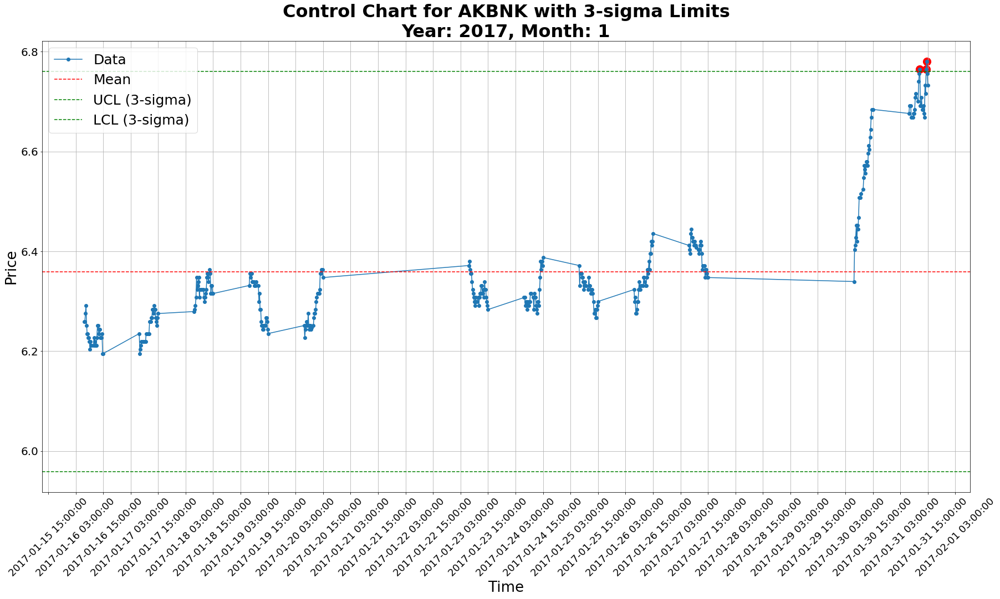

Outliers for AKBNK:
Timestamp: 2017-01-31 11:30:00+00:00, Price: 6.7643
Timestamp: 2017-01-31 14:15:00+00:00, Price: 6.7643
Timestamp: 2017-01-31 14:30:00+00:00, Price: 6.7803


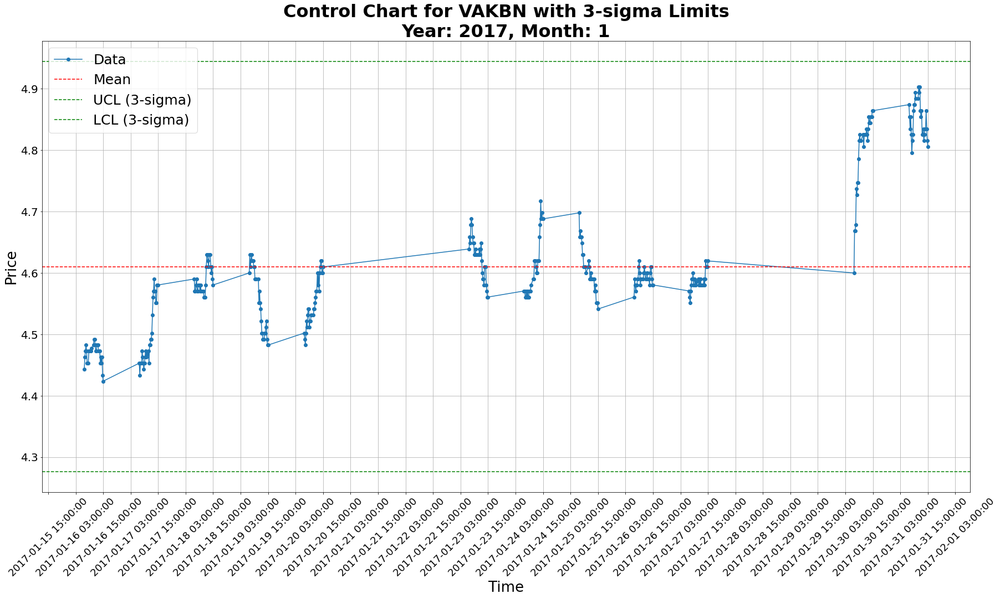

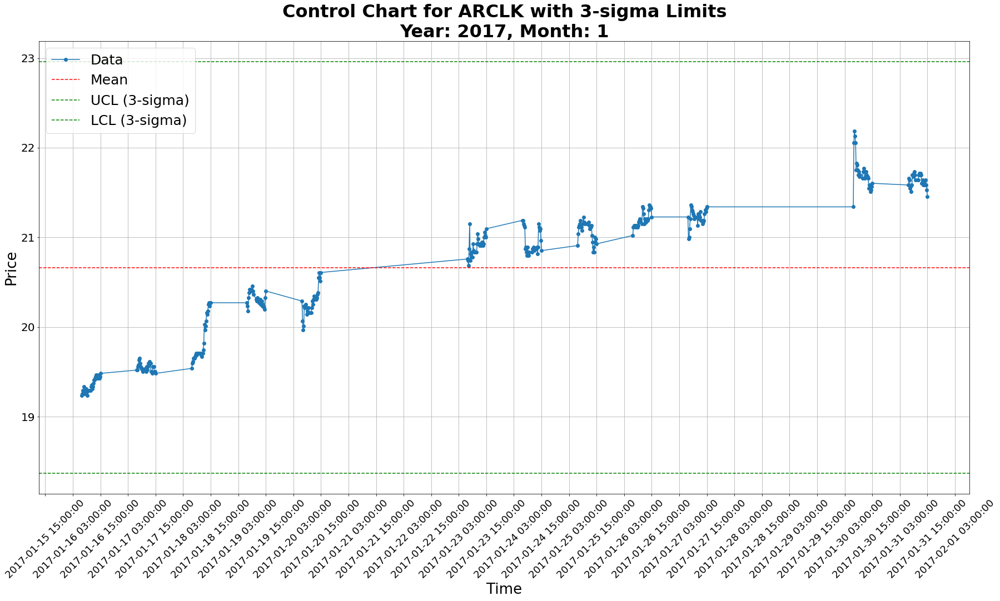

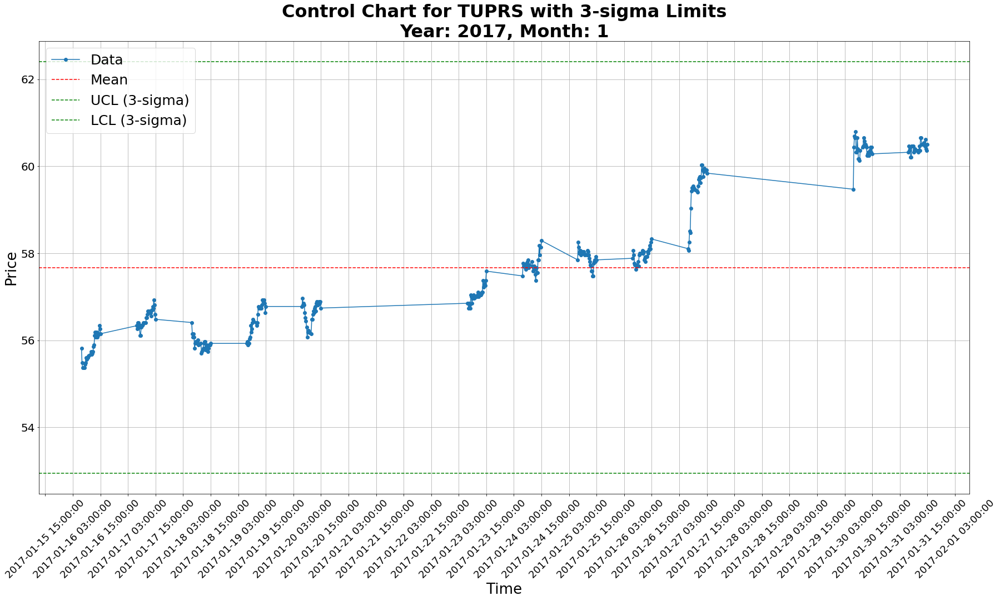

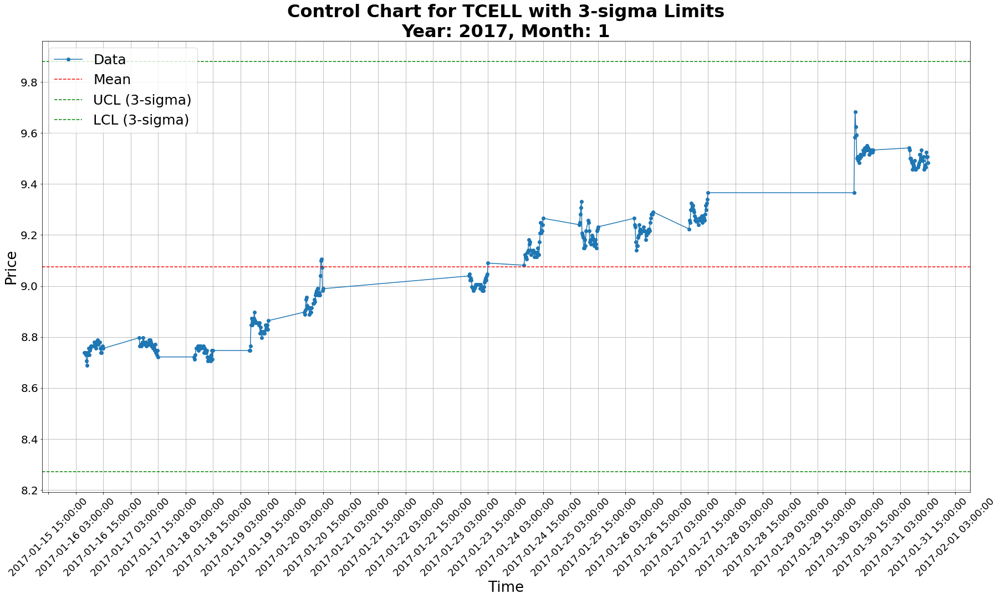

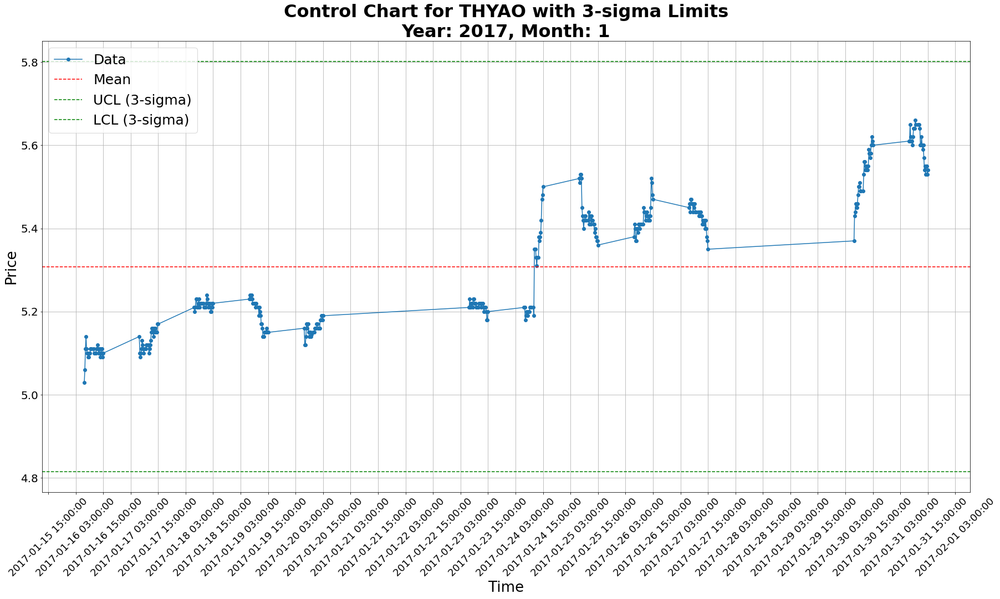

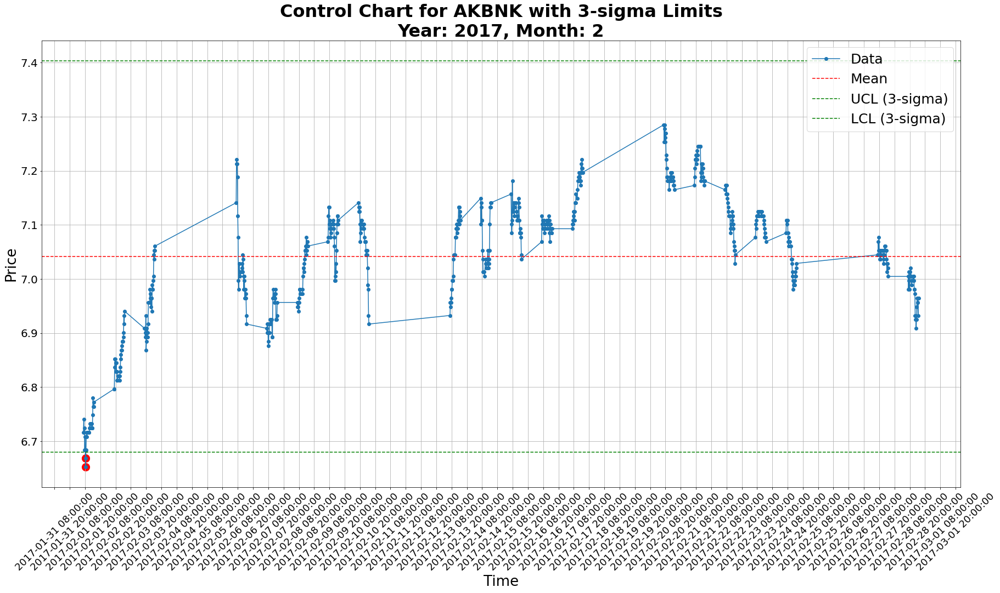

Outliers for AKBNK:
Timestamp: 2017-02-01 08:15:00+00:00, Price: 6.6681
Timestamp: 2017-02-01 08:30:00+00:00, Price: 6.6521


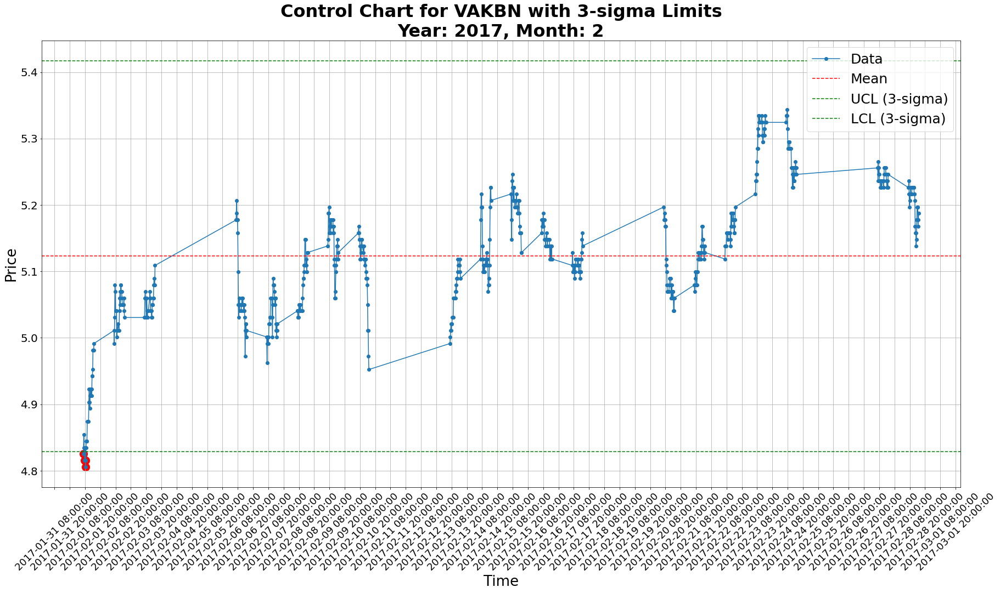

Outliers for VAKBN:
Timestamp: 2017-02-01 06:45:00+00:00, Price: 4.8252
Timestamp: 2017-02-01 07:45:00+00:00, Price: 4.8153
Timestamp: 2017-02-01 08:15:00+00:00, Price: 4.8153
Timestamp: 2017-02-01 08:30:00+00:00, Price: 4.8055


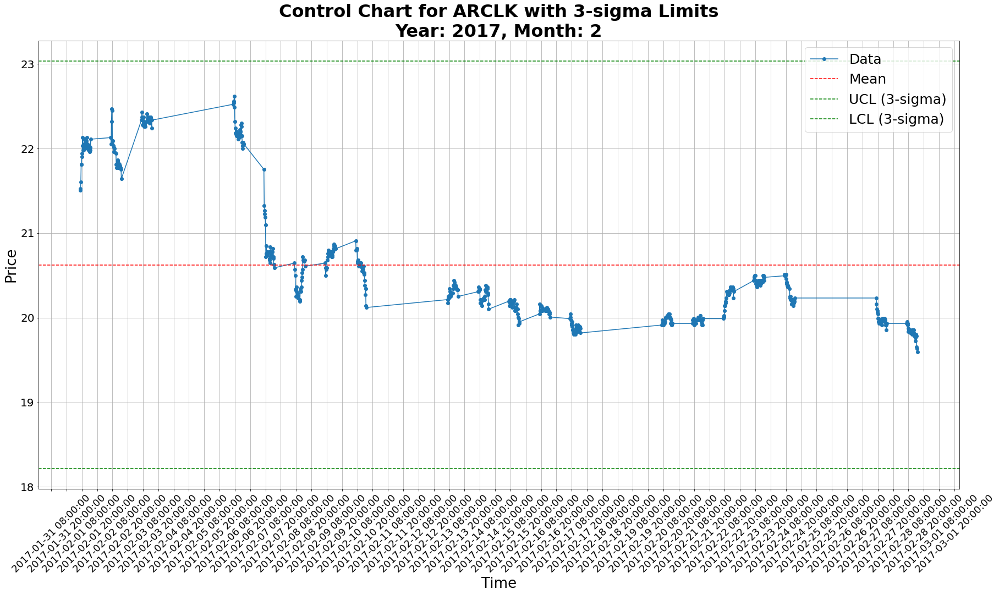

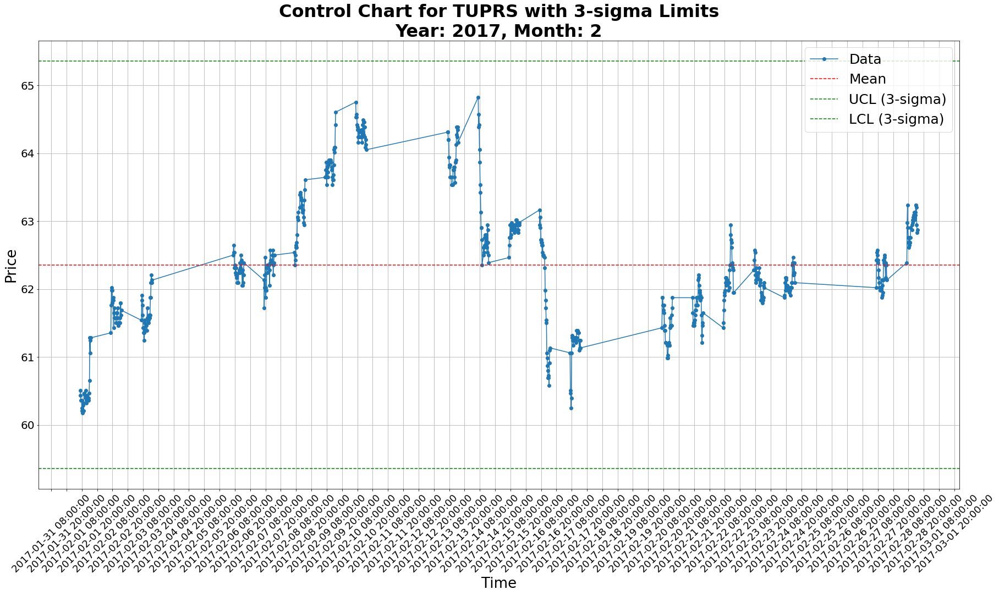

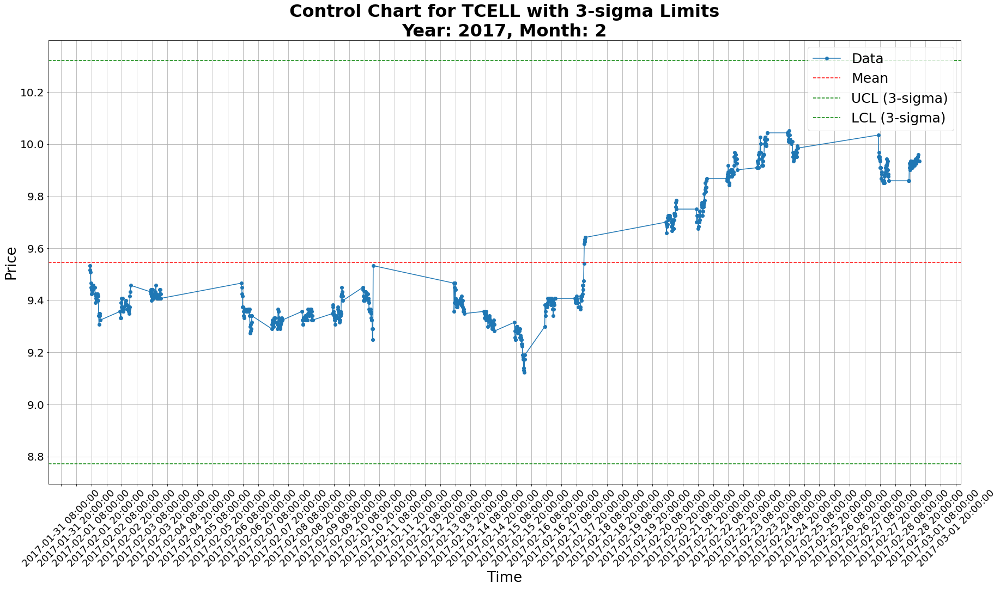

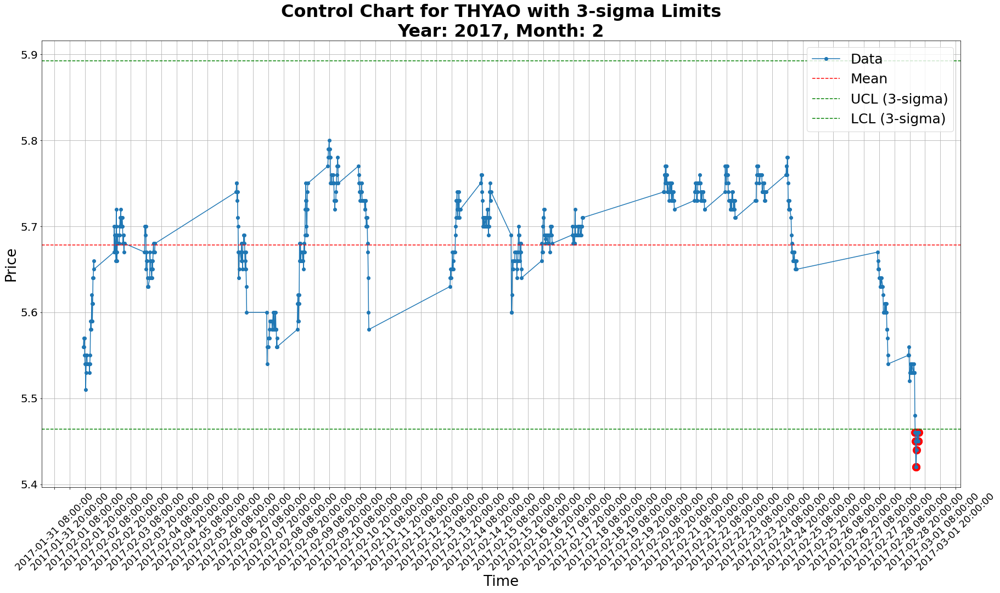

Outliers for THYAO:
Timestamp: 2017-02-28 12:15:00+00:00, Price: 5.46
Timestamp: 2017-02-28 12:30:00+00:00, Price: 5.45
Timestamp: 2017-02-28 12:45:00+00:00, Price: 5.42
Timestamp: 2017-02-28 13:00:00+00:00, Price: 5.42
Timestamp: 2017-02-28 13:15:00+00:00, Price: 5.44
Timestamp: 2017-02-28 13:30:00+00:00, Price: 5.46
Timestamp: 2017-02-28 13:45:00+00:00, Price: 5.45
Timestamp: 2017-02-28 14:00:00+00:00, Price: 5.46
Timestamp: 2017-02-28 14:15:00+00:00, Price: 5.46
Timestamp: 2017-02-28 14:30:00+00:00, Price: 5.45
Timestamp: 2017-02-28 14:45:00+00:00, Price: 5.45
Timestamp: 2017-02-28 15:00:00+00:00, Price: 5.46


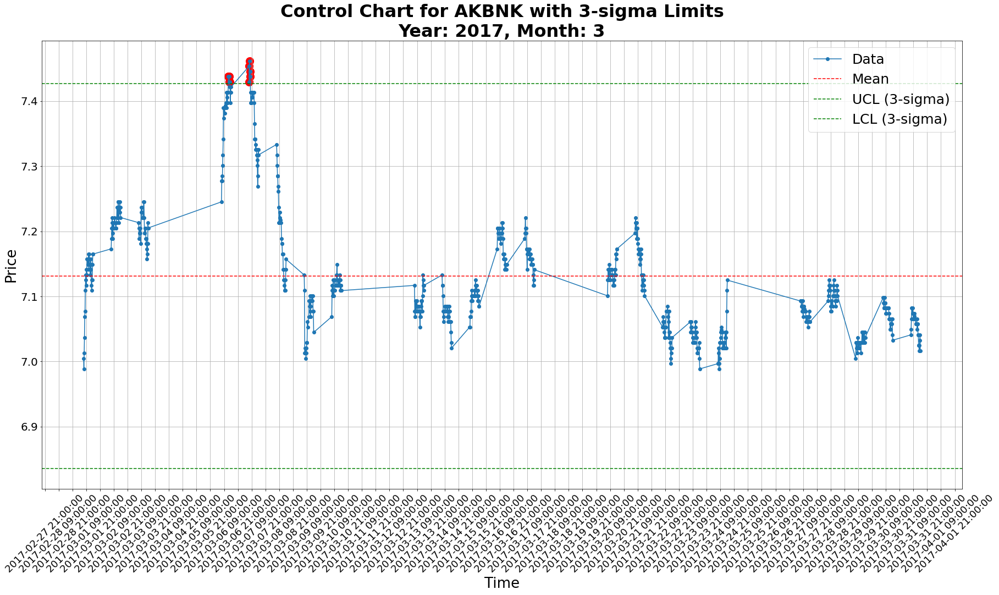

Outliers for AKBNK:
Timestamp: 2017-03-06 12:45:00+00:00, Price: 7.4375
Timestamp: 2017-03-06 13:00:00+00:00, Price: 7.4375
Timestamp: 2017-03-06 13:15:00+00:00, Price: 7.4375
Timestamp: 2017-03-06 13:30:00+00:00, Price: 7.4375
Timestamp: 2017-03-06 13:45:00+00:00, Price: 7.4294
Timestamp: 2017-03-06 14:00:00+00:00, Price: 7.4294
Timestamp: 2017-03-07 06:45:00+00:00, Price: 7.4535
Timestamp: 2017-03-07 07:00:00+00:00, Price: 7.4294
Timestamp: 2017-03-07 07:15:00+00:00, Price: 7.4615
Timestamp: 2017-03-07 07:30:00+00:00, Price: 7.4375
Timestamp: 2017-03-07 07:45:00+00:00, Price: 7.4455


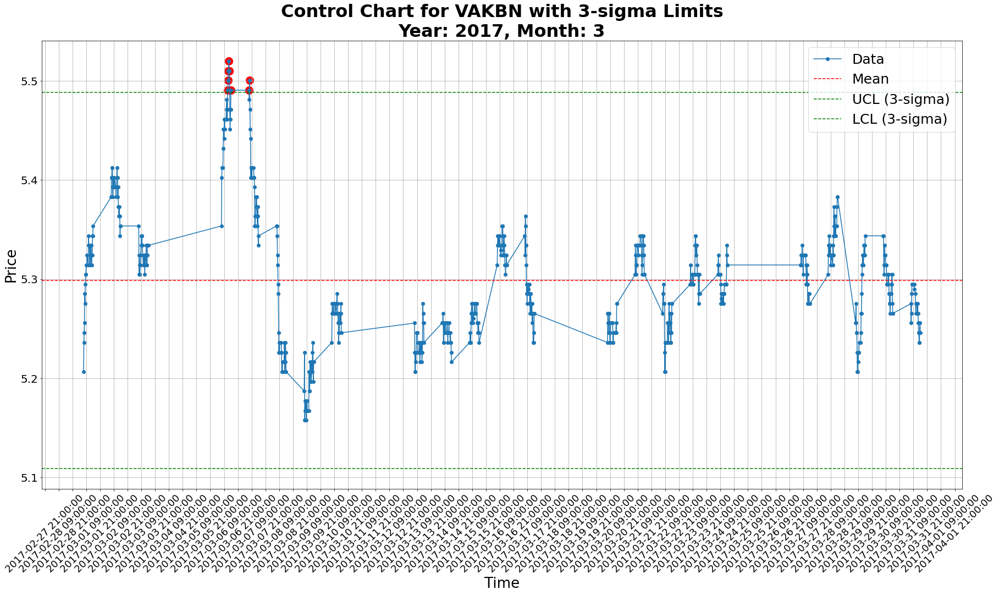

Outliers for VAKBN:
Timestamp: 2017-03-06 12:15:00+00:00, Price: 5.4906
Timestamp: 2017-03-06 12:30:00+00:00, Price: 5.5005
Timestamp: 2017-03-06 12:45:00+00:00, Price: 5.5102
Timestamp: 2017-03-06 13:00:00+00:00, Price: 5.5102
Timestamp: 2017-03-06 13:15:00+00:00, Price: 5.52
Timestamp: 2017-03-06 13:30:00+00:00, Price: 5.5102
Timestamp: 2017-03-06 13:45:00+00:00, Price: 5.5102
Timestamp: 2017-03-06 15:00:00+00:00, Price: 5.4906
Timestamp: 2017-03-07 06:45:00+00:00, Price: 5.4906
Timestamp: 2017-03-07 07:15:00+00:00, Price: 5.5005


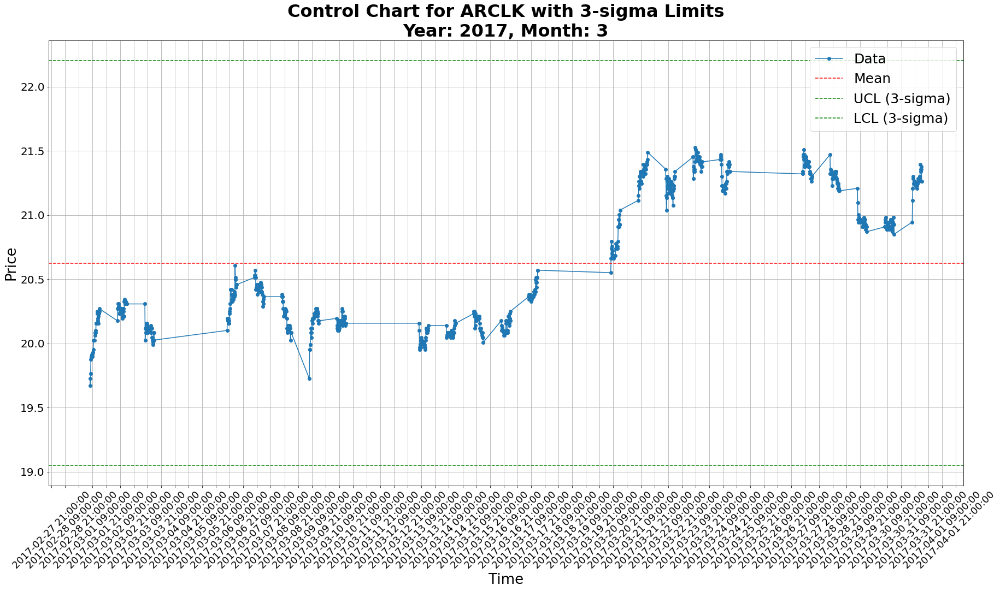

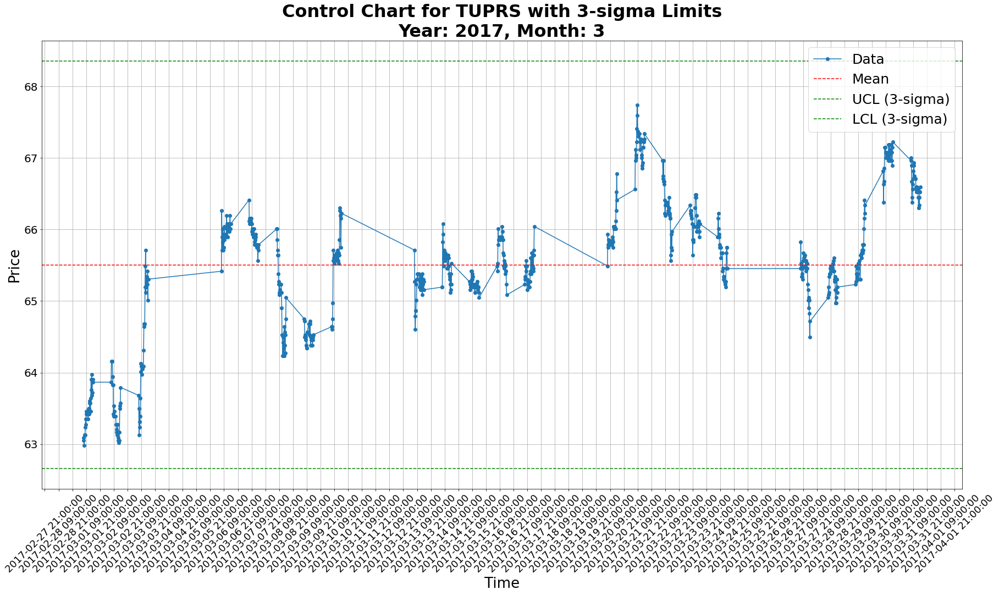

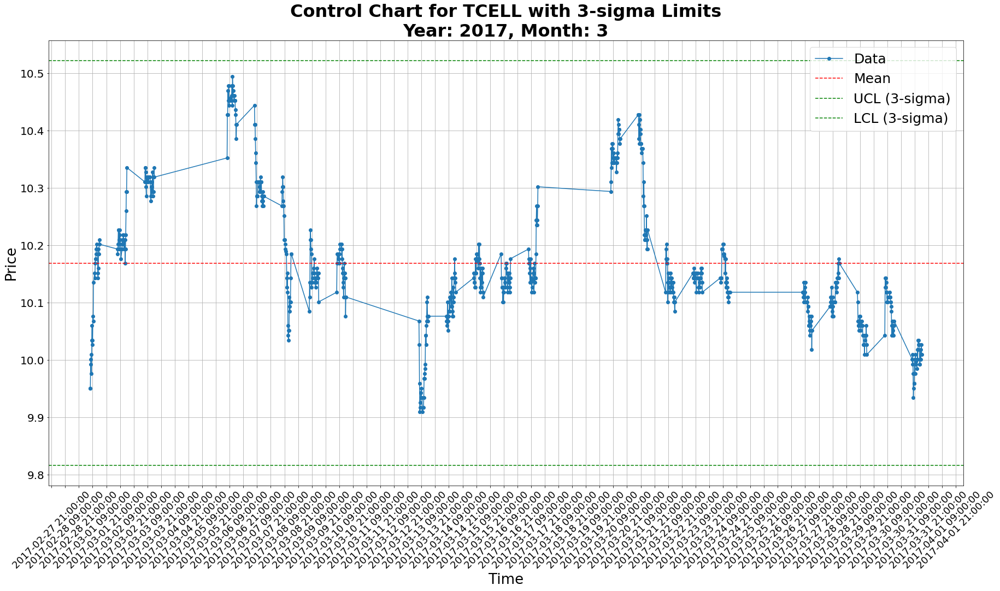

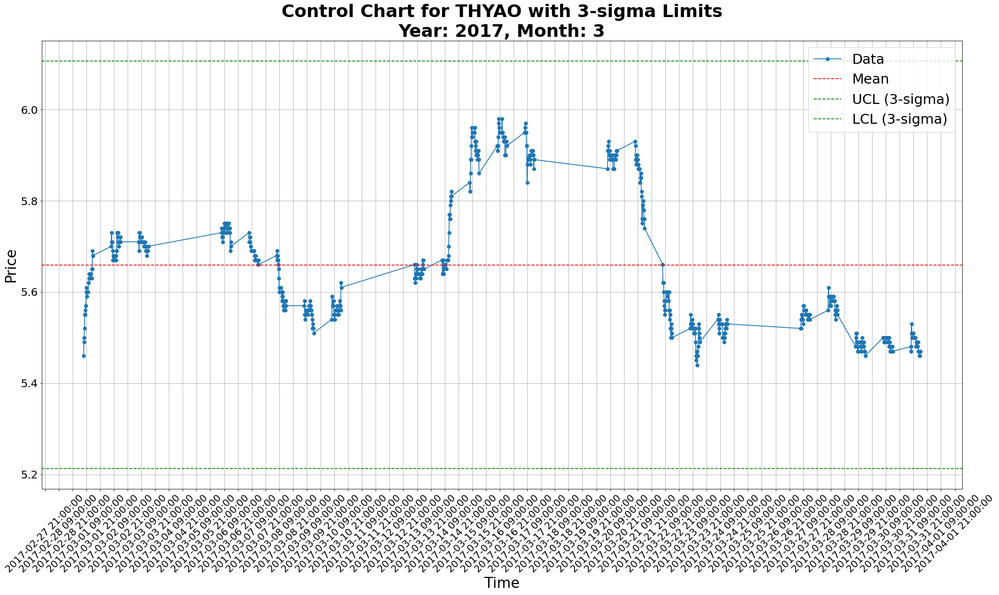

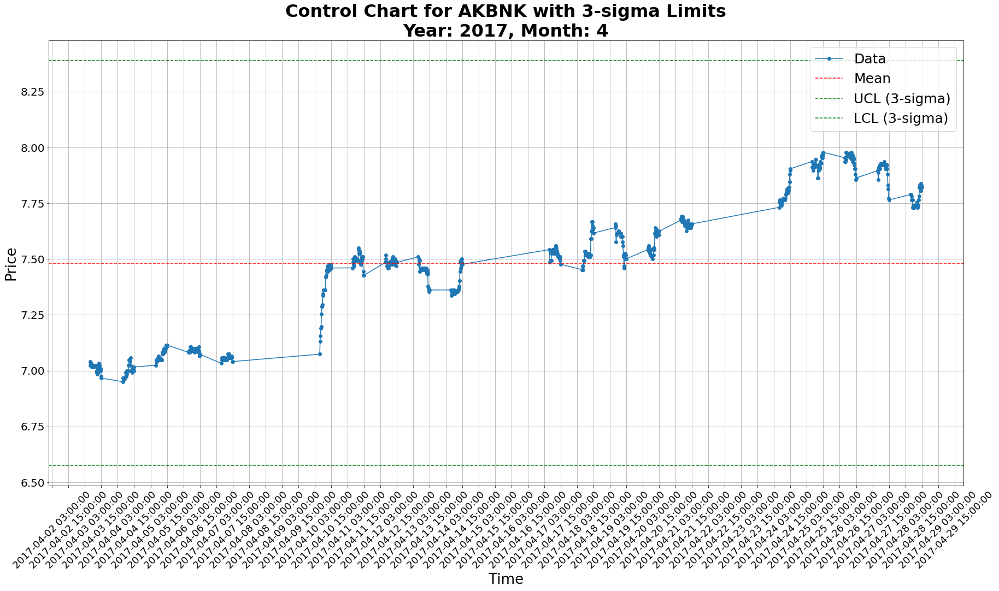

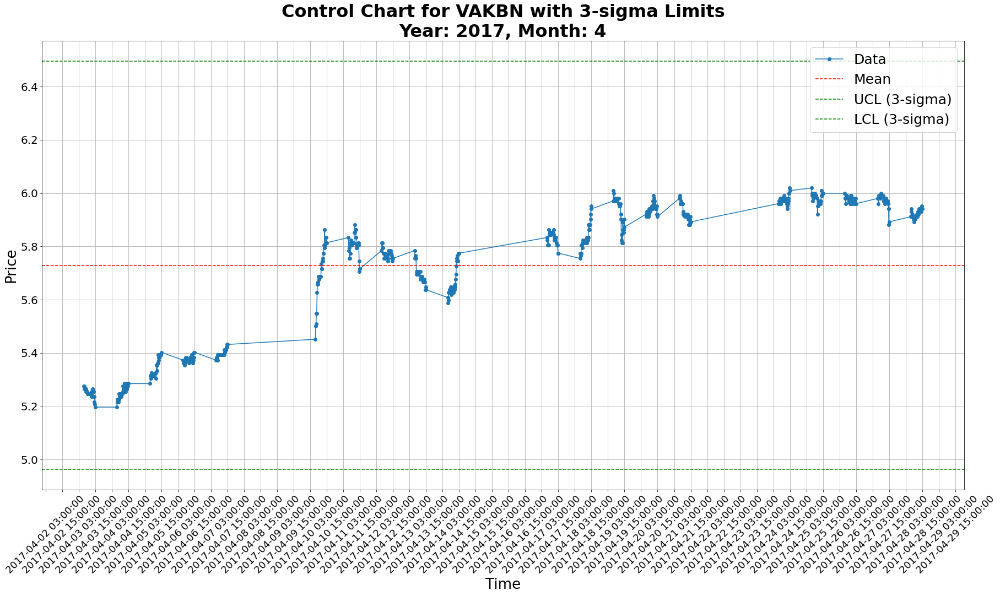

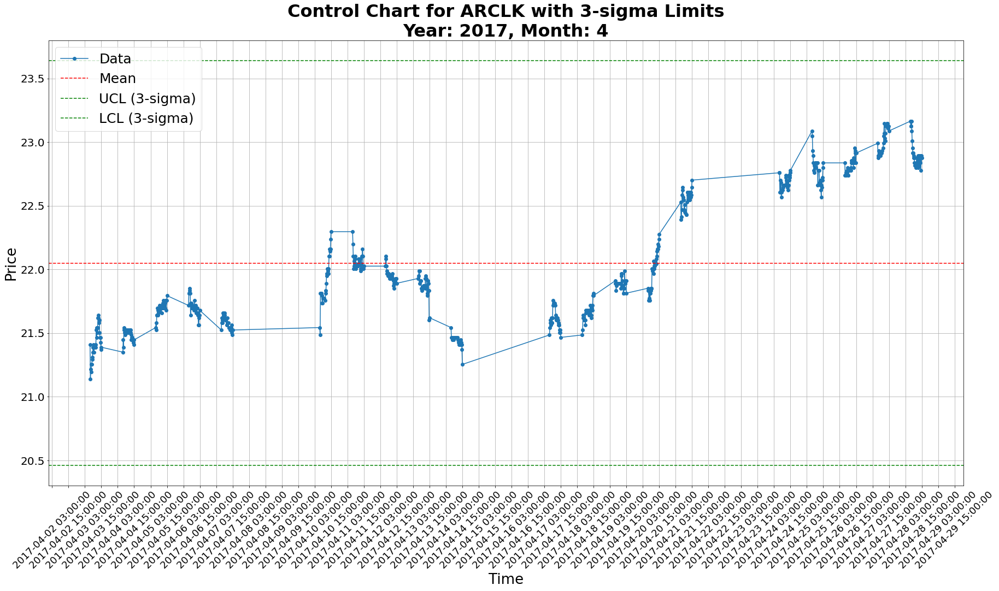

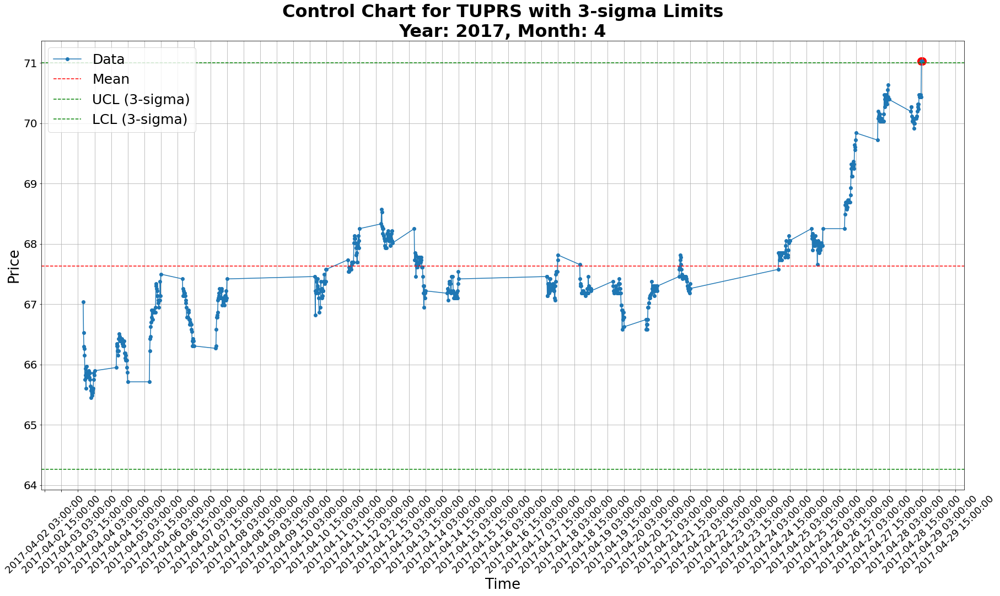

Outliers for TUPRS:
Timestamp: 2017-04-28 14:30:00+00:00, Price: 71.0298
Timestamp: 2017-04-28 14:45:00+00:00, Price: 71.0298
Timestamp: 2017-04-28 15:00:00+00:00, Price: 71.0298


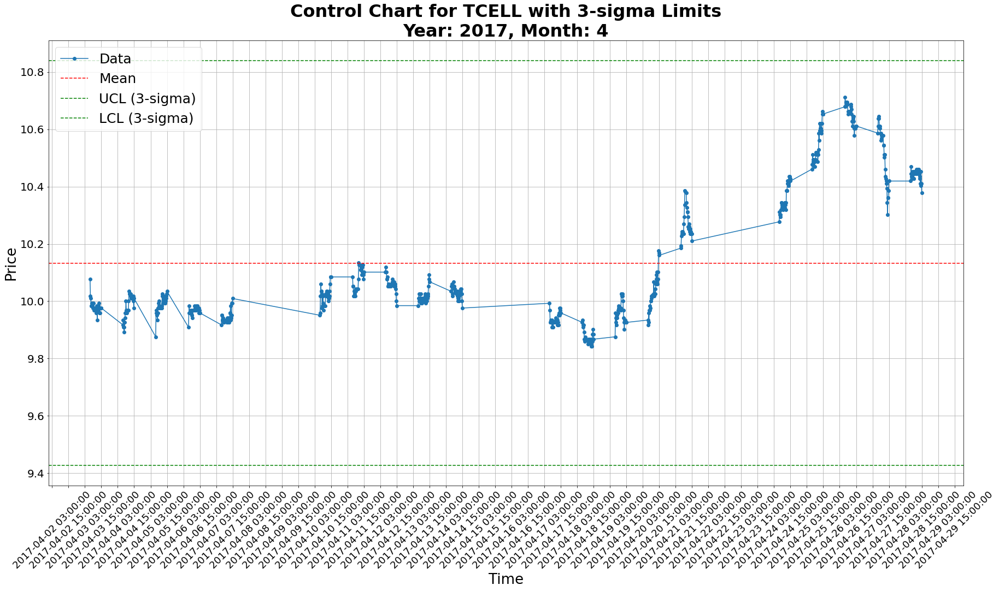

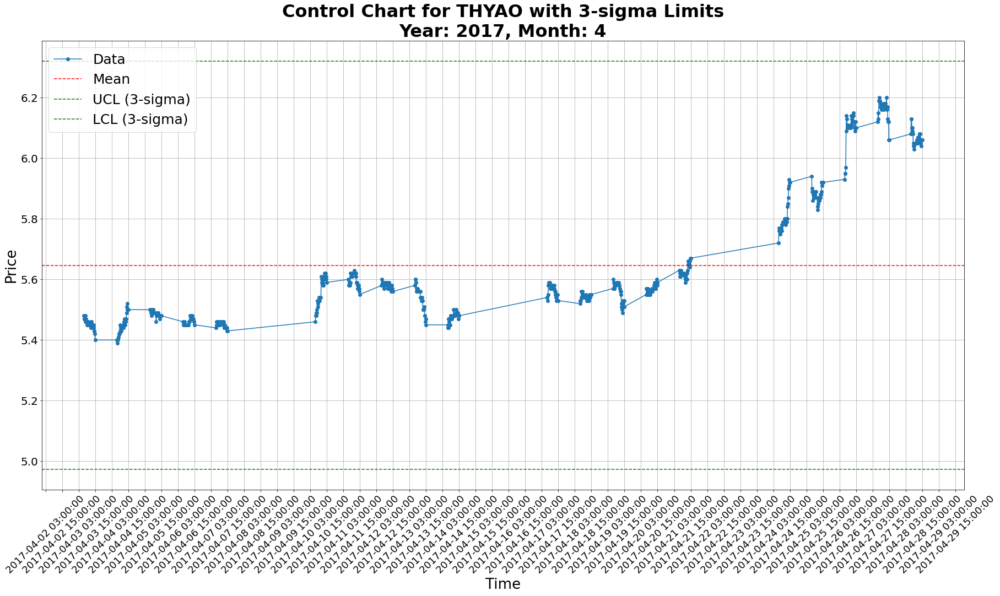

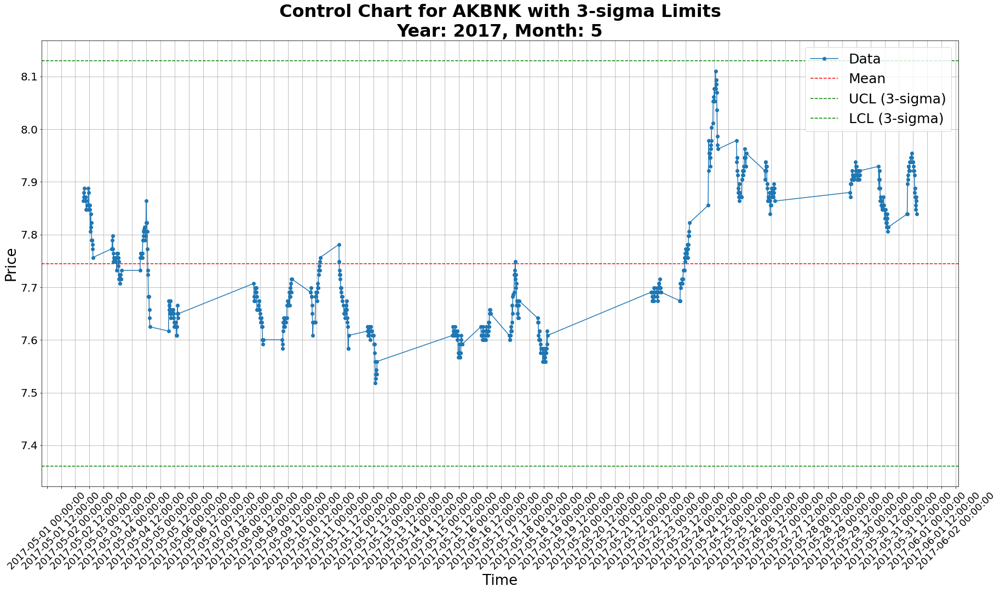

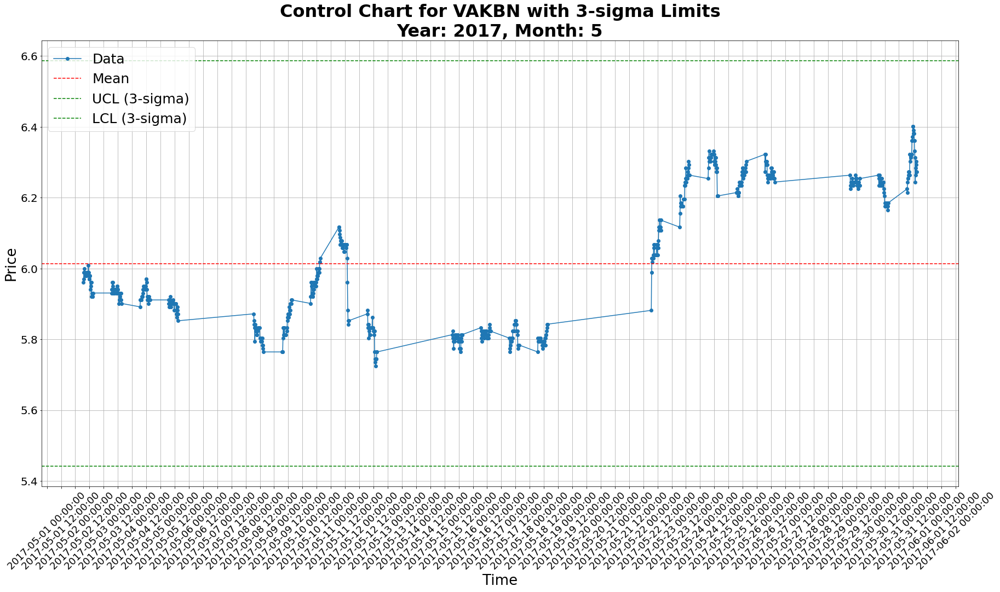

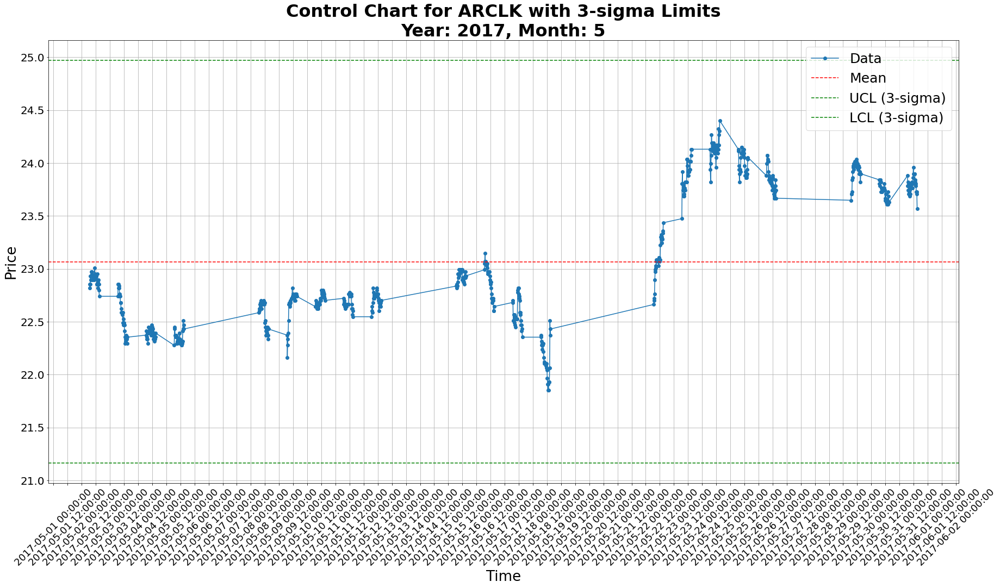

...

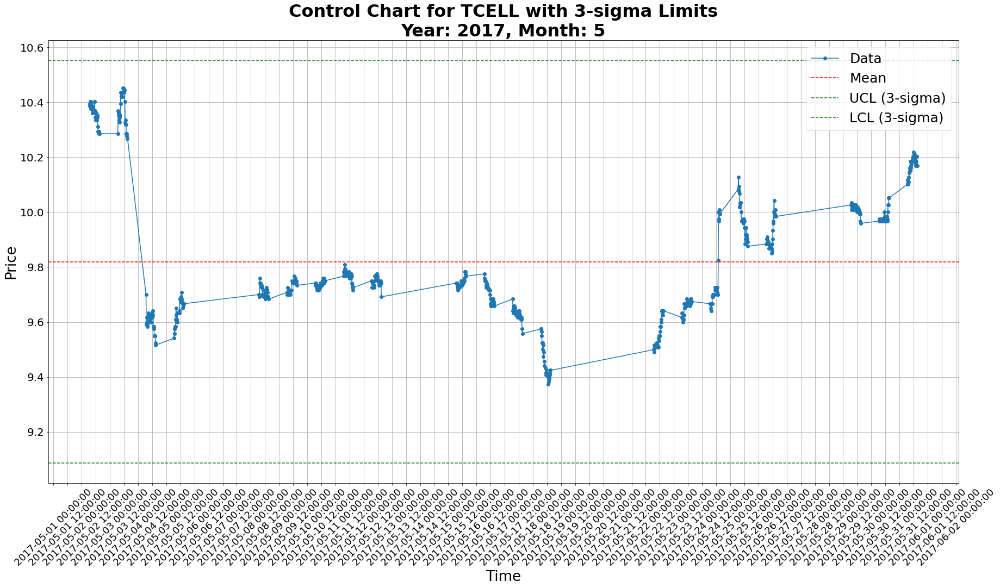

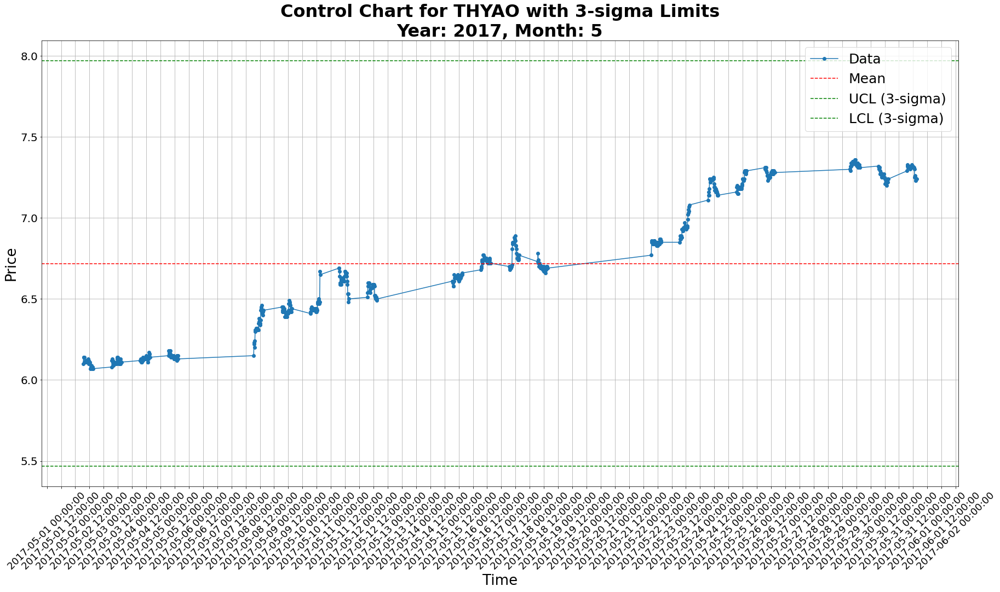

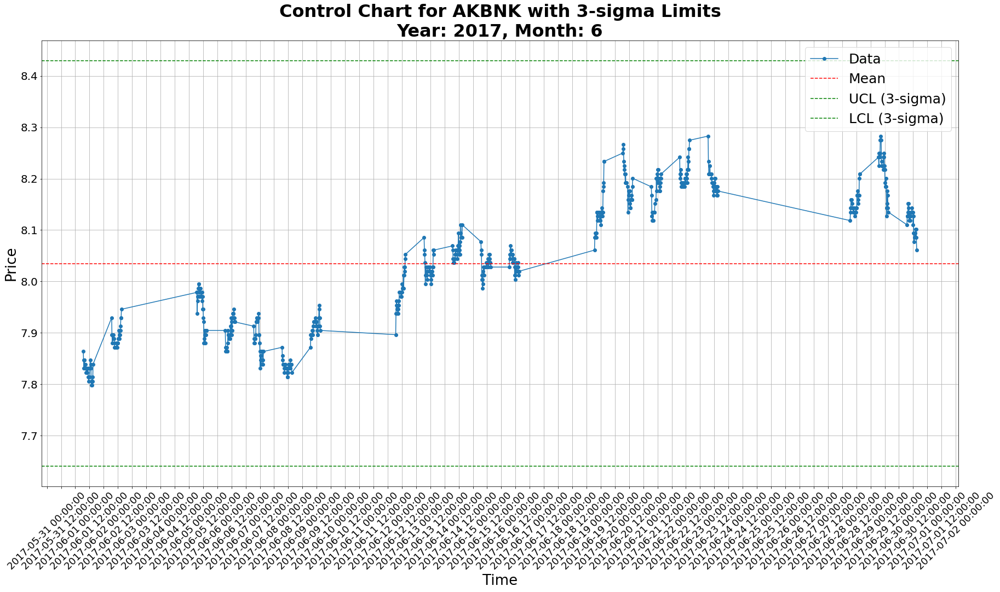

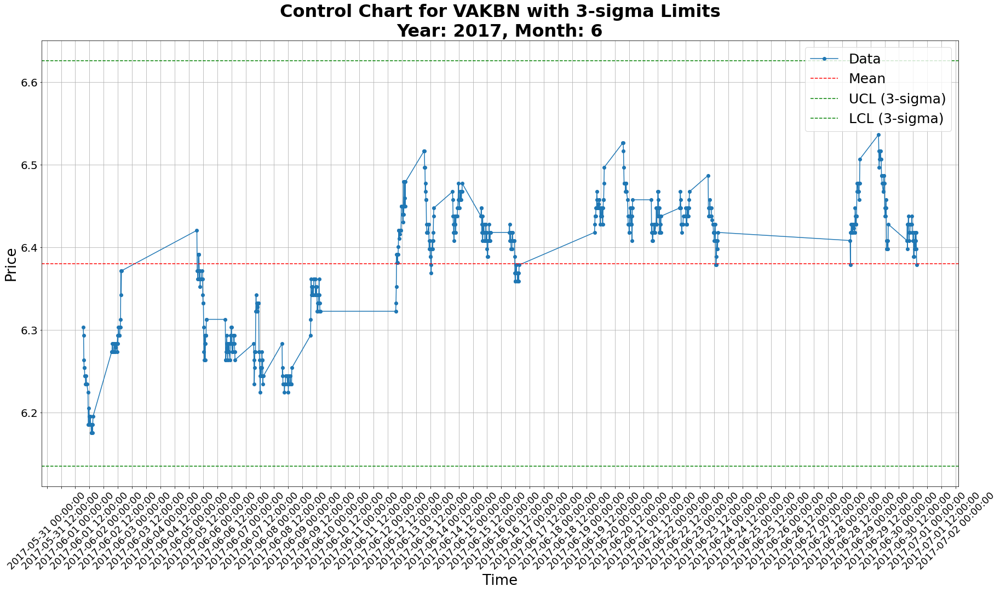

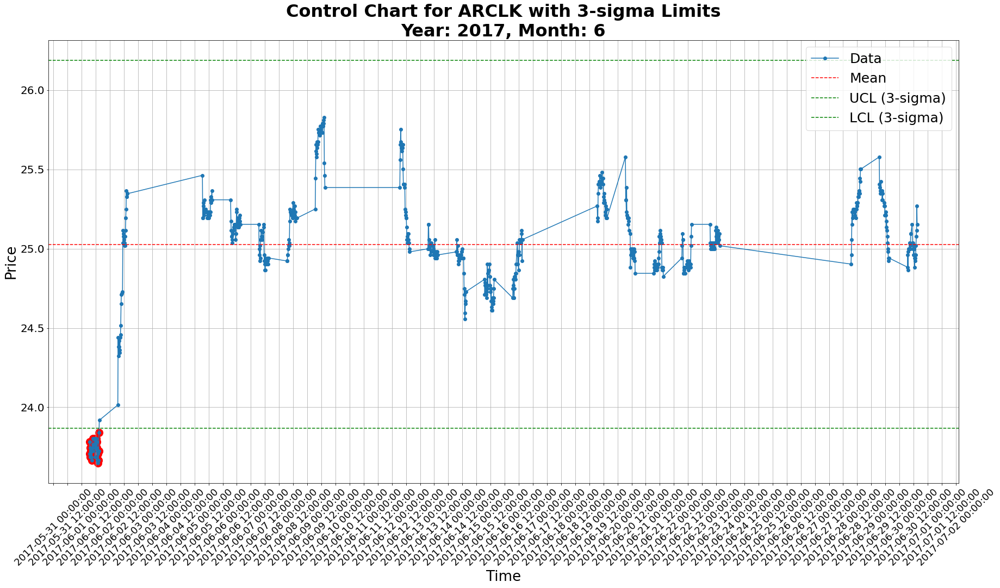

Outliers for ARCLK:
Timestamp: 2017-06-01 06:45:00+00:00, Price: 23.7059
Timestamp: 2017-06-01 07:00:00+00:00, Price: 23.7831
Timestamp: 2017-06-01 07:15:00+00:00, Price: 23.7445
Timestamp: 2017-06-01 07:30:00+00:00, Price: 23.6866
Timestamp: 2017-06-01 07:45:00+00:00, Price: 23.7252
Timestamp: 2017-06-01 08:00:00+00:00, Price: 23.6866
Timestamp: 2017-06-01 08:15:00+00:00, Price: 23.6866
Timestamp: 2017-06-01 08:30:00+00:00, Price: 23.7252
Timestamp: 2017-06-01 08:45:00+00:00, Price: 23.6673
Timestamp: 2017-06-01 09:00:00+00:00, Price: 23.7252
Timestamp: 2017-06-01 09:15:00+00:00, Price: 23.7445
Timestamp: 2017-06-01 09:30:00+00:00, Price: 23.7638
Timestamp: 2017-06-01 09:45:00+00:00, Price: 23.8024
Timestamp: 2017-06-01 10:45:00+00:00, Price: 23.8024
Timestamp: 2017-06-01 11:00:00+00:00, Price: 23.7638
Timestamp: 2017-06-01 11:15:00+00:00, Price: 23.6866
Timestamp: 2017-06-01 11:30:00+00:00, Price: 23.8024
Timestamp: 2017-06-01 11:45:00+00:00, Price: 23.7638
Timestamp: 2017-06-01 12:0

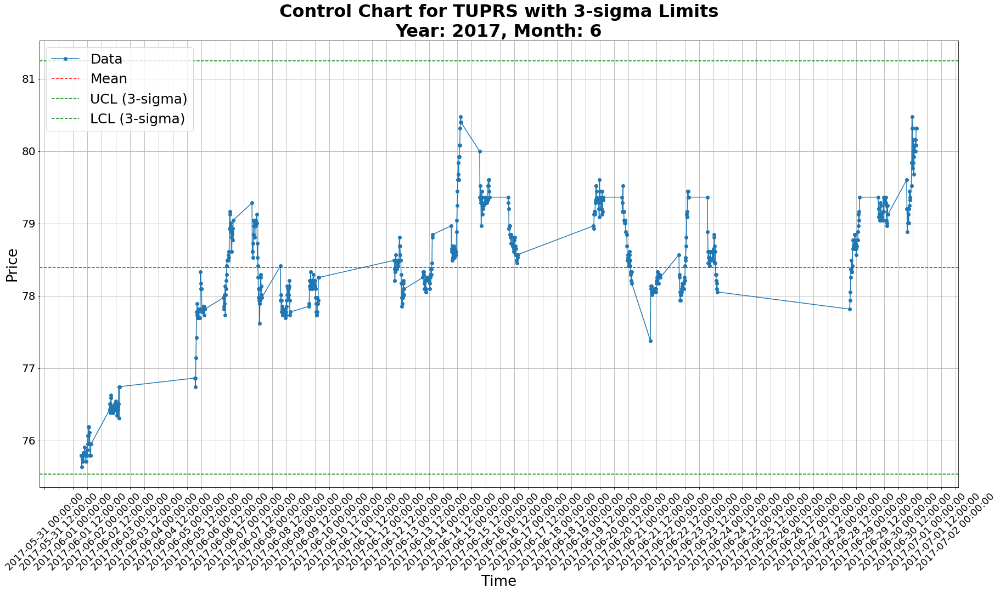

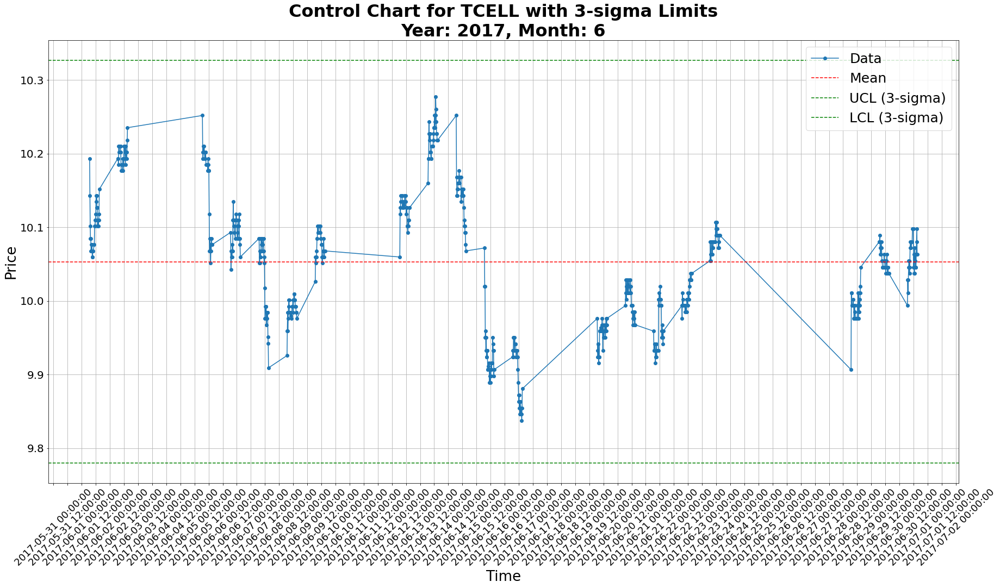

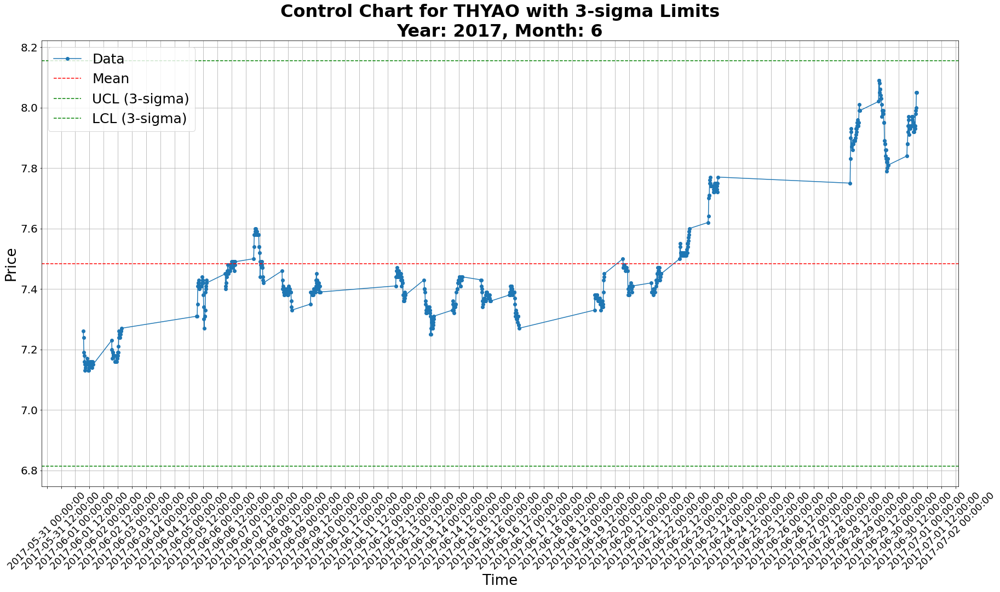

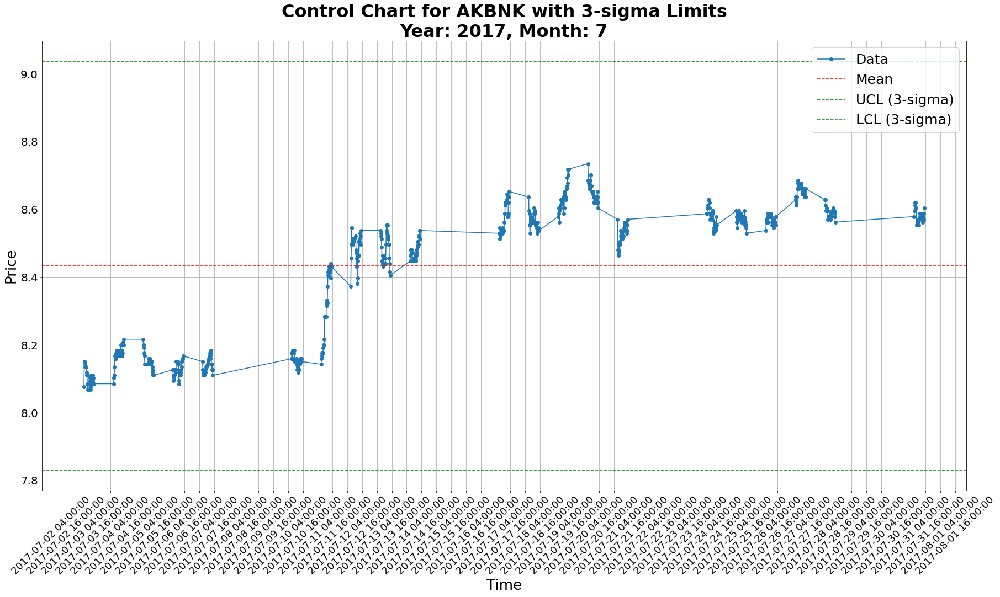

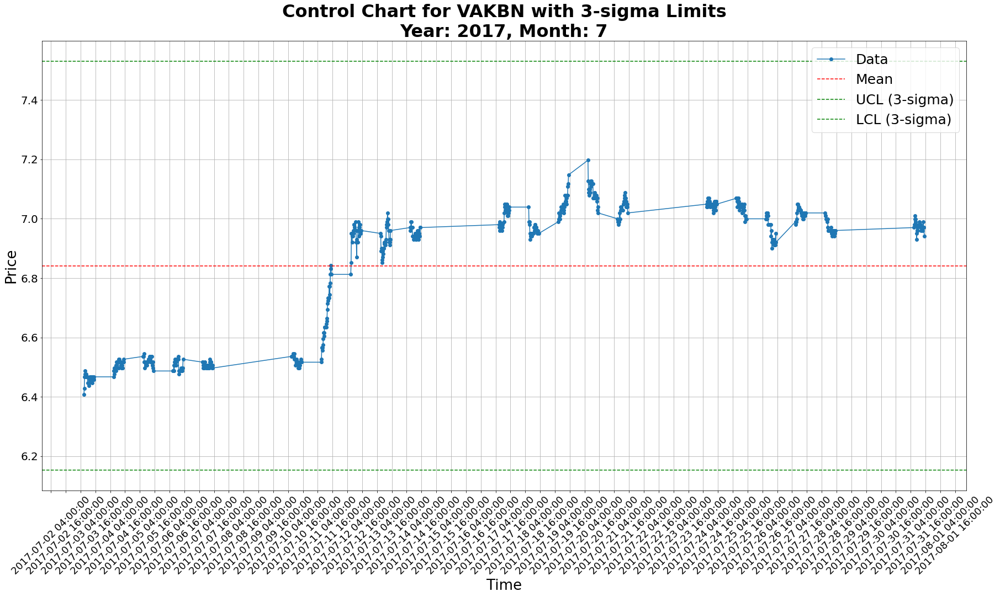

...

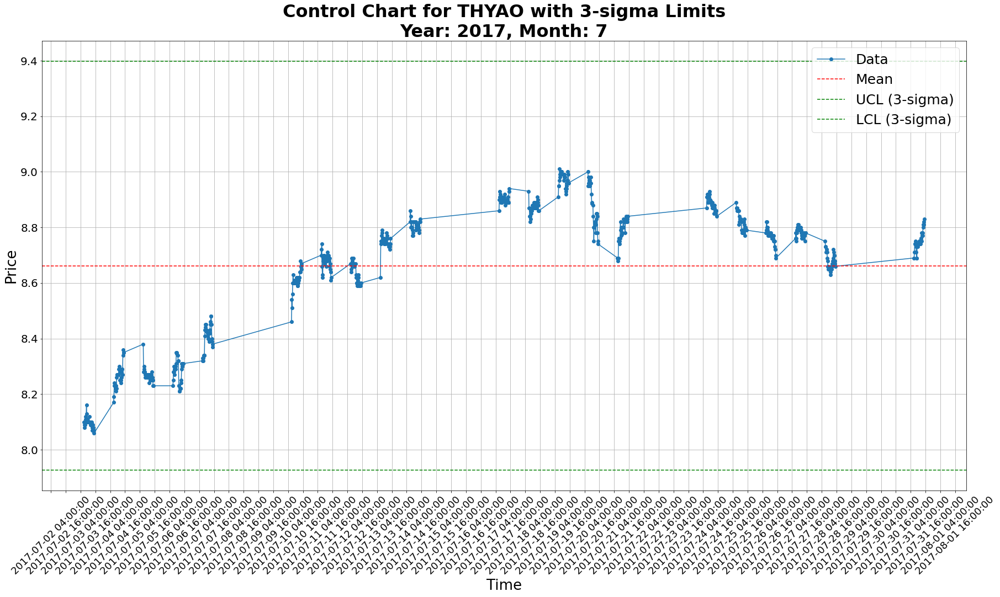

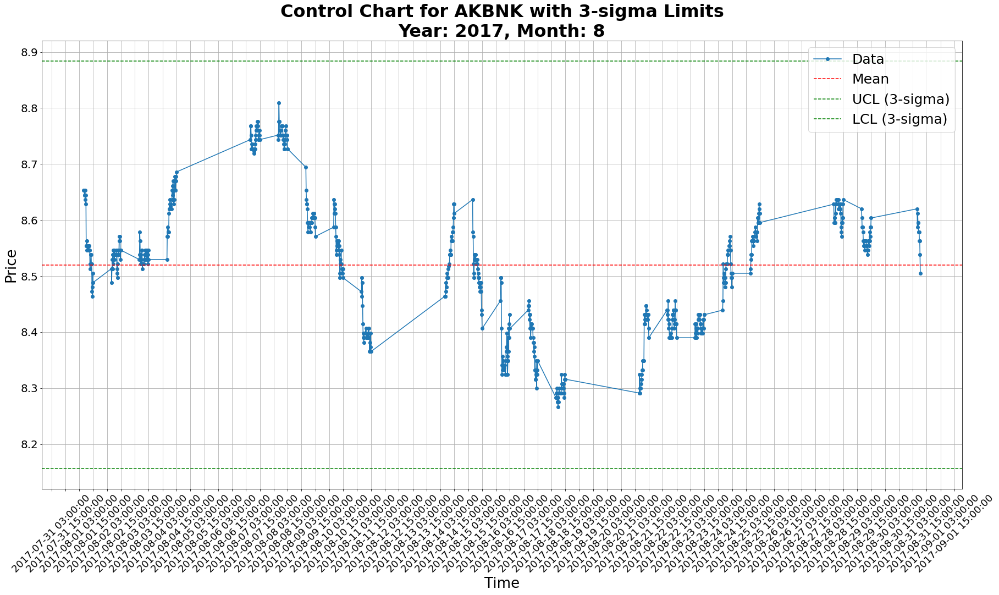

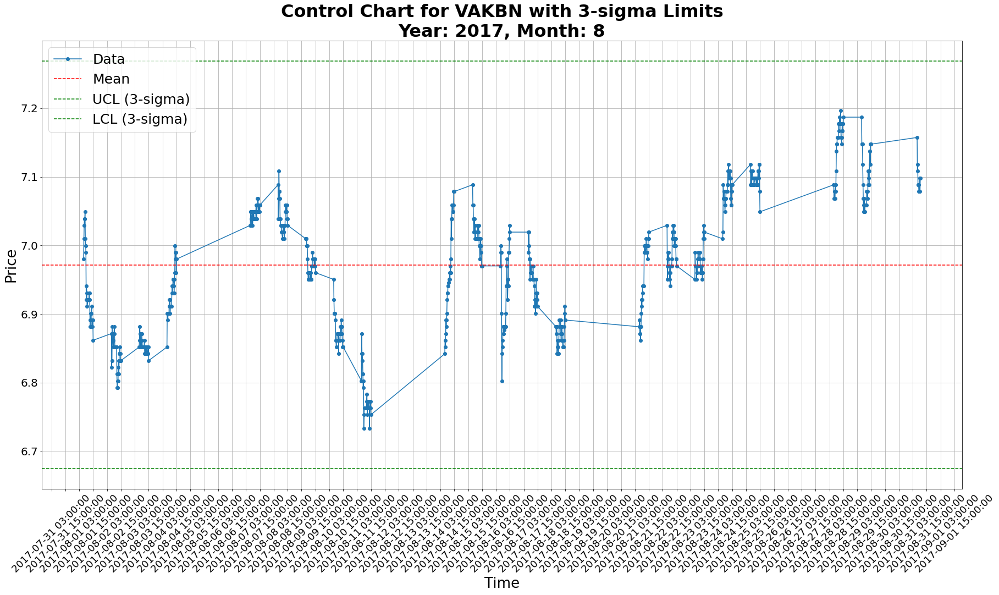

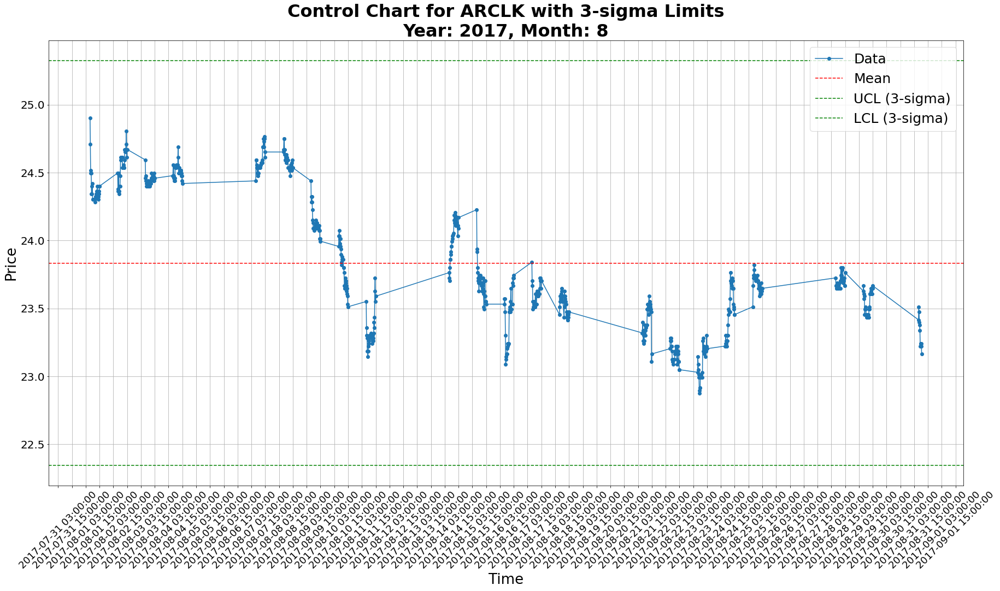

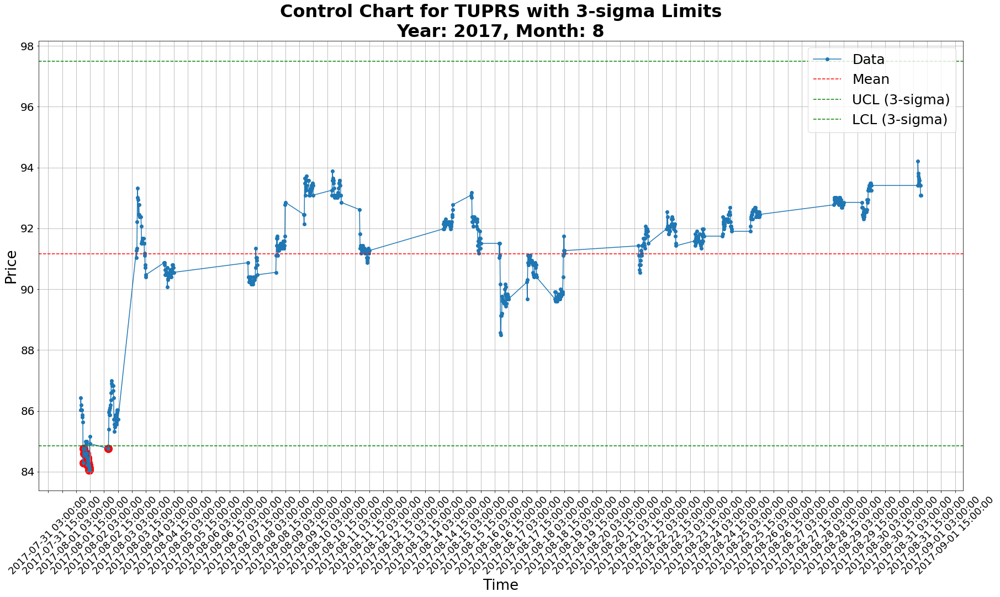

Outliers for TUPRS:
Timestamp: 2017-08-01 09:00:00+00:00, Price: 84.2834
Timestamp: 2017-08-01 09:15:00+00:00, Price: 84.7596
Timestamp: 2017-08-01 09:30:00+00:00, Price: 84.7596
Timestamp: 2017-08-01 09:45:00+00:00, Price: 84.6008
Timestamp: 2017-08-01 10:45:00+00:00, Price: 84.6008
Timestamp: 2017-08-01 11:00:00+00:00, Price: 84.5215
Timestamp: 2017-08-01 12:15:00+00:00, Price: 84.6008
Timestamp: 2017-08-01 12:30:00+00:00, Price: 84.4421
Timestamp: 2017-08-01 12:45:00+00:00, Price: 84.204
Timestamp: 2017-08-01 13:00:00+00:00, Price: 84.3627
Timestamp: 2017-08-01 13:15:00+00:00, Price: 84.4421
Timestamp: 2017-08-01 13:30:00+00:00, Price: 84.2834
Timestamp: 2017-08-01 13:45:00+00:00, Price: 84.204
Timestamp: 2017-08-01 14:00:00+00:00, Price: 84.0453
Timestamp: 2017-08-01 14:15:00+00:00, Price: 84.0453
Timestamp: 2017-08-01 14:30:00+00:00, Price: 84.1246
Timestamp: 2017-08-02 06:45:00+00:00, Price: 84.7596


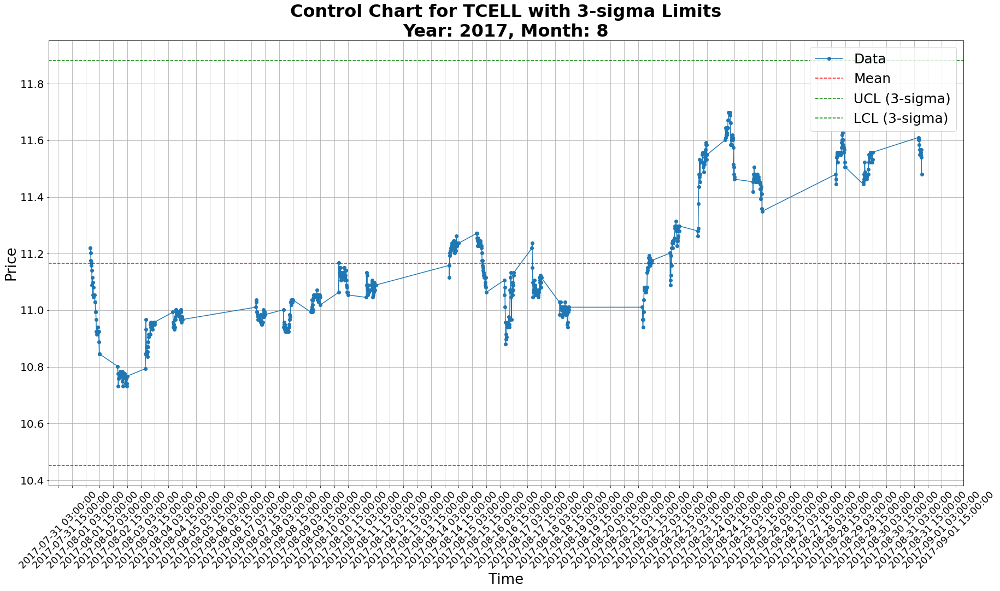

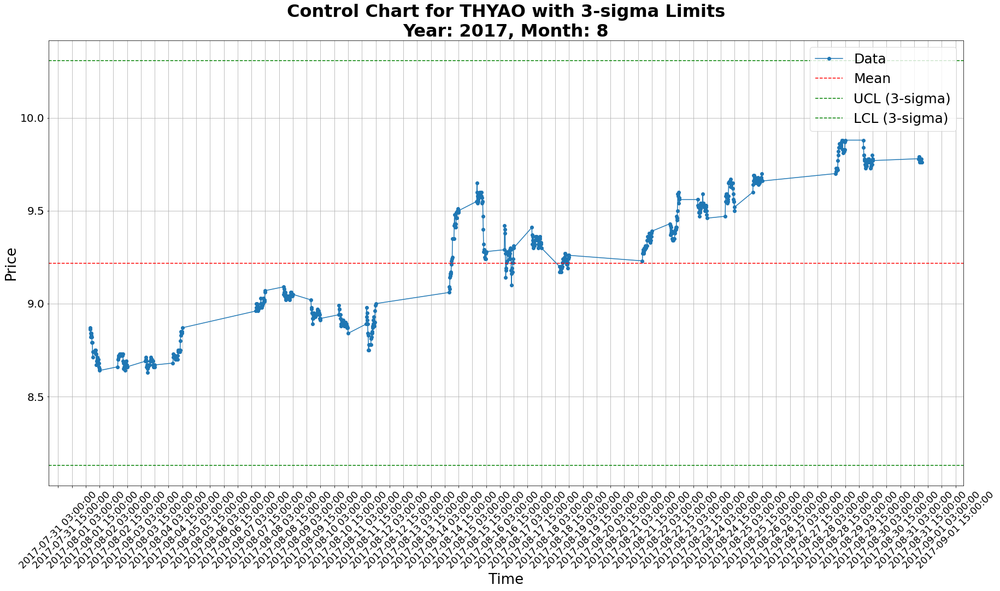

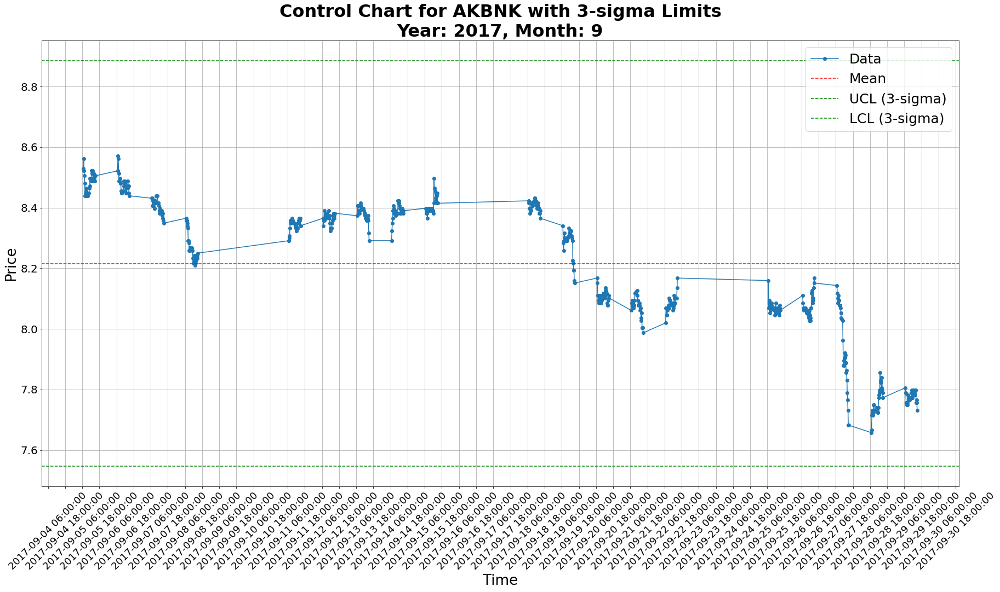

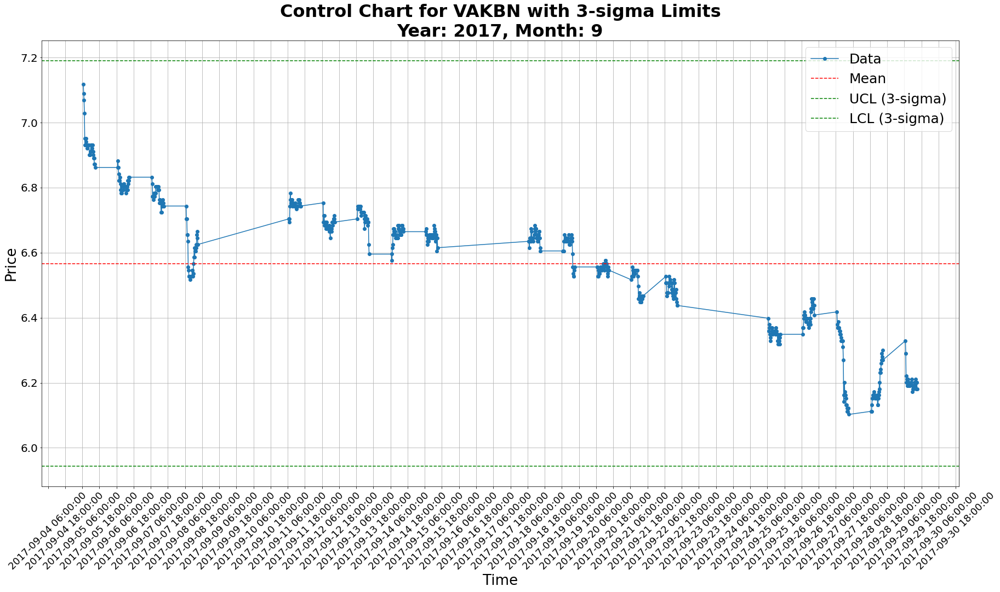

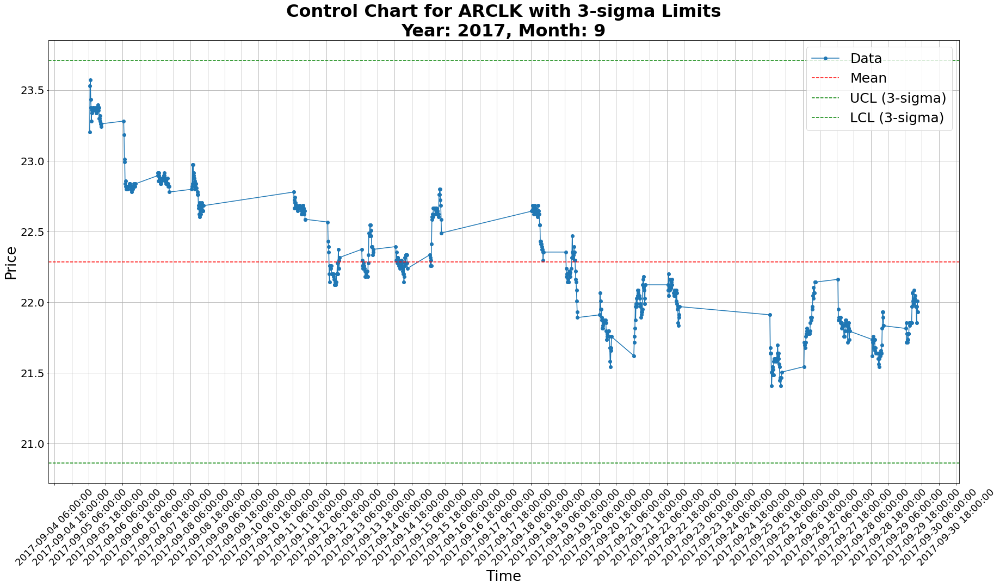

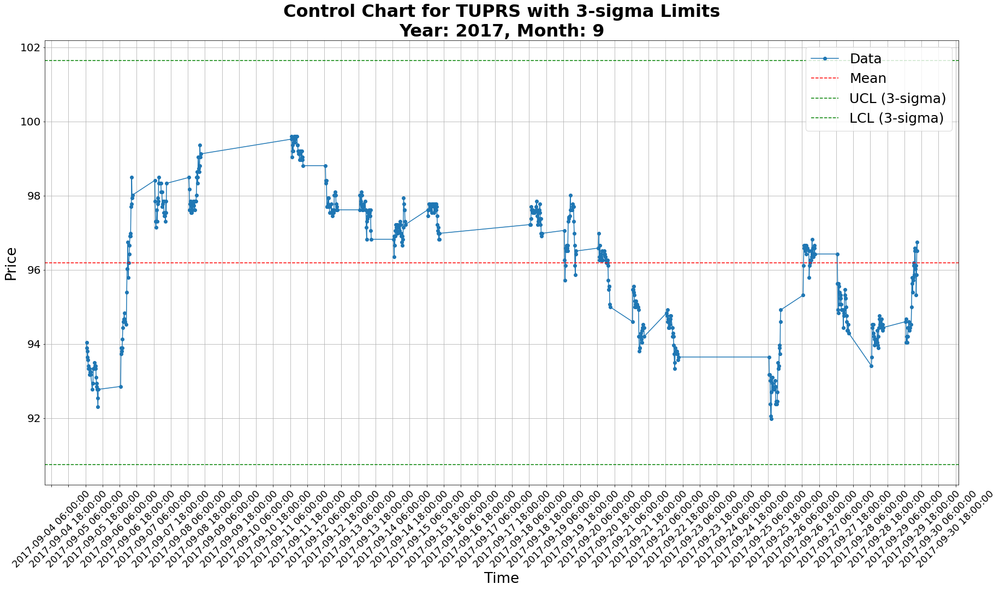

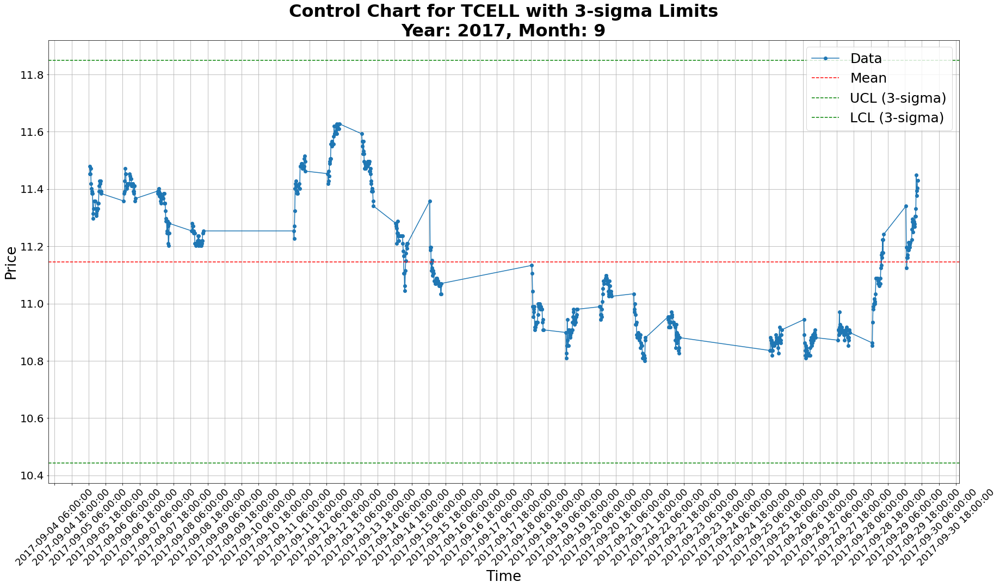

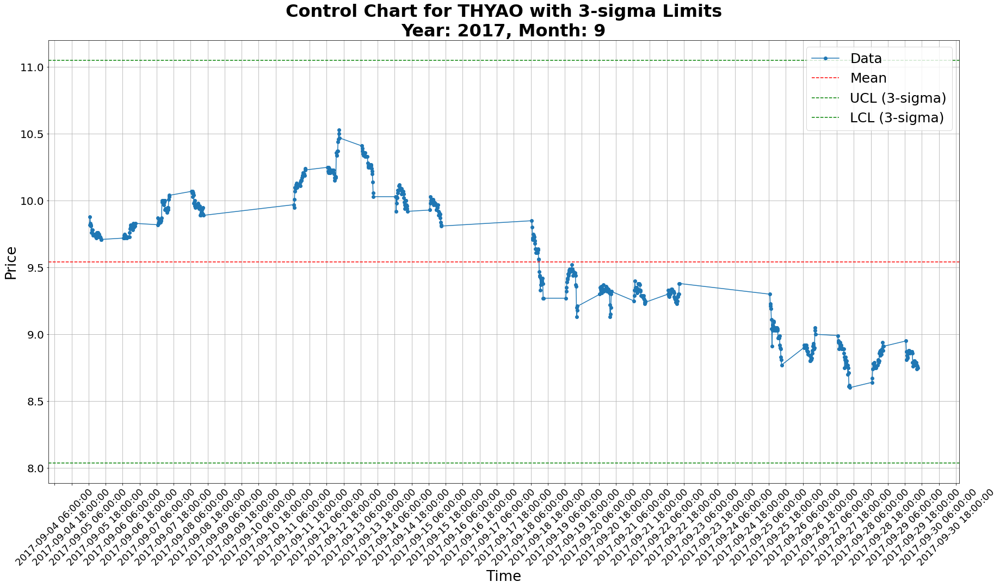

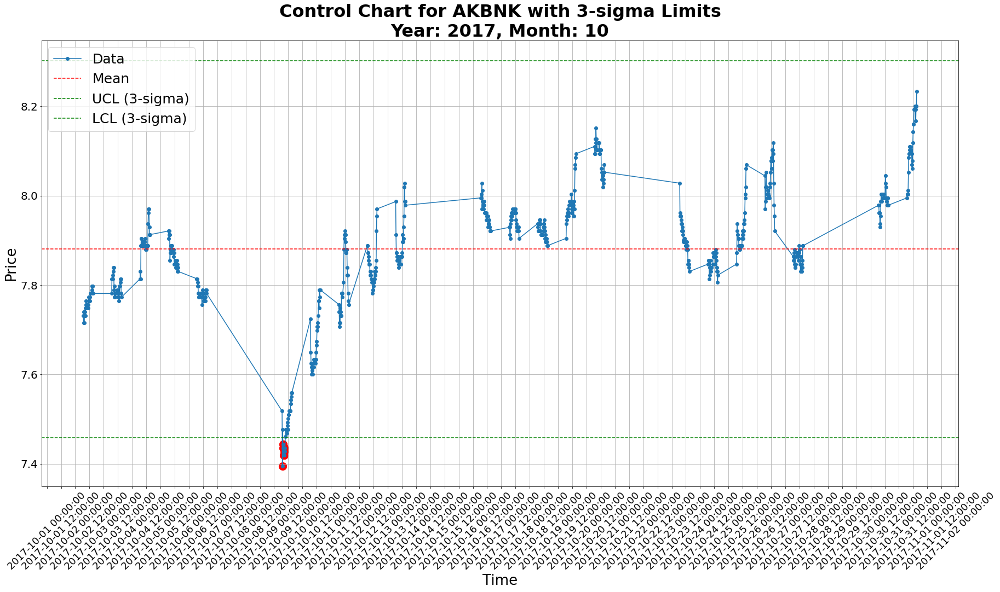

Outliers for AKBNK:
Timestamp: 2017-10-09 07:00:00+00:00, Price: 7.3946
Timestamp: 2017-10-09 07:30:00+00:00, Price: 7.4357
Timestamp: 2017-10-09 07:45:00+00:00, Price: 7.4439
Timestamp: 2017-10-09 08:00:00+00:00, Price: 7.4357
Timestamp: 2017-10-09 08:15:00+00:00, Price: 7.4192
Timestamp: 2017-10-09 08:30:00+00:00, Price: 7.4275
Timestamp: 2017-10-09 08:45:00+00:00, Price: 7.4192
Timestamp: 2017-10-09 09:00:00+00:00, Price: 7.4275
Timestamp: 2017-10-09 09:15:00+00:00, Price: 7.4357


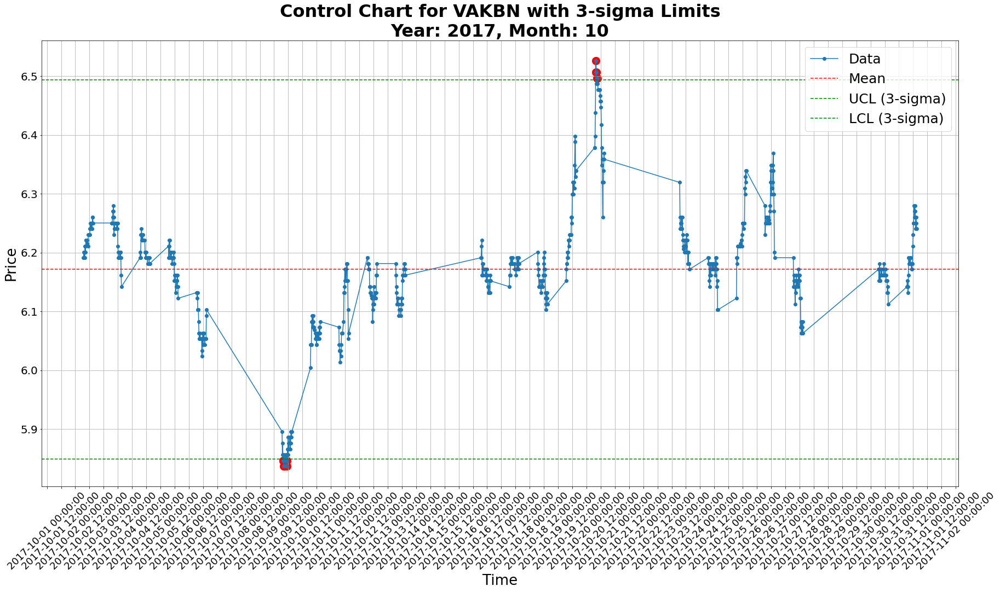

Outliers for VAKBN:
Timestamp: 2017-10-09 07:30:00+00:00, Price: 5.8462
Timestamp: 2017-10-09 07:45:00+00:00, Price: 5.8462
Timestamp: 2017-10-09 08:15:00+00:00, Price: 5.8364
Timestamp: 2017-10-09 08:30:00+00:00, Price: 5.8364
Timestamp: 2017-10-09 08:45:00+00:00, Price: 5.8364
Timestamp: 2017-10-09 09:00:00+00:00, Price: 5.8364
Timestamp: 2017-10-09 09:15:00+00:00, Price: 5.8364
Timestamp: 2017-10-09 09:30:00+00:00, Price: 5.8462
Timestamp: 2017-10-09 10:45:00+00:00, Price: 5.8462
Timestamp: 2017-10-09 11:00:00+00:00, Price: 5.8364
Timestamp: 2017-10-20 07:45:00+00:00, Price: 6.5068
Timestamp: 2017-10-20 08:00:00+00:00, Price: 6.5265
Timestamp: 2017-10-20 08:15:00+00:00, Price: 6.5068
Timestamp: 2017-10-20 08:45:00+00:00, Price: 6.4969
Timestamp: 2017-10-20 09:15:00+00:00, Price: 6.4969


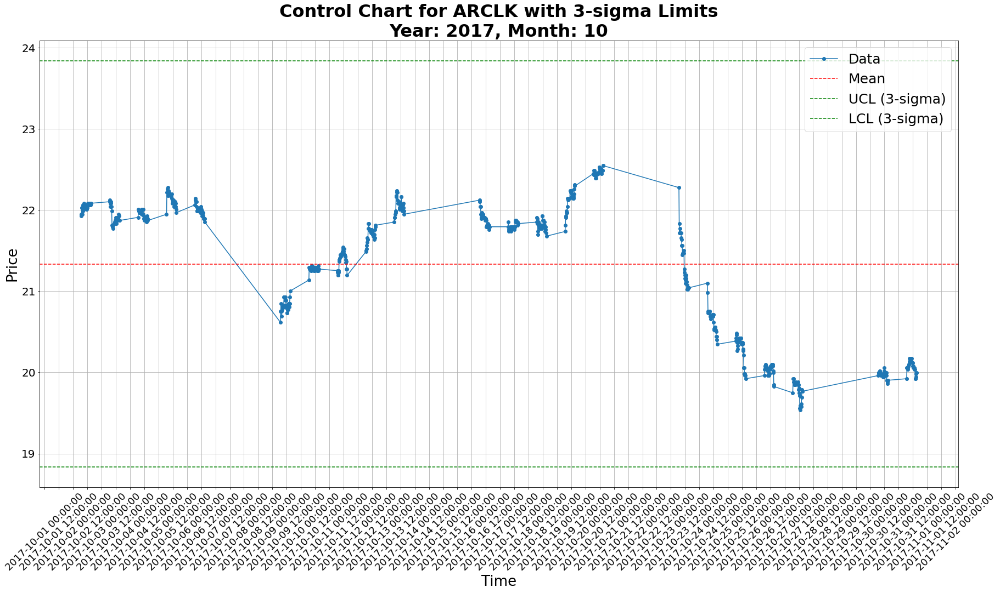

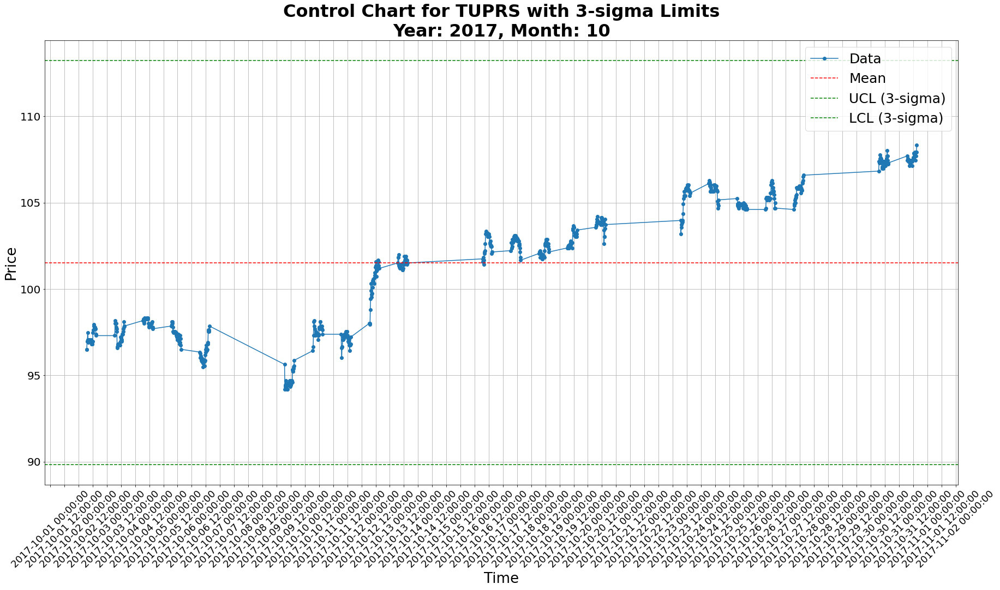

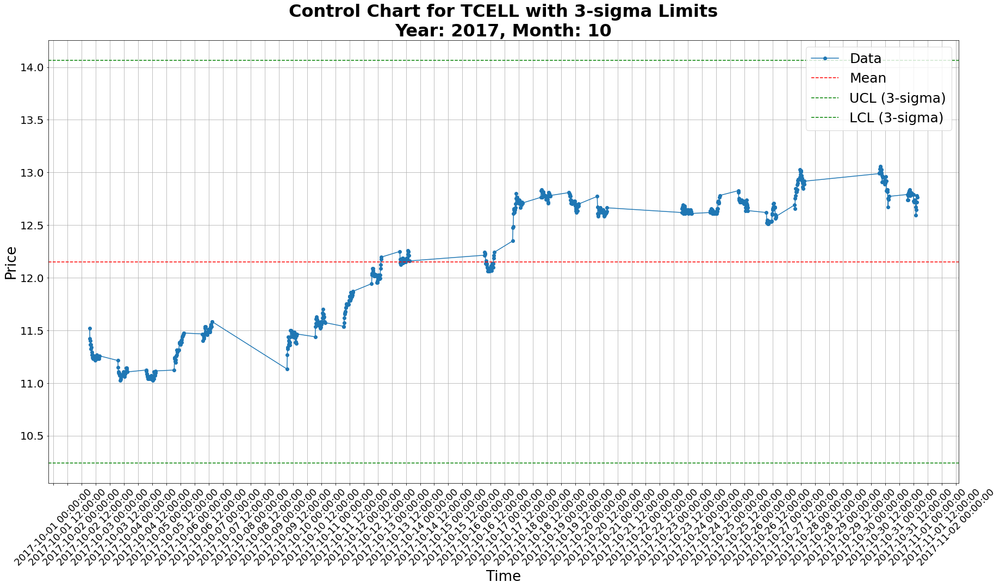

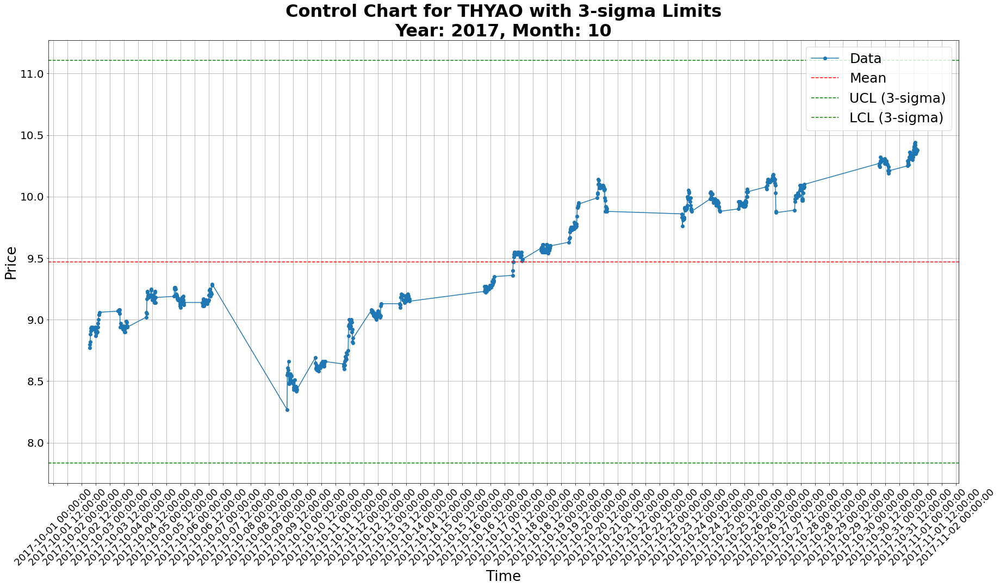

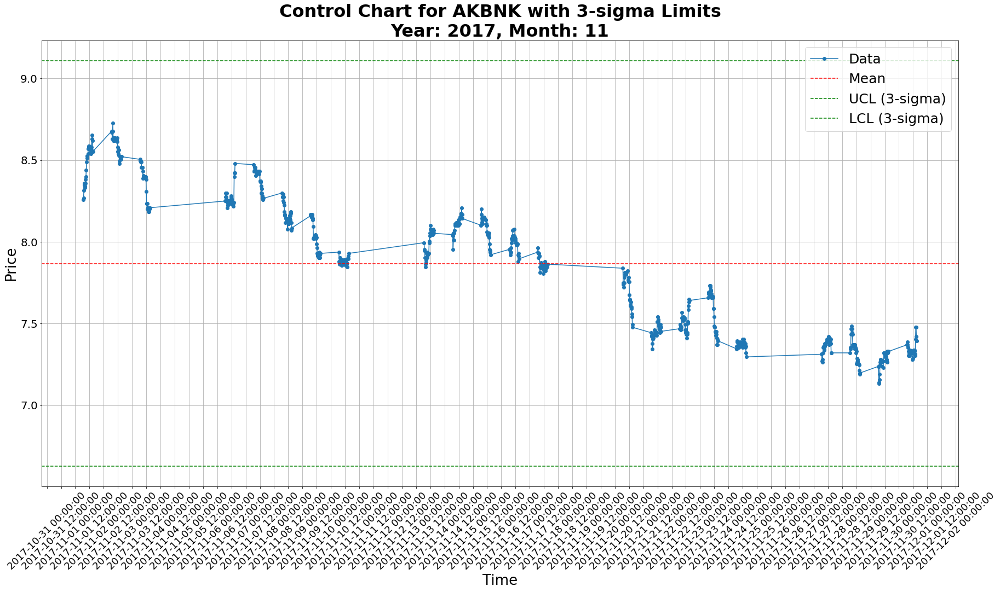

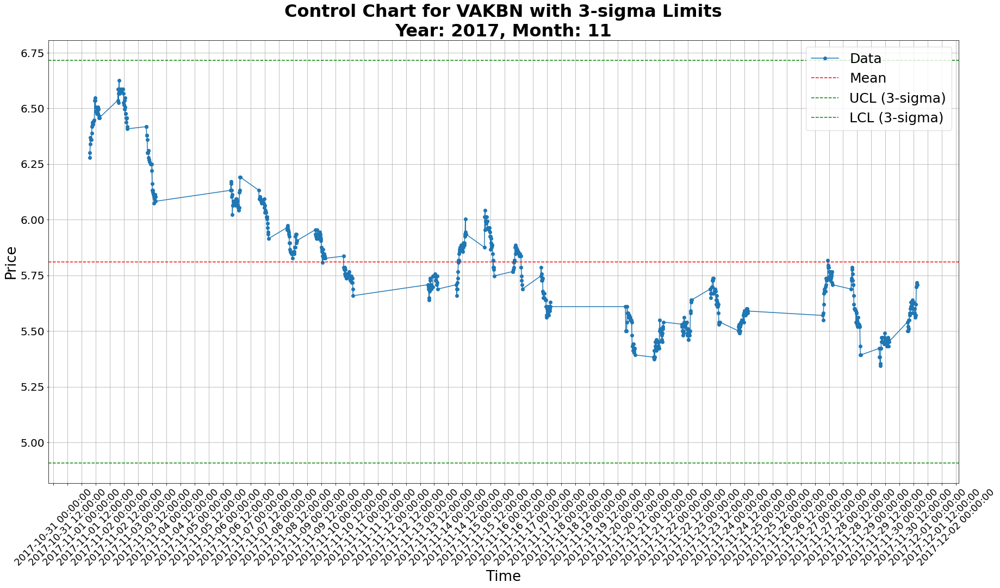

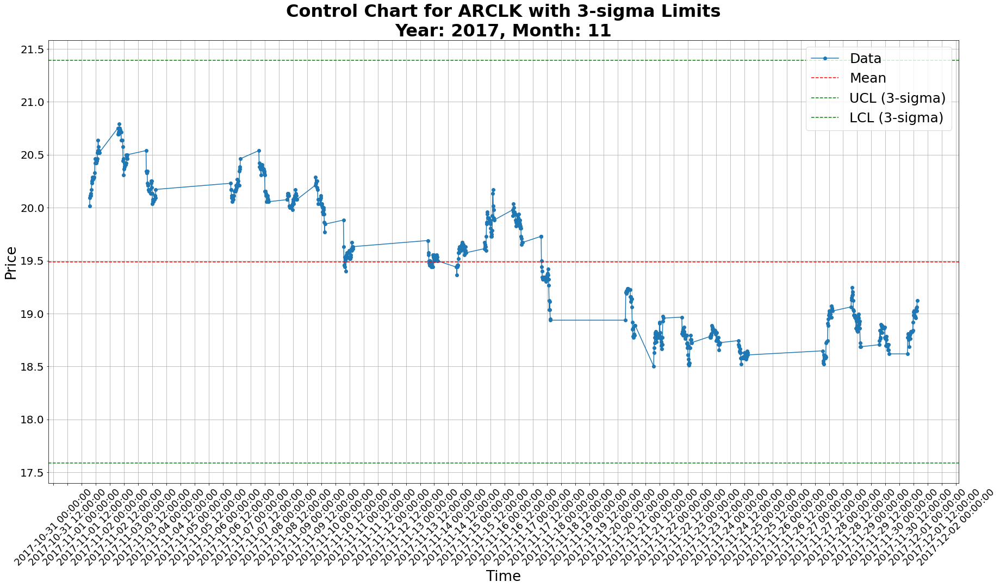

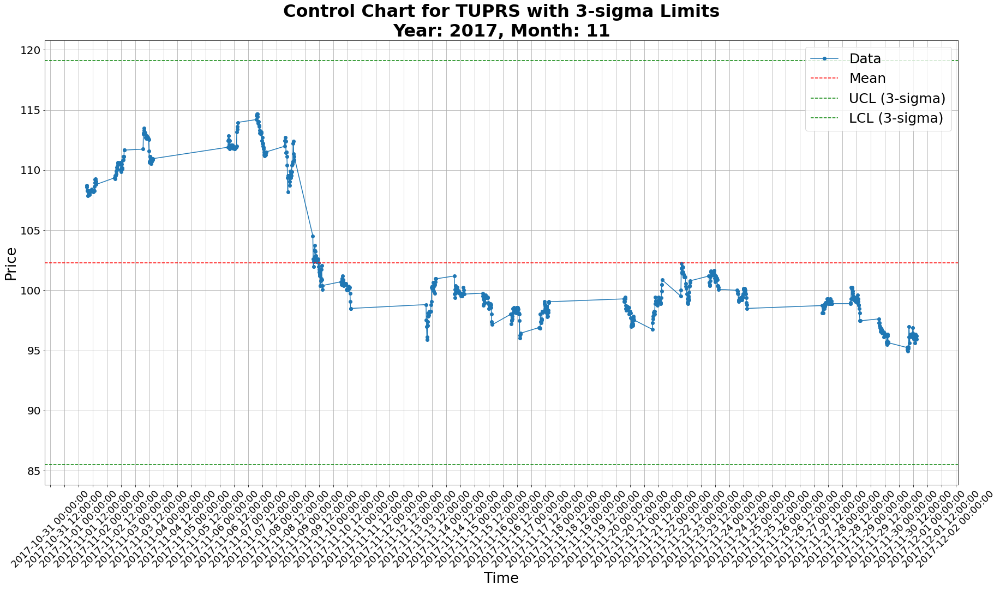

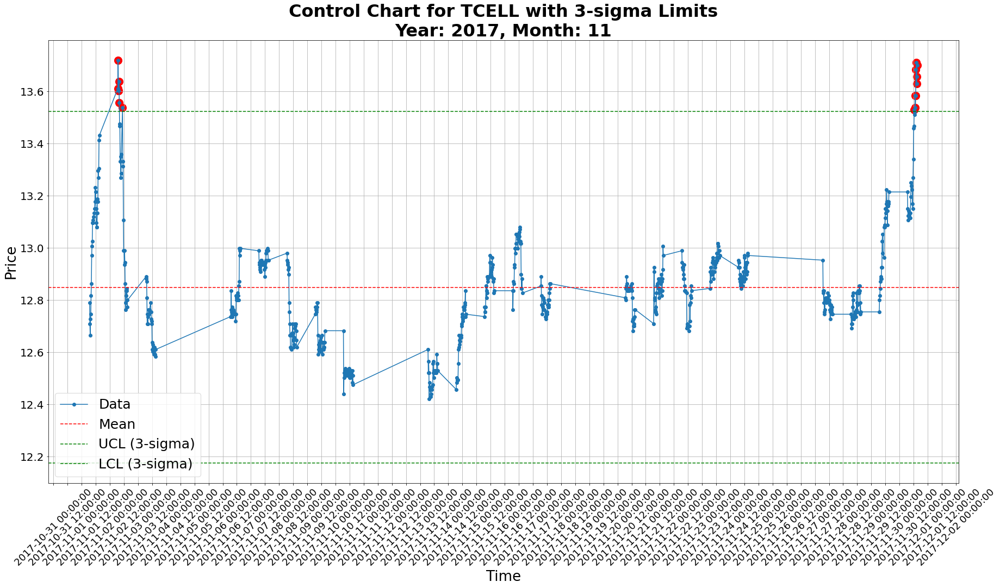

Outliers for TCELL:
Timestamp: 2017-11-02 06:45:00+00:00, Price: 13.6104
Timestamp: 2017-11-02 07:00:00+00:00, Price: 13.7186
Timestamp: 2017-11-02 07:15:00+00:00, Price: 13.6014
Timestamp: 2017-11-02 07:30:00+00:00, Price: 13.6014
Timestamp: 2017-11-02 07:45:00+00:00, Price: 13.6374
Timestamp: 2017-11-02 08:00:00+00:00, Price: 13.5563
Timestamp: 2017-11-02 10:45:00+00:00, Price: 13.5384
Timestamp: 2017-11-30 12:30:00+00:00, Price: 13.5294
Timestamp: 2017-11-30 13:15:00+00:00, Price: 13.5834
Timestamp: 2017-11-30 13:30:00+00:00, Price: 13.5384
Timestamp: 2017-11-30 13:45:00+00:00, Price: 13.5834
Timestamp: 2017-11-30 14:00:00+00:00, Price: 13.6824
Timestamp: 2017-11-30 14:15:00+00:00, Price: 13.7095
Timestamp: 2017-11-30 14:30:00+00:00, Price: 13.6284
Timestamp: 2017-11-30 14:45:00+00:00, Price: 13.6555
Timestamp: 2017-11-30 15:00:00+00:00, Price: 13.7005


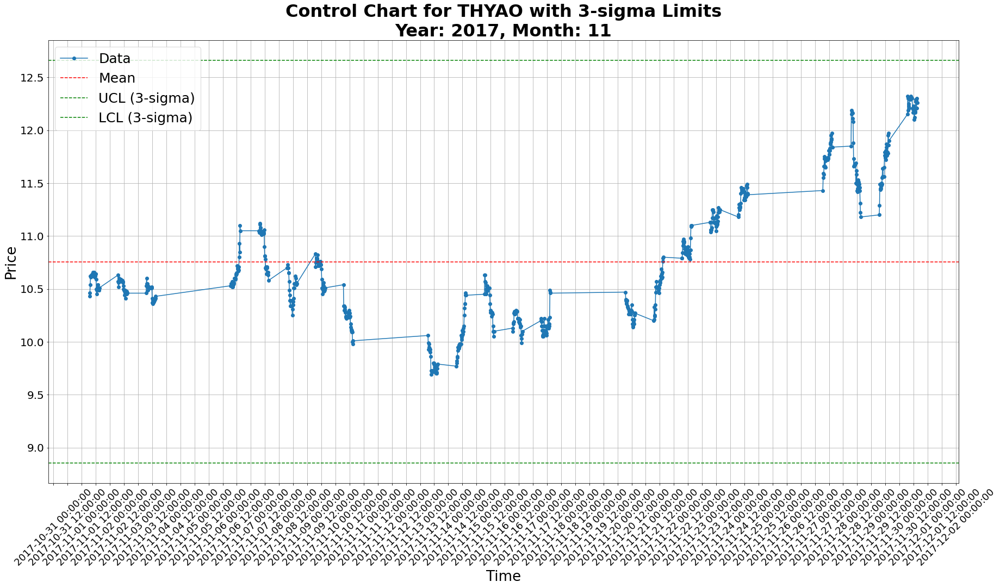

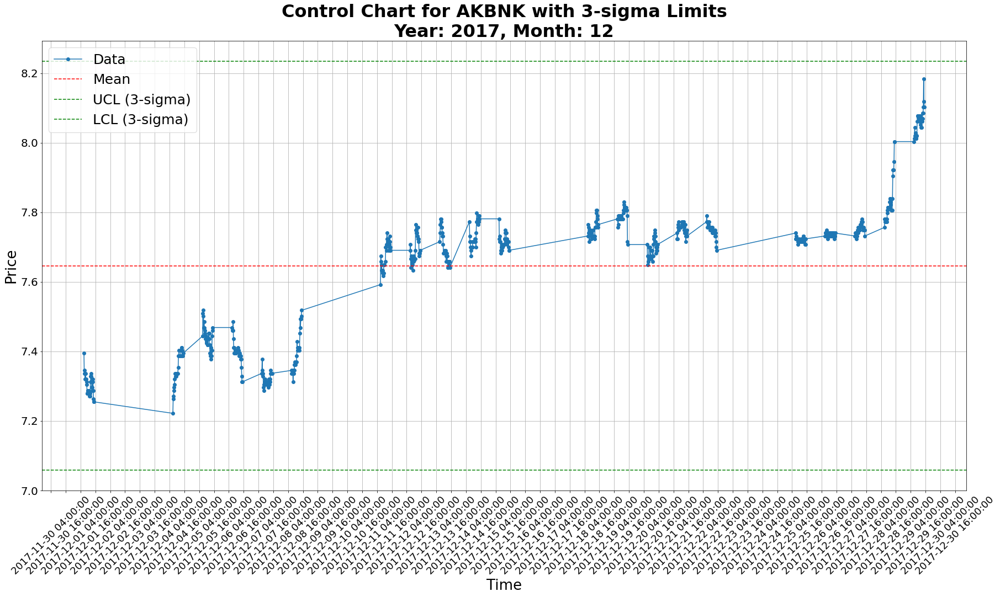

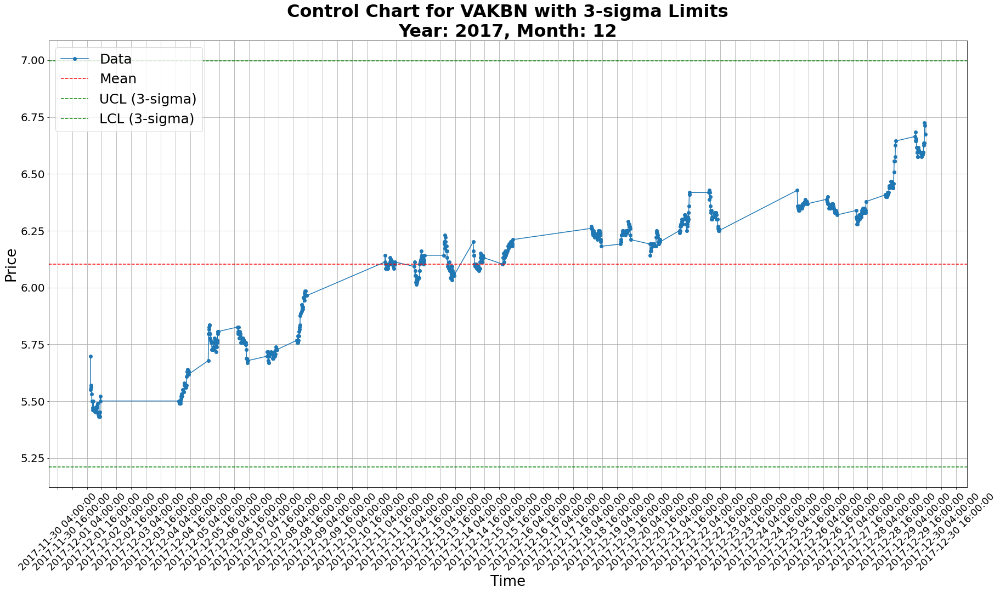

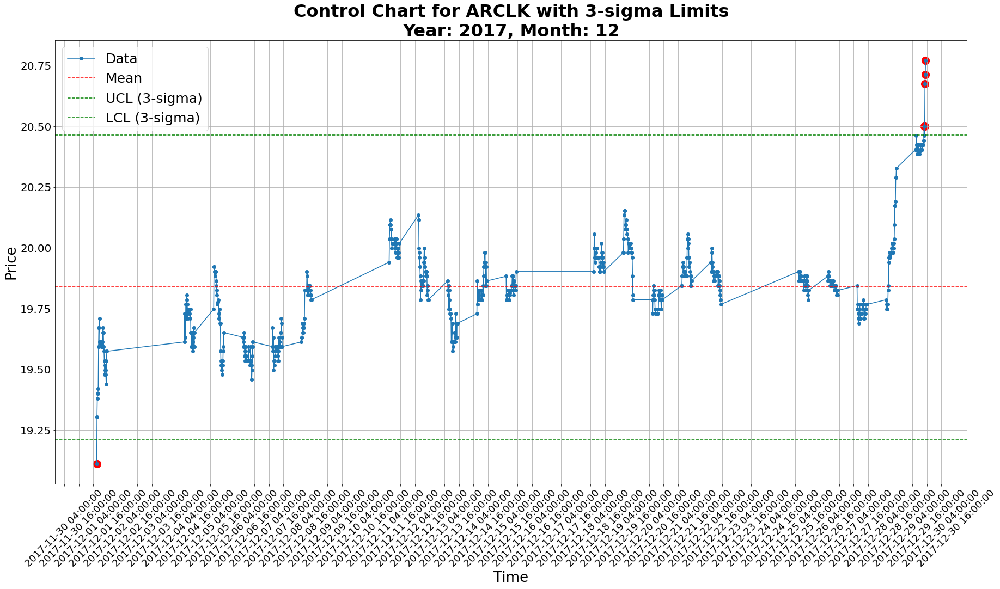

Outliers for ARCLK:
Timestamp: 2017-12-01 06:45:00+00:00, Price: 19.1114
Timestamp: 2017-12-29 13:45:00+00:00, Price: 20.5013
Timestamp: 2017-12-29 14:15:00+00:00, Price: 20.5013
Timestamp: 2017-12-29 14:30:00+00:00, Price: 20.6751
Timestamp: 2017-12-29 14:45:00+00:00, Price: 20.7137
Timestamp: 2017-12-29 15:00:00+00:00, Price: 20.7716


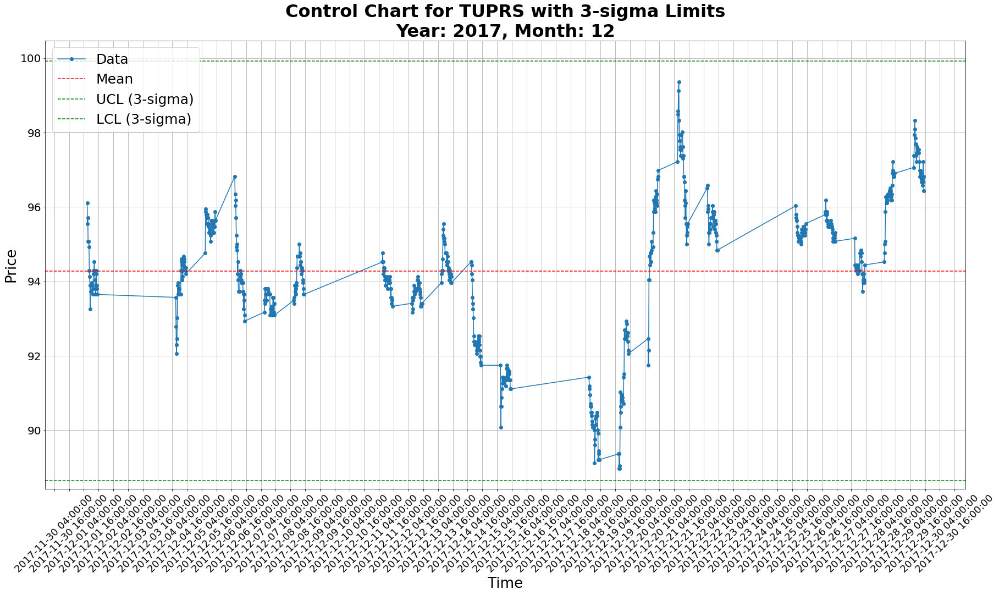

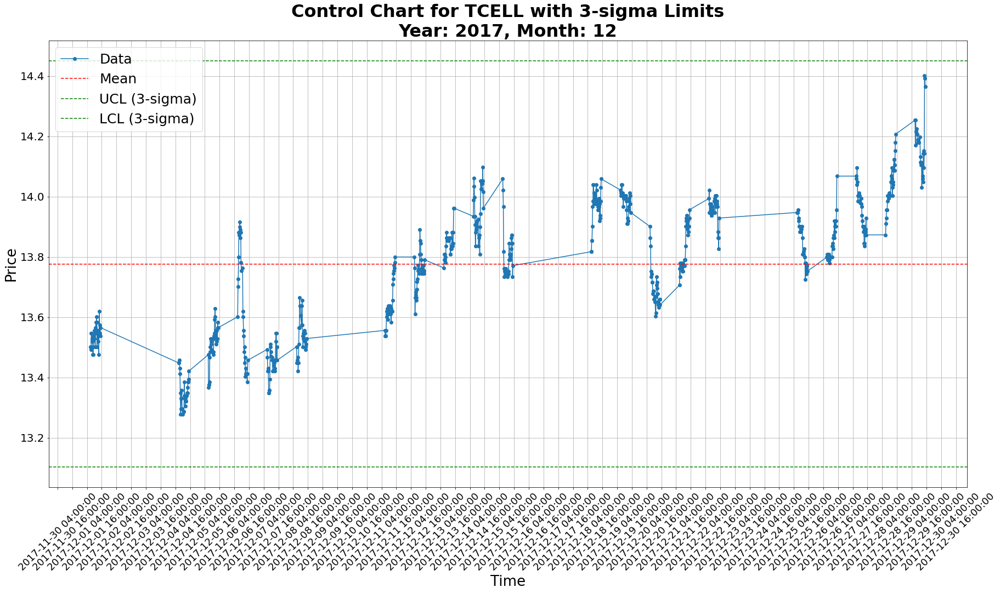

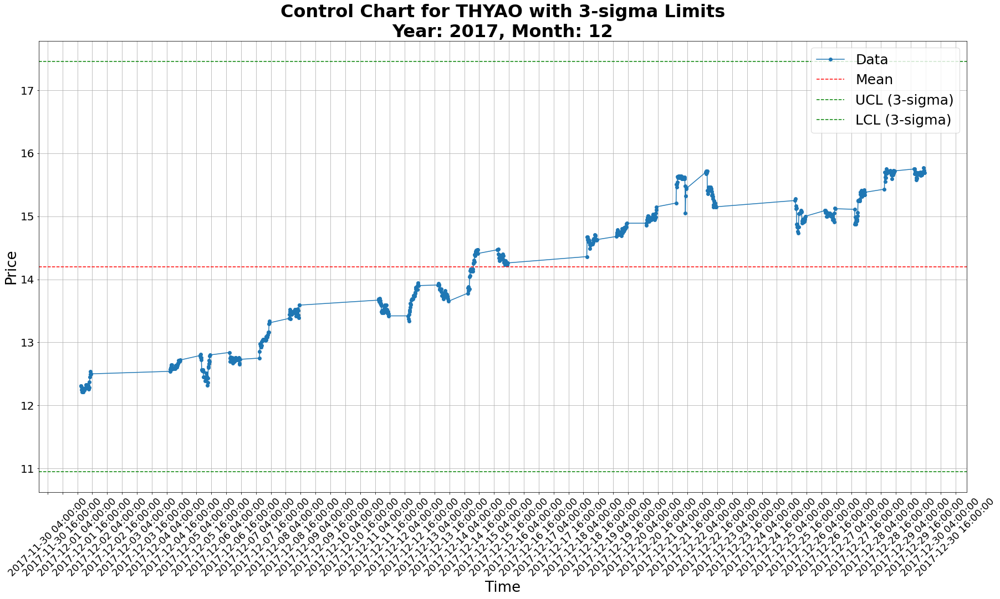

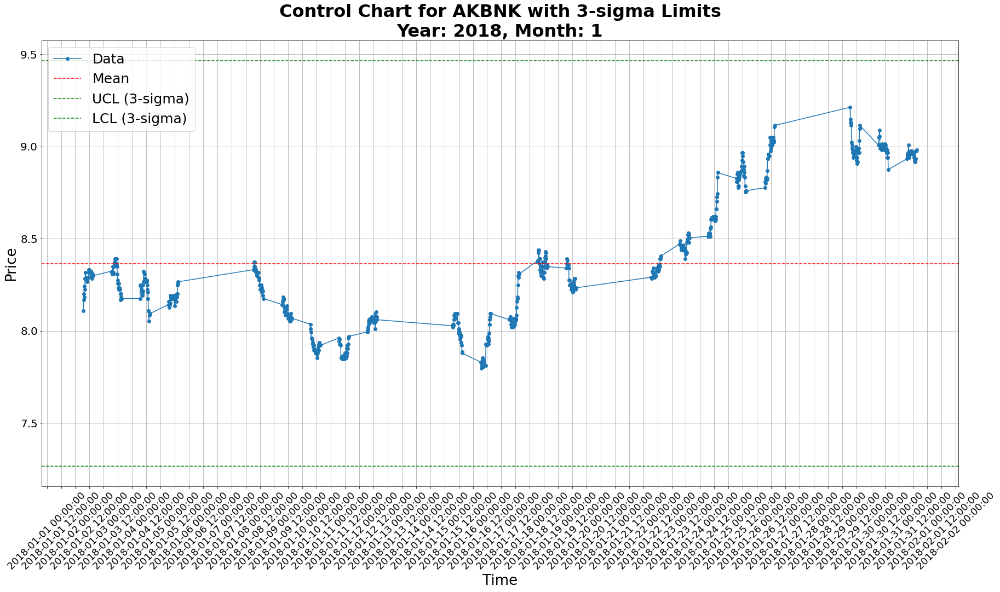

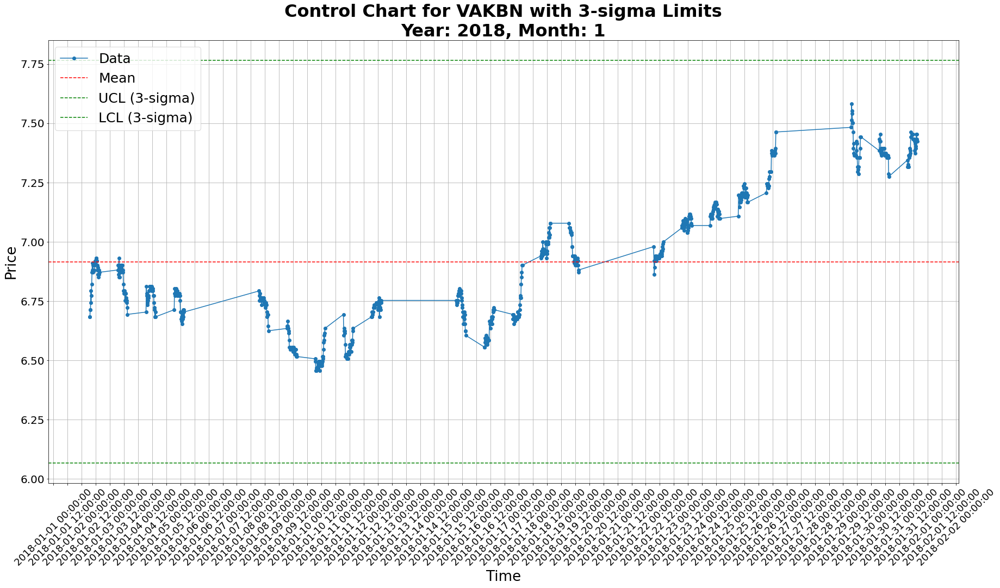

...

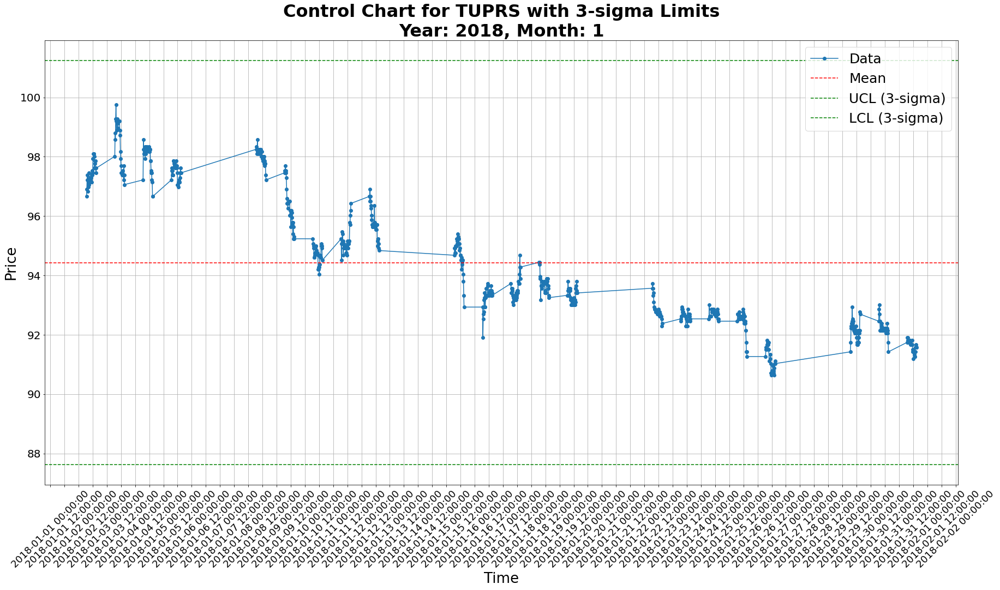

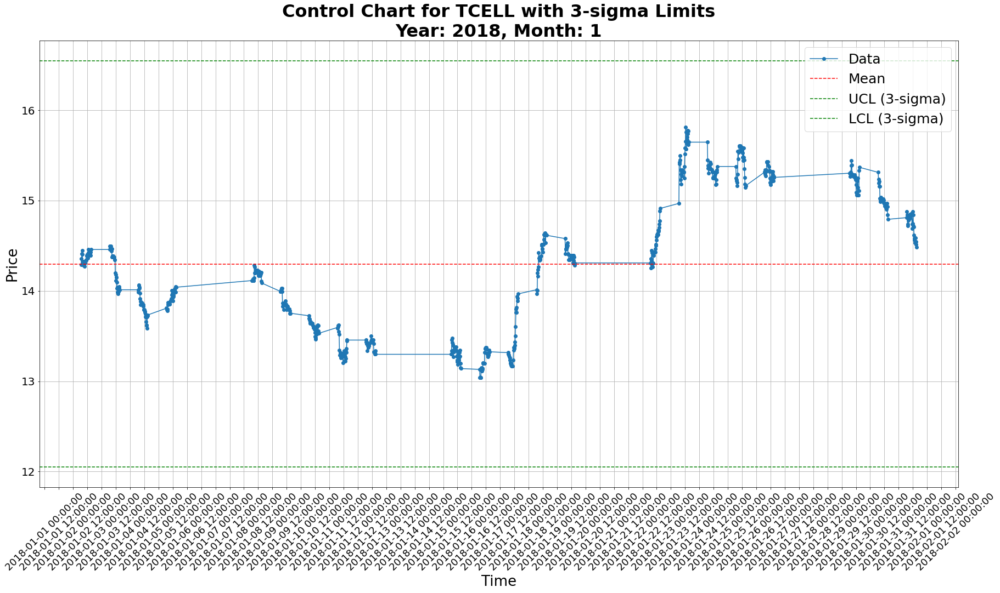

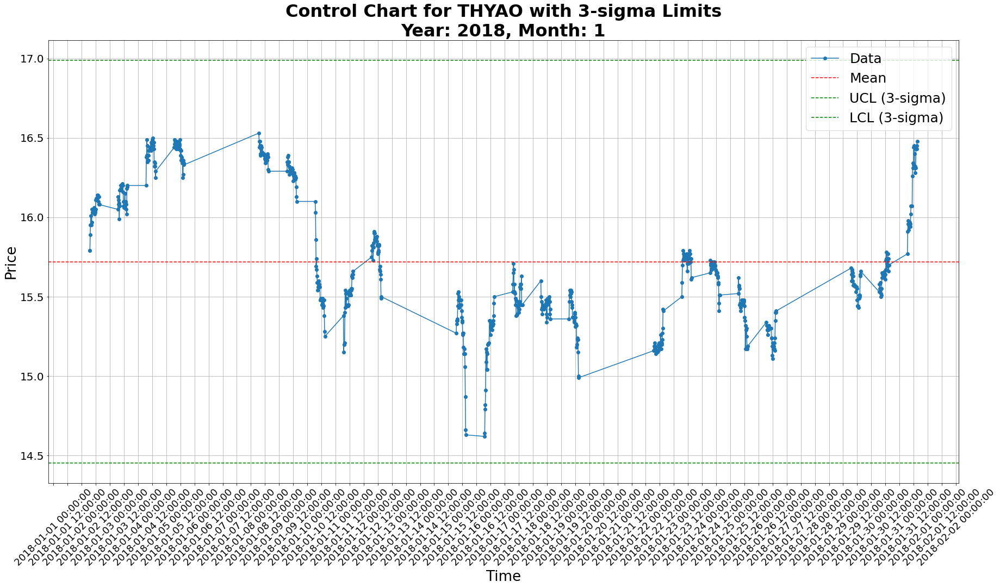

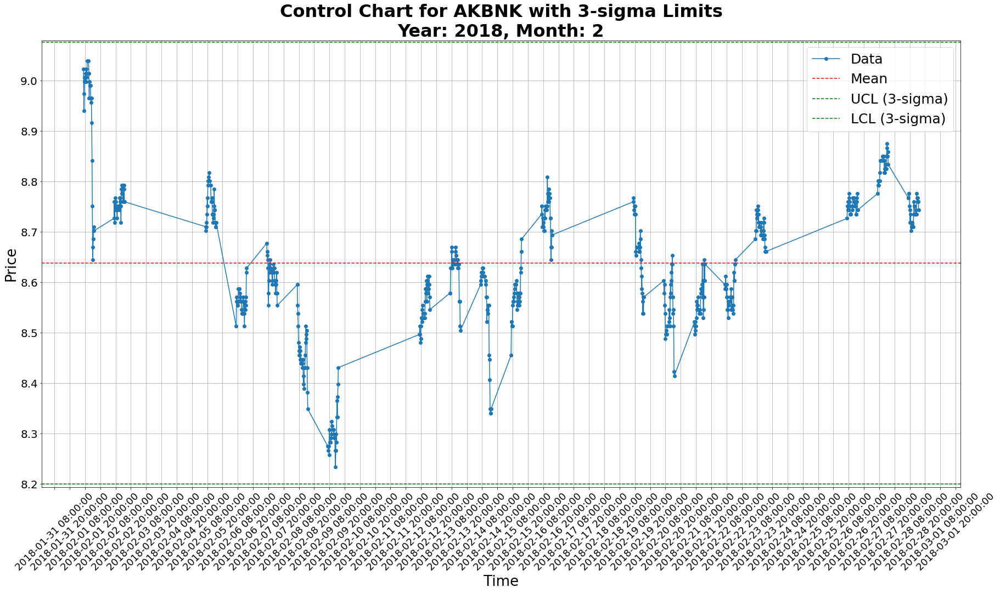

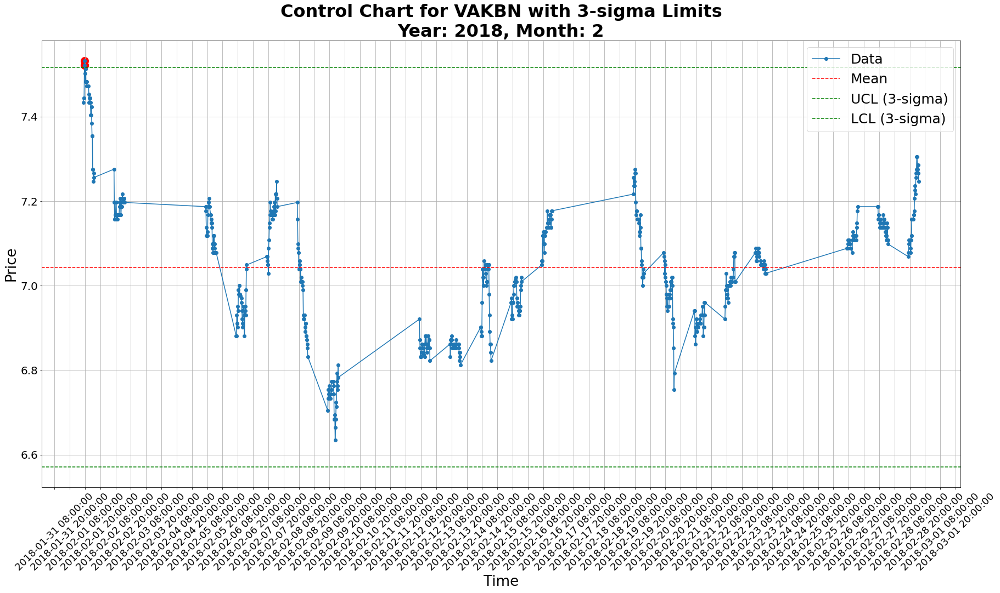

Outliers for VAKBN:
Timestamp: 2018-02-01 07:30:00+00:00, Price: 7.5222
Timestamp: 2018-02-01 07:45:00+00:00, Price: 7.5321


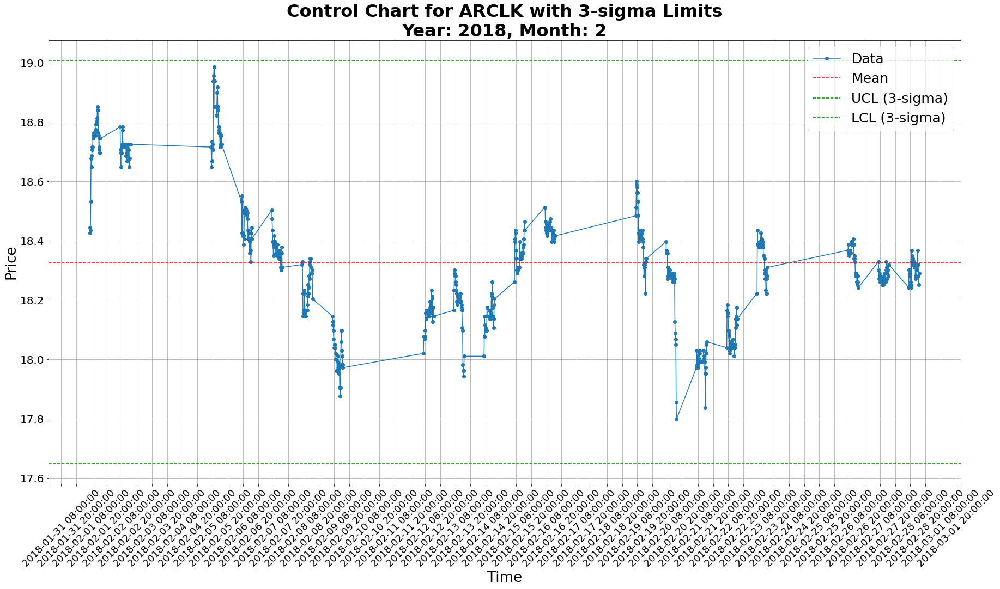

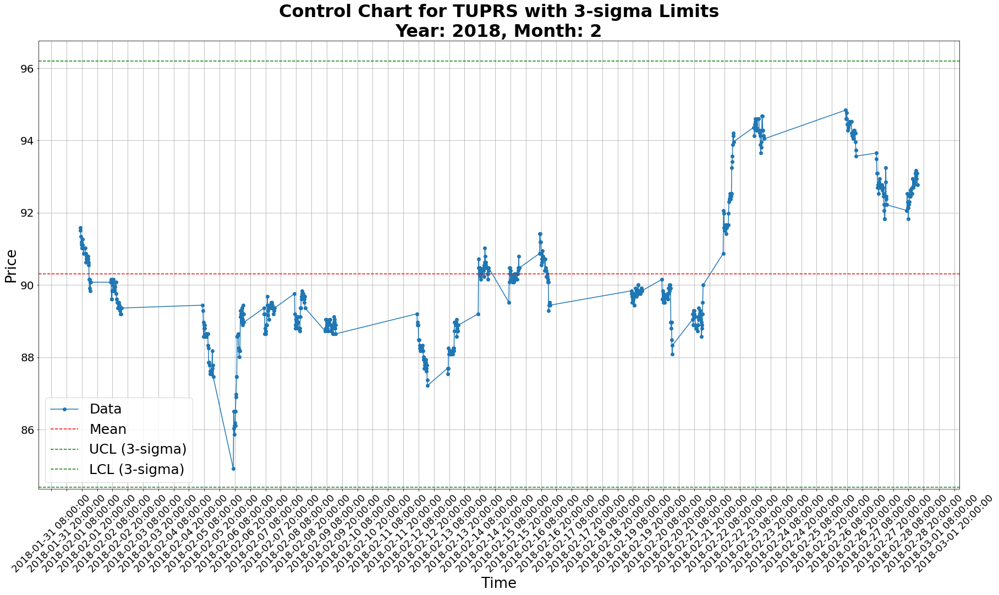

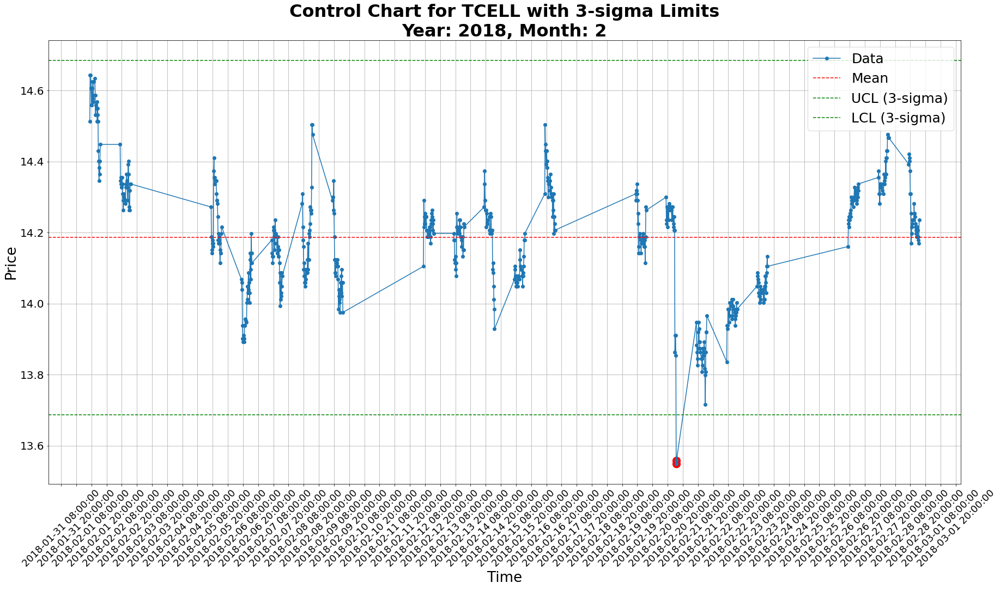

Outliers for TCELL:
Timestamp: 2018-02-20 14:45:00+00:00, Price: 13.5483
Timestamp: 2018-02-20 15:00:00+00:00, Price: 13.5576


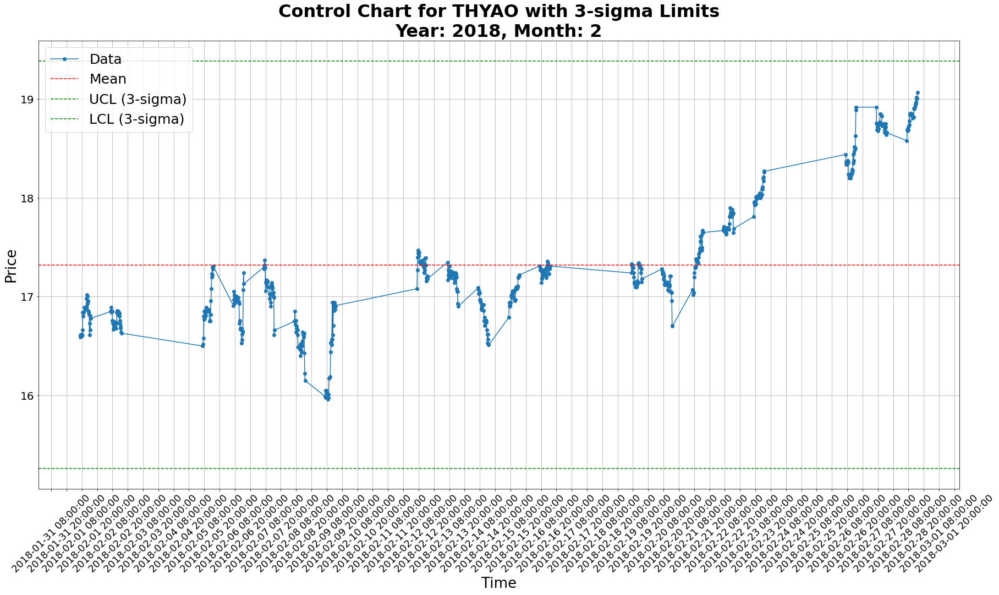

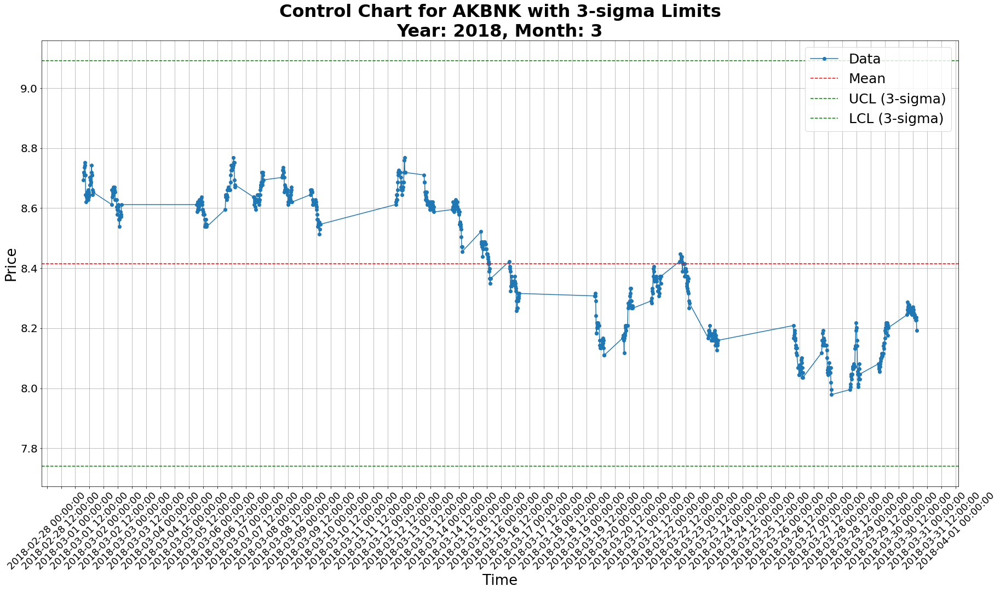

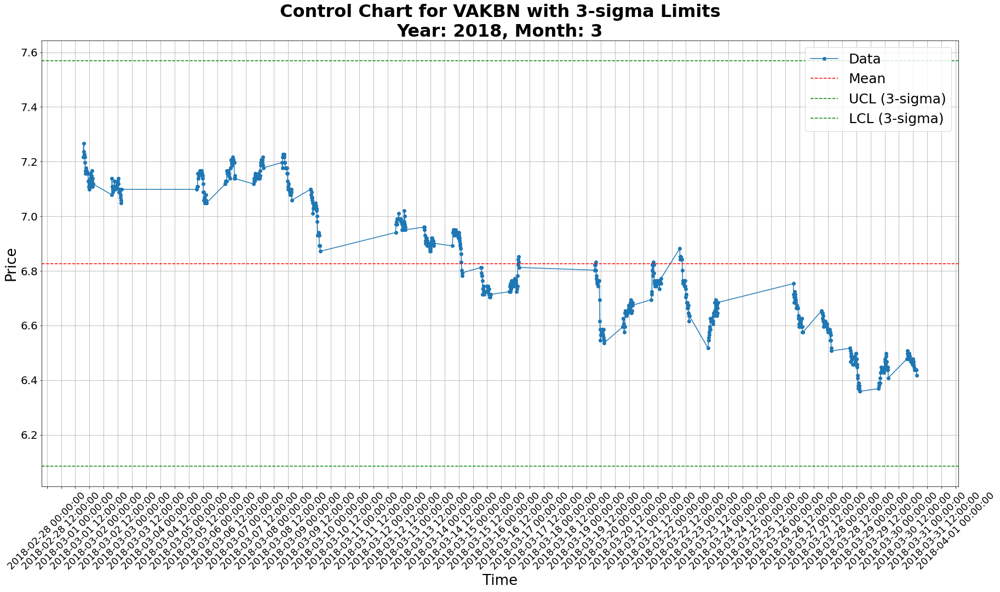

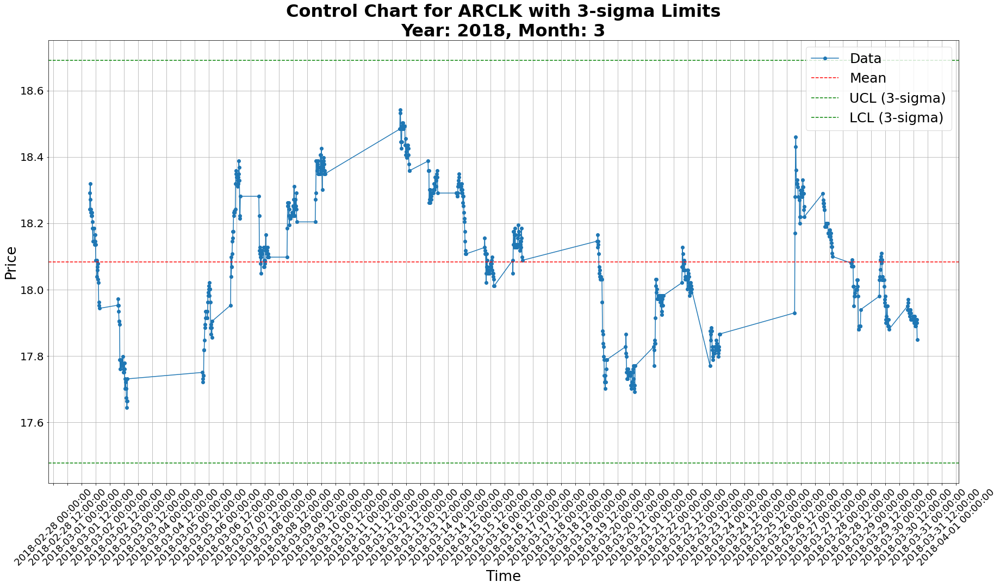

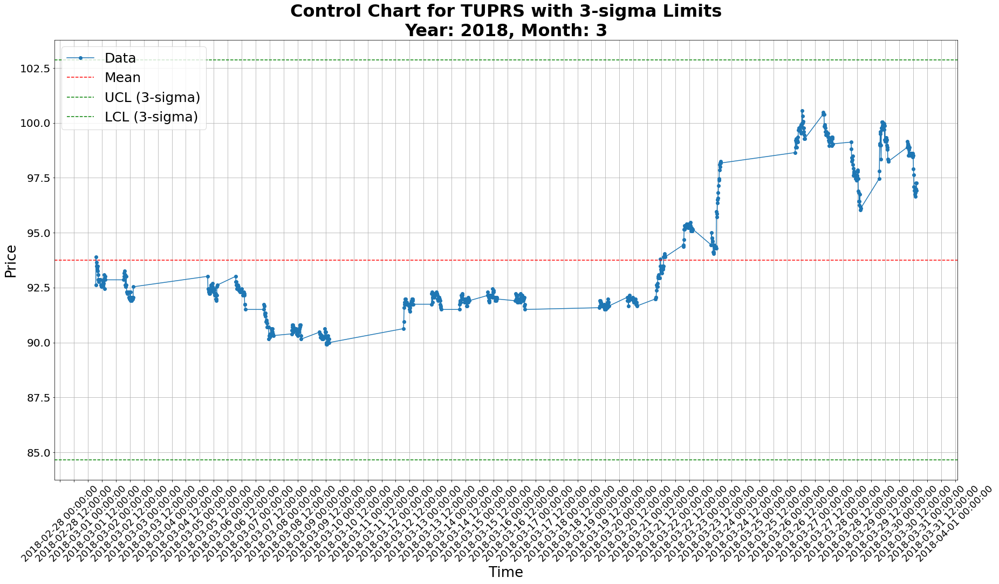

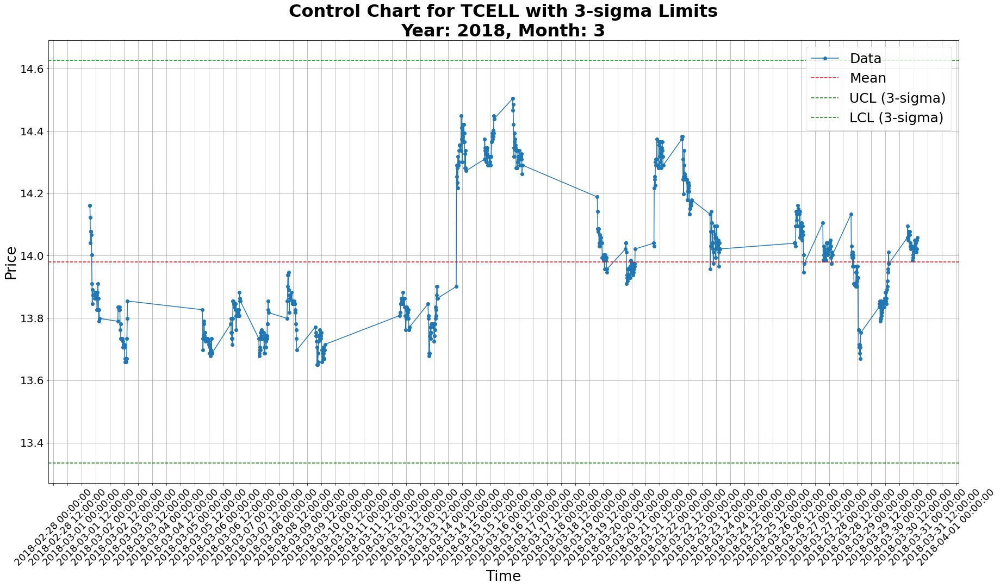

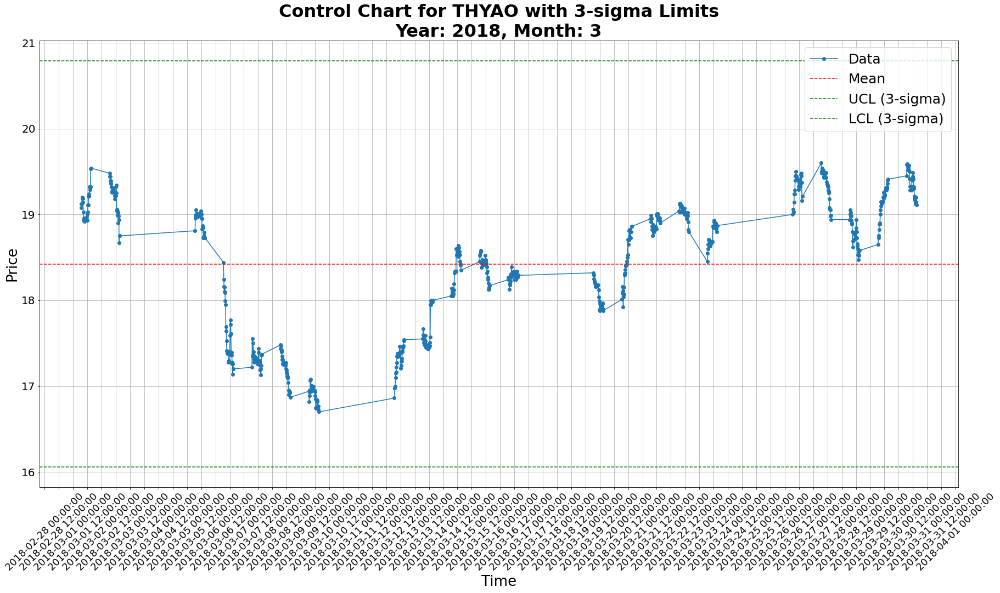

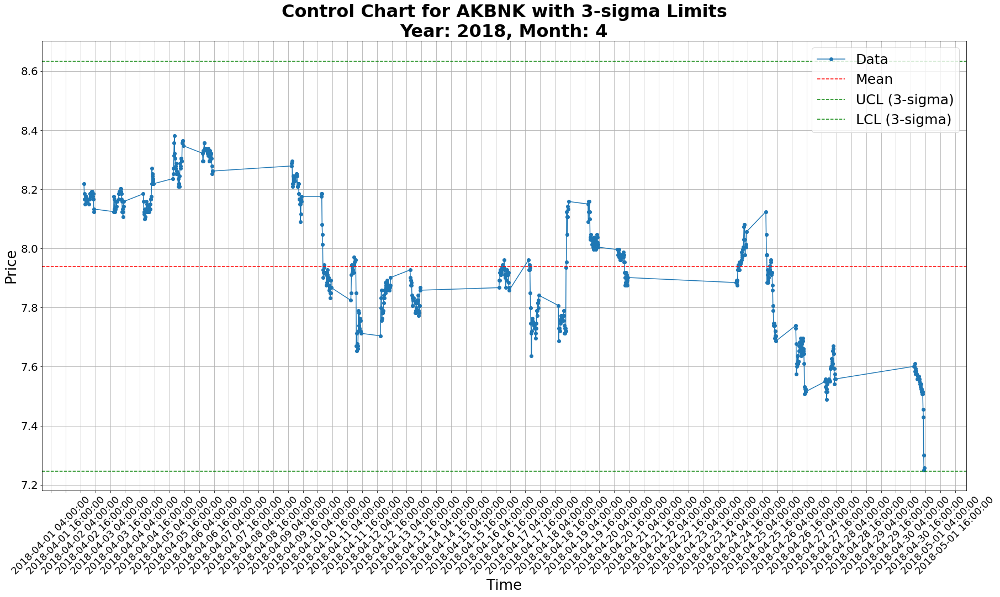

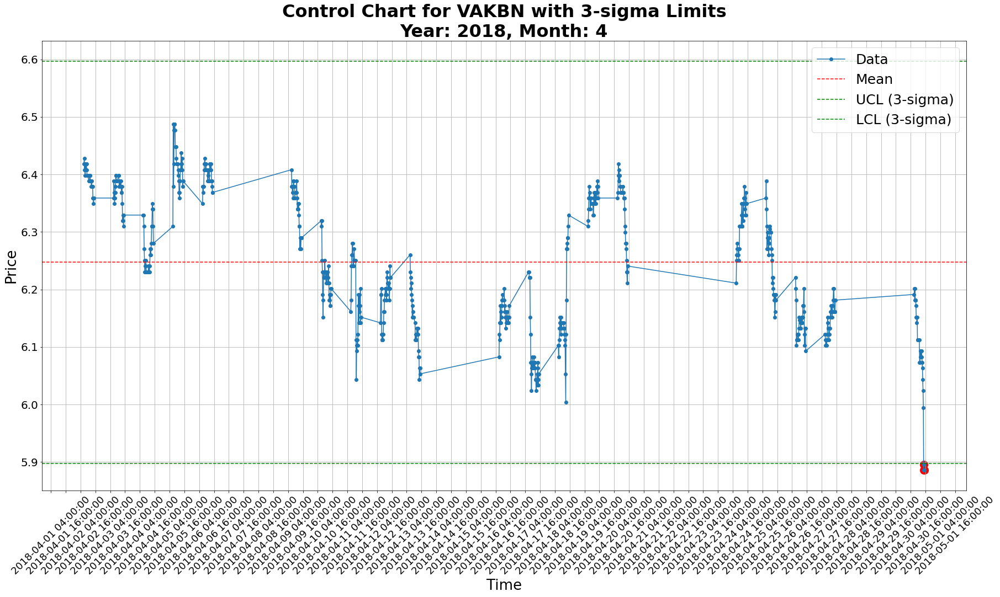

Outliers for VAKBN:
Timestamp: 2018-04-30 14:30:00+00:00, Price: 5.8857
Timestamp: 2018-04-30 14:45:00+00:00, Price: 5.8955
Timestamp: 2018-04-30 15:00:00+00:00, Price: 5.8857


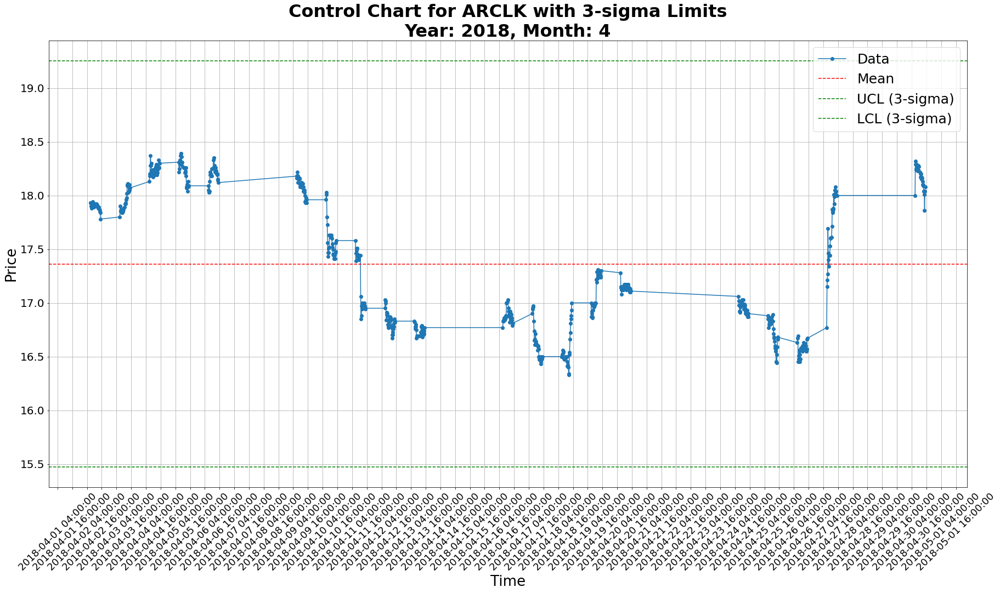

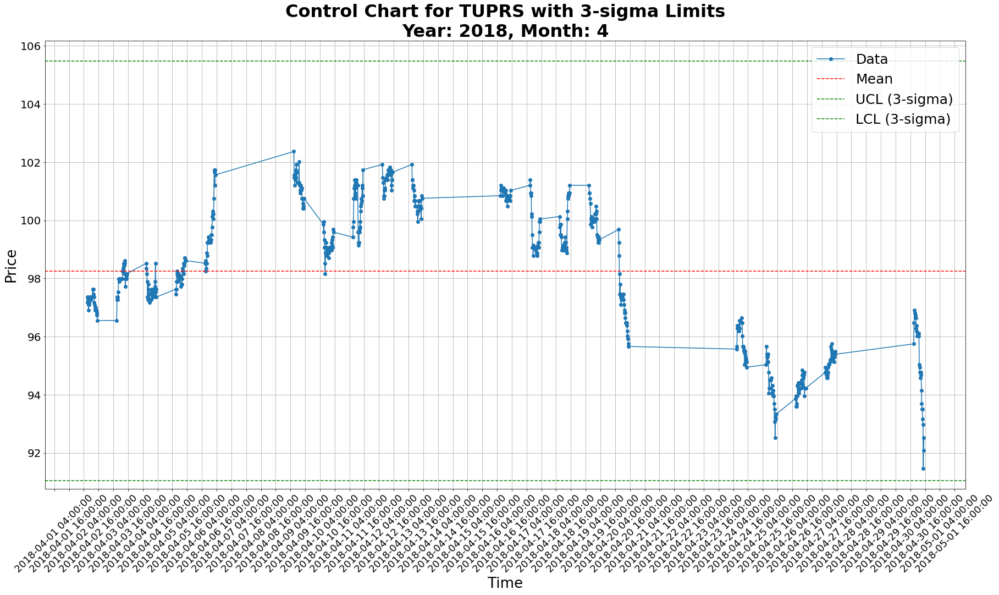

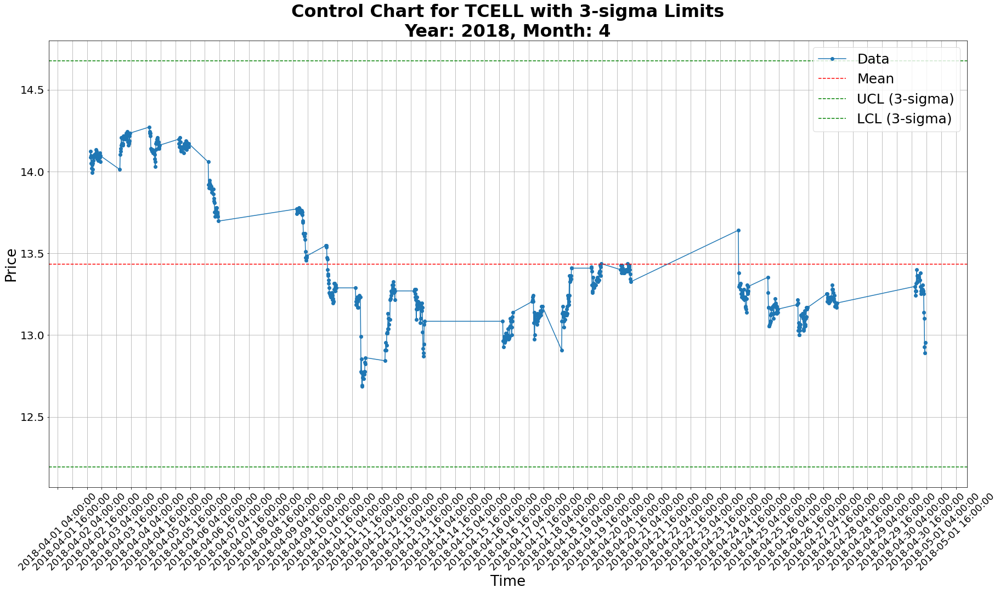

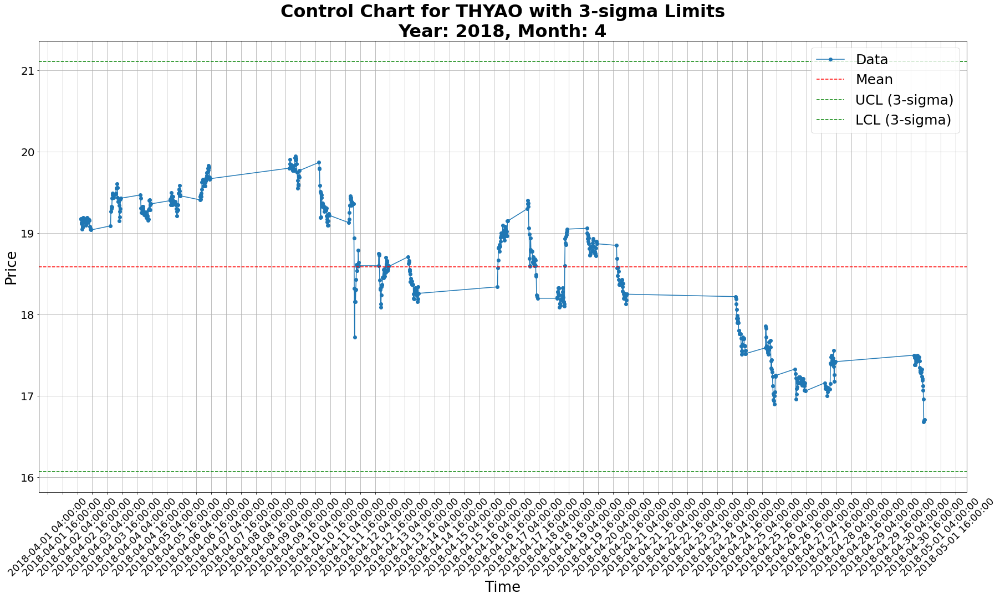

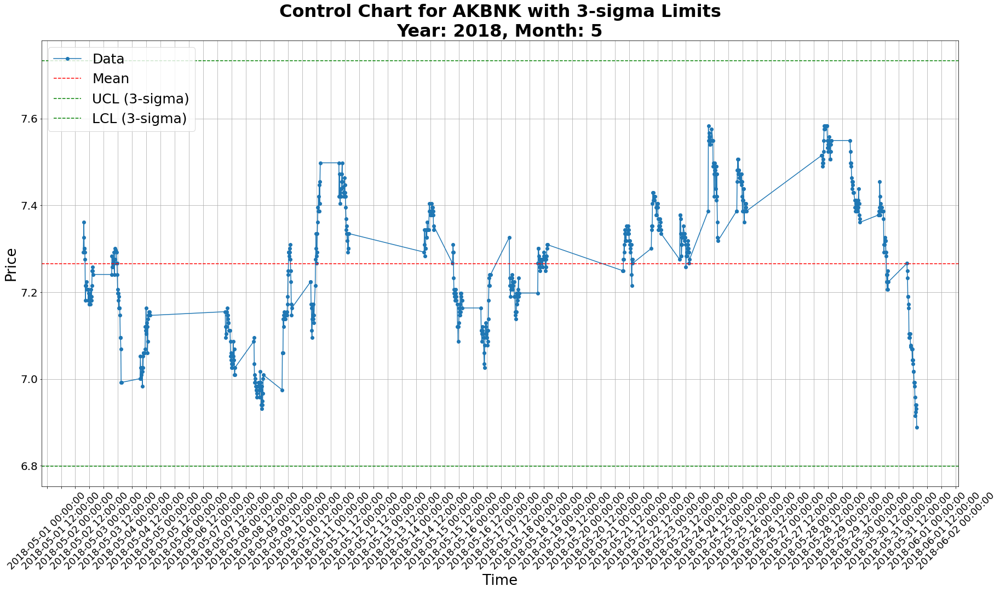

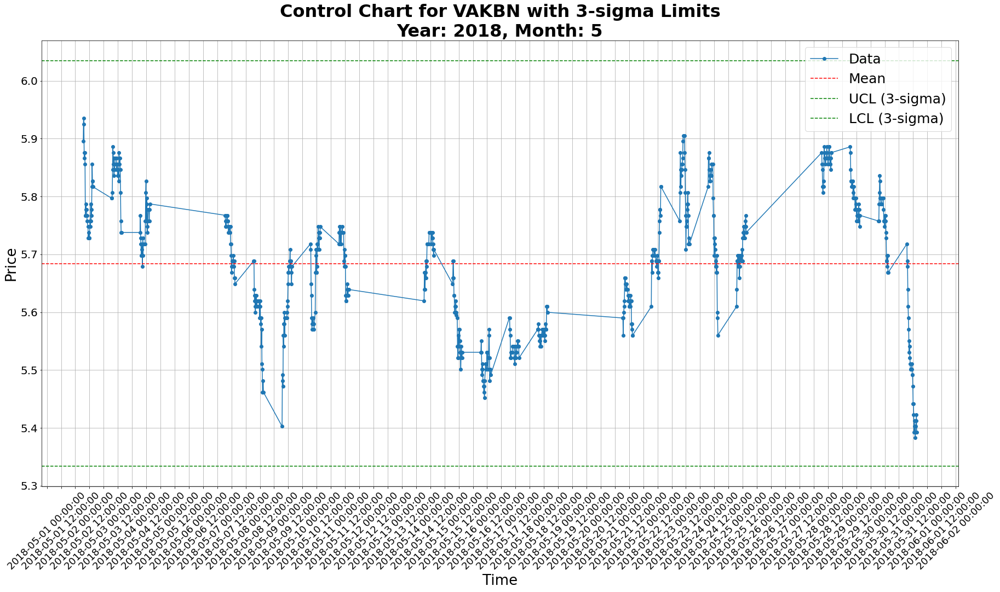

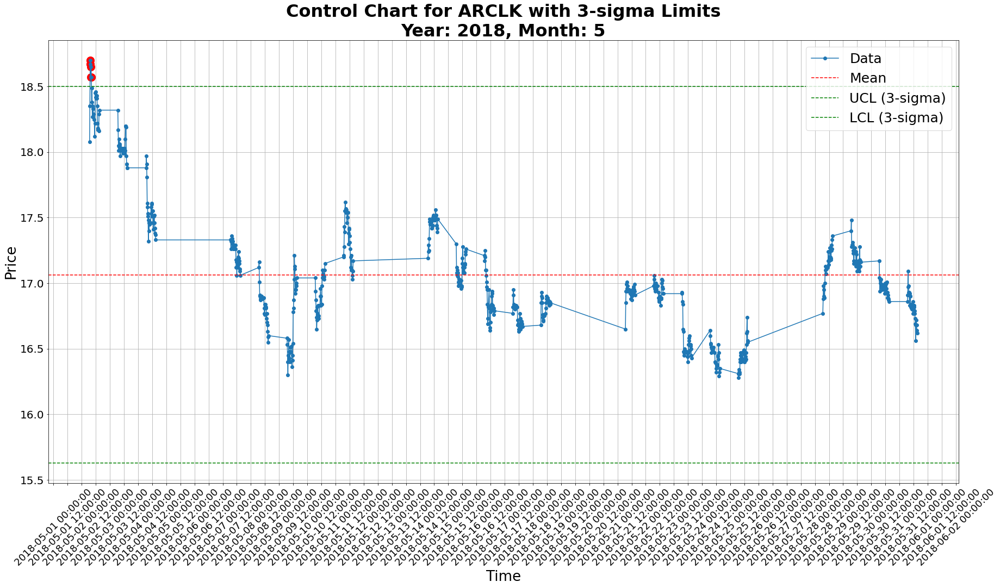

Outliers for ARCLK:
Timestamp: 2018-05-02 07:15:00+00:00, Price: 18.67
Timestamp: 2018-05-02 07:30:00+00:00, Price: 18.7
Timestamp: 2018-05-02 07:45:00+00:00, Price: 18.57
Timestamp: 2018-05-02 08:00:00+00:00, Price: 18.65
Timestamp: 2018-05-02 08:15:00+00:00, Price: 18.57


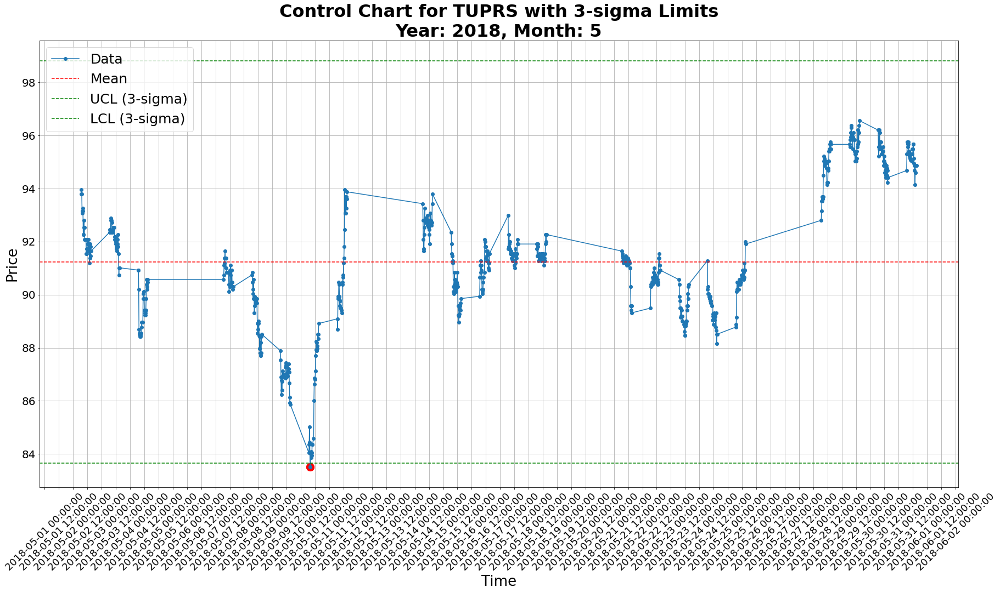

Outliers for TUPRS:
Timestamp: 2018-05-10 07:45:00+00:00, Price: 83.5047
Timestamp: 2018-05-10 08:00:00+00:00, Price: 83.5047


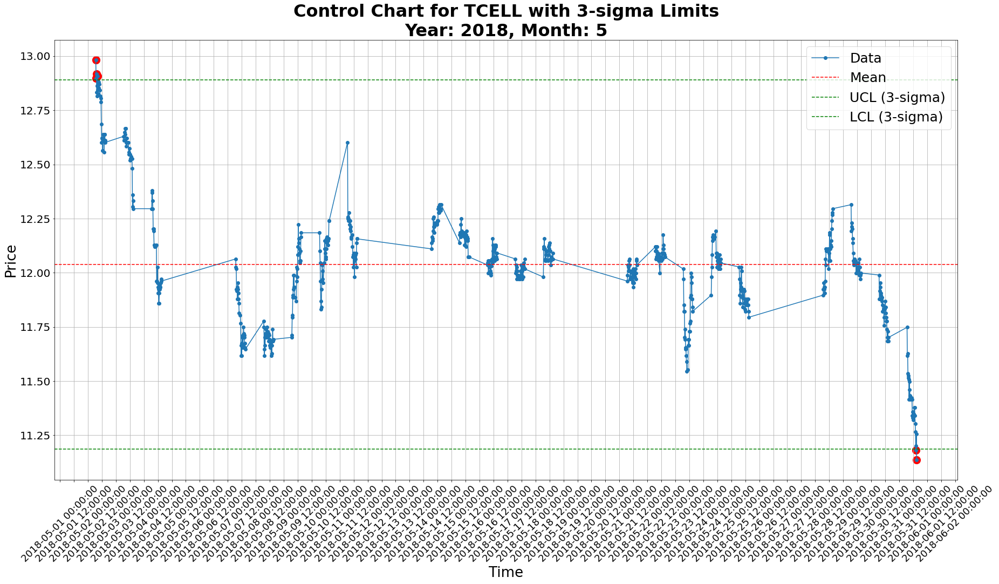

Outliers for TCELL:
Timestamp: 2018-05-02 06:45:00+00:00, Price: 12.9823
Timestamp: 2018-05-02 07:00:00+00:00, Price: 12.8987
Timestamp: 2018-05-02 07:15:00+00:00, Price: 12.9173
Timestamp: 2018-05-02 08:15:00+00:00, Price: 12.908
Timestamp: 2018-05-31 14:15:00+00:00, Price: 11.1821
Timestamp: 2018-05-31 15:00:00+00:00, Price: 11.1356


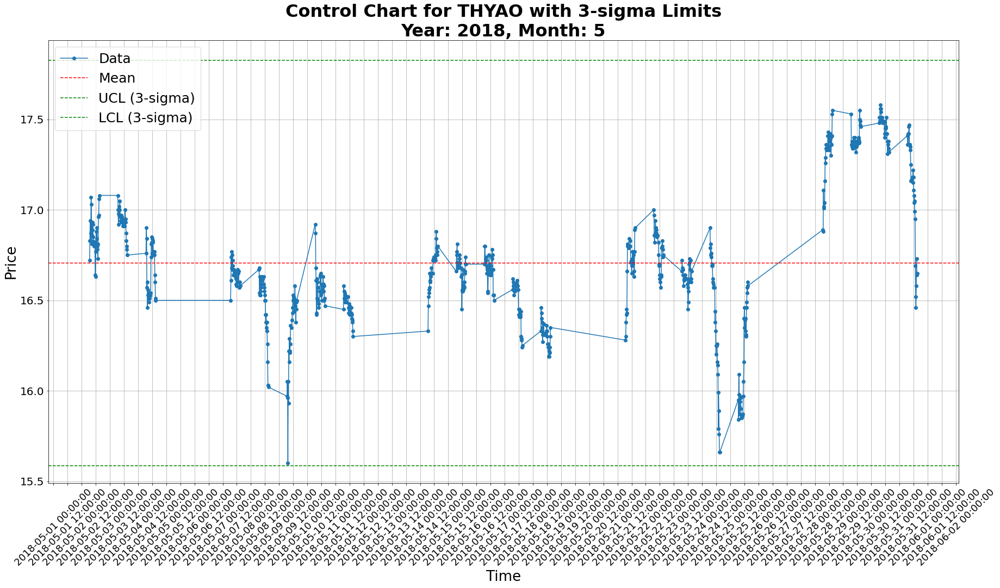

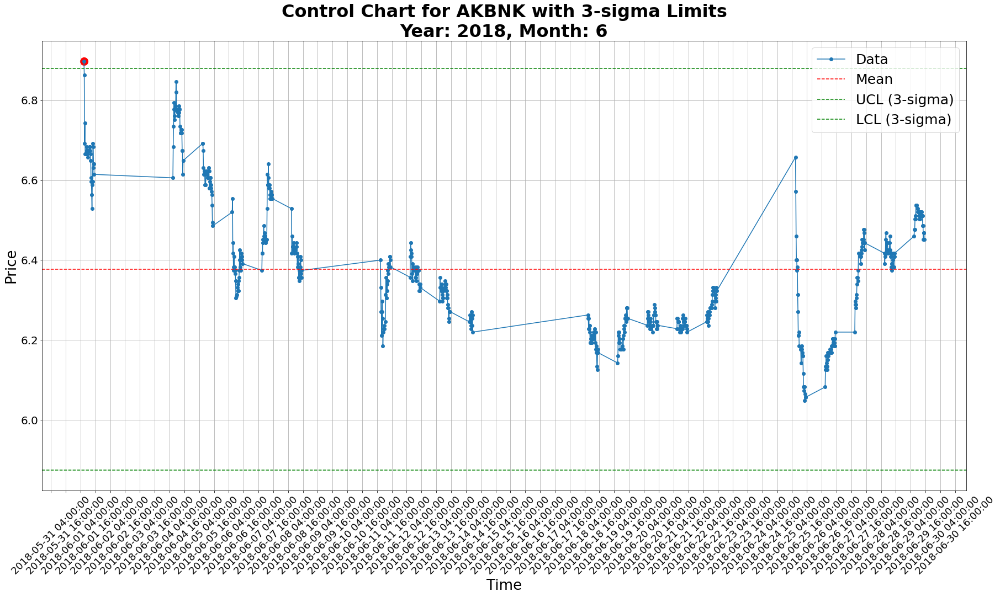

Outliers for AKBNK:
Timestamp: 2018-06-01 06:45:00+00:00, Price: 6.8976


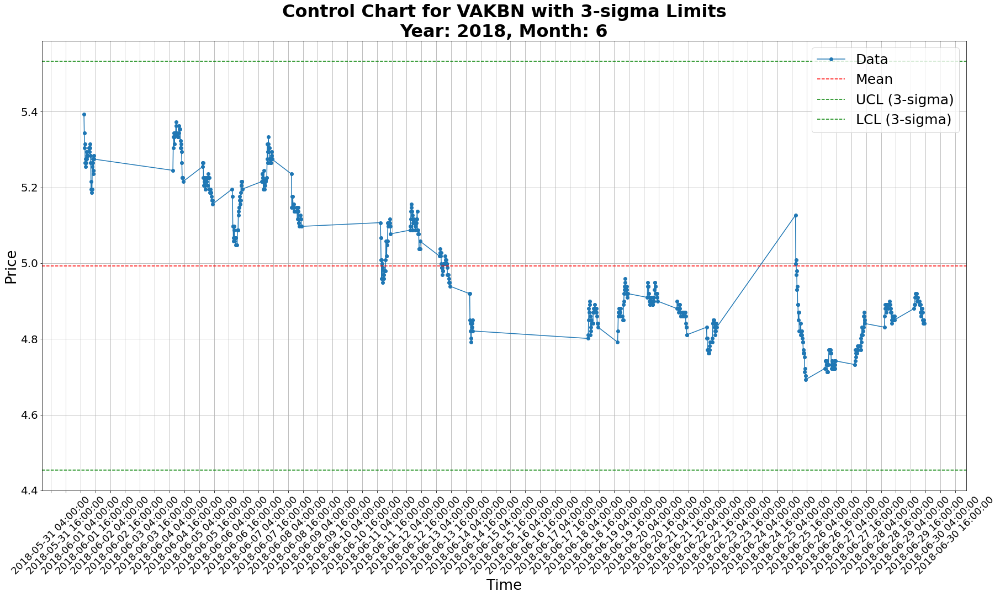

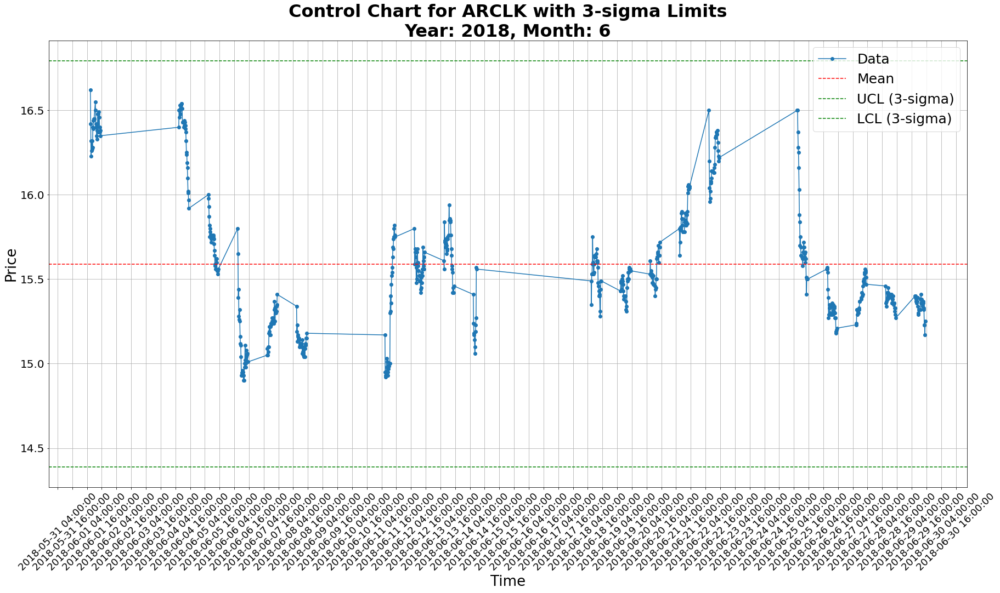

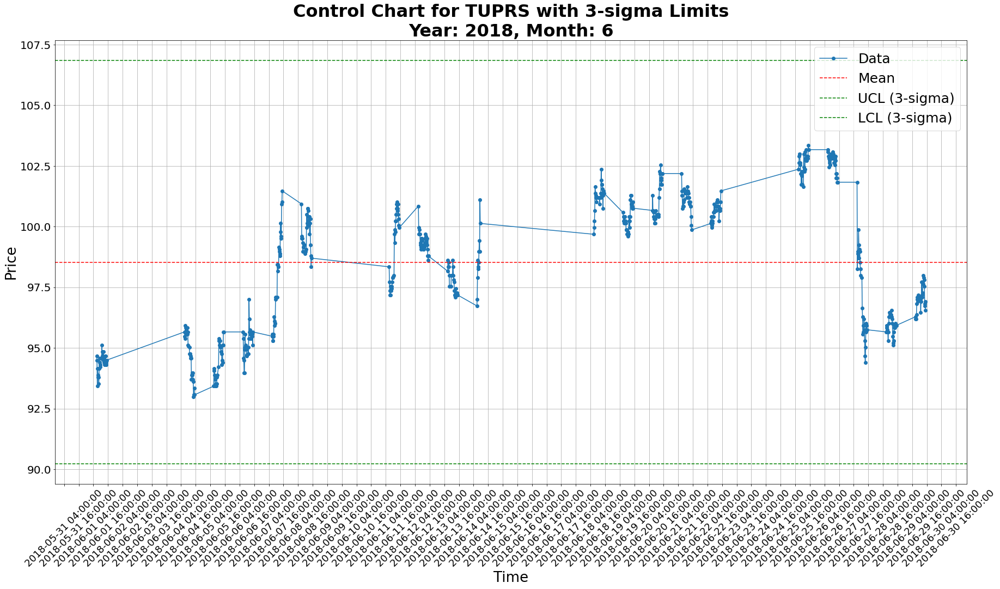

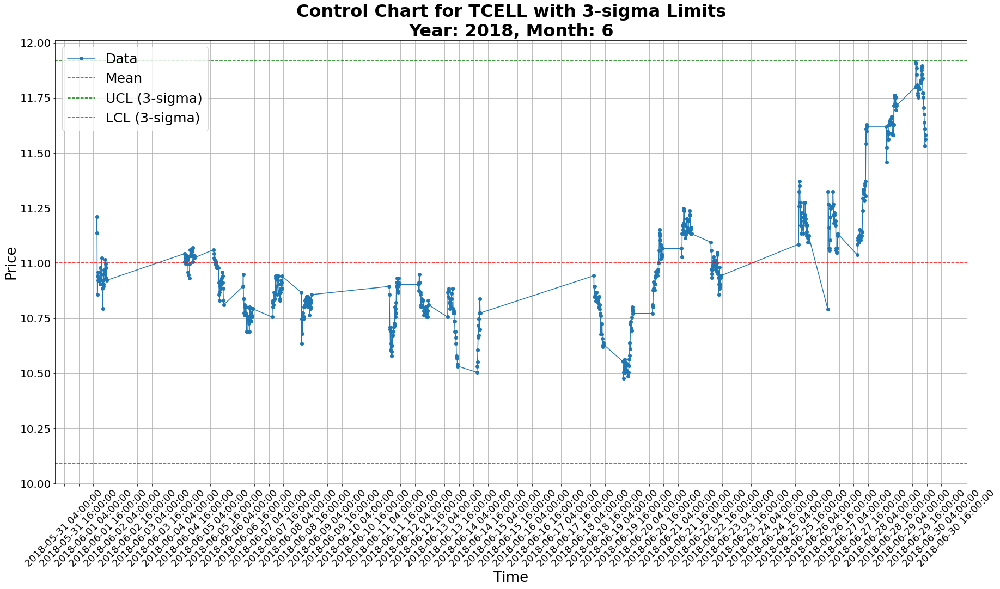

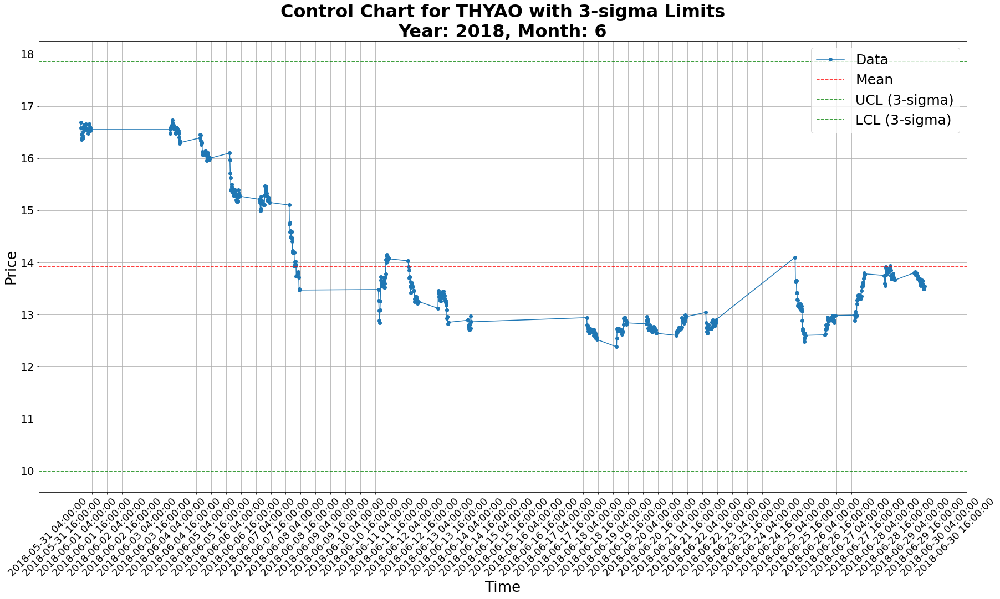

...

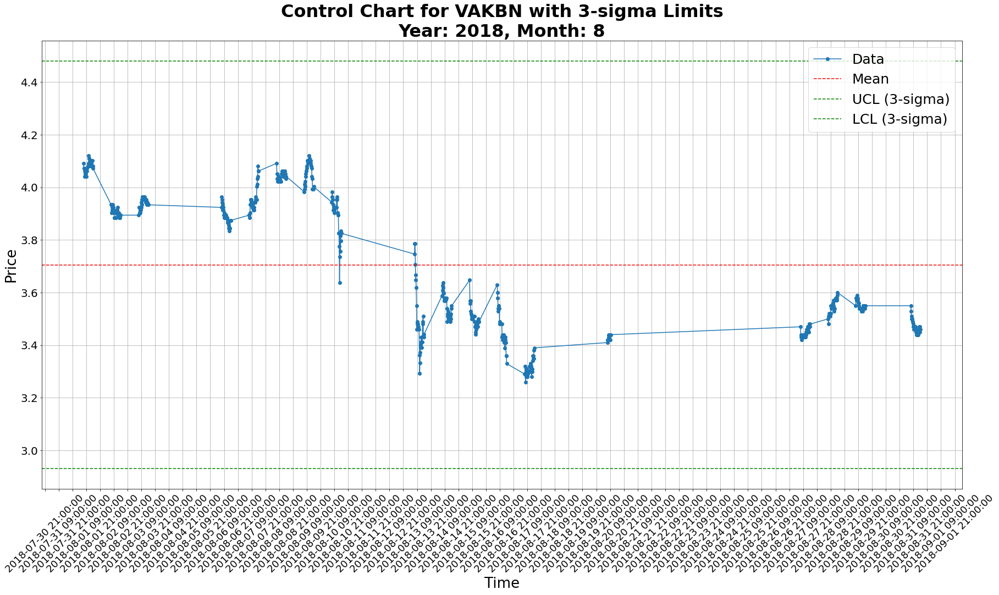

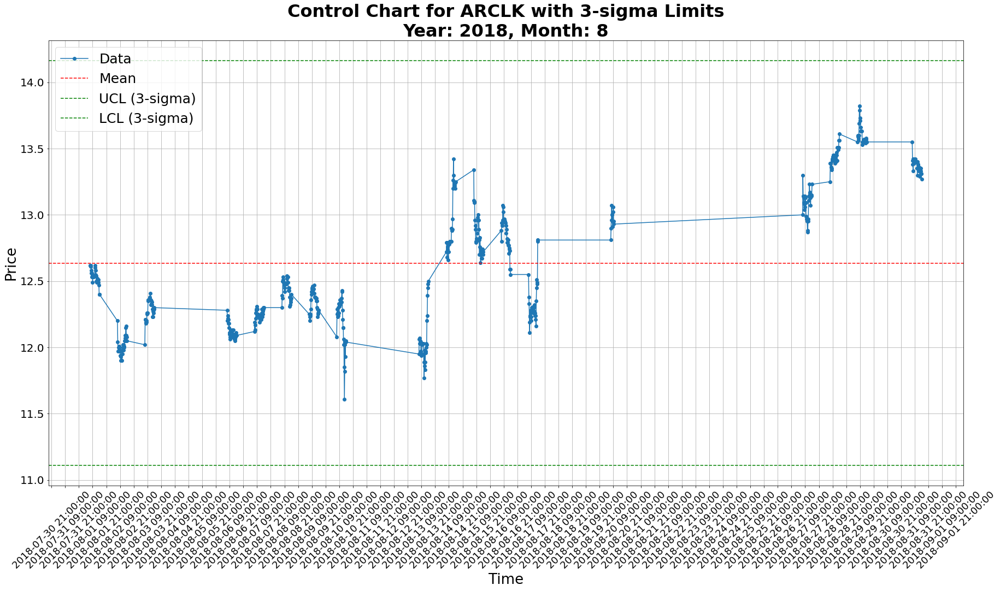

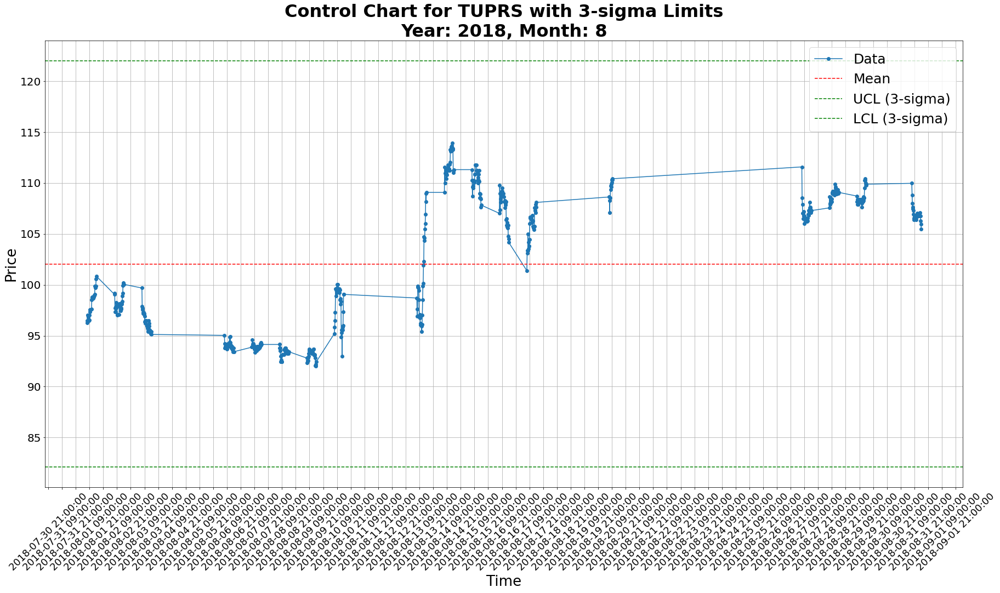

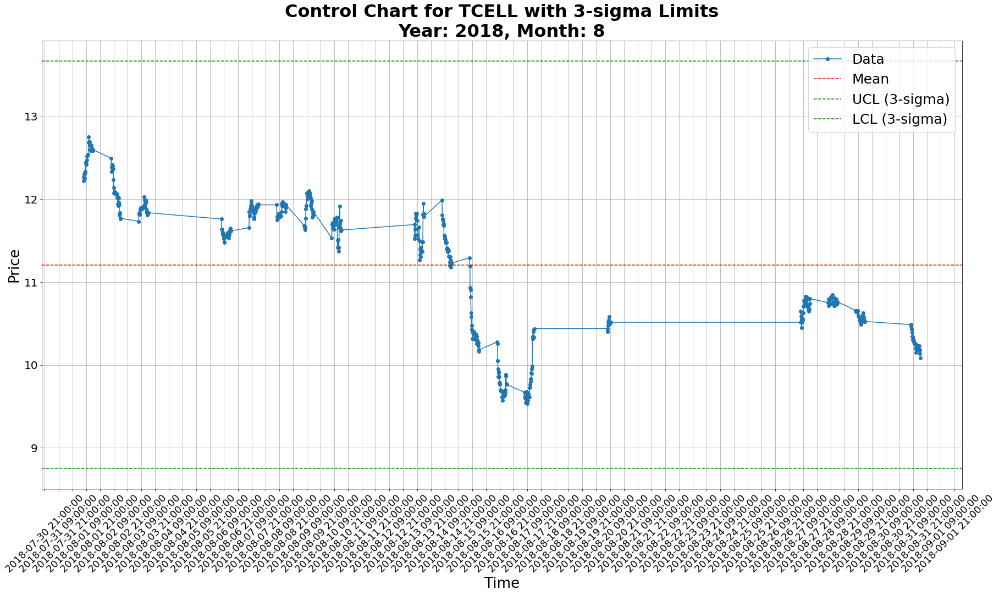

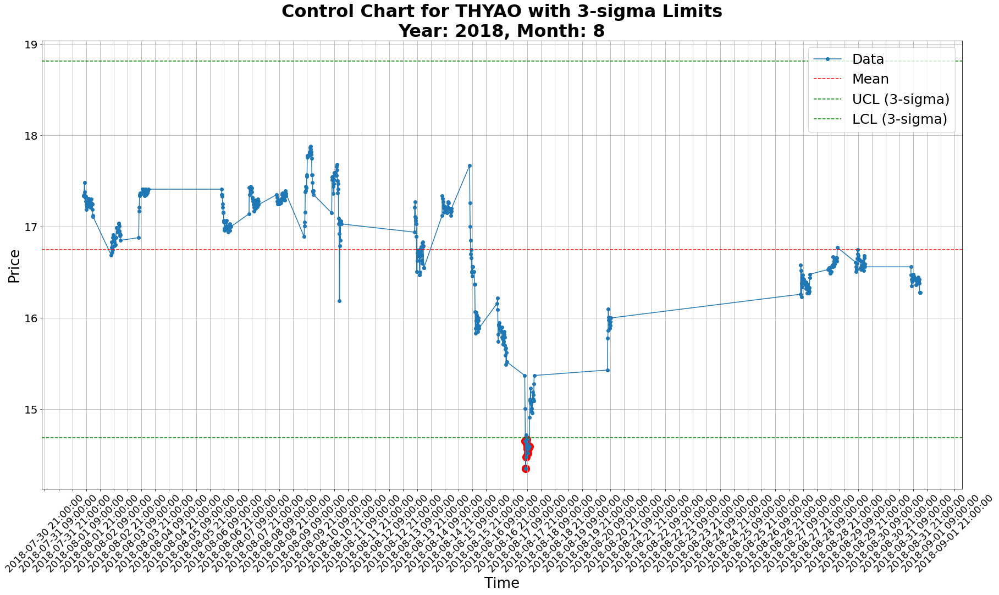

Outliers for THYAO:
Timestamp: 2018-08-17 07:15:00+00:00, Price: 14.65
Timestamp: 2018-08-17 07:30:00+00:00, Price: 14.35
Timestamp: 2018-08-17 07:45:00+00:00, Price: 14.48
Timestamp: 2018-08-17 08:15:00+00:00, Price: 14.67
Timestamp: 2018-08-17 08:30:00+00:00, Price: 14.62
Timestamp: 2018-08-17 08:45:00+00:00, Price: 14.57
Timestamp: 2018-08-17 09:00:00+00:00, Price: 14.6
Timestamp: 2018-08-17 09:15:00+00:00, Price: 14.52
Timestamp: 2018-08-17 09:30:00+00:00, Price: 14.58
Timestamp: 2018-08-17 09:45:00+00:00, Price: 14.57
Timestamp: 2018-08-17 10:00:00+00:00, Price: 14.58
Timestamp: 2018-08-17 10:45:00+00:00, Price: 14.59


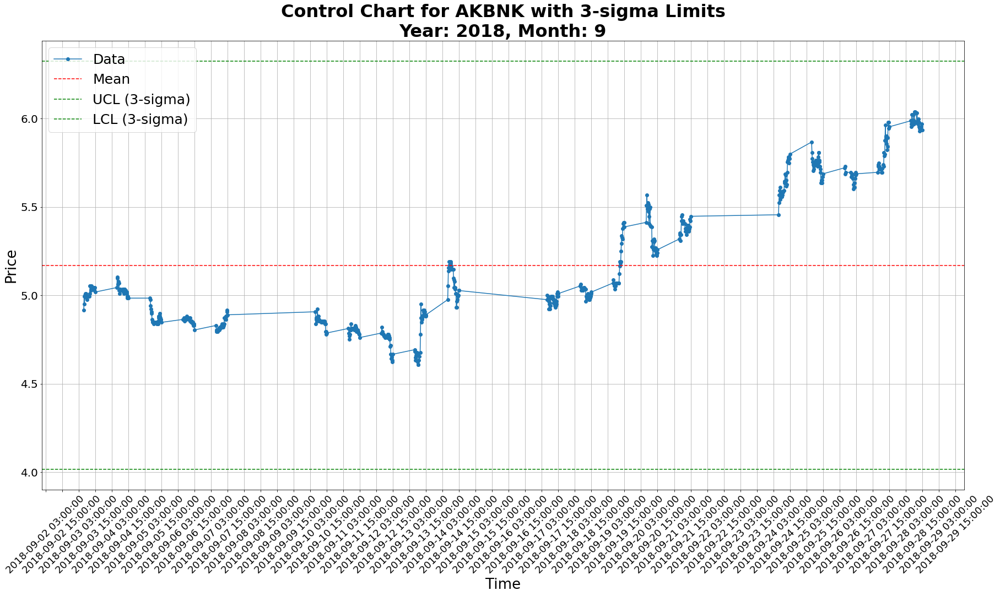

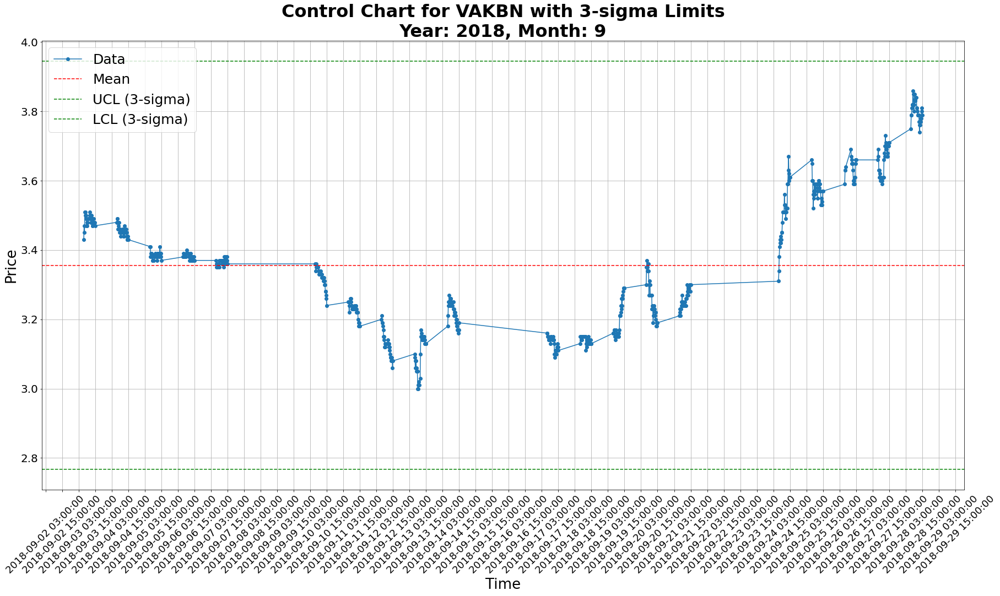

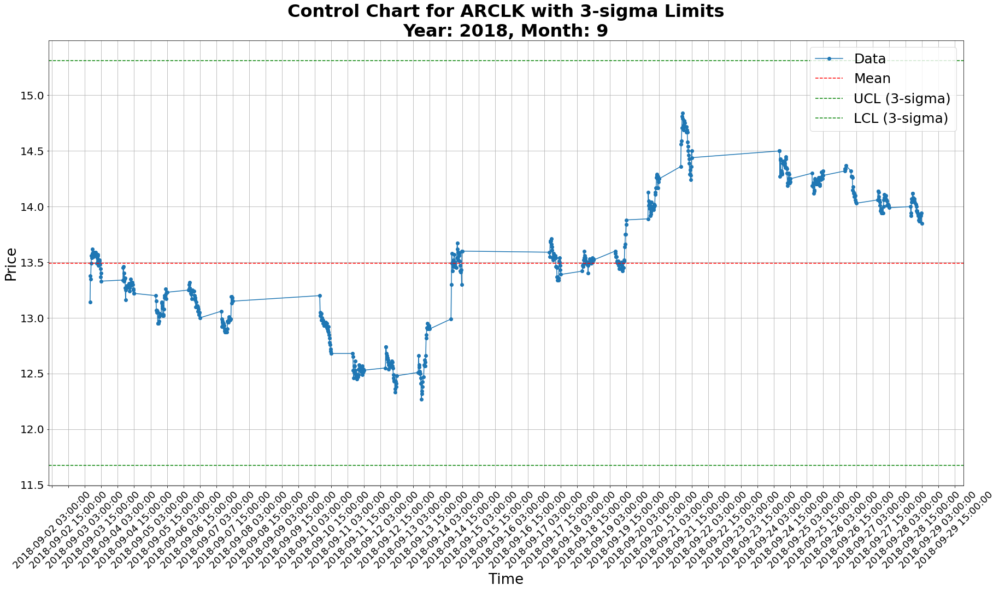

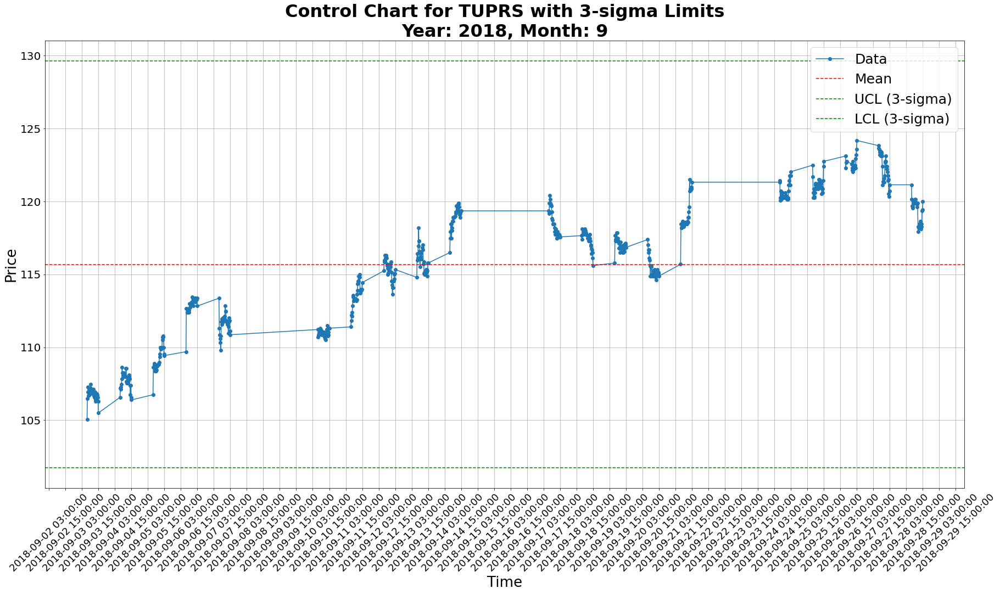

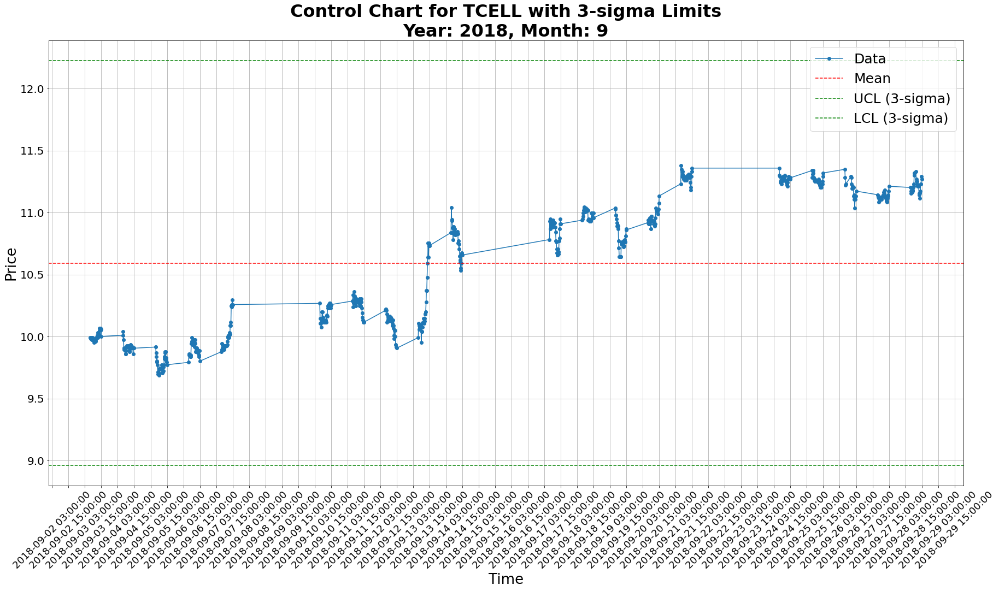

...

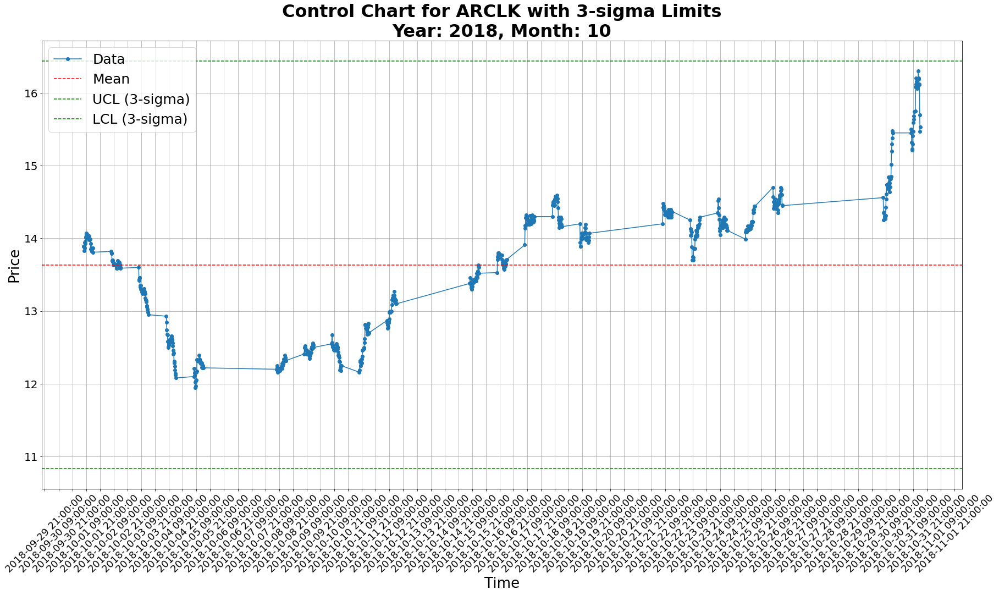

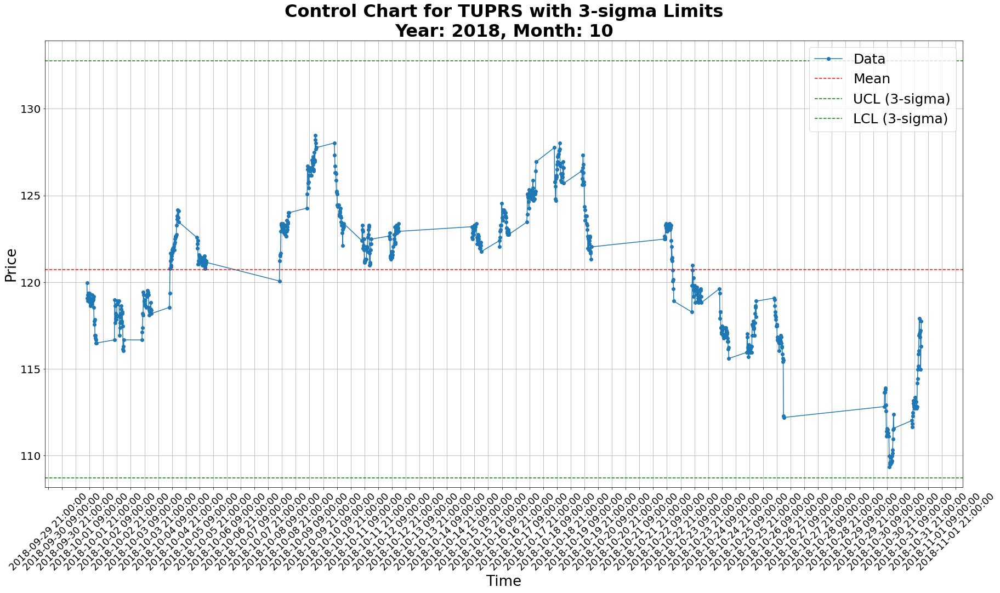

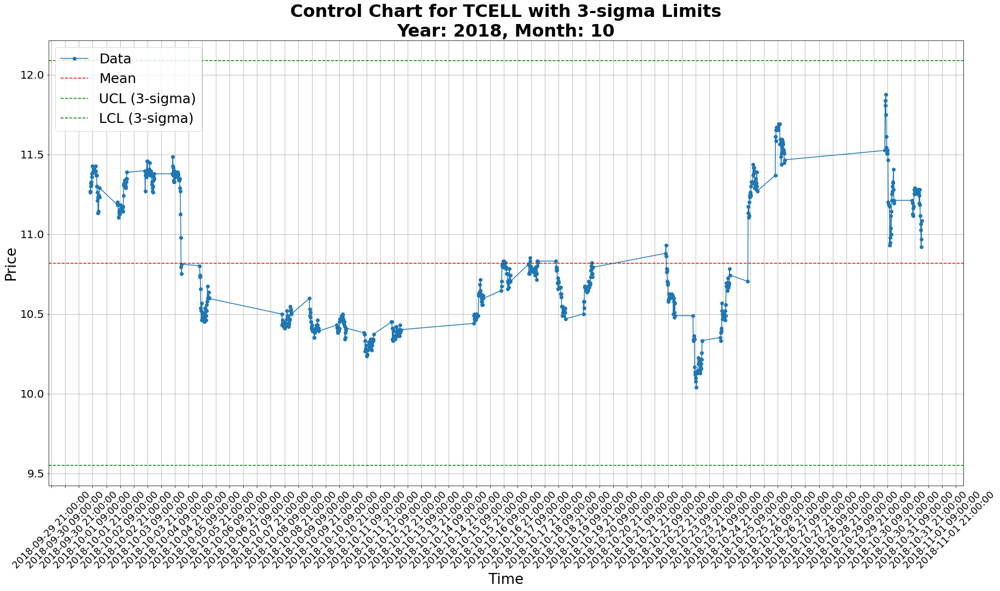

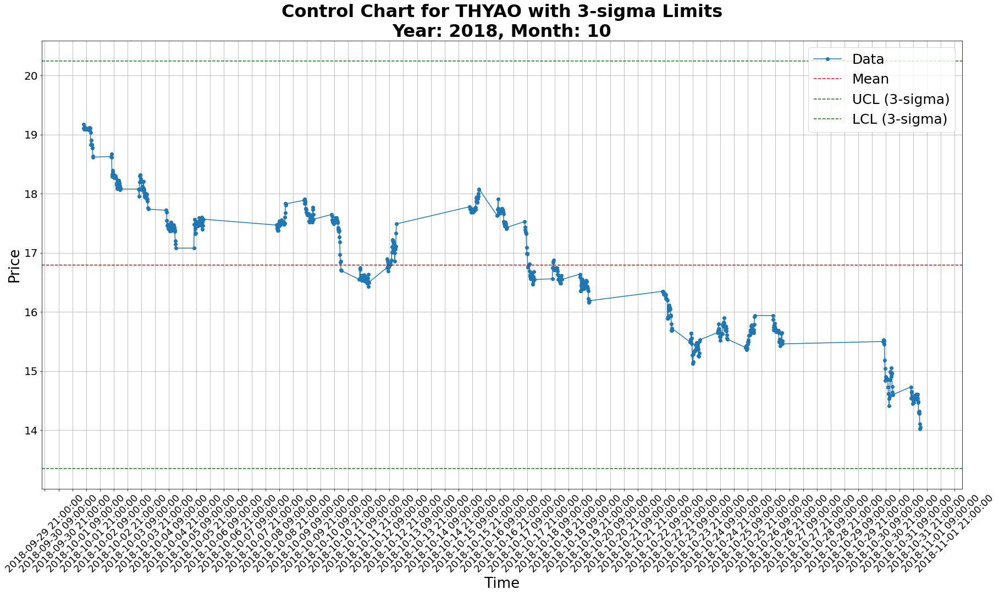

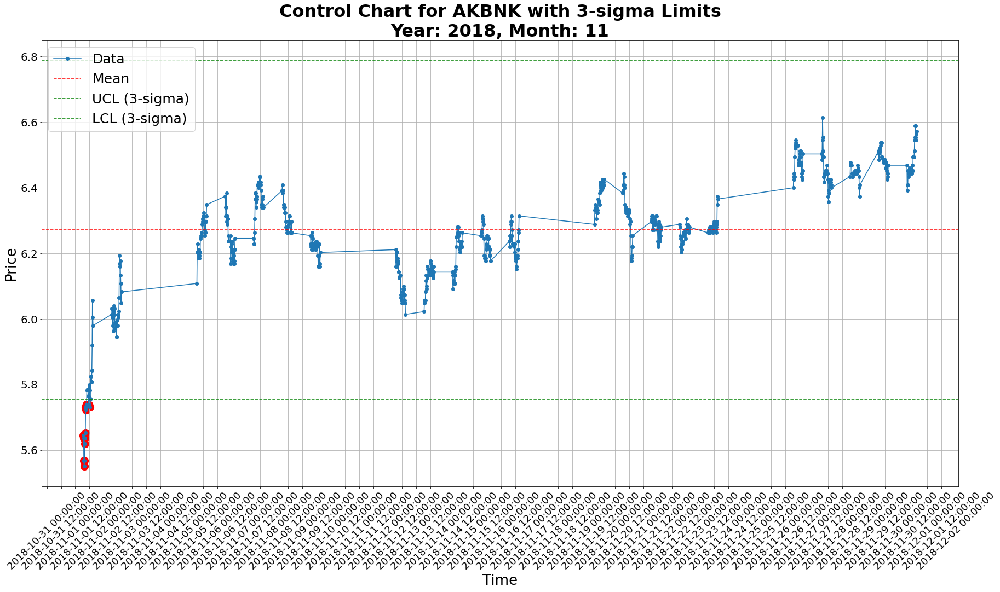

Outliers for AKBNK:
Timestamp: 2018-11-01 06:45:00+00:00, Price: 5.6451
Timestamp: 2018-11-01 07:00:00+00:00, Price: 5.6365
Timestamp: 2018-11-01 07:15:00+00:00, Price: 5.5679
Timestamp: 2018-11-01 07:30:00+00:00, Price: 5.5507
Timestamp: 2018-11-01 07:45:00+00:00, Price: 5.5679
Timestamp: 2018-11-01 08:00:00+00:00, Price: 5.6193
Timestamp: 2018-11-01 08:15:00+00:00, Price: 5.6365
Timestamp: 2018-11-01 08:30:00+00:00, Price: 5.6536
Timestamp: 2018-11-01 08:45:00+00:00, Price: 5.7309
Timestamp: 2018-11-01 09:00:00+00:00, Price: 5.7223
Timestamp: 2018-11-01 09:15:00+00:00, Price: 5.7309
Timestamp: 2018-11-01 09:30:00+00:00, Price: 5.7394
Timestamp: 2018-11-01 11:15:00+00:00, Price: 5.7394
Timestamp: 2018-11-01 12:30:00+00:00, Price: 5.7309


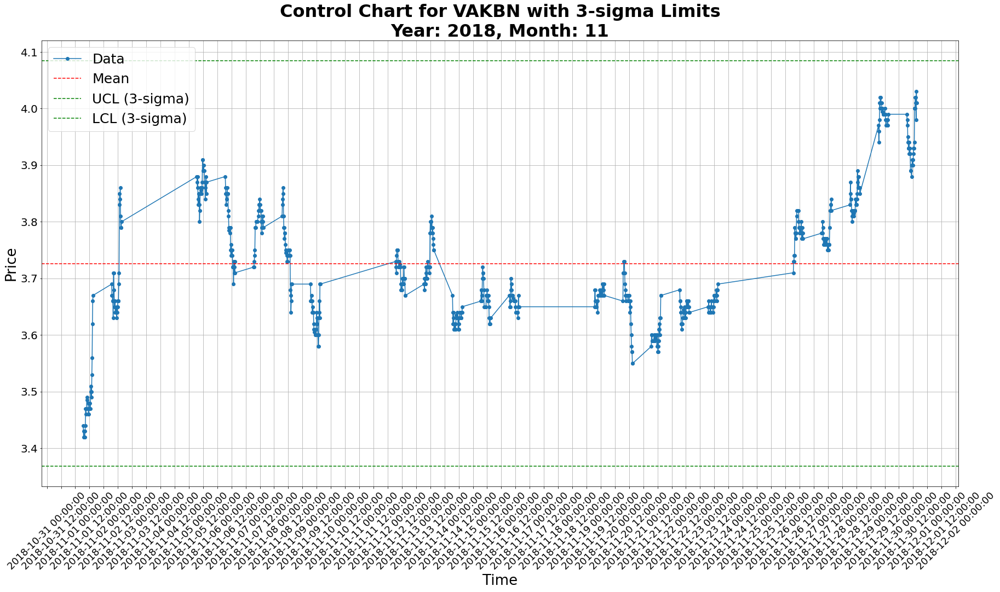

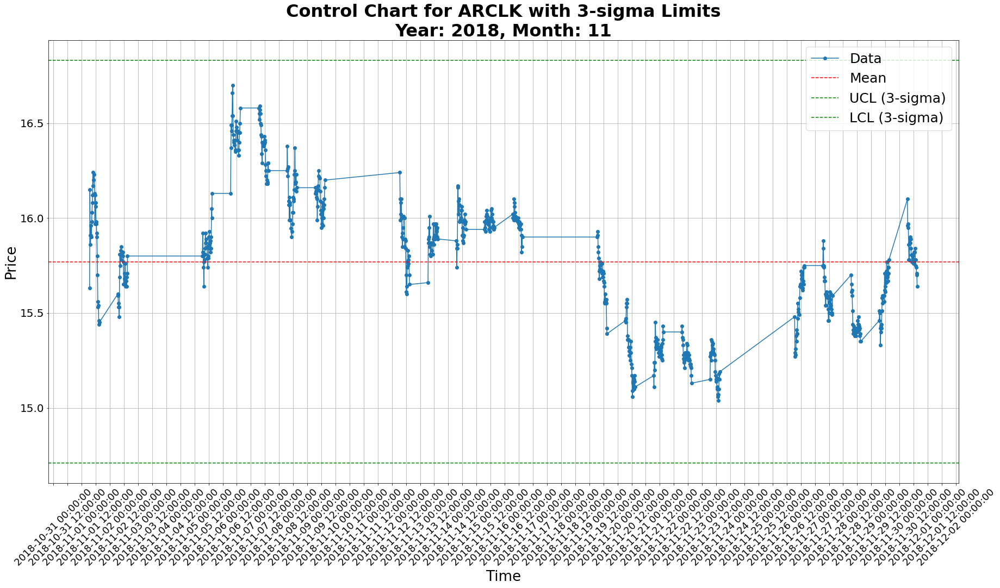

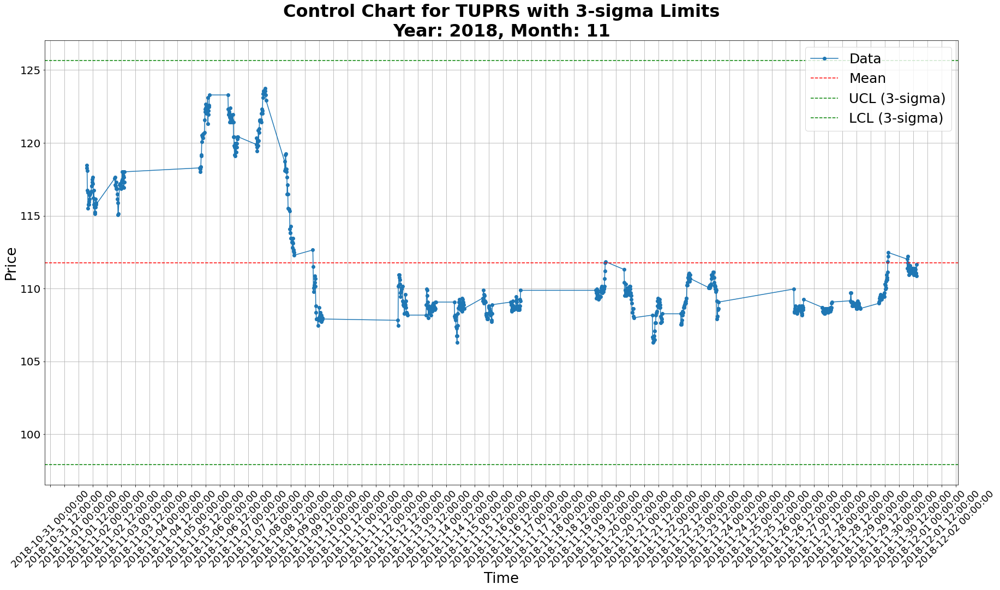

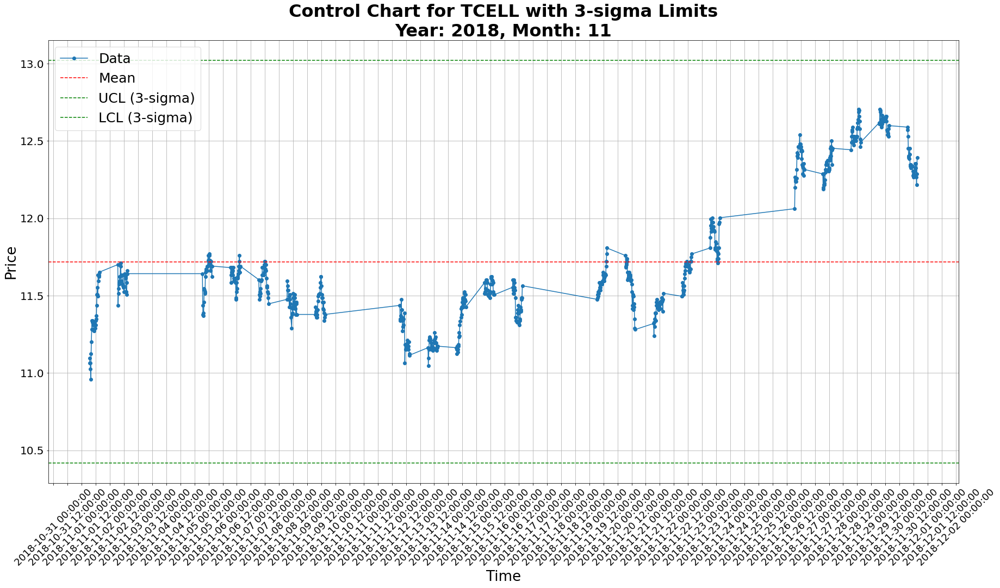

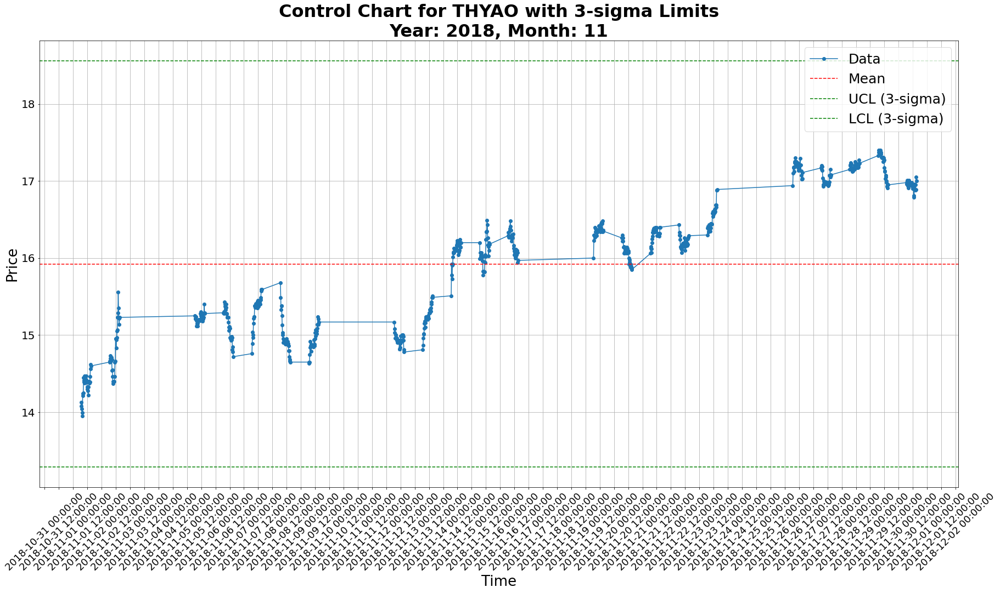

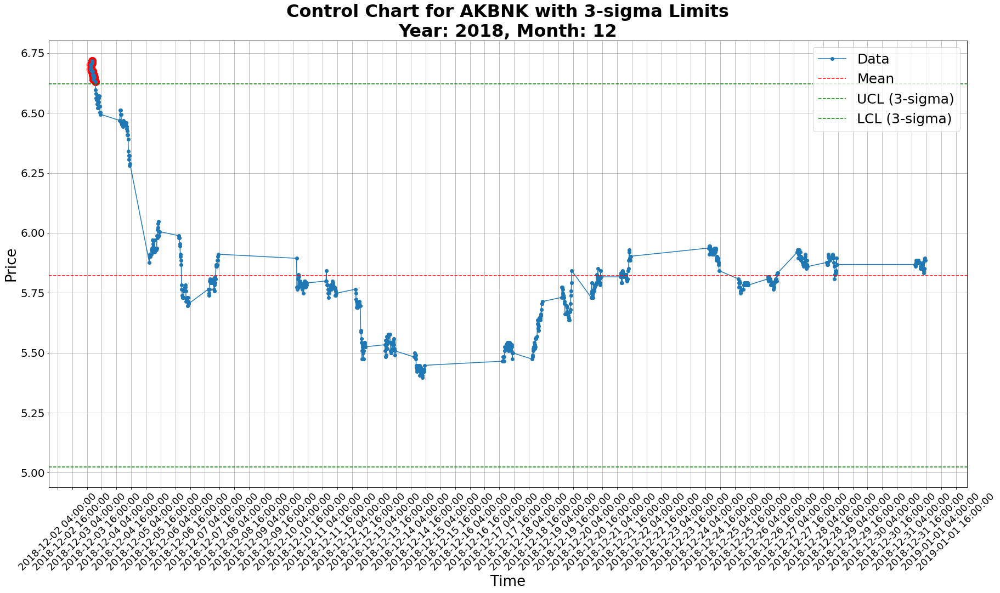

Outliers for AKBNK:
Timestamp: 2018-12-03 06:45:00+00:00, Price: 6.6831
Timestamp: 2018-12-03 07:00:00+00:00, Price: 6.7003
Timestamp: 2018-12-03 07:15:00+00:00, Price: 6.6831
Timestamp: 2018-12-03 07:30:00+00:00, Price: 6.6917
Timestamp: 2018-12-03 07:45:00+00:00, Price: 6.6746
Timestamp: 2018-12-03 08:00:00+00:00, Price: 6.7089
Timestamp: 2018-12-03 08:15:00+00:00, Price: 6.7175
Timestamp: 2018-12-03 08:30:00+00:00, Price: 6.6746
Timestamp: 2018-12-03 08:45:00+00:00, Price: 6.6574
Timestamp: 2018-12-03 09:00:00+00:00, Price: 6.6402
Timestamp: 2018-12-03 09:15:00+00:00, Price: 6.6488
Timestamp: 2018-12-03 09:30:00+00:00, Price: 6.6574
Timestamp: 2018-12-03 09:45:00+00:00, Price: 6.6488
Timestamp: 2018-12-03 10:45:00+00:00, Price: 6.6317


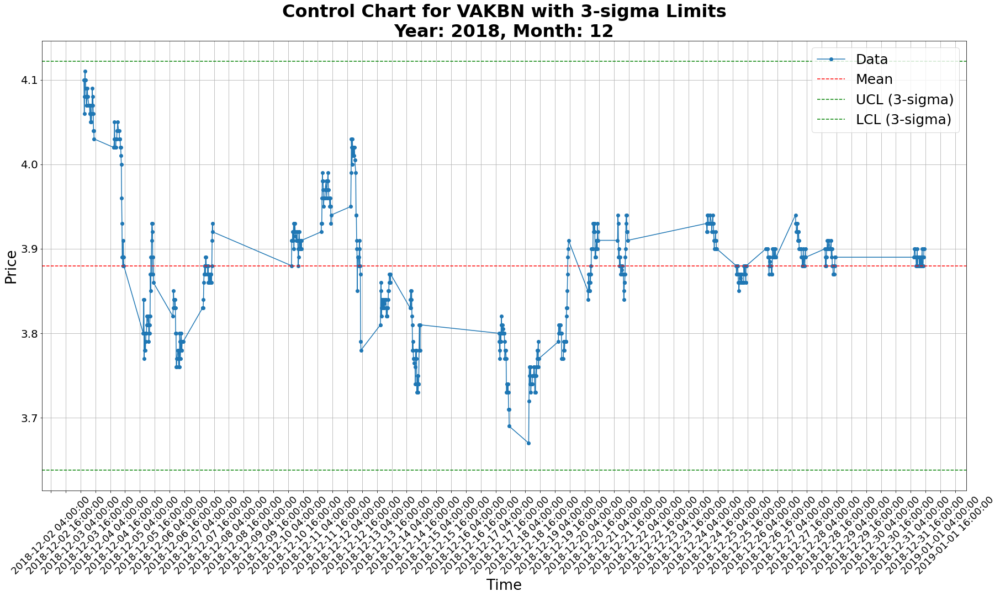

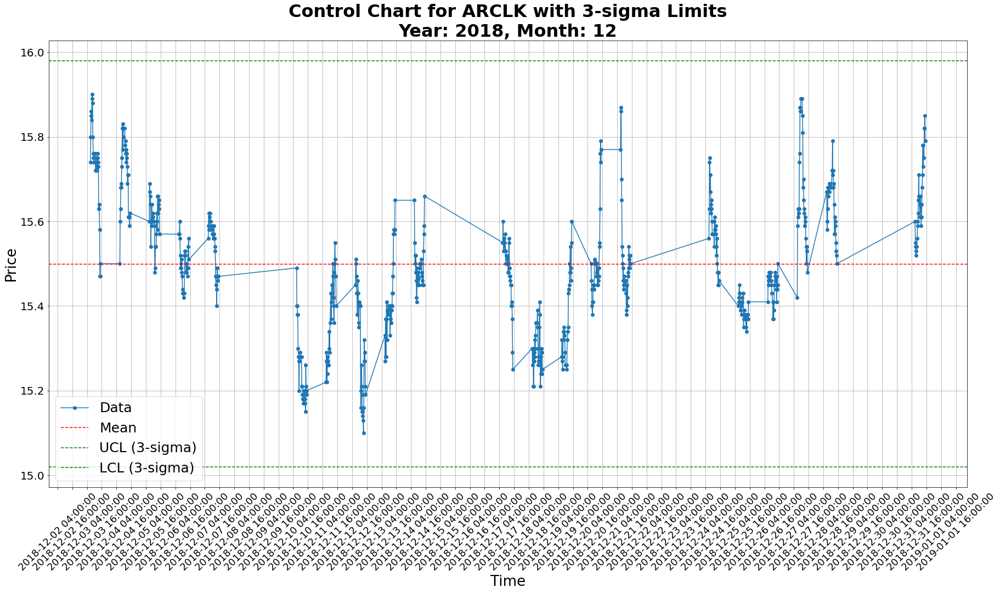

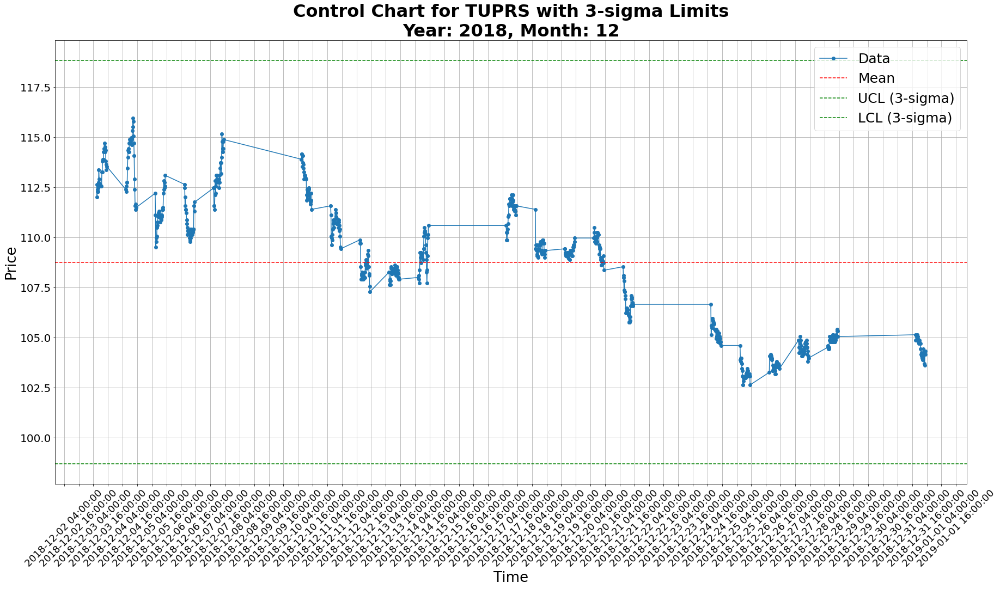

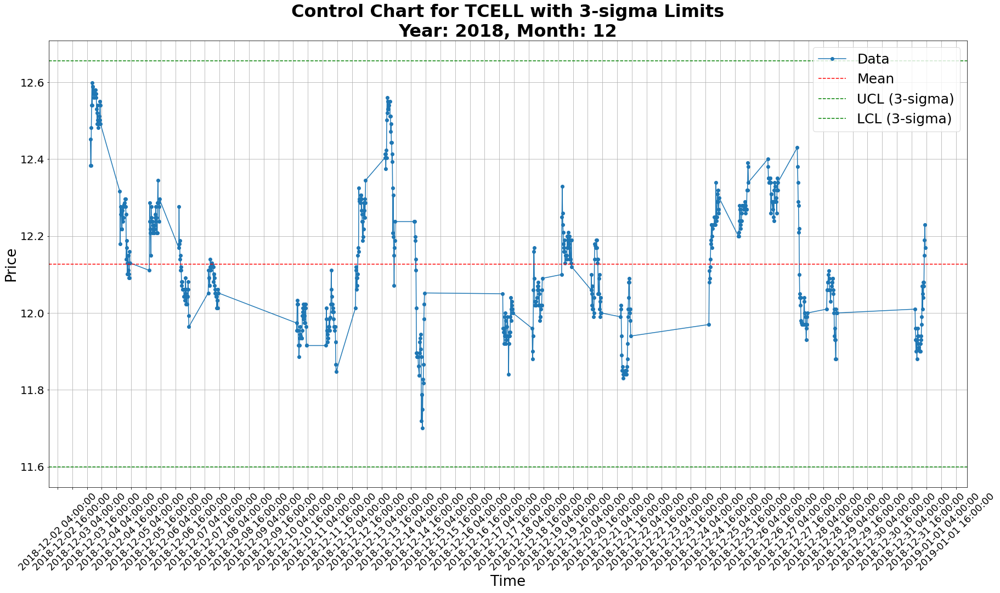

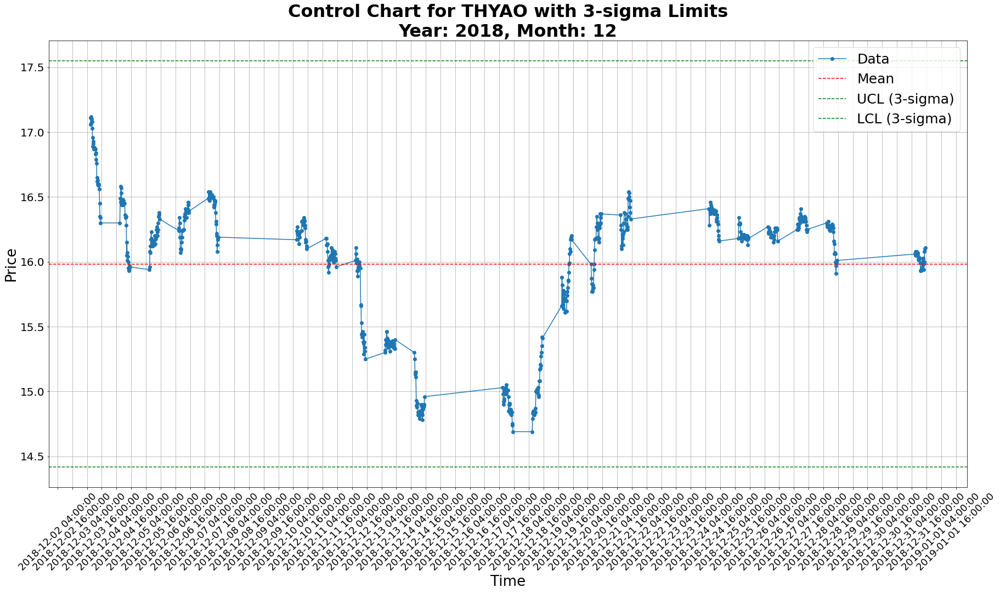

...

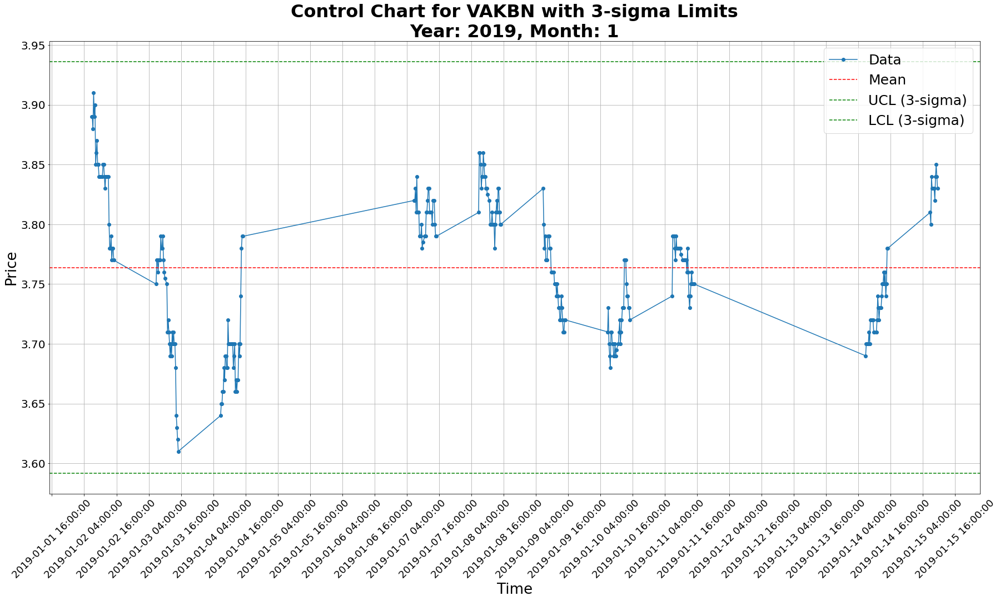

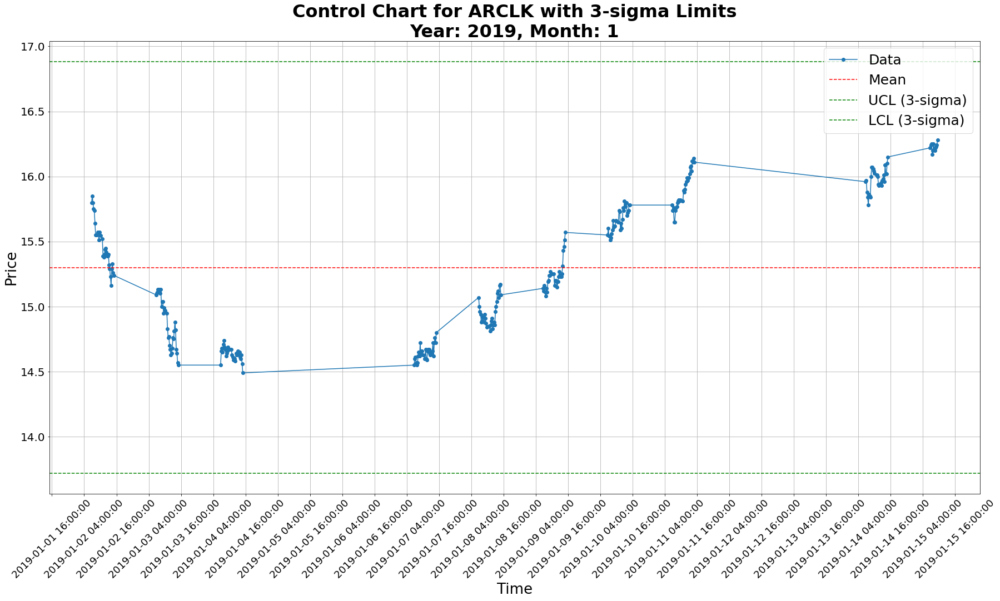

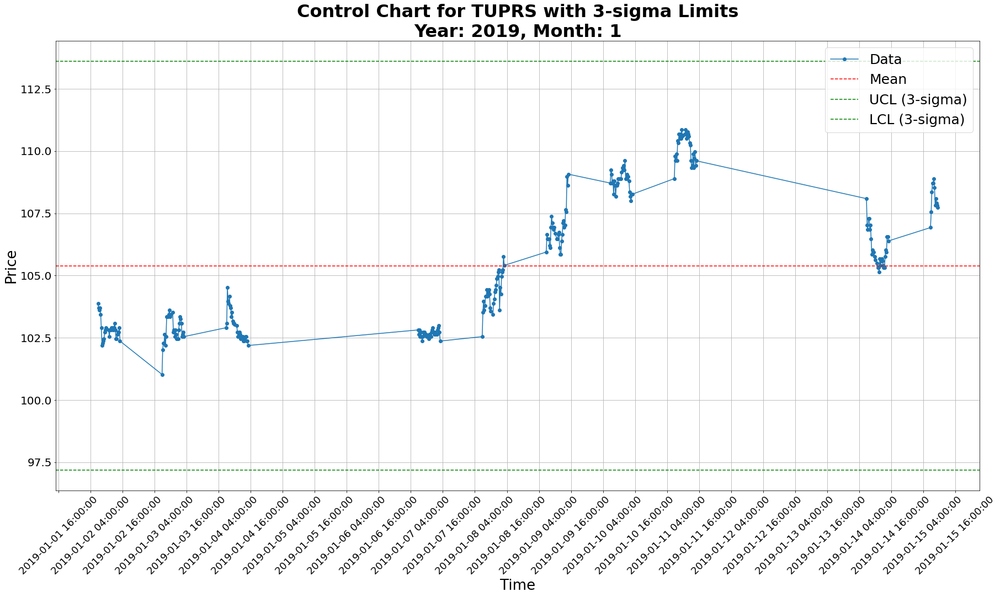

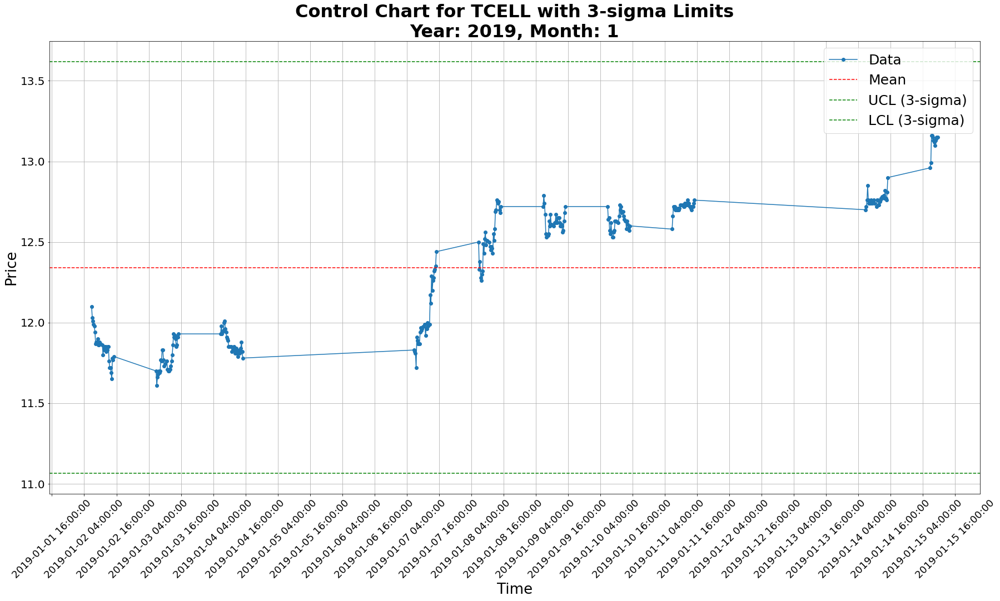

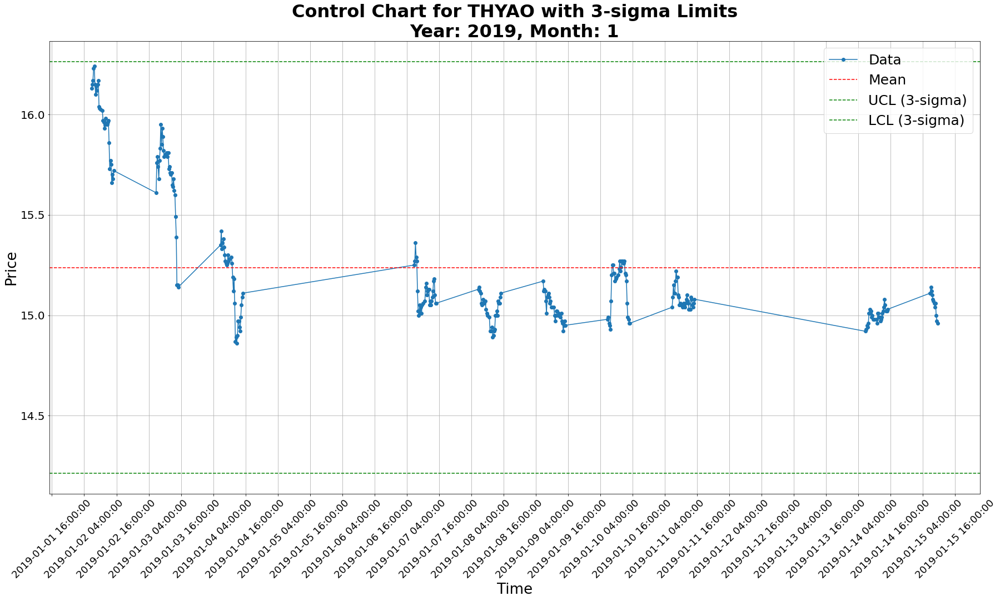

""


In [6]:
# copy df
df = filled_df.copy()
# start date
start = pd.to_datetime("2017-01-15 09:30:00+00:00")
# end data
end = pd.to_datetime("2019-01-15 09:30:00+00:00")
# filtering with time
ndf = df[(df['timestamp'] >= start) & (df['timestamp'] <= end)]
# filtering the necessary columns 
df = ndf[['timestamp', 'year', 'month', 'AKBNK', 'VAKBN', 'ARCLK', 'TUPRS', 'TCELL', 'THYAO']].copy()

# years and months as array
years = [2017, 2018, 2019]
months = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]

# the selected stocks
indexes_selected = ['AKBNK', 'VAKBN', 'ARCLK', 'TUPRS', 'TCELL', 'THYAO']

outliers_akbnk = []
outliers_vakbn = []
outliers_arclk = []
outliers_tuprs = []
outliers_tcell = []
outliers_thyao = []

def get_list(index):
    if index == "AKBNK":
        return outliers_akbnk
    elif index == "VAKBN":
        return outliers_vakbn
    elif index == "ARCLK":
        return outliers_arclk
    elif index == "TUPRS":
        return outliers_tuprs
    elif index == "TCELL":
        return outliers_tcell
    else:
        return outliers_thyao

# given a stock in a specific month, constructs the 
# control charts for that month
def plot_control_chart(selected):
    for index in indexes_selected:
        # getting the prices for the stock
        prices = selected[index].to_list()
        # timestamps
        time = selected['timestamp'].to_list()
        # mean
        mu = np.mean(prices)
        # standard deviation
        sigma = np.std(prices)
        # UCL and LCL
        UCL = mu + 3 * sigma
        LCL = mu - 3 * sigma
        
        # create a list to store the outliers
        outliers = []
        # plot Mean, UCL, LCL
        plt.figure(figsize=(30, 15))
        plt.plot(time, prices, marker='o', label='Data')
        plt.axhline(mu, color='r', linestyle='--', label='Mean')
        plt.axhline(UCL, color='g', linestyle='--', label='UCL (3-sigma)')
        plt.axhline(LCL, color='g', linestyle='--', label='LCL (3-sigma)')
        
        # plot outliers as red dots
        for i, price in enumerate(prices):
            if price > UCL or price < LCL:
                plt.scatter(time[i], price, c='red', marker='o', s=200)
                outliers.append((time[i], price))
        # plot dates, x axis, y axis, title
        date_format = mdates.DateFormatter('%Y-%m-%d %H:%M:%S')
        plt.gca().xaxis.set_major_formatter(date_format)
        plt.gca().xaxis.set_major_locator(mdates.HourLocator(interval=12))
        plt.xlabel('Time', fontsize=26)
        plt.ylabel('Price', fontsize=26)
        plt.title(f'Control Chart for {index} with 3-sigma Limits\nYear: {selected["year"].iloc[0]}, Month: {selected["month"].iloc[0]}', fontsize=32, fontweight='bold')
        plt.legend(fontsize=25)
        plt.grid(True)
        plt.xticks(rotation=45, fontsize=18)
        plt.yticks(fontsize=20)
        plt.show()
        # print outliers
        if outliers:
            print(f'Outliers for {index}:')
            l = get_list(index)
            for outlier in outliers:
                l.append((outlier[0],outlier[1]))
                print(f'Timestamp: {outlier[0]}, Price: {outlier[1]}')

# group by year, month
grouped = df.groupby(['year', 'month'])

# apply the plot_control_chart function to each group
grouped.apply(plot_control_chart)


## 3.2. Box Plots

Upper Outliers for AKBNK in 2017/1
Timestamp: 2017-01-30 10:45:00+00:00, Price: 6.5238
Timestamp: 2017-01-30 11:00:00+00:00, Price: 6.5478
Timestamp: 2017-01-30 11:15:00+00:00, Price: 6.572
Timestamp: 2017-01-30 11:30:00+00:00, Price: 6.5639
Timestamp: 2017-01-30 11:45:00+00:00, Price: 6.5559
Timestamp: 2017-01-30 12:00:00+00:00, Price: 6.572
Timestamp: 2017-01-30 12:15:00+00:00, Price: 6.5799
Timestamp: 2017-01-30 12:30:00+00:00, Price: 6.5799
Timestamp: 2017-01-30 12:45:00+00:00, Price: 6.572
Timestamp: 2017-01-30 13:00:00+00:00, Price: 6.596
Timestamp: 2017-01-30 13:15:00+00:00, Price: 6.612
Timestamp: 2017-01-30 13:30:00+00:00, Price: 6.604
Timestamp: 2017-01-30 13:45:00+00:00, Price: 6.6281
Timestamp: 2017-01-30 14:00:00+00:00, Price: 6.6441
Timestamp: 2017-01-30 14:15:00+00:00, Price: 6.6681
Timestamp: 2017-01-30 14:30:00+00:00, Price: 6.6842
Timestamp: 2017-01-30 14:45:00+00:00, Price: 6.6842
Timestamp: 2017-01-30 15:00:00+00:00, Price: 6.6842
Timestamp: 2017-01-31 06:45:00+00:0

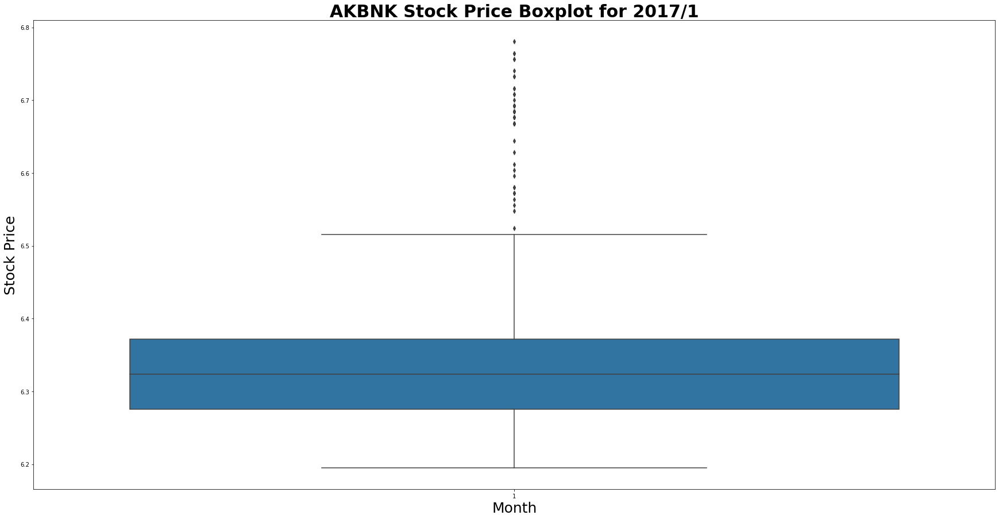

Upper Outliers for VAKBN in 2017/1
Timestamp: 2017-01-30 08:15:00+00:00, Price: 4.7469
Timestamp: 2017-01-30 08:30:00+00:00, Price: 4.7469
Timestamp: 2017-01-30 08:45:00+00:00, Price: 4.786
Timestamp: 2017-01-30 09:00:00+00:00, Price: 4.8153
Timestamp: 2017-01-30 09:15:00+00:00, Price: 4.8252
Timestamp: 2017-01-30 09:30:00+00:00, Price: 4.8153
Timestamp: 2017-01-30 09:45:00+00:00, Price: 4.8153
Timestamp: 2017-01-30 10:45:00+00:00, Price: 4.8252
Timestamp: 2017-01-30 11:00:00+00:00, Price: 4.8055
Timestamp: 2017-01-30 11:15:00+00:00, Price: 4.8252
Timestamp: 2017-01-30 11:30:00+00:00, Price: 4.8252
Timestamp: 2017-01-30 11:45:00+00:00, Price: 4.8252
Timestamp: 2017-01-30 12:00:00+00:00, Price: 4.8252
Timestamp: 2017-01-30 12:15:00+00:00, Price: 4.8349
Timestamp: 2017-01-30 12:30:00+00:00, Price: 4.8252
Timestamp: 2017-01-30 12:45:00+00:00, Price: 4.8153
Timestamp: 2017-01-30 13:00:00+00:00, Price: 4.8349
Timestamp: 2017-01-30 13:15:00+00:00, Price: 4.8545
Timestamp: 2017-01-30 13:30:00

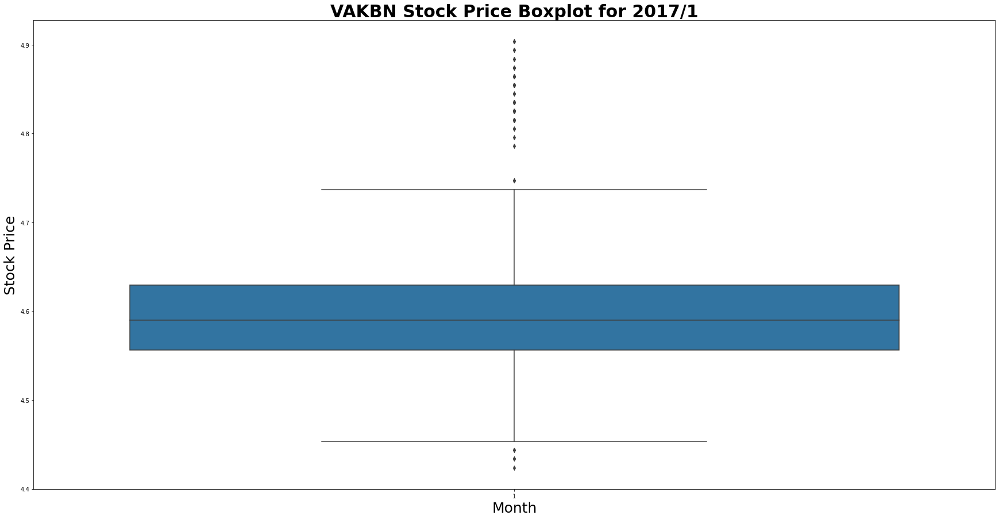

NO OUTLIERS


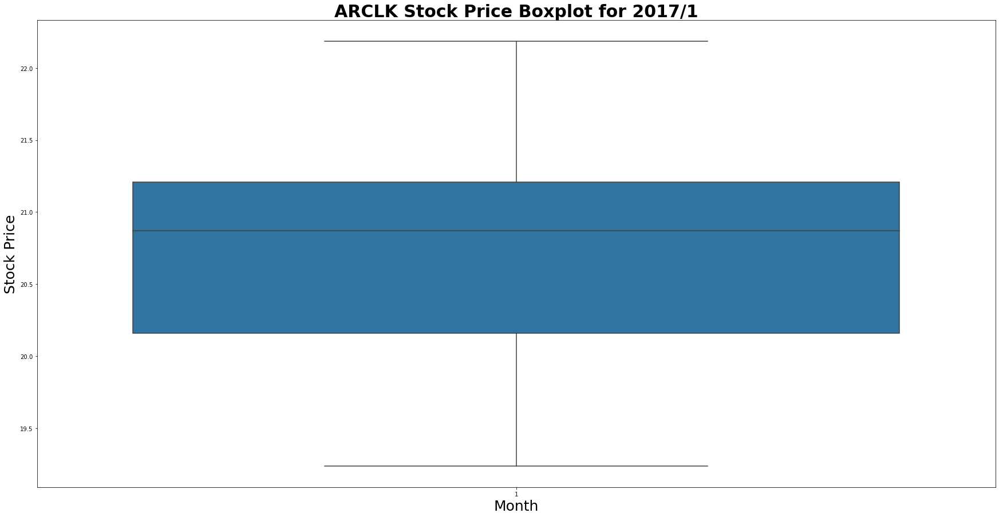

NO OUTLIERS


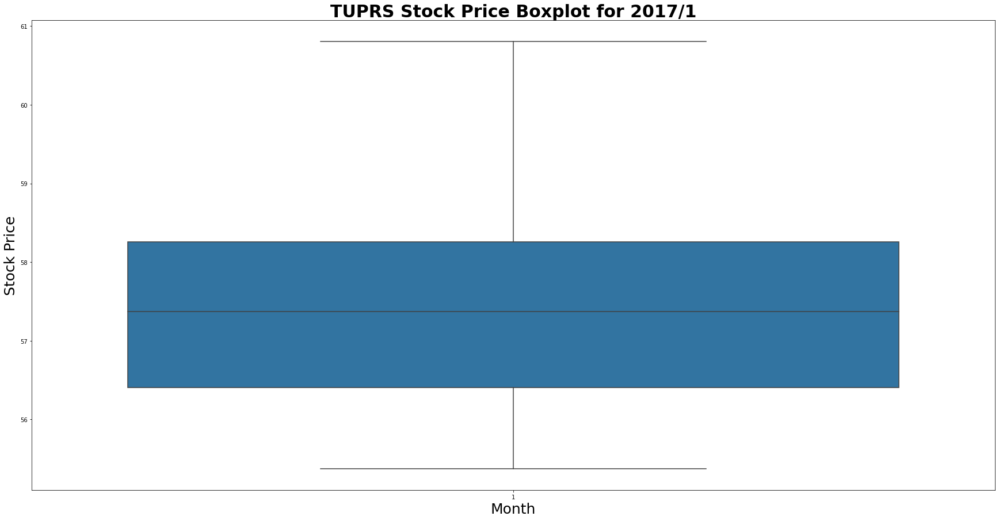

NO OUTLIERS


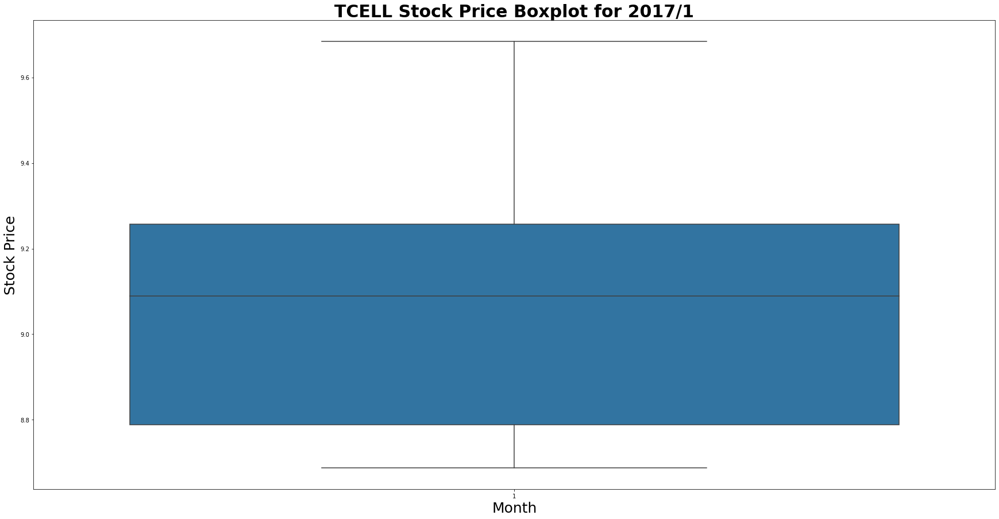

NO OUTLIERS


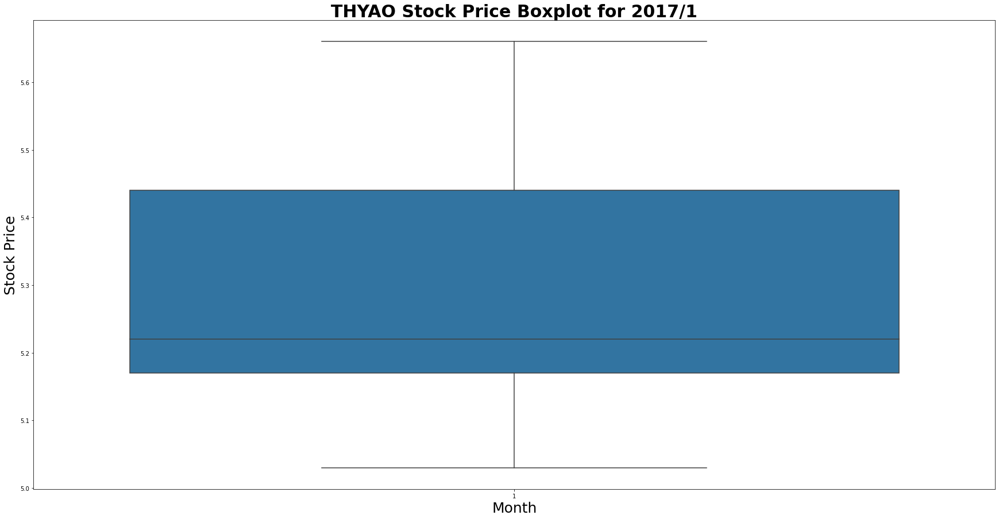

Lower Outliers for AKBNK in 2017/2
Timestamp: 2017-02-01 06:45:00+00:00, Price: 6.7163
Timestamp: 2017-02-01 07:00:00+00:00, Price: 6.7403
Timestamp: 2017-02-01 07:15:00+00:00, Price: 6.7163
Timestamp: 2017-02-01 07:30:00+00:00, Price: 6.7242
Timestamp: 2017-02-01 07:45:00+00:00, Price: 6.6842
Timestamp: 2017-02-01 08:00:00+00:00, Price: 6.7082
Timestamp: 2017-02-01 08:15:00+00:00, Price: 6.6681
Timestamp: 2017-02-01 08:30:00+00:00, Price: 6.6521
Timestamp: 2017-02-01 08:45:00+00:00, Price: 6.6842
Timestamp: 2017-02-01 09:00:00+00:00, Price: 6.7082
Timestamp: 2017-02-01 09:15:00+00:00, Price: 6.7163
Timestamp: 2017-02-01 09:30:00+00:00, Price: 6.7082
Timestamp: 2017-02-01 09:45:00+00:00, Price: 6.7163
Timestamp: 2017-02-01 10:00:00+00:00, Price: 6.7163
Timestamp: 2017-02-01 10:45:00+00:00, Price: 6.7163
Timestamp: 2017-02-01 11:00:00+00:00, Price: 6.7163
Timestamp: 2017-02-01 11:15:00+00:00, Price: 6.7163
Timestamp: 2017-02-01 11:30:00+00:00, Price: 6.7242
Timestamp: 2017-02-01 11:45:0

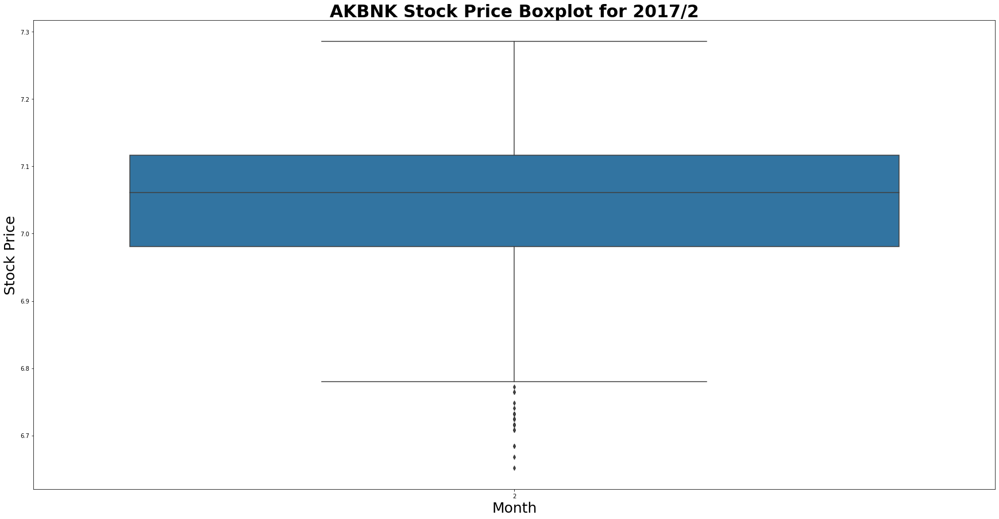

Lower Outliers for VAKBN in 2017/2
Timestamp: 2017-02-01 06:45:00+00:00, Price: 4.8252
Timestamp: 2017-02-01 07:00:00+00:00, Price: 4.8545
Timestamp: 2017-02-01 07:15:00+00:00, Price: 4.8349
Timestamp: 2017-02-01 07:30:00+00:00, Price: 4.8349
Timestamp: 2017-02-01 07:45:00+00:00, Price: 4.8153
Timestamp: 2017-02-01 08:00:00+00:00, Price: 4.8349
Timestamp: 2017-02-01 08:15:00+00:00, Price: 4.8153
Timestamp: 2017-02-01 08:30:00+00:00, Price: 4.8055
Timestamp: 2017-02-01 08:45:00+00:00, Price: 4.8349
Timestamp: 2017-02-01 09:00:00+00:00, Price: 4.8447
Timestamp: 2017-02-01 09:15:00+00:00, Price: 4.8447
Timestamp: 2017-02-01 09:30:00+00:00, Price: 4.8447


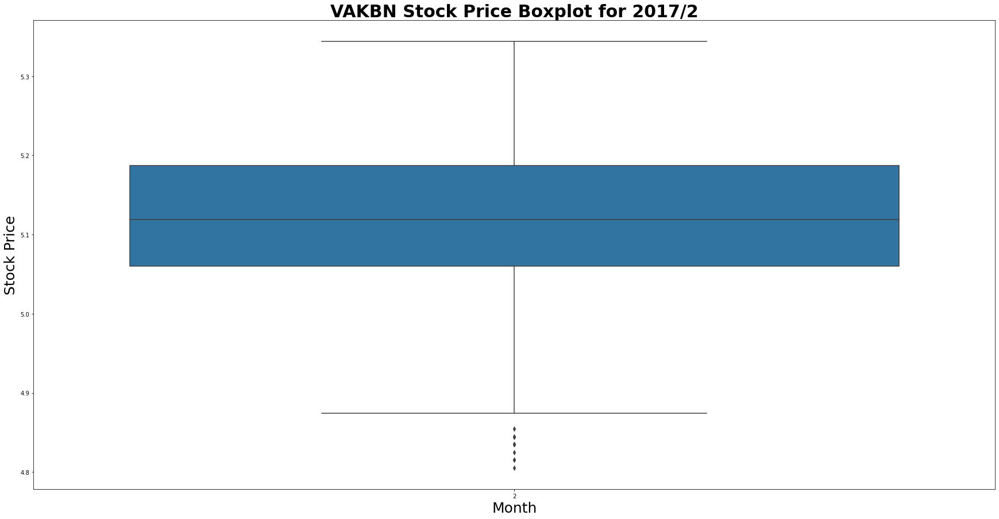

Upper Outliers for ARCLK in 2017/2
Timestamp: 2017-02-01 08:00:00+00:00, Price: 21.9405
Timestamp: 2017-02-01 08:15:00+00:00, Price: 21.9029
Timestamp: 2017-02-01 08:30:00+00:00, Price: 22.1282
Timestamp: 2017-02-01 08:45:00+00:00, Price: 22.0344
Timestamp: 2017-02-01 09:00:00+00:00, Price: 21.978
Timestamp: 2017-02-01 09:15:00+00:00, Price: 21.978
Timestamp: 2017-02-01 09:30:00+00:00, Price: 22.0344
Timestamp: 2017-02-01 09:45:00+00:00, Price: 22.1094
Timestamp: 2017-02-01 10:00:00+00:00, Price: 22.053150000000002
Timestamp: 2017-02-01 10:45:00+00:00, Price: 21.9969
Timestamp: 2017-02-01 11:00:00+00:00, Price: 22.0344
Timestamp: 2017-02-01 11:15:00+00:00, Price: 22.0719
Timestamp: 2017-02-01 11:30:00+00:00, Price: 22.0344
Timestamp: 2017-02-01 11:45:00+00:00, Price: 22.0907
Timestamp: 2017-02-01 12:00:00+00:00, Price: 22.1282
Timestamp: 2017-02-01 12:15:00+00:00, Price: 22.0531
Timestamp: 2017-02-01 12:30:00+00:00, Price: 22.0156
Timestamp: 2017-02-01 12:45:00+00:00, Price: 22.0156
Ti

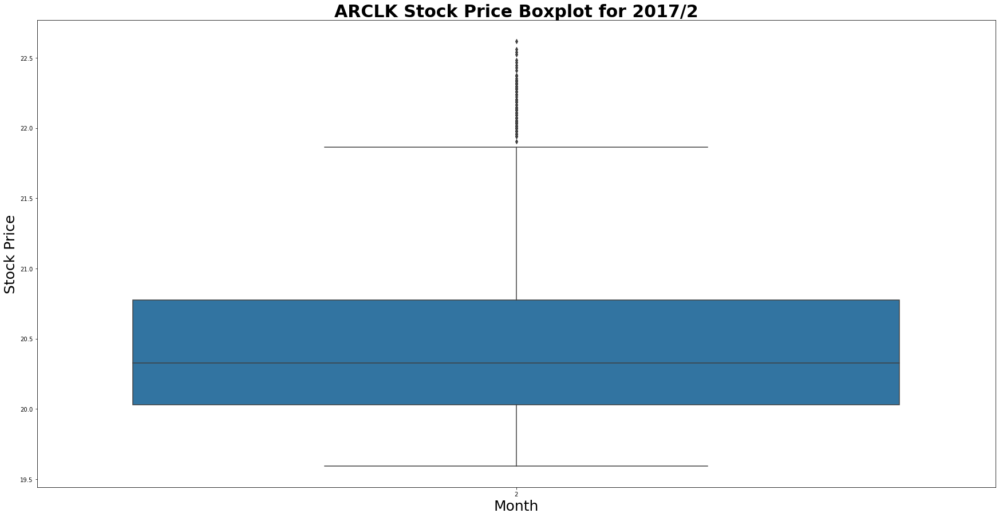

Upper Outliers for TUPRS in 2017/2
Timestamp: 2017-02-14 06:45:00+00:00, Price: 64.8258


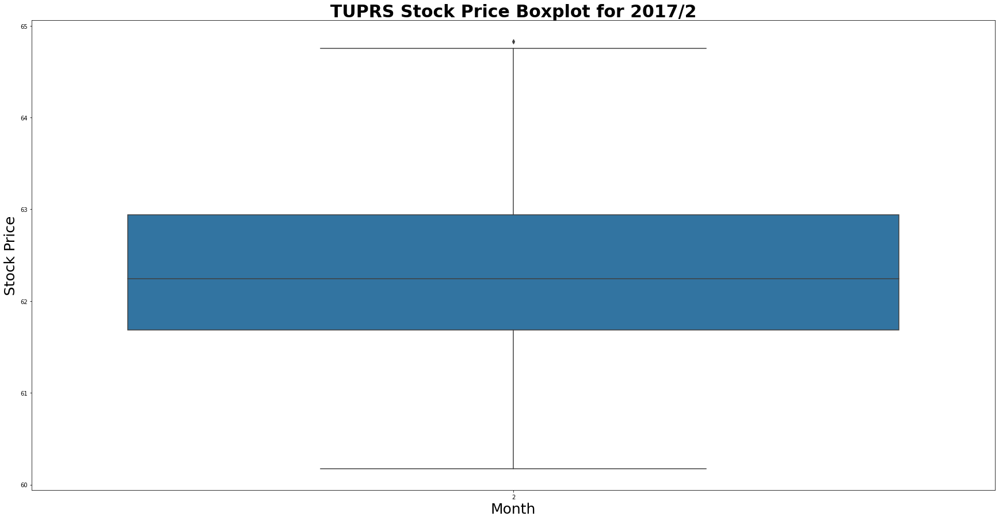

NO OUTLIERS


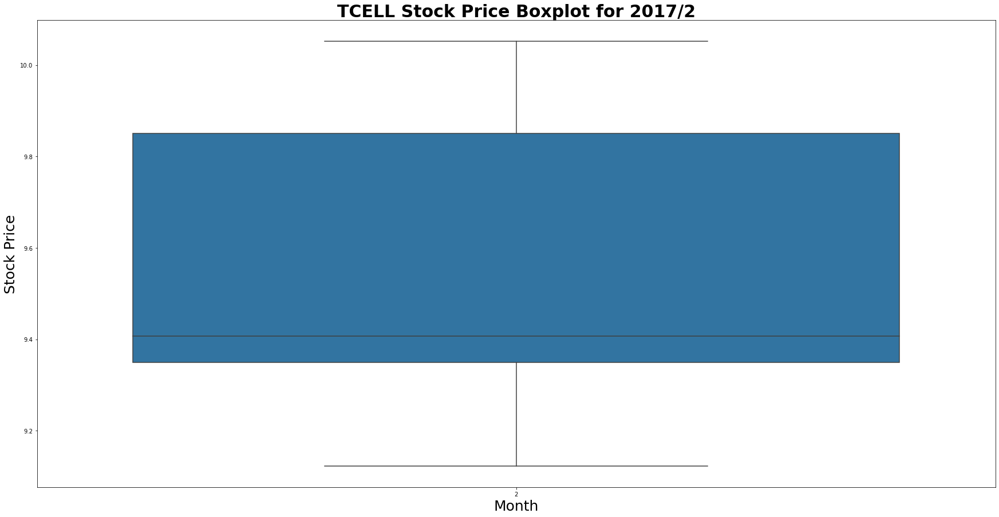

Lower Outliers for THYAO in 2017/2
Timestamp: 2017-02-01 08:30:00+00:00, Price: 5.51
Timestamp: 2017-02-28 07:45:00+00:00, Price: 5.52
Timestamp: 2017-02-28 12:00:00+00:00, Price: 5.48
Timestamp: 2017-02-28 12:15:00+00:00, Price: 5.46
Timestamp: 2017-02-28 12:30:00+00:00, Price: 5.45
Timestamp: 2017-02-28 12:45:00+00:00, Price: 5.42
Timestamp: 2017-02-28 13:00:00+00:00, Price: 5.42
Timestamp: 2017-02-28 13:15:00+00:00, Price: 5.44
Timestamp: 2017-02-28 13:30:00+00:00, Price: 5.46
Timestamp: 2017-02-28 13:45:00+00:00, Price: 5.45
Timestamp: 2017-02-28 14:00:00+00:00, Price: 5.46
Timestamp: 2017-02-28 14:15:00+00:00, Price: 5.46
Timestamp: 2017-02-28 14:30:00+00:00, Price: 5.45
Timestamp: 2017-02-28 14:45:00+00:00, Price: 5.45
Timestamp: 2017-02-28 15:00:00+00:00, Price: 5.46


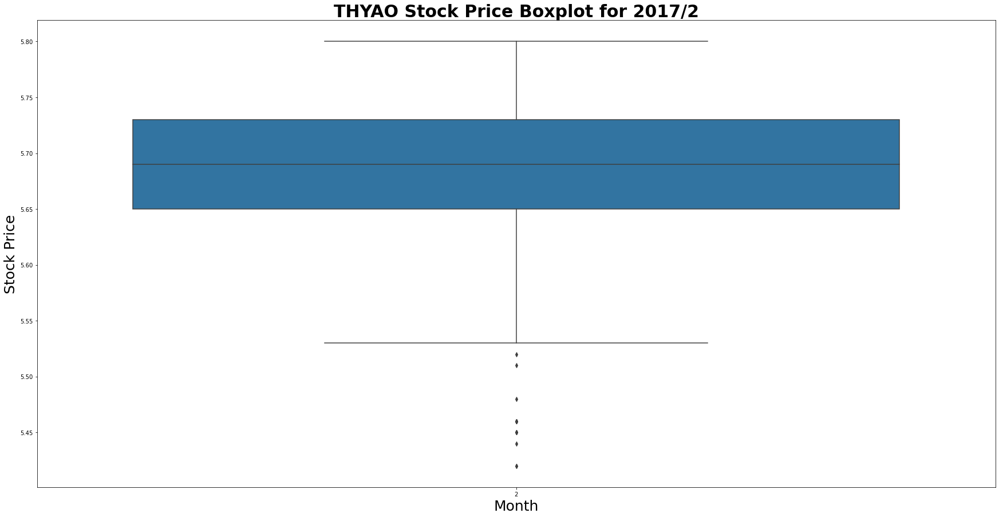

Upper Outliers for AKBNK in 2017/3
Timestamp: 2017-03-06 08:15:00+00:00, Price: 7.3414
Timestamp: 2017-03-06 08:30:00+00:00, Price: 7.3894
Timestamp: 2017-03-06 08:45:00+00:00, Price: 7.3733
Timestamp: 2017-03-06 09:00:00+00:00, Price: 7.3894
Timestamp: 2017-03-06 09:15:00+00:00, Price: 7.3894
Timestamp: 2017-03-06 09:30:00+00:00, Price: 7.3814
Timestamp: 2017-03-06 09:45:00+00:00, Price: 7.3894
Timestamp: 2017-03-06 10:00:00+00:00, Price: 7.3934
Timestamp: 2017-03-06 10:45:00+00:00, Price: 7.3974
Timestamp: 2017-03-06 11:00:00+00:00, Price: 7.3894
Timestamp: 2017-03-06 11:15:00+00:00, Price: 7.4135
Timestamp: 2017-03-06 11:30:00+00:00, Price: 7.4054
Timestamp: 2017-03-06 11:45:00+00:00, Price: 7.3974
Timestamp: 2017-03-06 12:00:00+00:00, Price: 7.3974
Timestamp: 2017-03-06 12:15:00+00:00, Price: 7.4135
Timestamp: 2017-03-06 12:30:00+00:00, Price: 7.4135
Timestamp: 2017-03-06 12:45:00+00:00, Price: 7.4375
Timestamp: 2017-03-06 13:00:00+00:00, Price: 7.4375
Timestamp: 2017-03-06 13:15:0

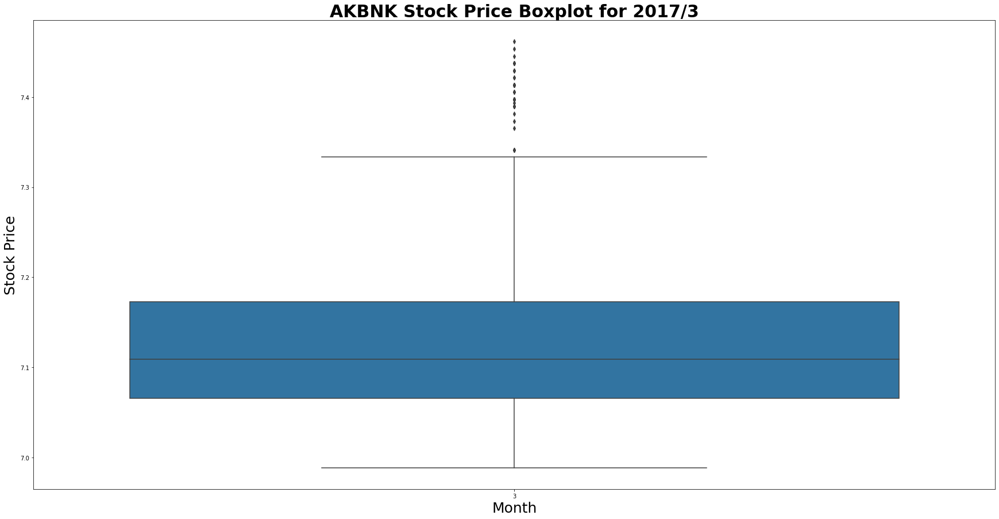

Upper Outliers for VAKBN in 2017/3
Timestamp: 2017-03-06 09:15:00+00:00, Price: 5.4613
Timestamp: 2017-03-06 09:45:00+00:00, Price: 5.4613
Timestamp: 2017-03-06 10:00:00+00:00, Price: 5.4613
Timestamp: 2017-03-06 10:45:00+00:00, Price: 5.4613
Timestamp: 2017-03-06 11:00:00+00:00, Price: 5.4711
Timestamp: 2017-03-06 11:15:00+00:00, Price: 5.4809
Timestamp: 2017-03-06 11:30:00+00:00, Price: 5.4711
Timestamp: 2017-03-06 11:45:00+00:00, Price: 5.4613
Timestamp: 2017-03-06 12:00:00+00:00, Price: 5.4711
Timestamp: 2017-03-06 12:15:00+00:00, Price: 5.4906
Timestamp: 2017-03-06 12:30:00+00:00, Price: 5.5005
Timestamp: 2017-03-06 12:45:00+00:00, Price: 5.5102
Timestamp: 2017-03-06 13:00:00+00:00, Price: 5.5102
Timestamp: 2017-03-06 13:15:00+00:00, Price: 5.52
Timestamp: 2017-03-06 13:30:00+00:00, Price: 5.5102
Timestamp: 2017-03-06 13:45:00+00:00, Price: 5.5102
Timestamp: 2017-03-06 14:00:00+00:00, Price: 5.4711
Timestamp: 2017-03-06 14:30:00+00:00, Price: 5.4613
Timestamp: 2017-03-06 14:45:00+

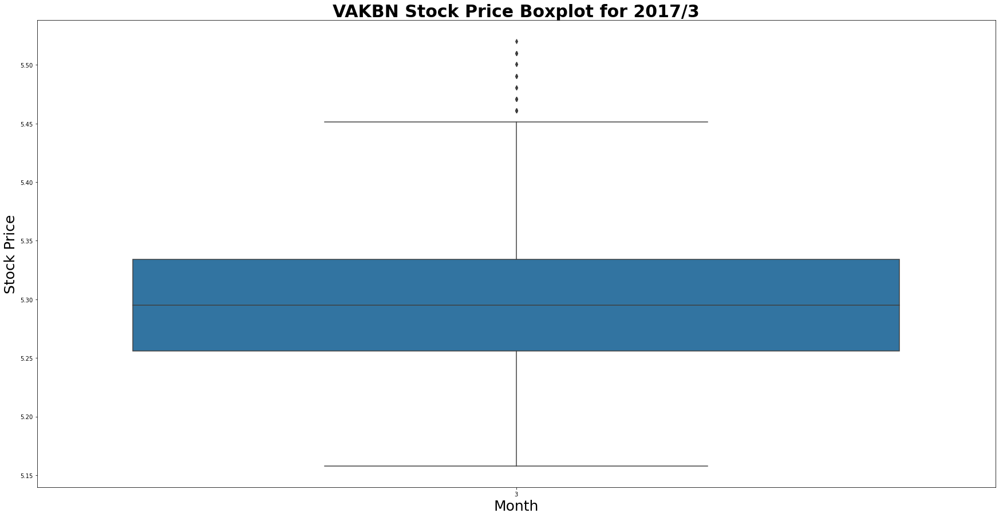

NO OUTLIERS


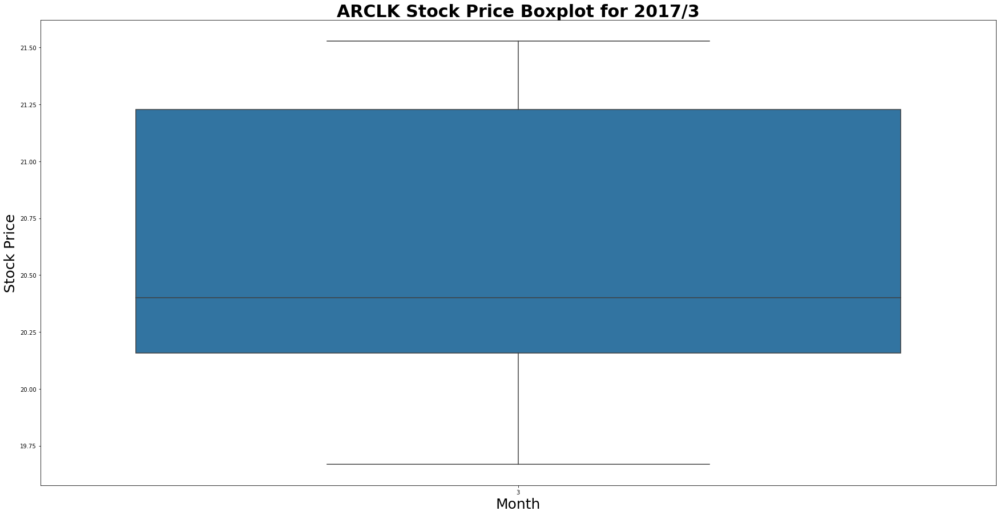

Upper Outliers for TUPRS in 2017/3
Timestamp: 2017-03-21 08:15:00+00:00, Price: 67.4099
Timestamp: 2017-03-21 08:30:00+00:00, Price: 67.7422
Timestamp: 2017-03-21 08:45:00+00:00, Price: 67.5945
Timestamp: 2017-03-21 09:00:00+00:00, Price: 67.3731
Timestamp: 2017-03-21 09:15:00+00:00, Price: 67.3731
Timestamp: 2017-03-21 09:45:00+00:00, Price: 67.3362
Timestamp: 2017-03-21 10:45:00+00:00, Price: 67.3362
Timestamp: 2017-03-21 15:00:00+00:00, Price: 67.3362
Lower Outliers for TUPRS in 2017/3
Timestamp: 2017-03-01 06:45:00+00:00, Price: 63.0538
Timestamp: 2017-03-01 07:00:00+00:00, Price: 63.0907
Timestamp: 2017-03-01 07:15:00+00:00, Price: 62.98
Timestamp: 2017-03-01 07:30:00+00:00, Price: 63.1276
Timestamp: 2017-03-01 07:45:00+00:00, Price: 63.1276
Timestamp: 2017-03-01 08:00:00+00:00, Price: 63.1276
Timestamp: 2017-03-01 08:15:00+00:00, Price: 63.2384
Timestamp: 2017-03-01 08:30:00+00:00, Price: 63.3491
Timestamp: 2017-03-01 08:45:00+00:00, Price: 63.2753
Timestamp: 2017-03-01 09:00:00+

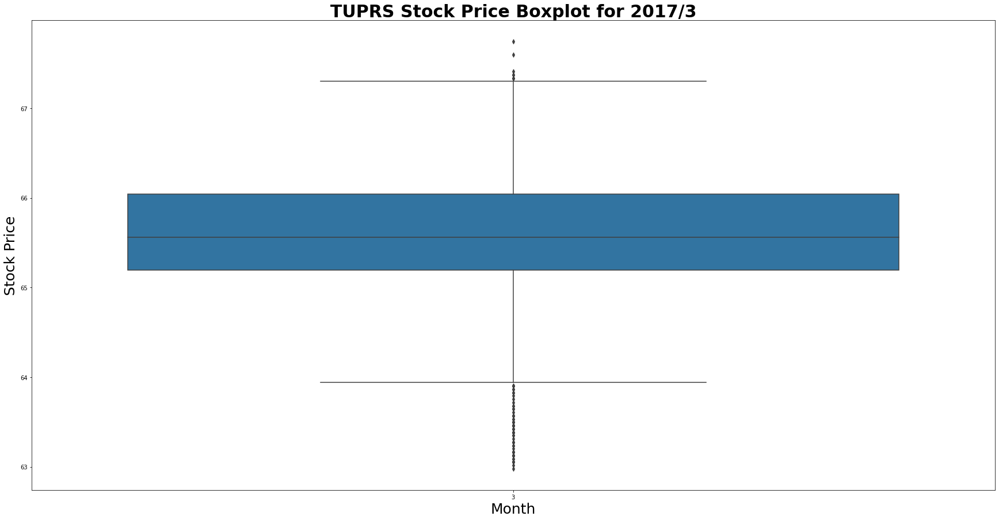

Upper Outliers for TCELL in 2017/3
Timestamp: 2017-03-06 07:00:00+00:00, Price: 10.4275
Timestamp: 2017-03-06 07:15:00+00:00, Price: 10.4275
Timestamp: 2017-03-06 07:30:00+00:00, Price: 10.4694
Timestamp: 2017-03-06 07:45:00+00:00, Price: 10.4527
Timestamp: 2017-03-06 08:00:00+00:00, Price: 10.4778
Timestamp: 2017-03-06 08:15:00+00:00, Price: 10.4778
Timestamp: 2017-03-06 08:30:00+00:00, Price: 10.4443
Timestamp: 2017-03-06 08:45:00+00:00, Price: 10.4527
Timestamp: 2017-03-06 09:00:00+00:00, Price: 10.4527
Timestamp: 2017-03-06 09:15:00+00:00, Price: 10.4527
Timestamp: 2017-03-06 09:30:00+00:00, Price: 10.4527
Timestamp: 2017-03-06 09:45:00+00:00, Price: 10.4527
Timestamp: 2017-03-06 10:00:00+00:00, Price: 10.45685
Timestamp: 2017-03-06 10:45:00+00:00, Price: 10.461
Timestamp: 2017-03-06 11:00:00+00:00, Price: 10.4778
Timestamp: 2017-03-06 11:15:00+00:00, Price: 10.4443
Timestamp: 2017-03-06 11:30:00+00:00, Price: 10.4944
Timestamp: 2017-03-06 11:45:00+00:00, Price: 10.4778
Timestamp: 

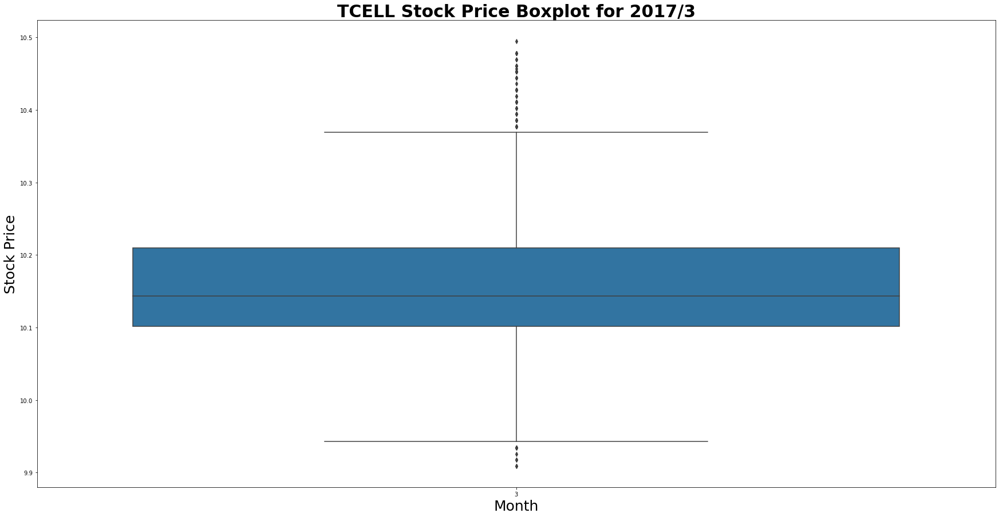

NO OUTLIERS


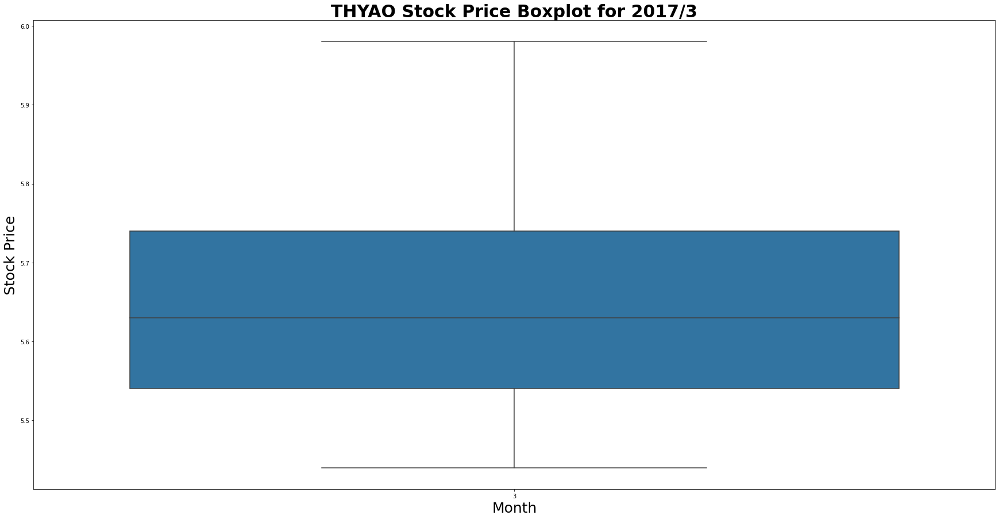

NO OUTLIERS


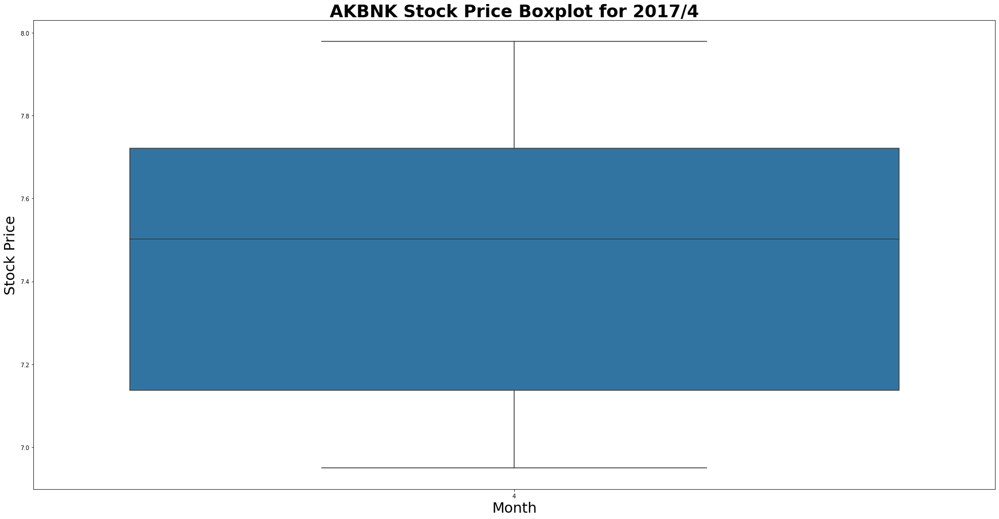

NO OUTLIERS


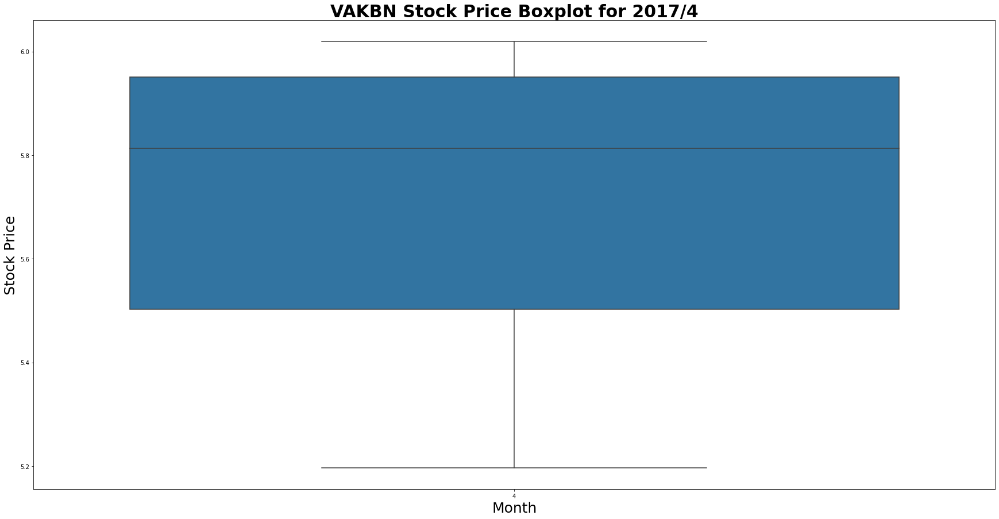

NO OUTLIERS


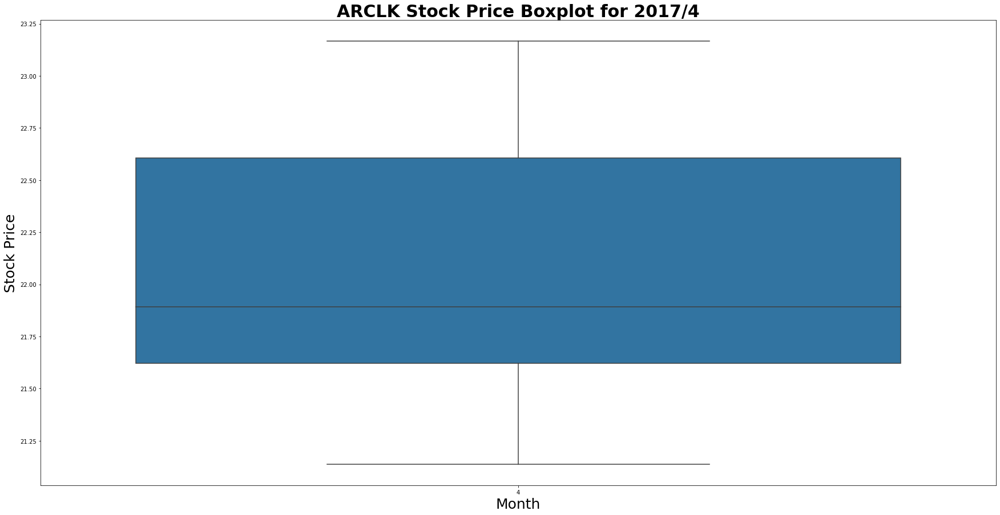

Upper Outliers for TUPRS in 2017/4
Timestamp: 2017-04-26 11:45:00+00:00, Price: 69.3235
Timestamp: 2017-04-26 12:45:00+00:00, Price: 69.3235
Timestamp: 2017-04-26 13:15:00+00:00, Price: 69.3632
Timestamp: 2017-04-26 13:45:00+00:00, Price: 69.3235
Timestamp: 2017-04-26 14:00:00+00:00, Price: 69.6409
Timestamp: 2017-04-26 14:15:00+00:00, Price: 69.6013
Timestamp: 2017-04-26 14:30:00+00:00, Price: 69.5616
Timestamp: 2017-04-26 14:45:00+00:00, Price: 69.7203
Timestamp: 2017-04-26 15:00:00+00:00, Price: 69.8393
Timestamp: 2017-04-27 06:45:00+00:00, Price: 69.7203
Timestamp: 2017-04-27 07:00:00+00:00, Price: 70.1964
Timestamp: 2017-04-27 07:15:00+00:00, Price: 70.0774
Timestamp: 2017-04-27 07:30:00+00:00, Price: 70.1171
Timestamp: 2017-04-27 07:45:00+00:00, Price: 70.1568
Timestamp: 2017-04-27 08:00:00+00:00, Price: 70.1171
Timestamp: 2017-04-27 08:15:00+00:00, Price: 70.1568
Timestamp: 2017-04-27 08:30:00+00:00, Price: 70.0377
Timestamp: 2017-04-27 08:45:00+00:00, Price: 70.0377
Timestamp: 

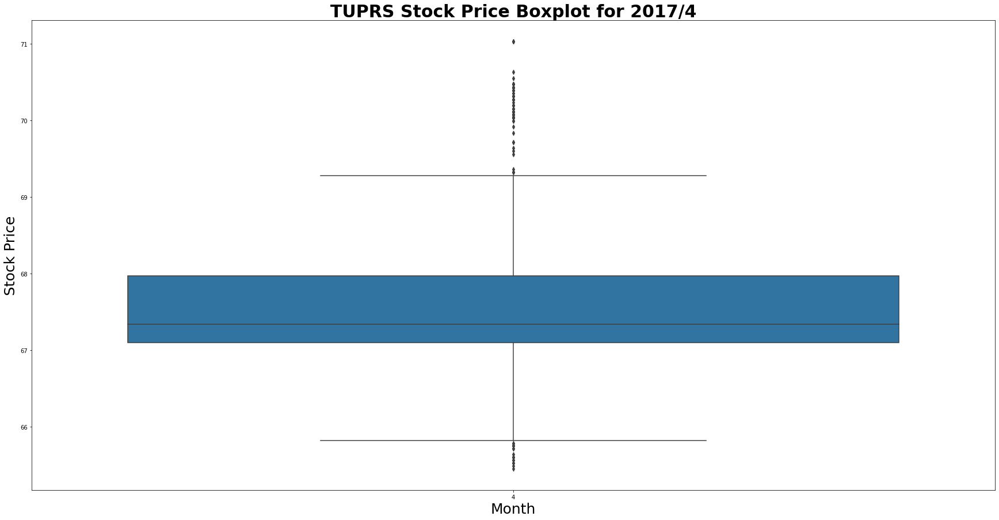

NO OUTLIERS


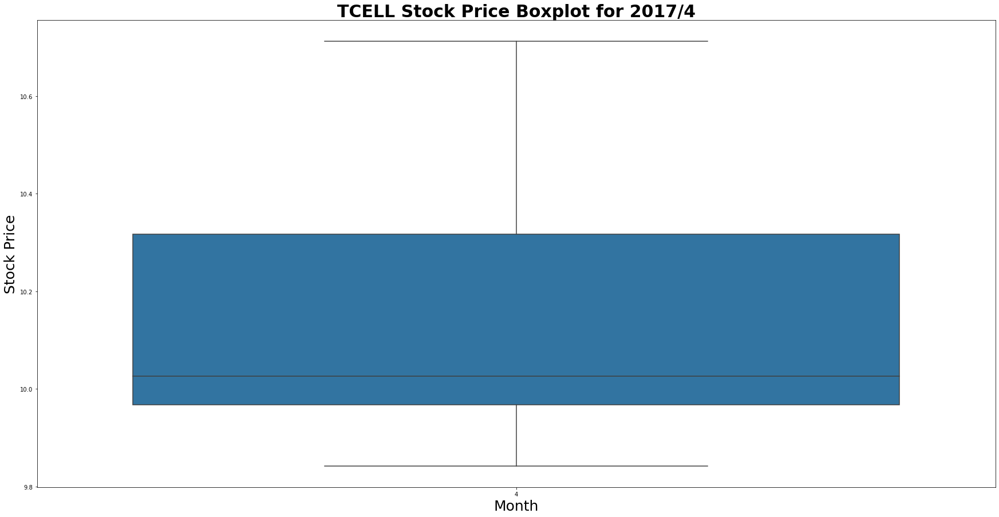

Upper Outliers for THYAO in 2017/4
Timestamp: 2017-04-26 07:45:00+00:00, Price: 6.09
Timestamp: 2017-04-26 08:00:00+00:00, Price: 6.14
Timestamp: 2017-04-26 08:15:00+00:00, Price: 6.13
Timestamp: 2017-04-26 08:30:00+00:00, Price: 6.11
Timestamp: 2017-04-26 08:45:00+00:00, Price: 6.1
Timestamp: 2017-04-26 09:00:00+00:00, Price: 6.11
Timestamp: 2017-04-26 09:15:00+00:00, Price: 6.1
Timestamp: 2017-04-26 09:30:00+00:00, Price: 6.1
Timestamp: 2017-04-26 09:45:00+00:00, Price: 6.1
Timestamp: 2017-04-26 10:00:00+00:00, Price: 6.1
Timestamp: 2017-04-26 10:45:00+00:00, Price: 6.1
Timestamp: 2017-04-26 11:00:00+00:00, Price: 6.1
Timestamp: 2017-04-26 11:15:00+00:00, Price: 6.11
Timestamp: 2017-04-26 11:30:00+00:00, Price: 6.14
Timestamp: 2017-04-26 11:45:00+00:00, Price: 6.13
Timestamp: 2017-04-26 12:00:00+00:00, Price: 6.11
Timestamp: 2017-04-26 12:15:00+00:00, Price: 6.12
Timestamp: 2017-04-26 12:30:00+00:00, Price: 6.12
Timestamp: 2017-04-26 12:45:00+00:00, Price: 6.12
Timestamp: 2017-04-26 

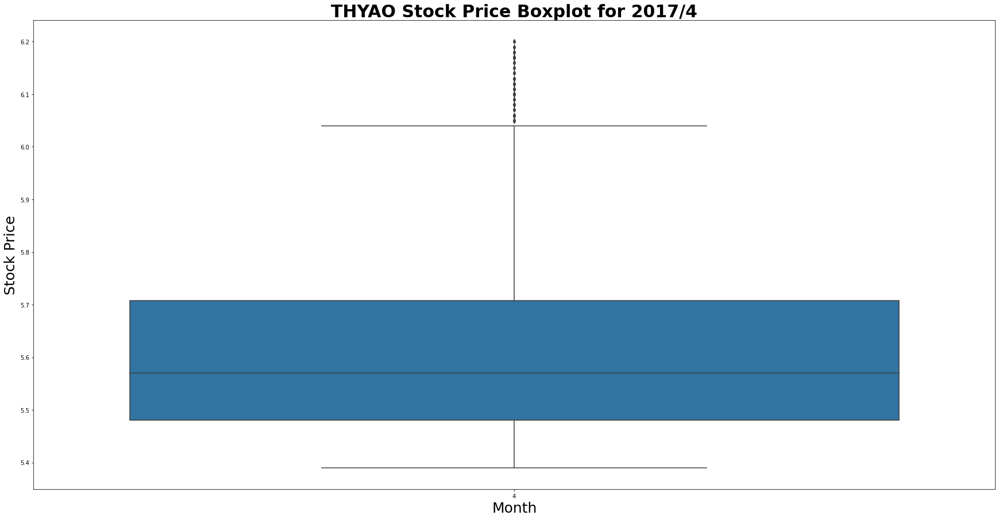

NO OUTLIERS


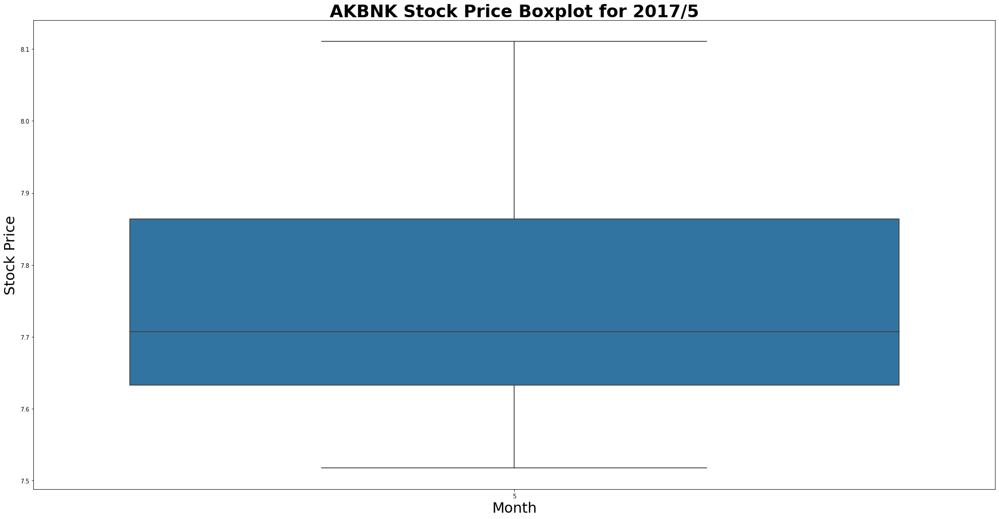

NO OUTLIERS


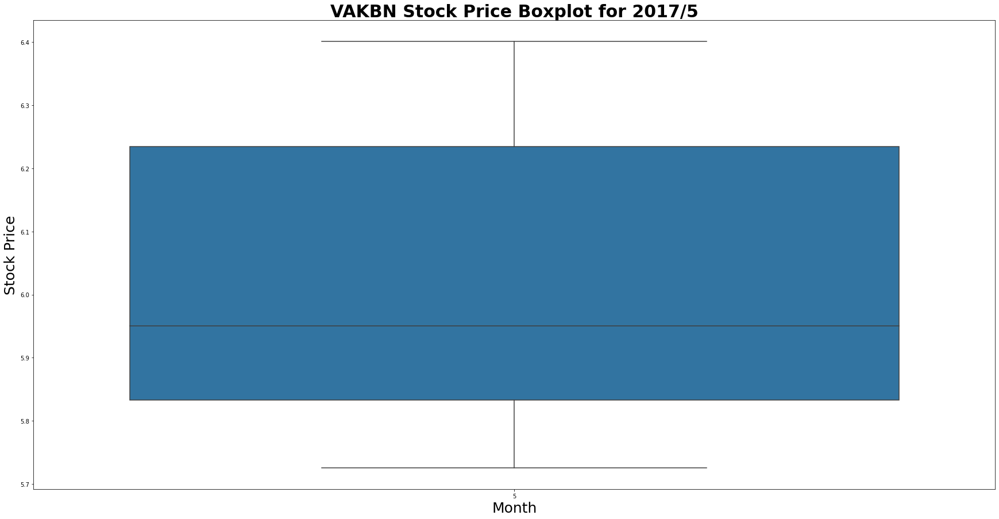

NO OUTLIERS


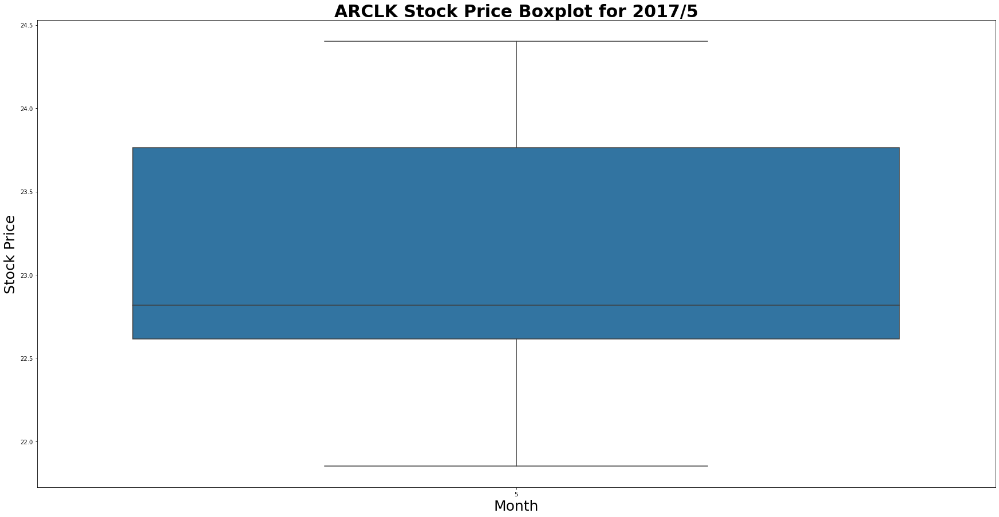

Lower Outliers for TUPRS in 2017/5
Timestamp: 2017-05-04 15:00:00+00:00, Price: 69.2838


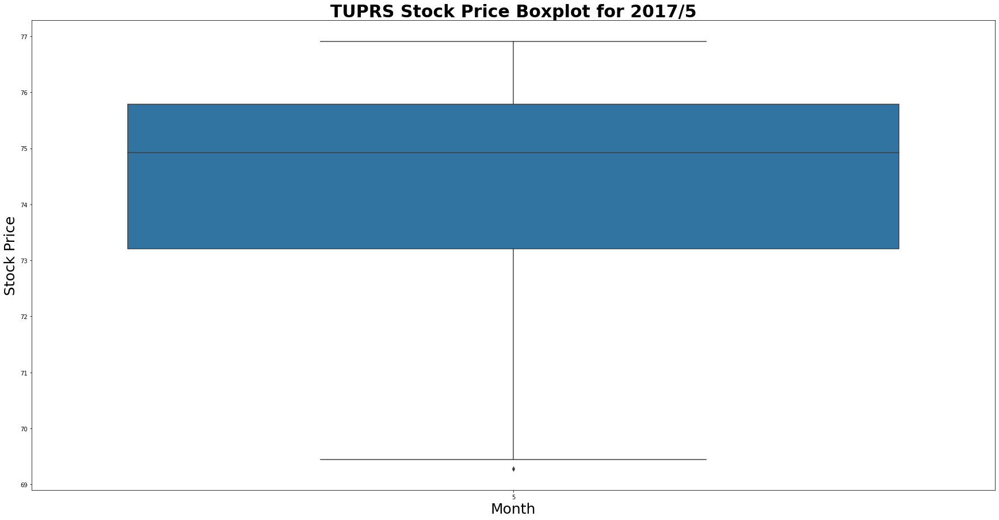

Upper Outliers for TCELL in 2017/5
Timestamp: 2017-05-03 11:15:00+00:00, Price: 10.4527
Timestamp: 2017-05-03 11:45:00+00:00, Price: 10.4527
Timestamp: 2017-05-03 12:15:00+00:00, Price: 10.4443
Timestamp: 2017-05-03 12:30:00+00:00, Price: 10.4443


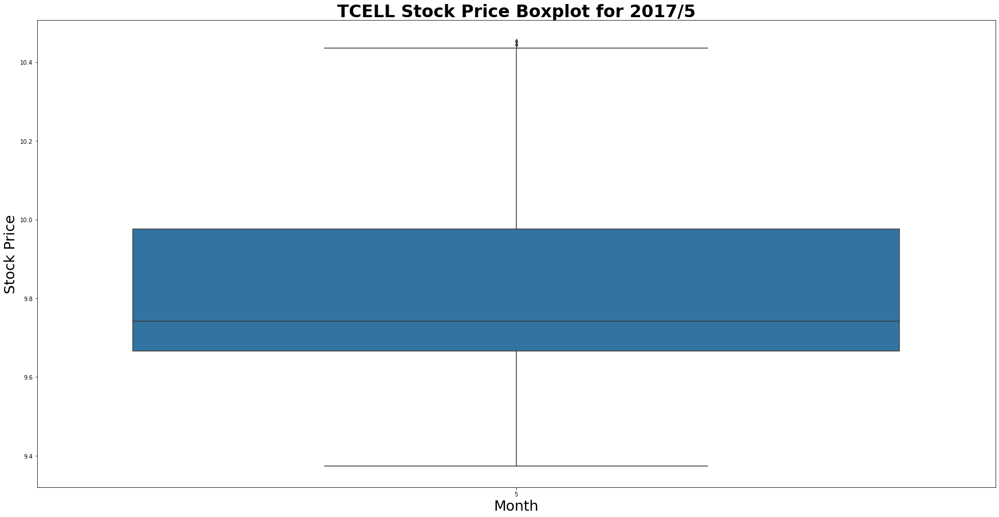

NO OUTLIERS


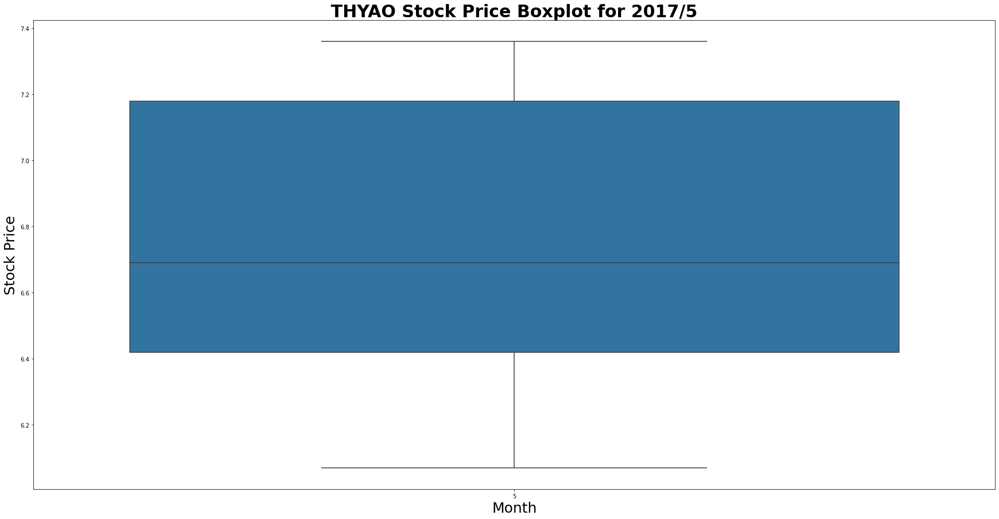

NO OUTLIERS


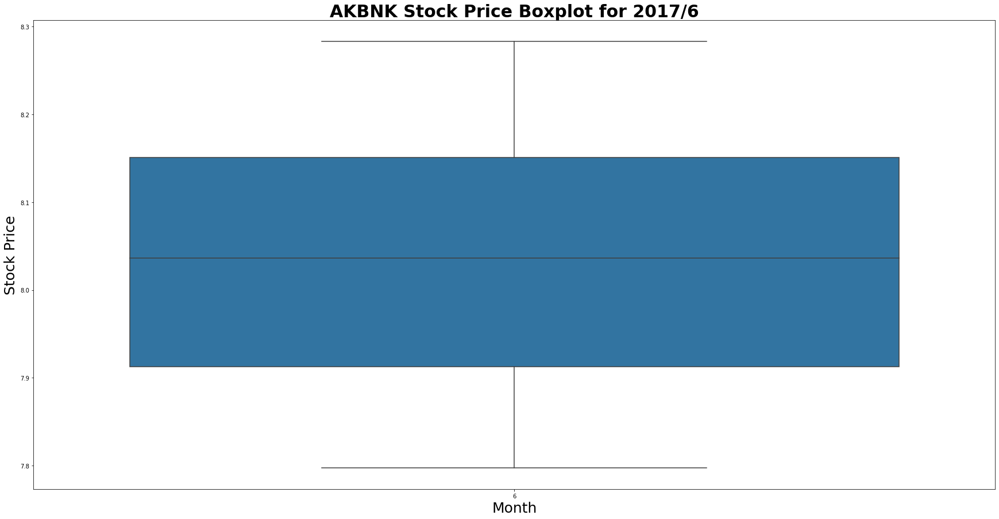

NO OUTLIERS


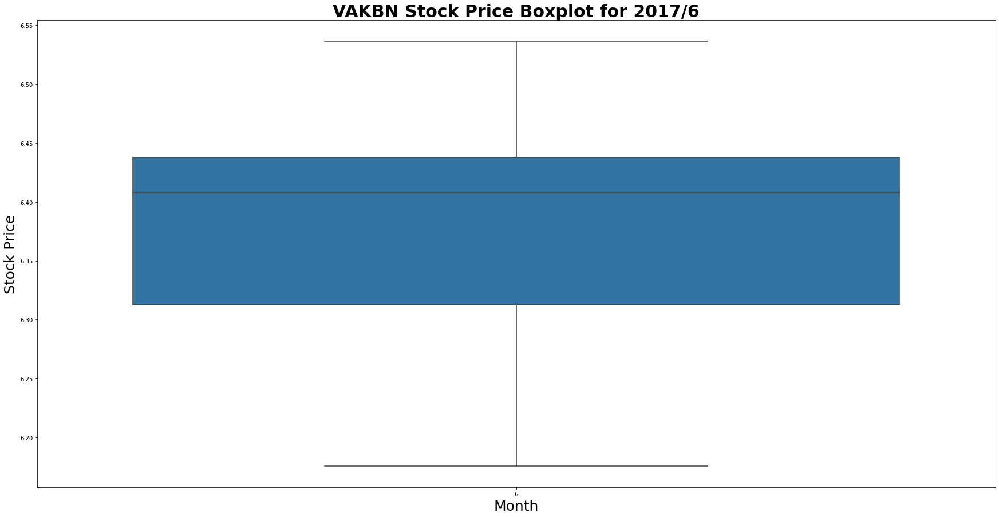

Upper Outliers for ARCLK in 2017/6
Timestamp: 2017-06-09 09:15:00+00:00, Price: 25.7522
Timestamp: 2017-06-09 09:30:00+00:00, Price: 25.7328
Timestamp: 2017-06-09 09:45:00+00:00, Price: 25.7328
Timestamp: 2017-06-09 10:45:00+00:00, Price: 25.7135
Timestamp: 2017-06-09 11:00:00+00:00, Price: 25.7715
Timestamp: 2017-06-09 11:15:00+00:00, Price: 25.7522
Timestamp: 2017-06-09 11:30:00+00:00, Price: 25.7328
Timestamp: 2017-06-09 11:45:00+00:00, Price: 25.7715
Timestamp: 2017-06-09 12:00:00+00:00, Price: 25.7715
Timestamp: 2017-06-09 12:15:00+00:00, Price: 25.7715
Timestamp: 2017-06-09 12:30:00+00:00, Price: 25.7715
Timestamp: 2017-06-09 12:45:00+00:00, Price: 25.7908
Timestamp: 2017-06-09 13:00:00+00:00, Price: 25.7328
Timestamp: 2017-06-09 13:15:00+00:00, Price: 25.7715
Timestamp: 2017-06-09 13:30:00+00:00, Price: 25.7715
Timestamp: 2017-06-09 13:45:00+00:00, Price: 25.7908
Timestamp: 2017-06-09 14:00:00+00:00, Price: 25.8101
Timestamp: 2017-06-09 14:15:00+00:00, Price: 25.8294
Timestamp: 

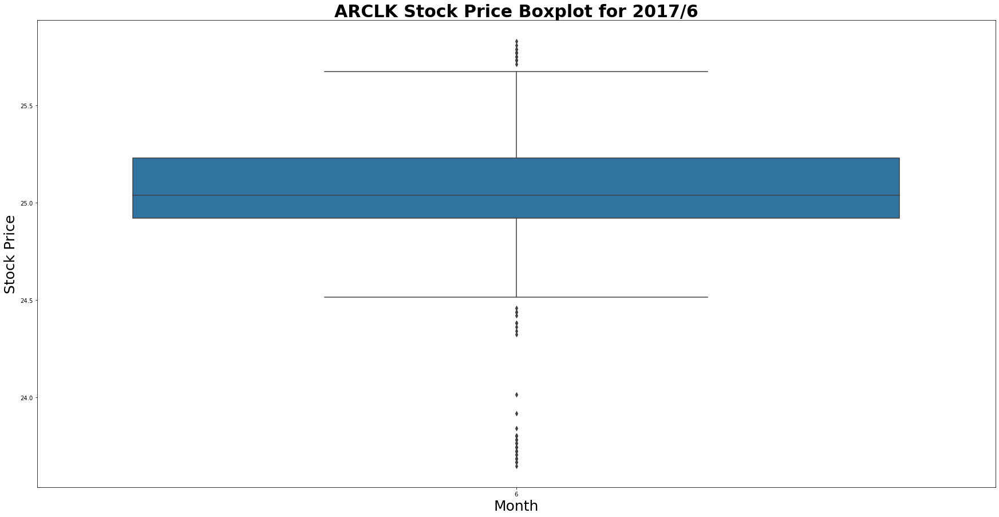

Lower Outliers for TUPRS in 2017/6
Timestamp: 2017-06-01 06:45:00+00:00, Price: 75.7915
Timestamp: 2017-06-01 07:00:00+00:00, Price: 75.7915
Timestamp: 2017-06-01 07:15:00+00:00, Price: 75.6328
Timestamp: 2017-06-01 07:30:00+00:00, Price: 75.7915
Timestamp: 2017-06-01 07:45:00+00:00, Price: 75.7519
Timestamp: 2017-06-01 08:00:00+00:00, Price: 75.7122
Timestamp: 2017-06-01 08:15:00+00:00, Price: 75.7915
Timestamp: 2017-06-01 08:30:00+00:00, Price: 75.7915
Timestamp: 2017-06-01 08:45:00+00:00, Price: 75.8312
Timestamp: 2017-06-01 09:00:00+00:00, Price: 75.8312
Timestamp: 2017-06-01 09:15:00+00:00, Price: 75.8312
Timestamp: 2017-06-01 09:30:00+00:00, Price: 75.8312
Timestamp: 2017-06-01 09:45:00+00:00, Price: 75.9106
Timestamp: 2017-06-01 10:45:00+00:00, Price: 75.7122
Timestamp: 2017-06-01 11:00:00+00:00, Price: 75.7915
Timestamp: 2017-06-01 11:15:00+00:00, Price: 75.7915
Timestamp: 2017-06-01 11:30:00+00:00, Price: 75.7915
Timestamp: 2017-06-01 11:45:00+00:00, Price: 75.8709
Timestamp: 

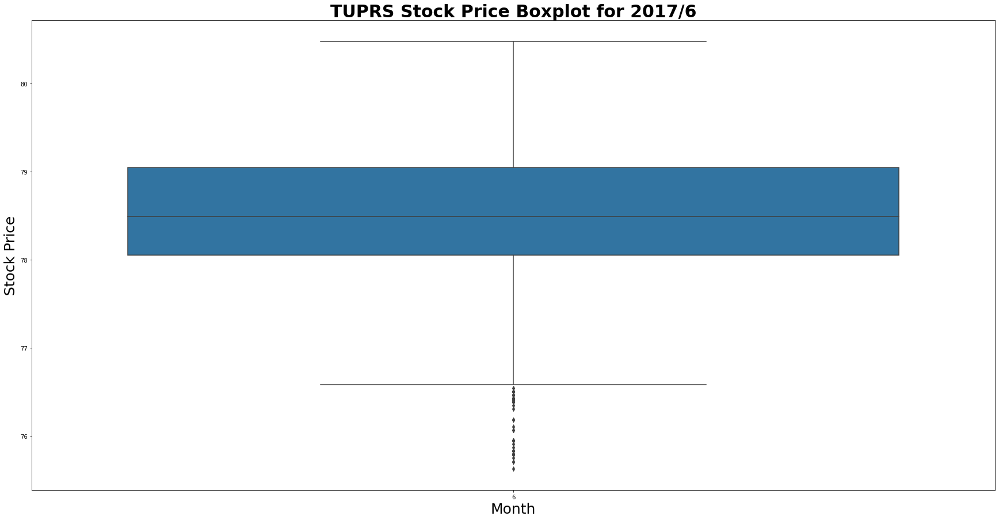

NO OUTLIERS


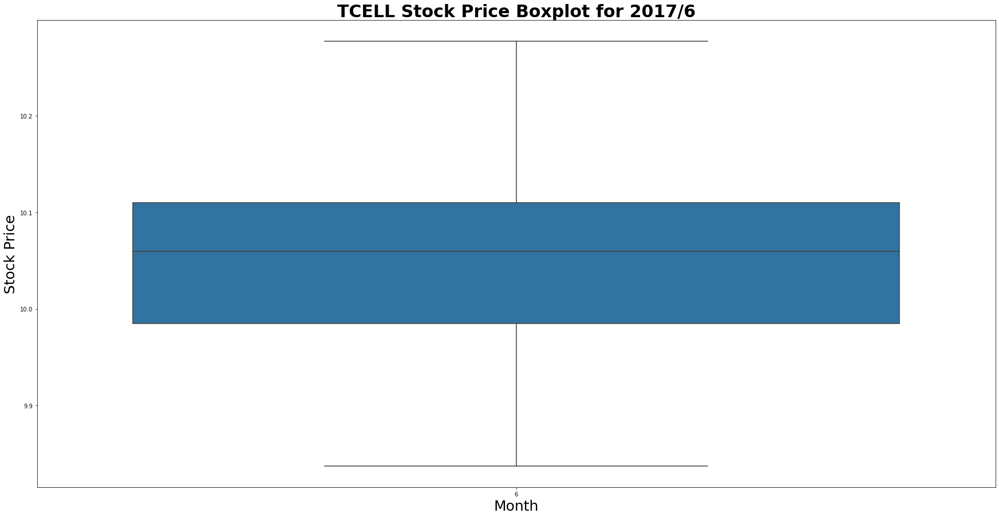

Upper Outliers for THYAO in 2017/6
Timestamp: 2017-06-23 08:00:00+00:00, Price: 7.76
Timestamp: 2017-06-23 08:45:00+00:00, Price: 7.77
Timestamp: 2017-06-23 15:00:00+00:00, Price: 7.77
Timestamp: 2017-06-28 07:00:00+00:00, Price: 7.83
Timestamp: 2017-06-28 07:15:00+00:00, Price: 7.9
Timestamp: 2017-06-28 07:30:00+00:00, Price: 7.93
Timestamp: 2017-06-28 07:45:00+00:00, Price: 7.92
Timestamp: 2017-06-28 08:00:00+00:00, Price: 7.87
Timestamp: 2017-06-28 08:15:00+00:00, Price: 7.88
Timestamp: 2017-06-28 08:30:00+00:00, Price: 7.88
Timestamp: 2017-06-28 08:45:00+00:00, Price: 7.86
Timestamp: 2017-06-28 09:00:00+00:00, Price: 7.88
Timestamp: 2017-06-28 09:15:00+00:00, Price: 7.88
Timestamp: 2017-06-28 09:30:00+00:00, Price: 7.88
Timestamp: 2017-06-28 09:45:00+00:00, Price: 7.89
Timestamp: 2017-06-28 10:00:00+00:00, Price: 7.89
Timestamp: 2017-06-28 10:45:00+00:00, Price: 7.89
Timestamp: 2017-06-28 11:00:00+00:00, Price: 7.89
Timestamp: 2017-06-28 11:15:00+00:00, Price: 7.9
Timestamp: 2017-0

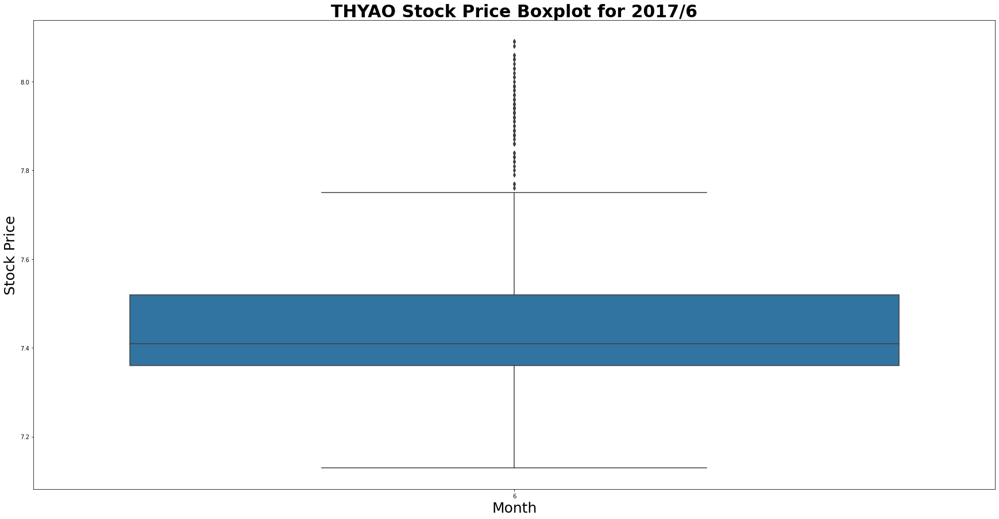

NO OUTLIERS


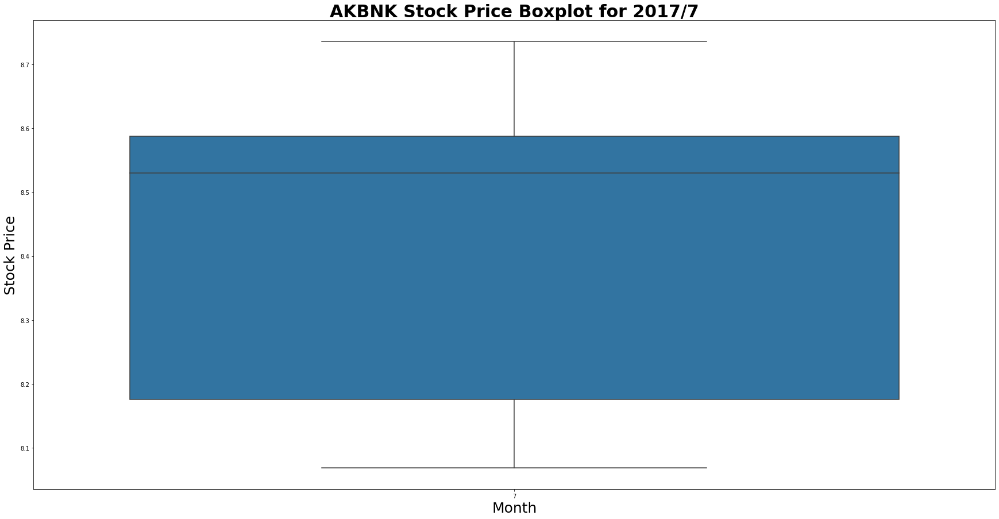

NO OUTLIERS


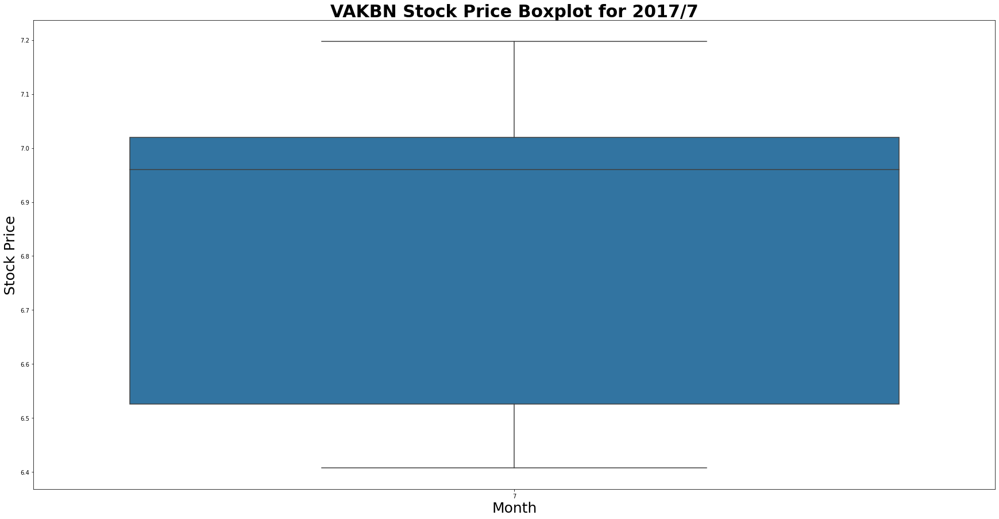

NO OUTLIERS


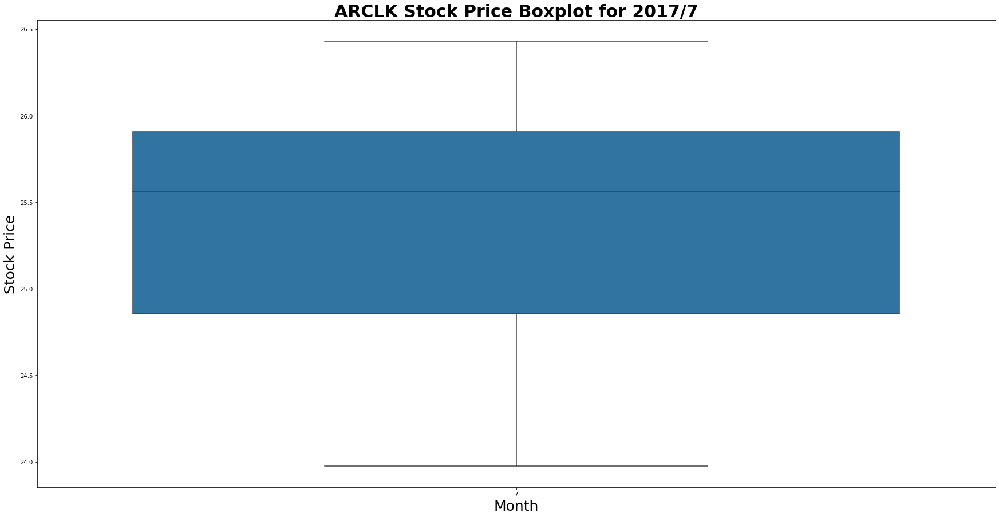

NO OUTLIERS


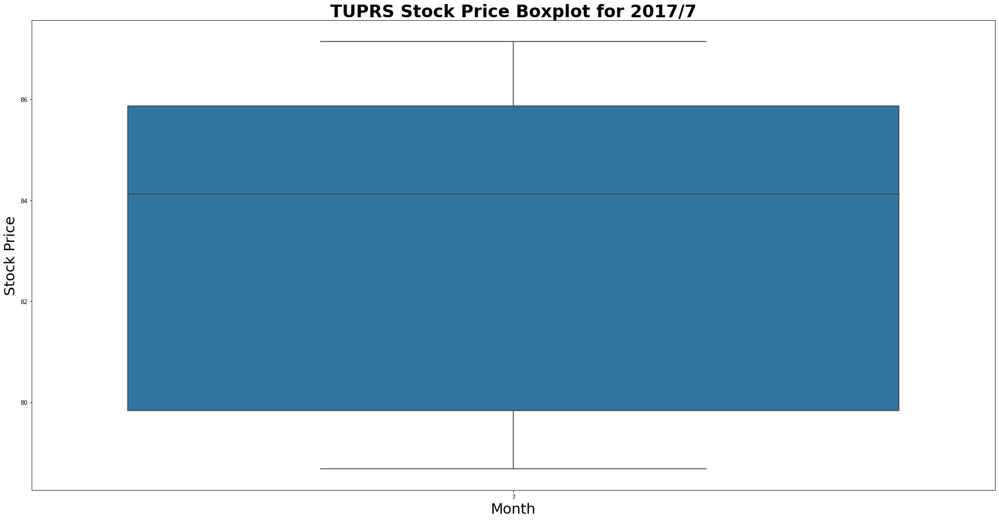

Upper Outliers for TCELL in 2017/7
Timestamp: 2017-07-28 12:15:00+00:00, Price: 11.4711
Timestamp: 2017-07-28 12:30:00+00:00, Price: 11.4711
Timestamp: 2017-07-28 12:45:00+00:00, Price: 11.4711


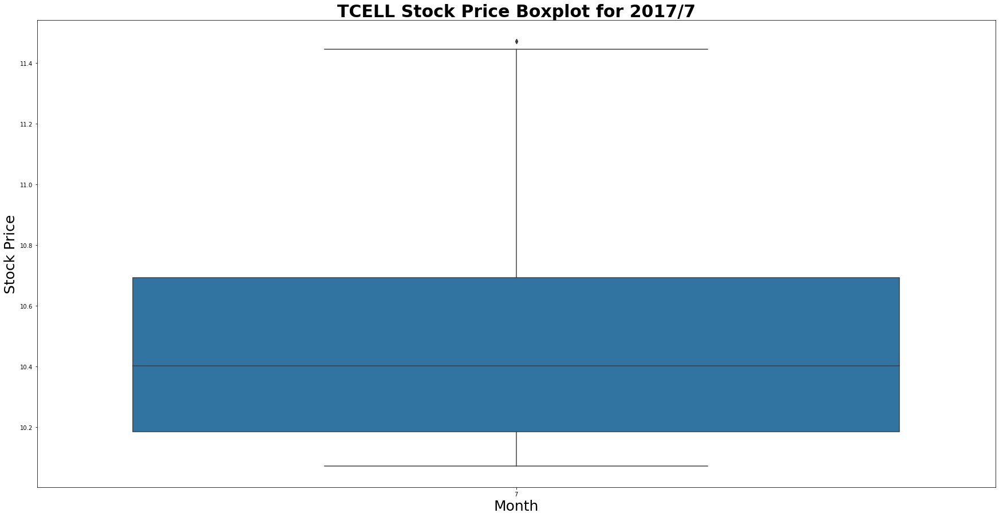

Lower Outliers for THYAO in 2017/7
Timestamp: 2017-07-03 06:45:00+00:00, Price: 8.1
Timestamp: 2017-07-03 07:00:00+00:00, Price: 8.09
Timestamp: 2017-07-03 07:15:00+00:00, Price: 8.08
Timestamp: 2017-07-03 07:30:00+00:00, Price: 8.09
Timestamp: 2017-07-03 07:45:00+00:00, Price: 8.1
Timestamp: 2017-07-03 08:00:00+00:00, Price: 8.11
Timestamp: 2017-07-03 08:15:00+00:00, Price: 8.12
Timestamp: 2017-07-03 08:30:00+00:00, Price: 8.11
Timestamp: 2017-07-03 08:45:00+00:00, Price: 8.16
Timestamp: 2017-07-03 09:00:00+00:00, Price: 8.13
Timestamp: 2017-07-03 09:15:00+00:00, Price: 8.11
Timestamp: 2017-07-03 09:30:00+00:00, Price: 8.1
Timestamp: 2017-07-03 09:45:00+00:00, Price: 8.1
Timestamp: 2017-07-03 10:45:00+00:00, Price: 8.1
Timestamp: 2017-07-03 11:00:00+00:00, Price: 8.12
Timestamp: 2017-07-03 11:15:00+00:00, Price: 8.1
Timestamp: 2017-07-03 11:30:00+00:00, Price: 8.1
Timestamp: 2017-07-03 11:45:00+00:00, Price: 8.1
Timestamp: 2017-07-03 12:00:00+00:00, Price: 8.09
Timestamp: 2017-07-03 1

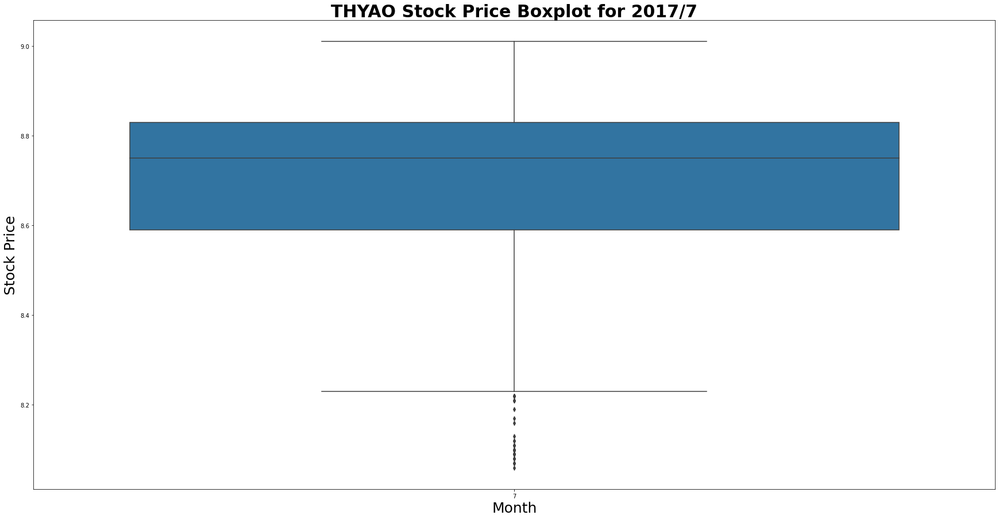

NO OUTLIERS


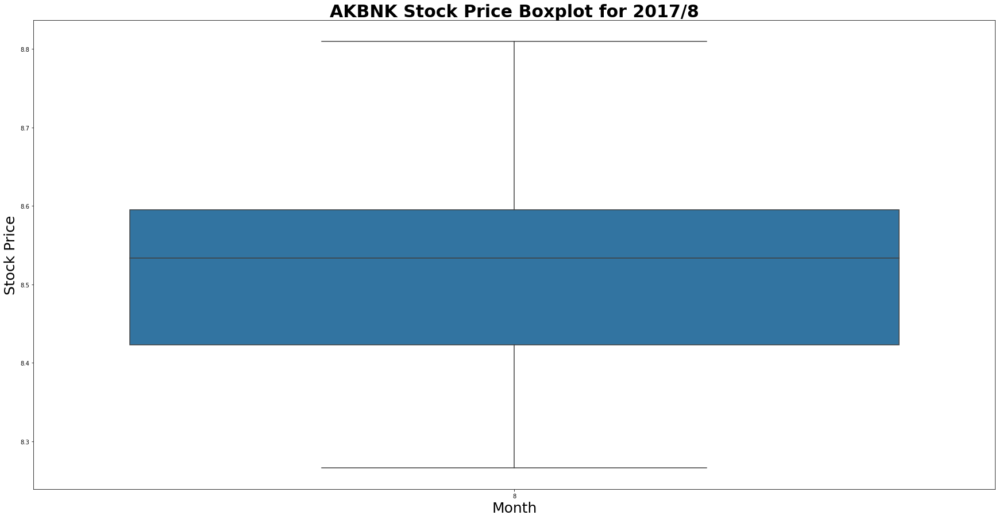

NO OUTLIERS


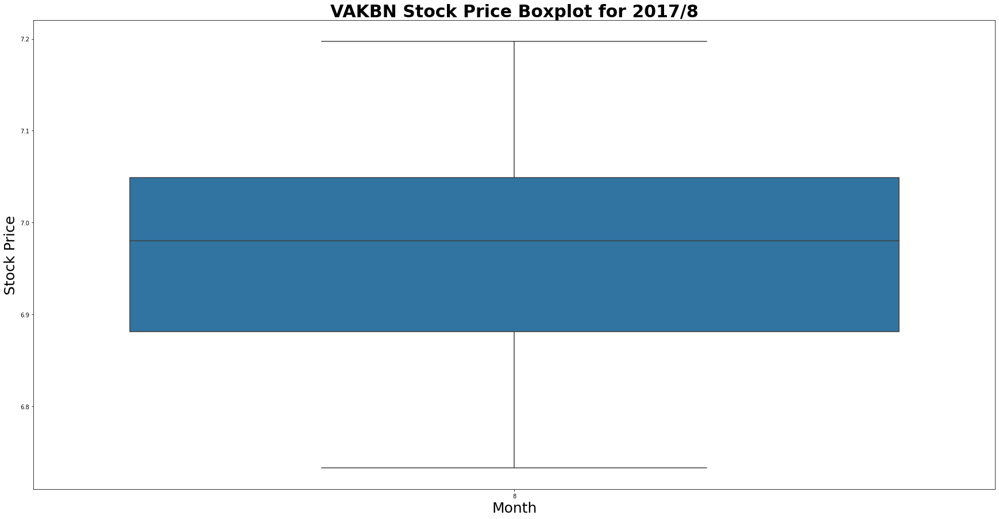

NO OUTLIERS


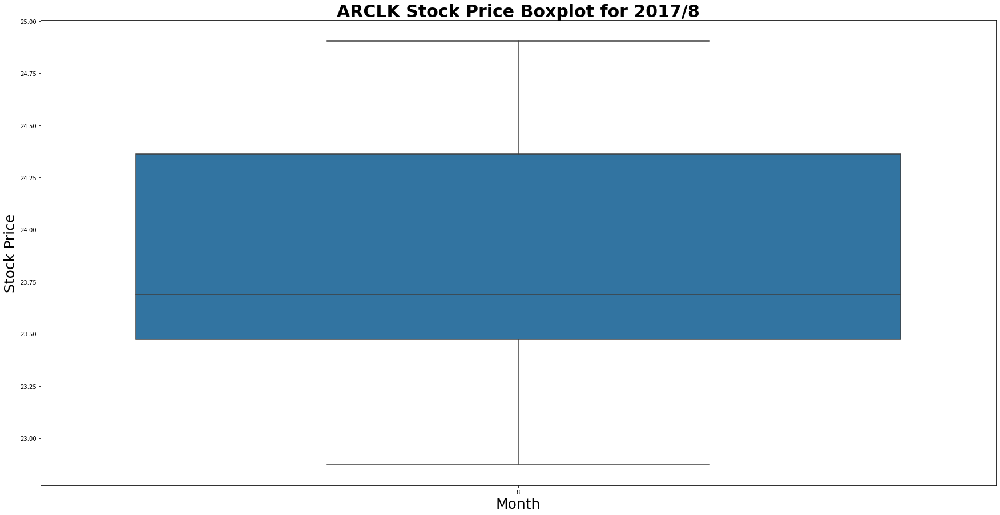

Lower Outliers for TUPRS in 2017/8
Timestamp: 2017-08-01 06:45:00+00:00, Price: 86.0293
Timestamp: 2017-08-01 07:00:00+00:00, Price: 86.4262
Timestamp: 2017-08-01 07:15:00+00:00, Price: 86.1881
Timestamp: 2017-08-01 07:30:00+00:00, Price: 86.0293
Timestamp: 2017-08-01 07:45:00+00:00, Price: 86.0293
Timestamp: 2017-08-01 08:00:00+00:00, Price: 86.0293
Timestamp: 2017-08-01 08:15:00+00:00, Price: 85.8706
Timestamp: 2017-08-01 08:30:00+00:00, Price: 85.7912
Timestamp: 2017-08-01 08:45:00+00:00, Price: 85.6325
Timestamp: 2017-08-01 09:00:00+00:00, Price: 84.2834
Timestamp: 2017-08-01 09:15:00+00:00, Price: 84.7596
Timestamp: 2017-08-01 09:30:00+00:00, Price: 84.7596
Timestamp: 2017-08-01 09:45:00+00:00, Price: 84.6008
Timestamp: 2017-08-01 10:45:00+00:00, Price: 84.6008
Timestamp: 2017-08-01 11:00:00+00:00, Price: 84.5215
Timestamp: 2017-08-01 11:15:00+00:00, Price: 84.9977
Timestamp: 2017-08-01 11:30:00+00:00, Price: 84.9183
Timestamp: 2017-08-01 11:45:00+00:00, Price: 84.9183
Timestamp: 

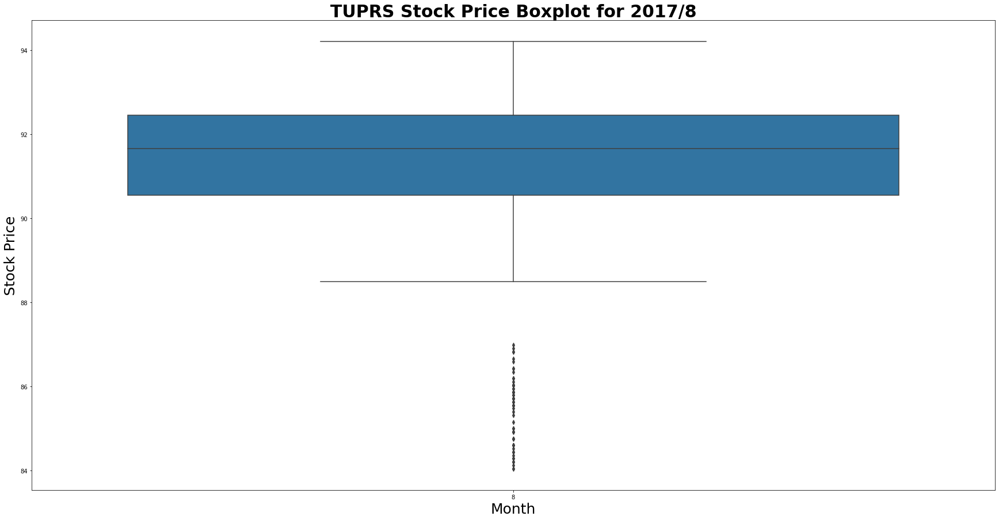

NO OUTLIERS


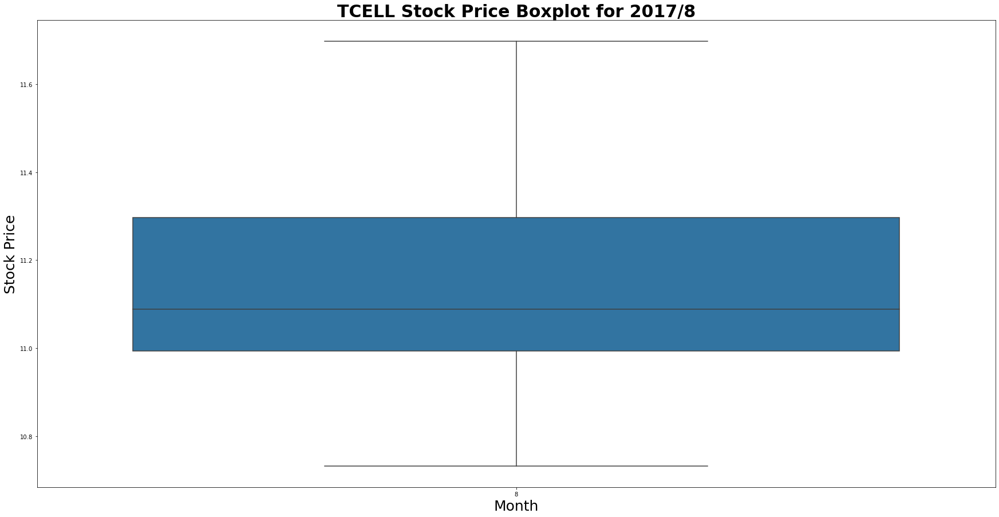

NO OUTLIERS


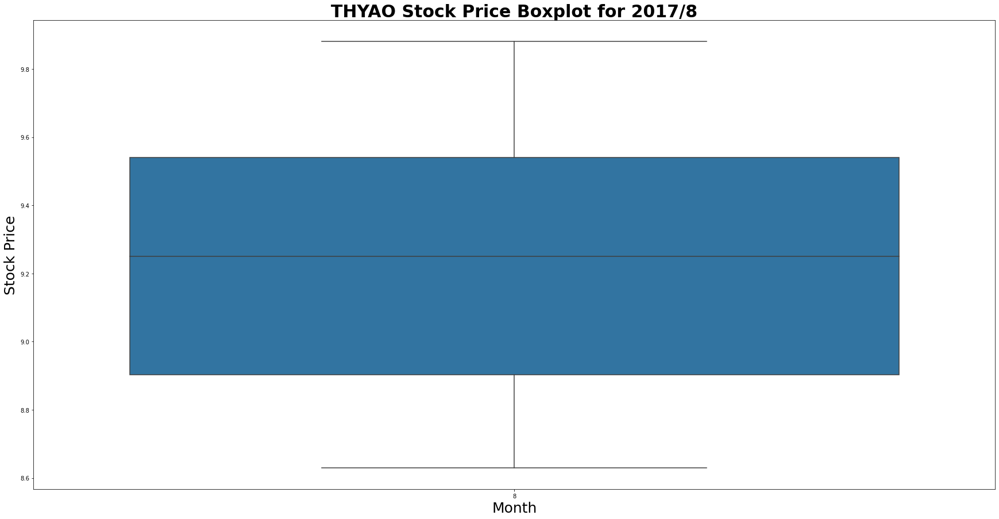

NO OUTLIERS


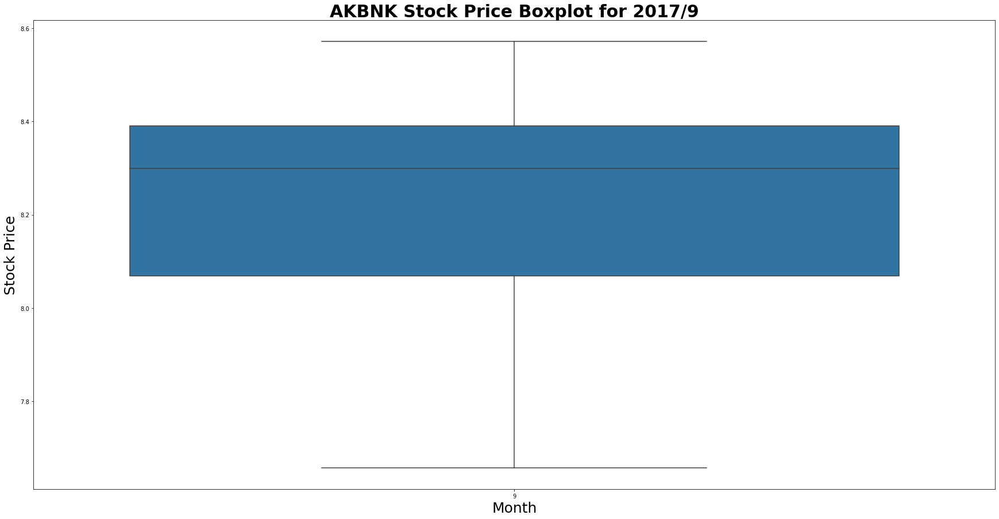

Upper Outliers for VAKBN in 2017/9
Timestamp: 2017-09-05 06:45:00+00:00, Price: 7.118


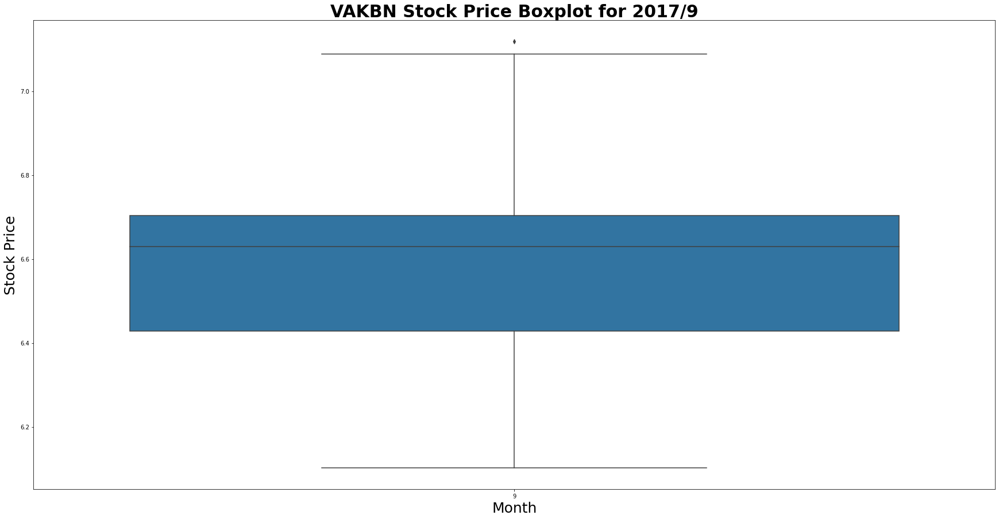

NO OUTLIERS


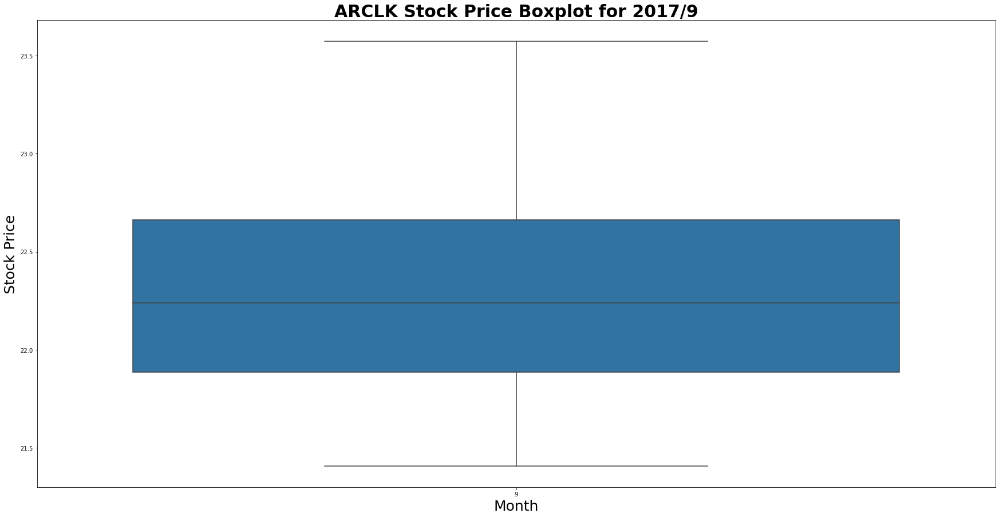

NO OUTLIERS


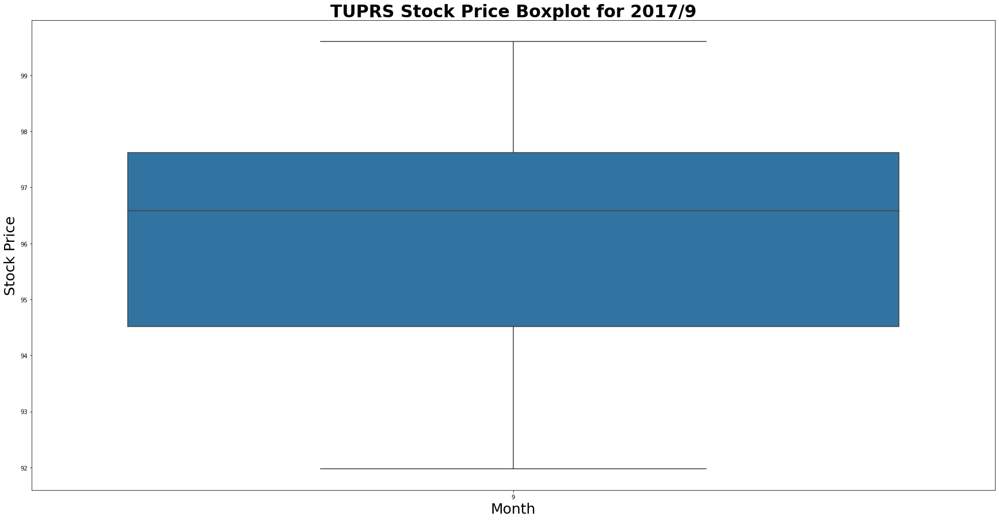

NO OUTLIERS


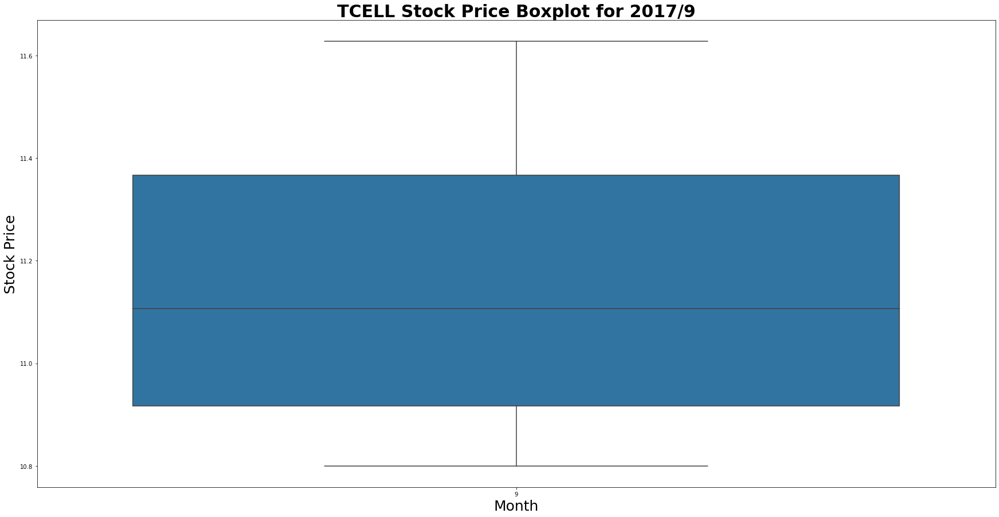

NO OUTLIERS


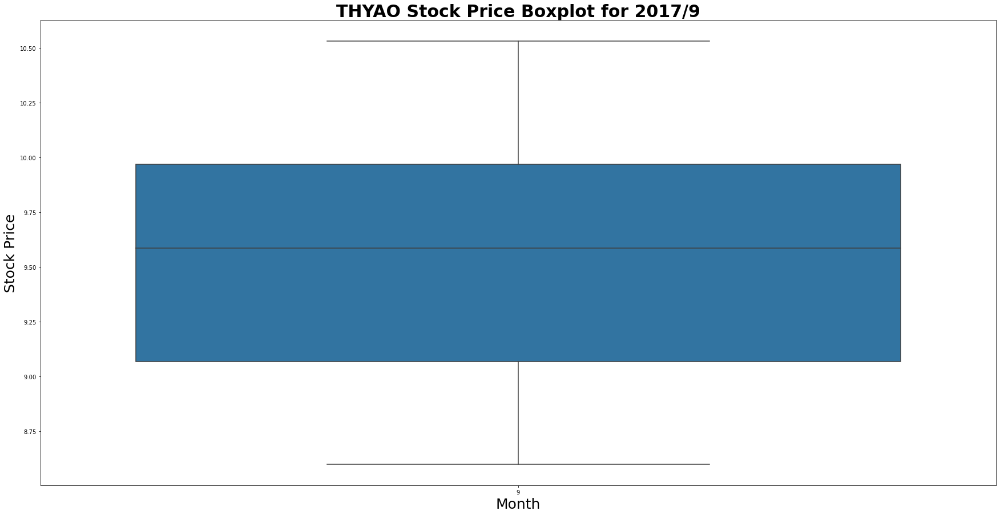

Upper Outliers for AKBNK in 2017/10
Timestamp: 2017-10-31 12:45:00+00:00, Price: 8.1925
Timestamp: 2017-10-31 13:00:00+00:00, Price: 8.1925
Timestamp: 2017-10-31 13:15:00+00:00, Price: 8.1925
Timestamp: 2017-10-31 13:30:00+00:00, Price: 8.2007
Timestamp: 2017-10-31 13:45:00+00:00, Price: 8.1925
Timestamp: 2017-10-31 14:00:00+00:00, Price: 8.1925
Timestamp: 2017-10-31 14:30:00+00:00, Price: 8.2007
Timestamp: 2017-10-31 14:45:00+00:00, Price: 8.2007
Timestamp: 2017-10-31 15:00:00+00:00, Price: 8.2336
Lower Outliers for AKBNK in 2017/10
Timestamp: 2017-10-09 06:45:00+00:00, Price: 7.518
Timestamp: 2017-10-09 07:00:00+00:00, Price: 7.3946
Timestamp: 2017-10-09 07:15:00+00:00, Price: 7.4769
Timestamp: 2017-10-09 07:30:00+00:00, Price: 7.4357
Timestamp: 2017-10-09 07:45:00+00:00, Price: 7.4439
Timestamp: 2017-10-09 08:00:00+00:00, Price: 7.4357
Timestamp: 2017-10-09 08:15:00+00:00, Price: 7.4192
Timestamp: 2017-10-09 08:30:00+00:00, Price: 7.4275
Timestamp: 2017-10-09 08:45:00+00:00, Price: 

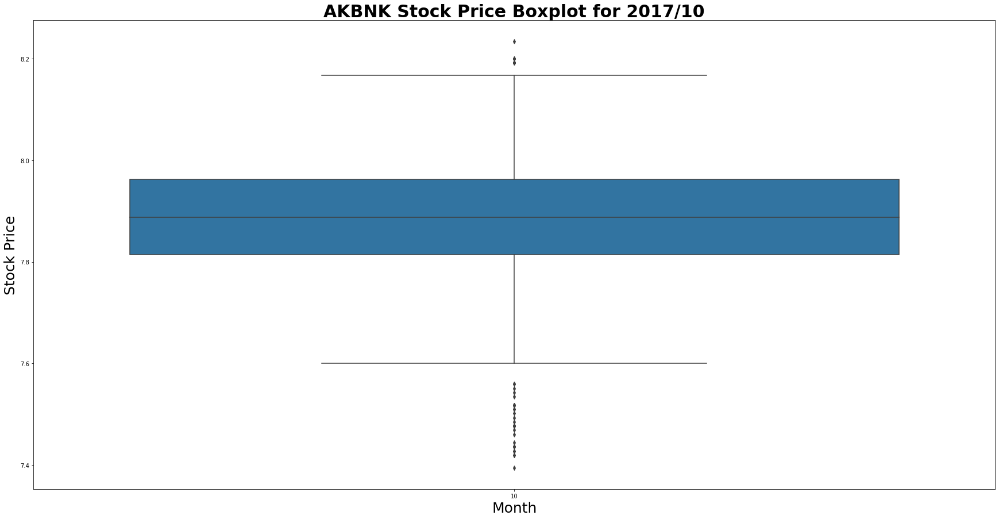

Upper Outliers for VAKBN in 2017/10
Timestamp: 2017-10-19 14:15:00+00:00, Price: 6.3885
Timestamp: 2017-10-19 14:30:00+00:00, Price: 6.3983
Timestamp: 2017-10-20 06:45:00+00:00, Price: 6.3786
Timestamp: 2017-10-20 07:00:00+00:00, Price: 6.3786
Timestamp: 2017-10-20 07:15:00+00:00, Price: 6.3983
Timestamp: 2017-10-20 07:30:00+00:00, Price: 6.4377
Timestamp: 2017-10-20 07:45:00+00:00, Price: 6.5068
Timestamp: 2017-10-20 08:00:00+00:00, Price: 6.5265
Timestamp: 2017-10-20 08:15:00+00:00, Price: 6.5068
Timestamp: 2017-10-20 08:30:00+00:00, Price: 6.487
Timestamp: 2017-10-20 08:45:00+00:00, Price: 6.4969
Timestamp: 2017-10-20 09:00:00+00:00, Price: 6.487
Timestamp: 2017-10-20 09:15:00+00:00, Price: 6.4969
Timestamp: 2017-10-20 09:30:00+00:00, Price: 6.487
Timestamp: 2017-10-20 09:45:00+00:00, Price: 6.4772
Timestamp: 2017-10-20 10:45:00+00:00, Price: 6.4772
Timestamp: 2017-10-20 11:00:00+00:00, Price: 6.4772
Timestamp: 2017-10-20 11:15:00+00:00, Price: 6.4772
Timestamp: 2017-10-20 11:30:00+

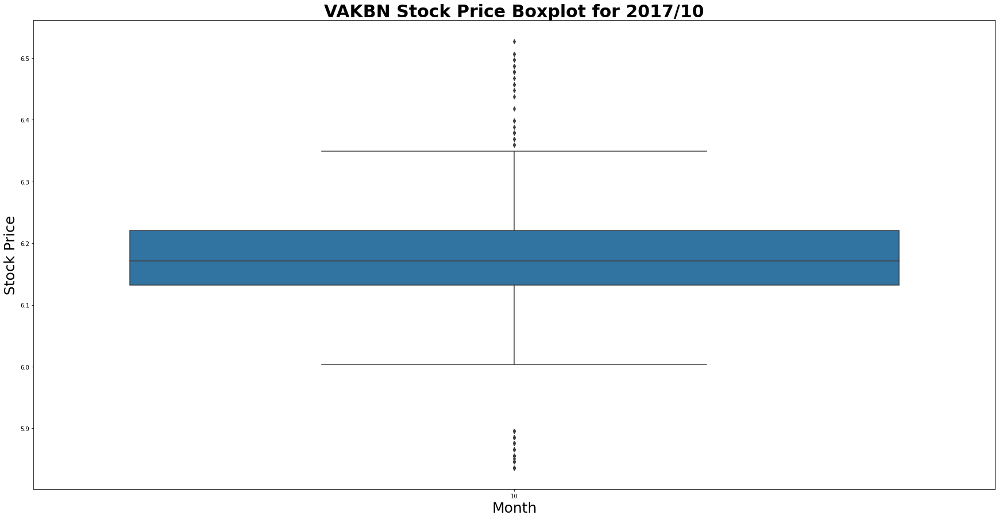

NO OUTLIERS


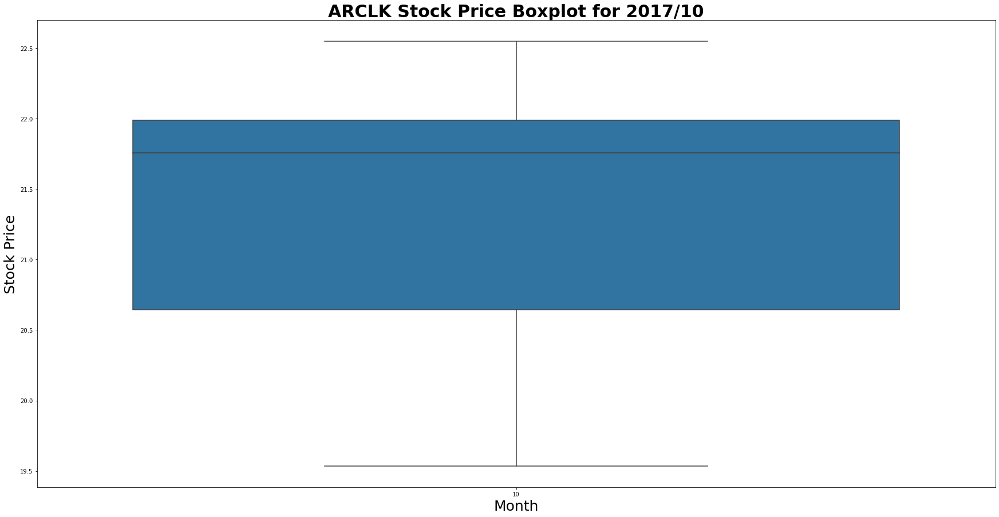

NO OUTLIERS


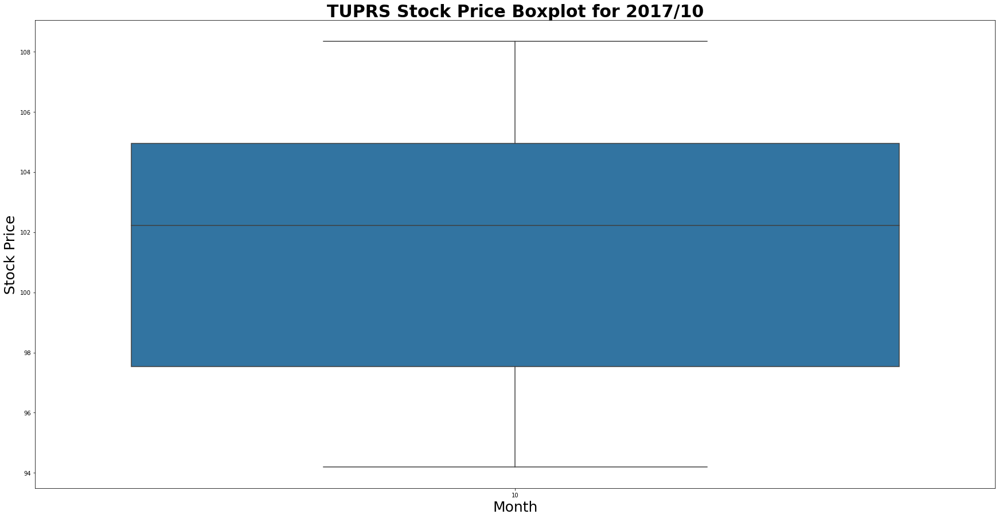

NO OUTLIERS


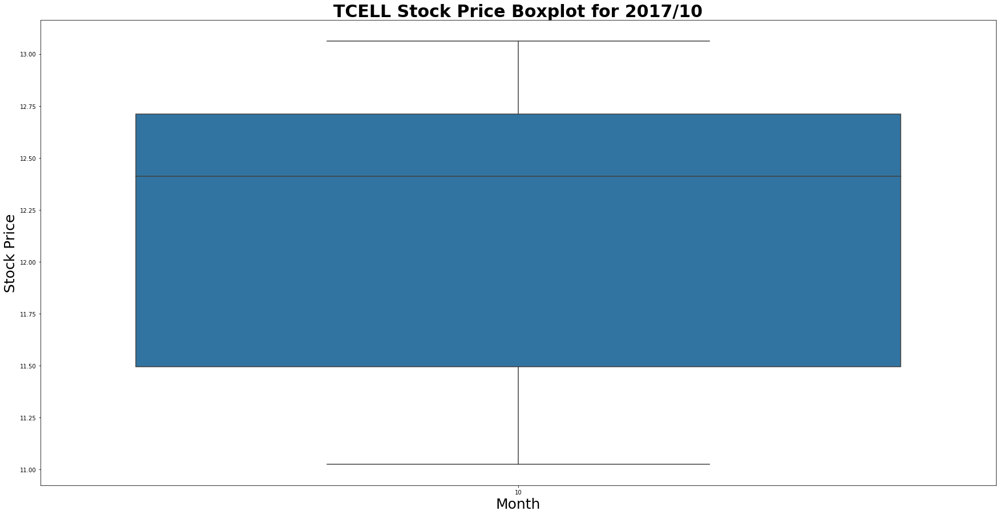

NO OUTLIERS


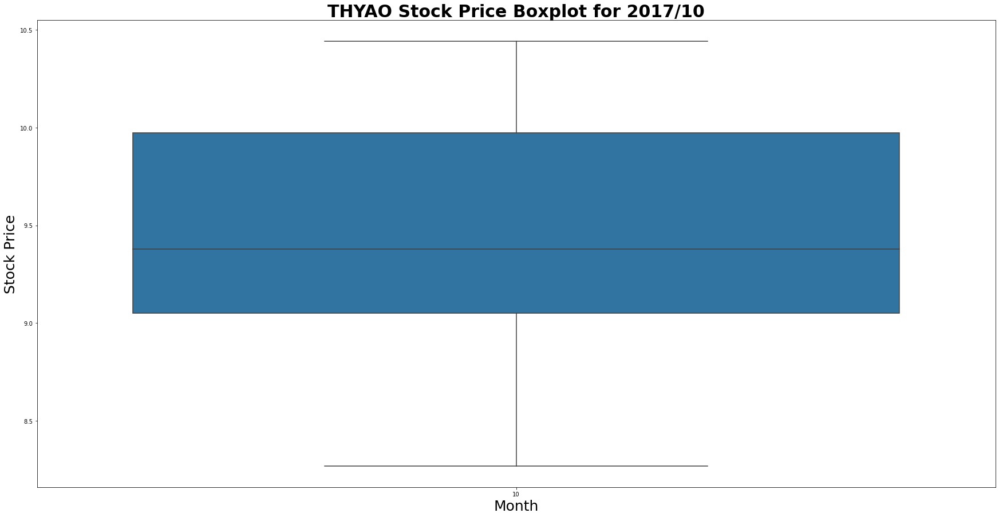

NO OUTLIERS


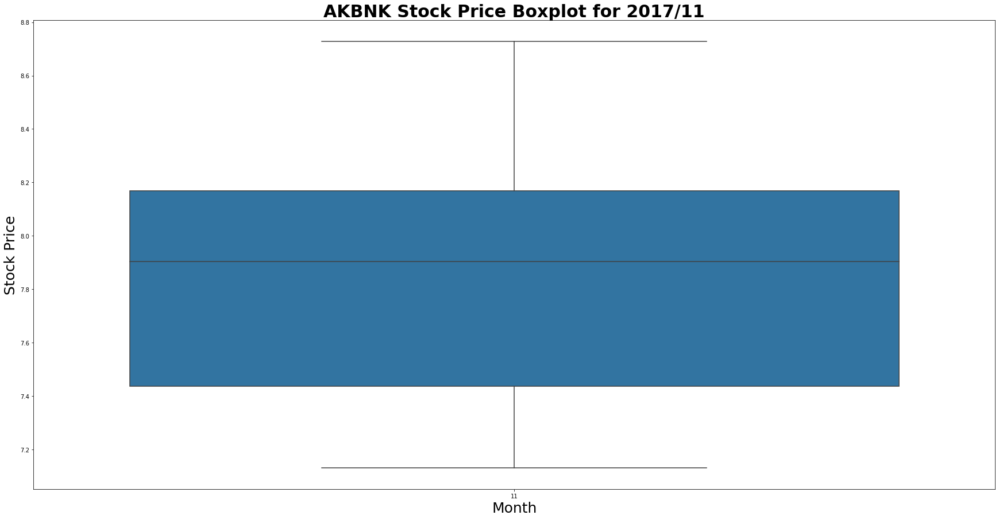

Upper Outliers for VAKBN in 2017/11
Timestamp: 2017-11-01 11:00:00+00:00, Price: 6.5363
Timestamp: 2017-11-01 11:15:00+00:00, Price: 6.5462
Timestamp: 2017-11-01 11:30:00+00:00, Price: 6.5363
Timestamp: 2017-11-02 06:45:00+00:00, Price: 6.5363
Timestamp: 2017-11-02 07:00:00+00:00, Price: 6.5856
Timestamp: 2017-11-02 07:15:00+00:00, Price: 6.5265
Timestamp: 2017-11-02 07:30:00+00:00, Price: 6.5659
Timestamp: 2017-11-02 07:45:00+00:00, Price: 6.6251
Timestamp: 2017-11-02 08:00:00+00:00, Price: 6.5856
Timestamp: 2017-11-02 08:15:00+00:00, Price: 6.5659
Timestamp: 2017-11-02 08:30:00+00:00, Price: 6.5856
Timestamp: 2017-11-02 08:45:00+00:00, Price: 6.5856
Timestamp: 2017-11-02 09:00:00+00:00, Price: 6.5758
Timestamp: 2017-11-02 09:15:00+00:00, Price: 6.5856
Timestamp: 2017-11-02 09:30:00+00:00, Price: 6.5856
Timestamp: 2017-11-02 09:45:00+00:00, Price: 6.5758
Timestamp: 2017-11-02 10:45:00+00:00, Price: 6.5856
Timestamp: 2017-11-02 11:00:00+00:00, Price: 6.5856
Timestamp: 2017-11-02 11:15:

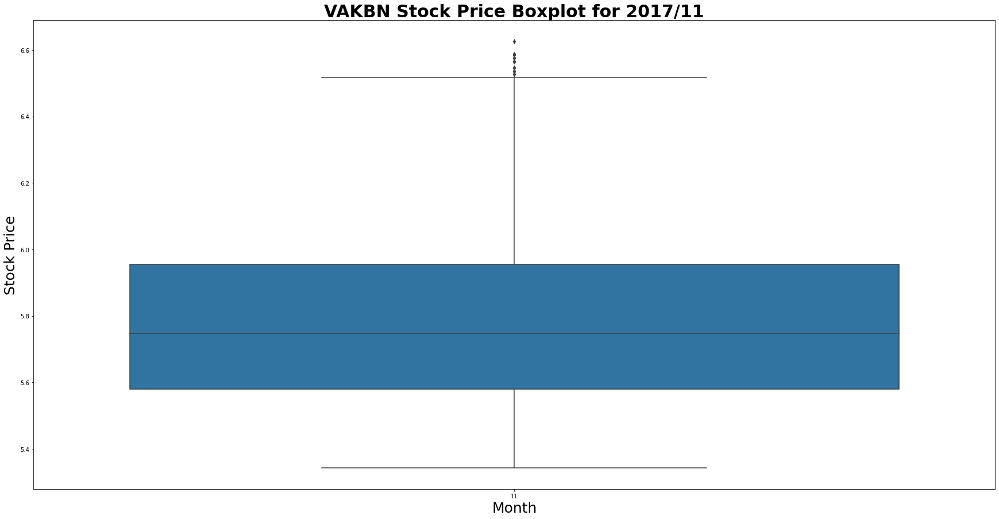

NO OUTLIERS


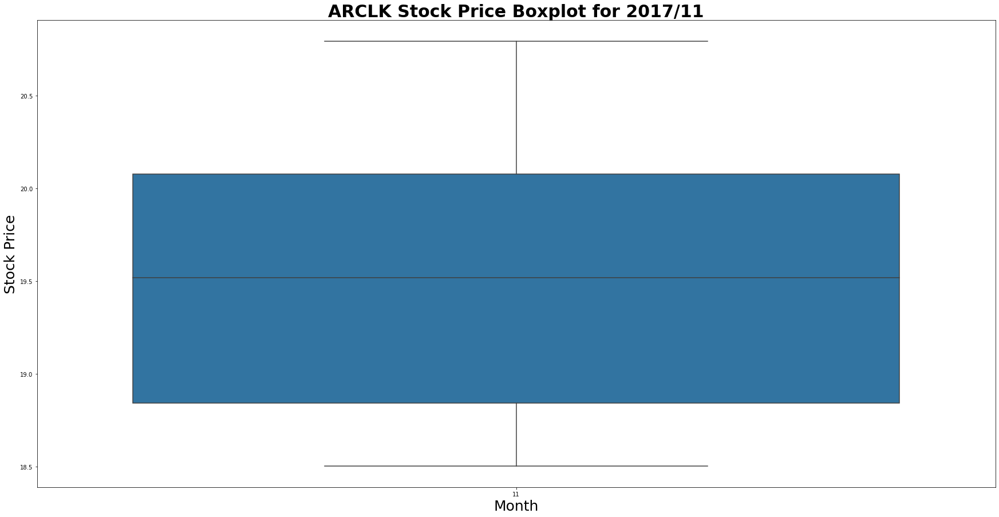

NO OUTLIERS


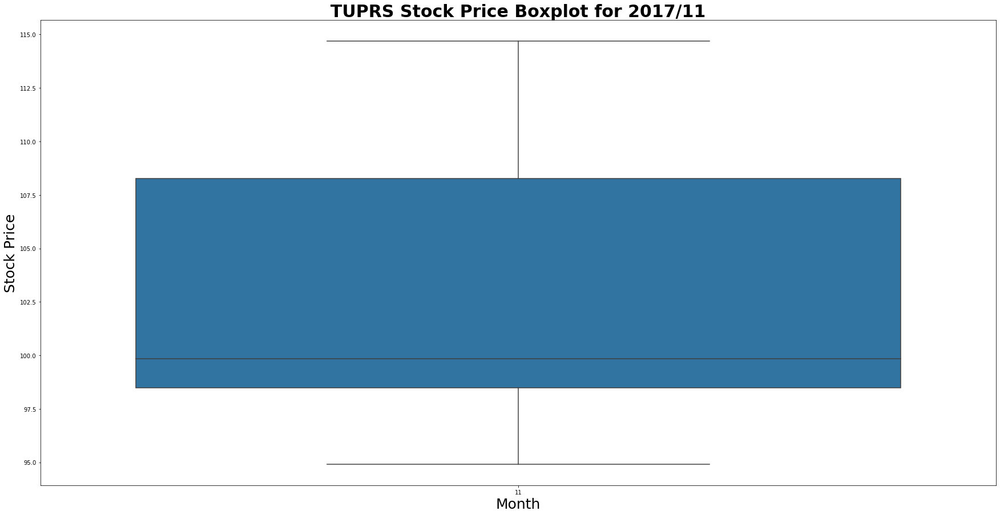

Upper Outliers for TCELL in 2017/11
Timestamp: 2017-11-01 14:00:00+00:00, Price: 13.2952
Timestamp: 2017-11-01 14:30:00+00:00, Price: 13.3043
Timestamp: 2017-11-01 14:45:00+00:00, Price: 13.4123
Timestamp: 2017-11-01 15:00:00+00:00, Price: 13.4303
Timestamp: 2017-11-02 06:45:00+00:00, Price: 13.6104
Timestamp: 2017-11-02 07:00:00+00:00, Price: 13.7186
Timestamp: 2017-11-02 07:15:00+00:00, Price: 13.6014
Timestamp: 2017-11-02 07:30:00+00:00, Price: 13.6014
Timestamp: 2017-11-02 07:45:00+00:00, Price: 13.6374
Timestamp: 2017-11-02 08:00:00+00:00, Price: 13.5563
Timestamp: 2017-11-02 08:15:00+00:00, Price: 13.4753
Timestamp: 2017-11-02 08:30:00+00:00, Price: 13.4663
Timestamp: 2017-11-02 08:45:00+00:00, Price: 13.3311
Timestamp: 2017-11-02 09:00:00+00:00, Price: 13.3492
Timestamp: 2017-11-02 09:30:00+00:00, Price: 13.2861
Timestamp: 2017-11-02 09:45:00+00:00, Price: 13.3582
Timestamp: 2017-11-02 10:45:00+00:00, Price: 13.5384
Timestamp: 2017-11-02 11:00:00+00:00, Price: 13.3311
Timestamp:

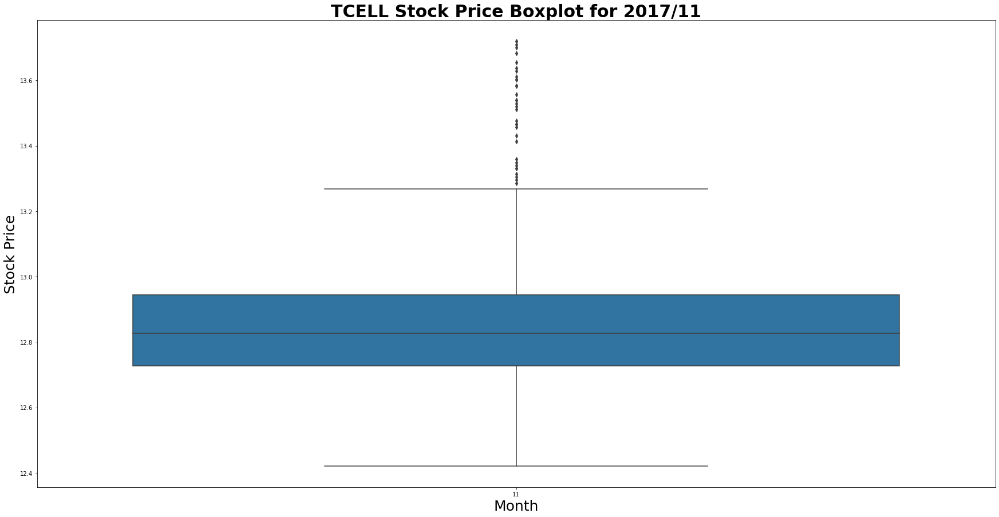

NO OUTLIERS


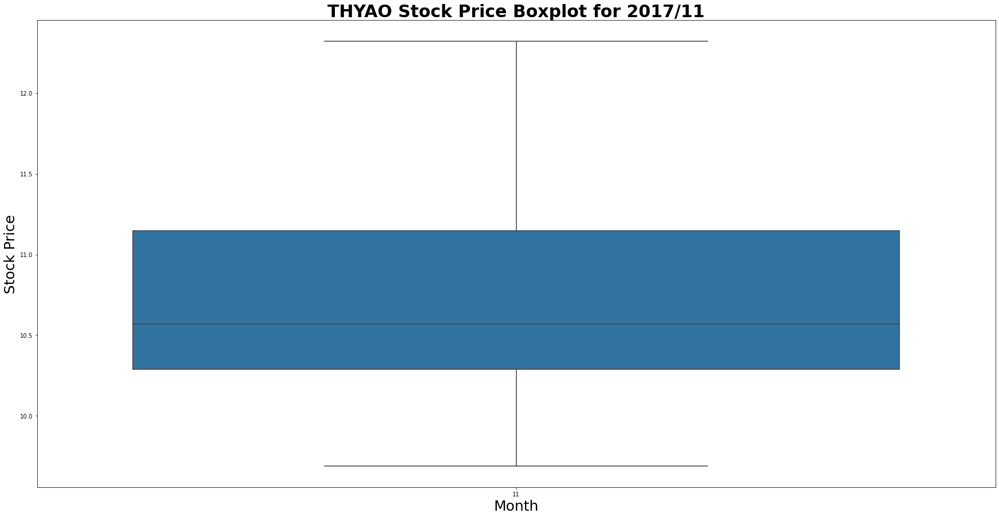

NO OUTLIERS


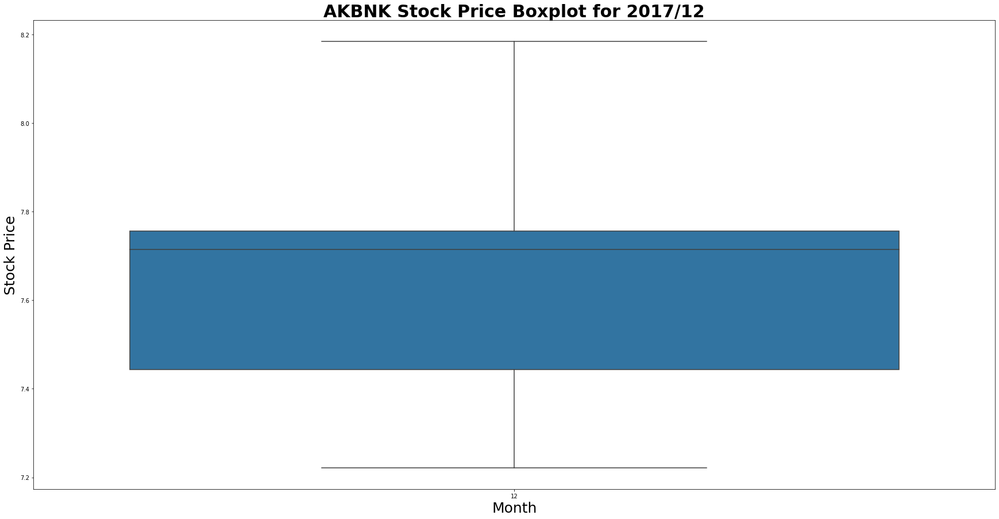

NO OUTLIERS


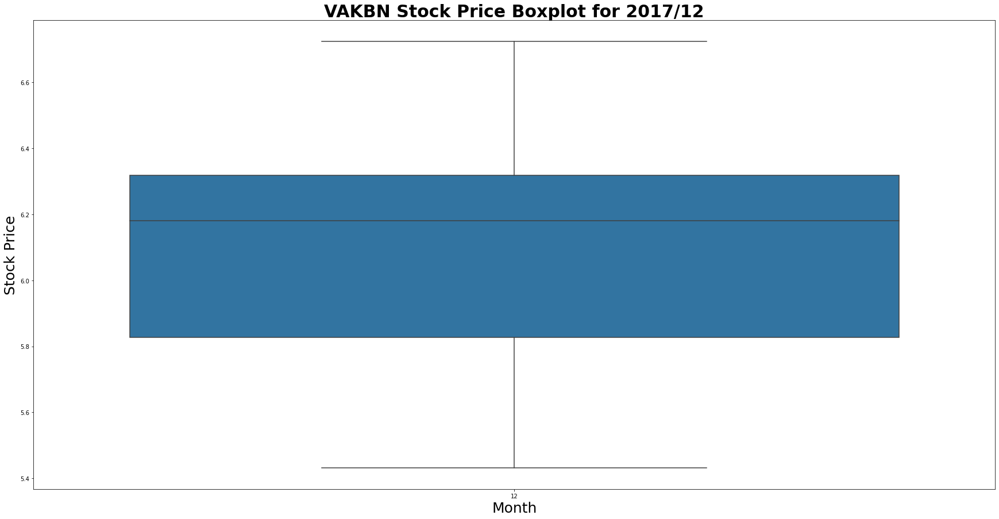

Upper Outliers for ARCLK in 2017/12
Timestamp: 2017-12-28 14:30:00+00:00, Price: 20.289
Timestamp: 2017-12-28 14:45:00+00:00, Price: 20.289
Timestamp: 2017-12-28 15:00:00+00:00, Price: 20.3276
Timestamp: 2017-12-29 06:45:00+00:00, Price: 20.4048
Timestamp: 2017-12-29 07:00:00+00:00, Price: 20.4048
Timestamp: 2017-12-29 07:15:00+00:00, Price: 20.4627
Timestamp: 2017-12-29 07:30:00+00:00, Price: 20.4241
Timestamp: 2017-12-29 07:45:00+00:00, Price: 20.4048
Timestamp: 2017-12-29 08:00:00+00:00, Price: 20.3855
Timestamp: 2017-12-29 08:15:00+00:00, Price: 20.4241
Timestamp: 2017-12-29 08:30:00+00:00, Price: 20.4048
Timestamp: 2017-12-29 08:45:00+00:00, Price: 20.3855
Timestamp: 2017-12-29 09:00:00+00:00, Price: 20.4241
Timestamp: 2017-12-29 09:15:00+00:00, Price: 20.4048
Timestamp: 2017-12-29 09:30:00+00:00, Price: 20.4241
Timestamp: 2017-12-29 09:45:00+00:00, Price: 20.3855
Timestamp: 2017-12-29 10:00:00+00:00, Price: 20.39515
Timestamp: 2017-12-29 10:45:00+00:00, Price: 20.4048
Timestamp: 

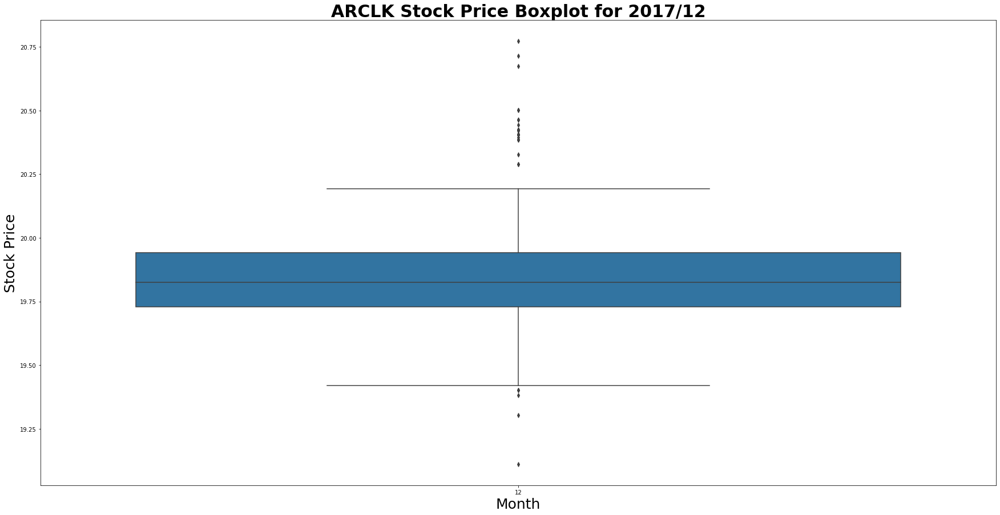

Upper Outliers for TUPRS in 2017/12
Timestamp: 2017-12-21 07:15:00+00:00, Price: 98.5687
Timestamp: 2017-12-21 07:30:00+00:00, Price: 99.1243
Timestamp: 2017-12-21 07:45:00+00:00, Price: 99.3624
Lower Outliers for TUPRS in 2017/12
Timestamp: 2017-12-15 07:00:00+00:00, Price: 90.0769
Timestamp: 2017-12-18 08:30:00+00:00, Price: 90.4737
Timestamp: 2017-12-18 08:45:00+00:00, Price: 90.4737
Timestamp: 2017-12-18 09:00:00+00:00, Price: 90.3943
Timestamp: 2017-12-18 09:15:00+00:00, Price: 90.2356
Timestamp: 2017-12-18 09:30:00+00:00, Price: 90.1562
Timestamp: 2017-12-18 09:45:00+00:00, Price: 90.0769
Timestamp: 2017-12-18 10:00:00+00:00, Price: 90.0769
Timestamp: 2017-12-18 10:45:00+00:00, Price: 90.0769
Timestamp: 2017-12-18 11:00:00+00:00, Price: 89.9975
Timestamp: 2017-12-18 11:15:00+00:00, Price: 89.1245
Timestamp: 2017-12-18 11:30:00+00:00, Price: 89.6007
Timestamp: 2017-12-18 11:45:00+00:00, Price: 89.7594
Timestamp: 2017-12-18 12:00:00+00:00, Price: 90.315
Timestamp: 2017-12-18 12:15:

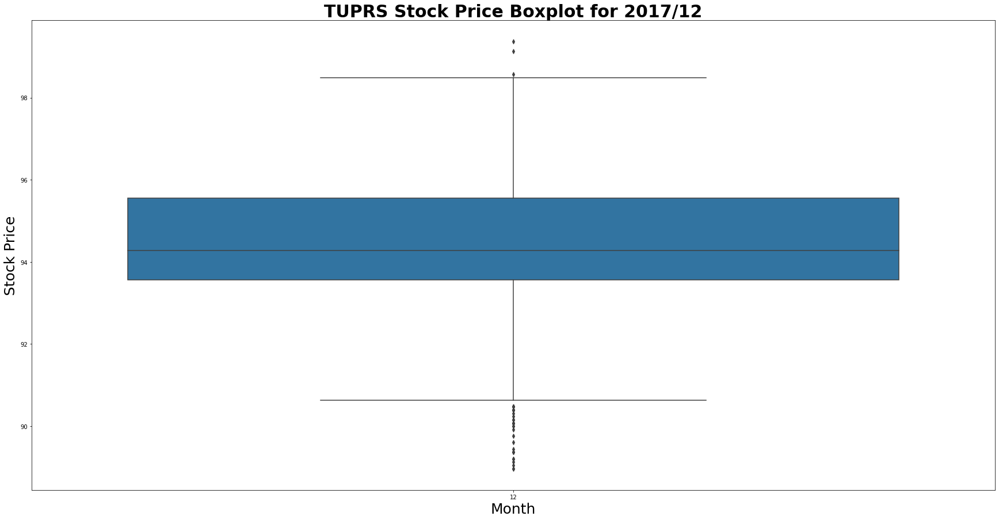

NO OUTLIERS


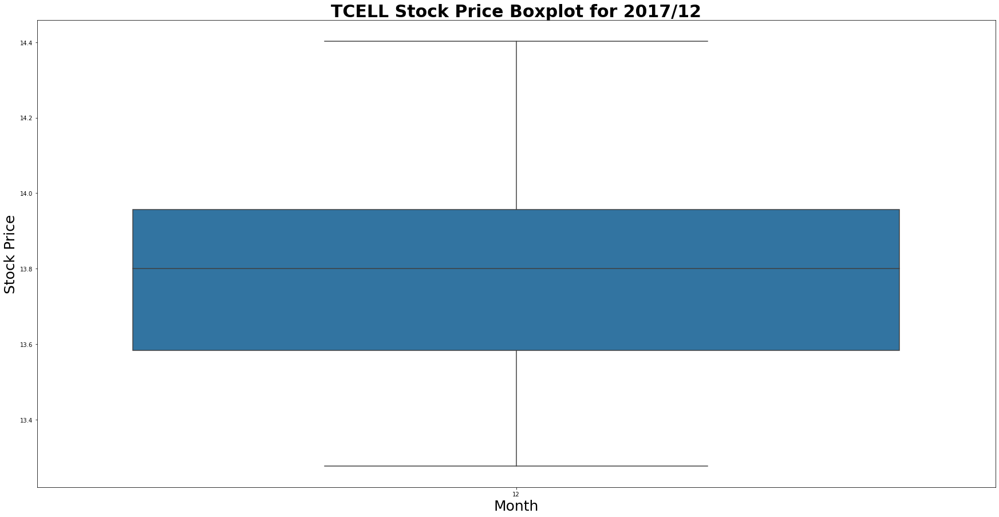

NO OUTLIERS


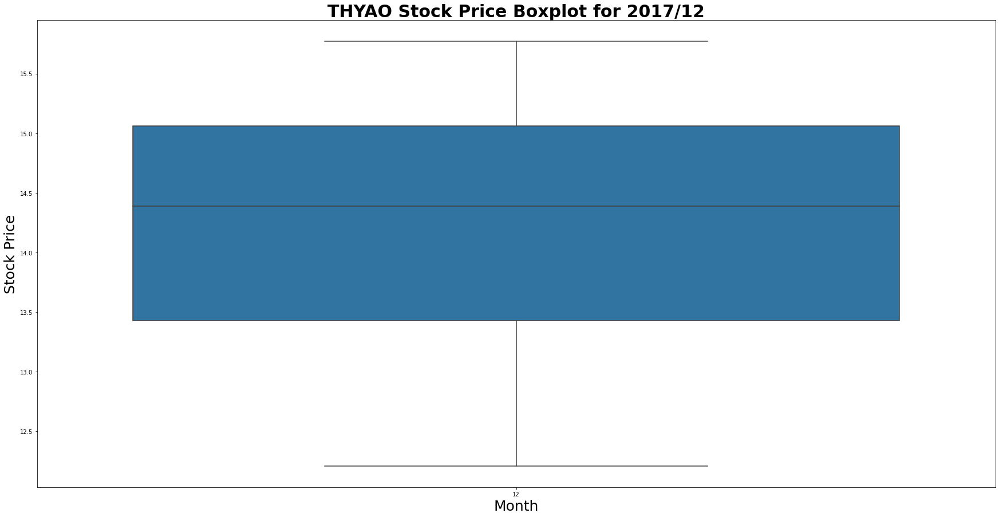

NO OUTLIERS


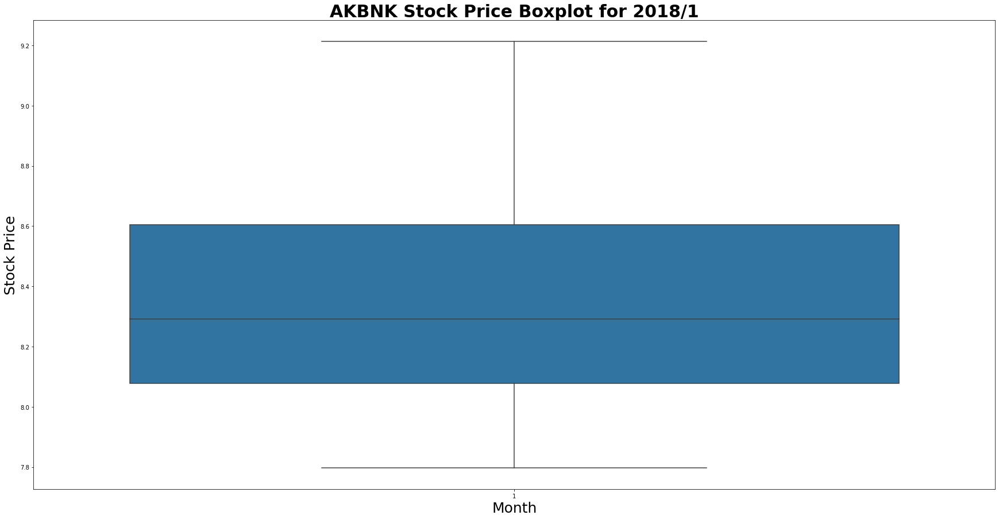

NO OUTLIERS


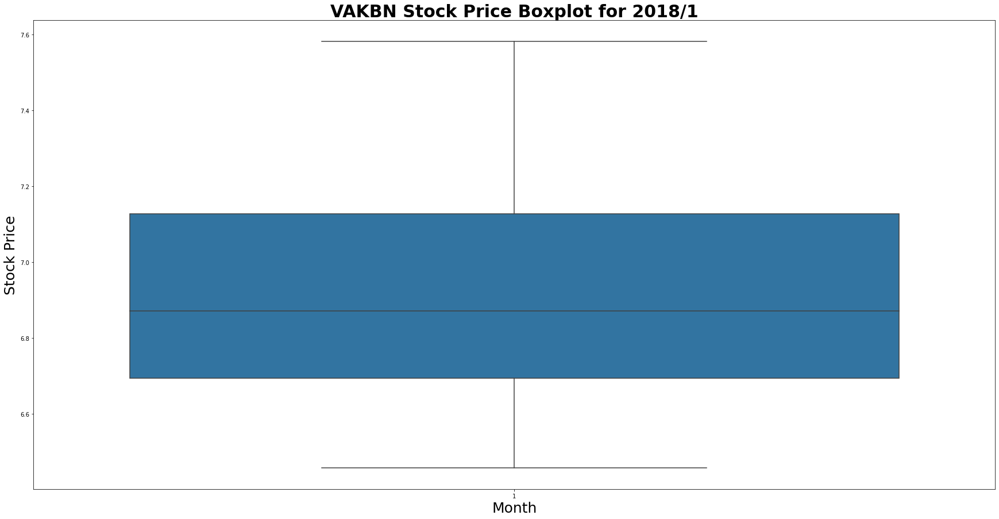

NO OUTLIERS


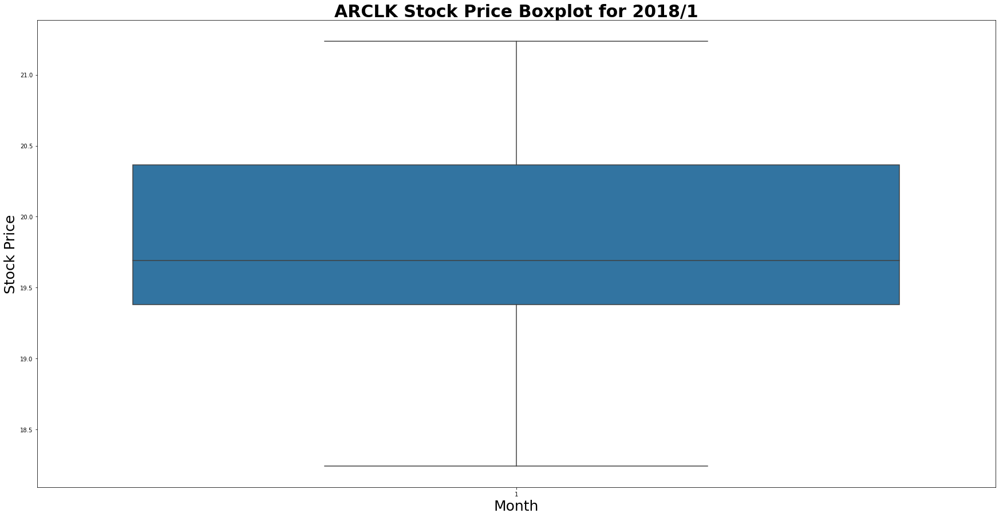

NO OUTLIERS


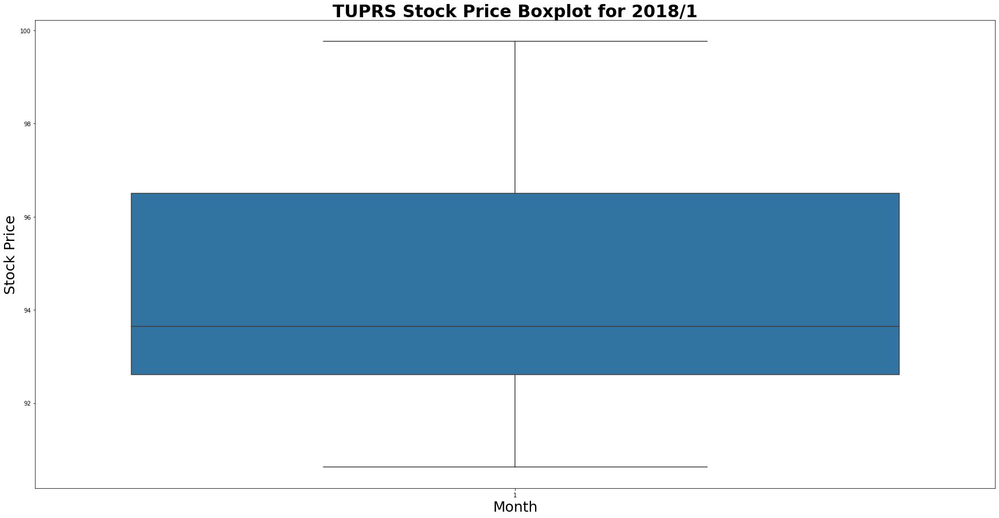

NO OUTLIERS


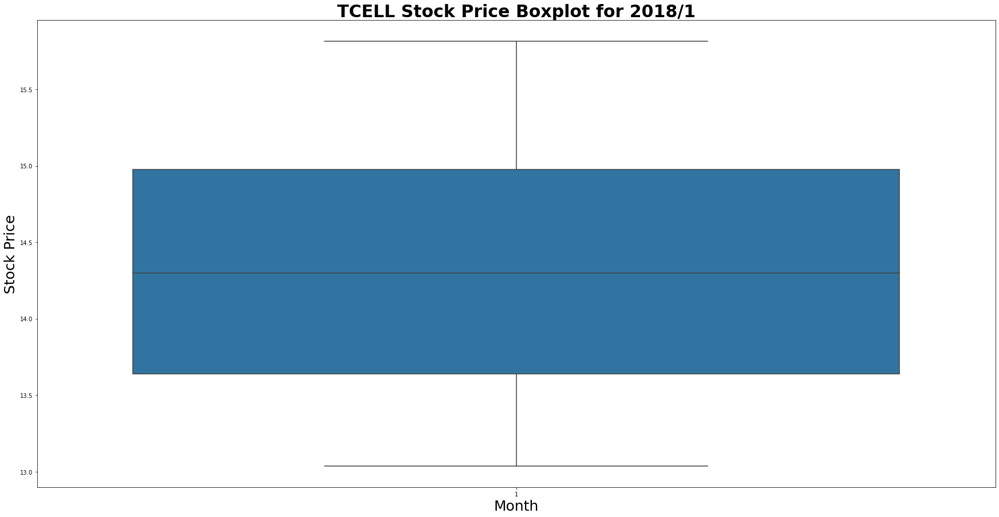

NO OUTLIERS


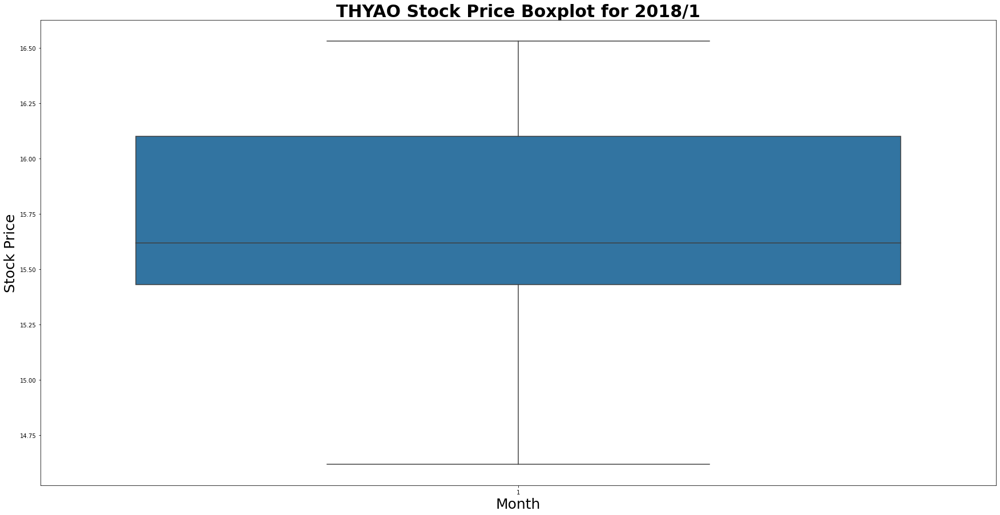

Upper Outliers for AKBNK in 2018/2
Timestamp: 2018-02-01 09:45:00+00:00, Price: 9.0397
Timestamp: 2018-02-01 10:45:00+00:00, Price: 9.0397
Lower Outliers for AKBNK in 2018/2
Timestamp: 2018-02-09 07:15:00+00:00, Price: 8.2665
Timestamp: 2018-02-09 07:45:00+00:00, Price: 8.2583
Timestamp: 2018-02-09 12:30:00+00:00, Price: 8.2665
Timestamp: 2018-02-09 12:45:00+00:00, Price: 8.2336
Timestamp: 2018-02-09 13:00:00+00:00, Price: 8.2665


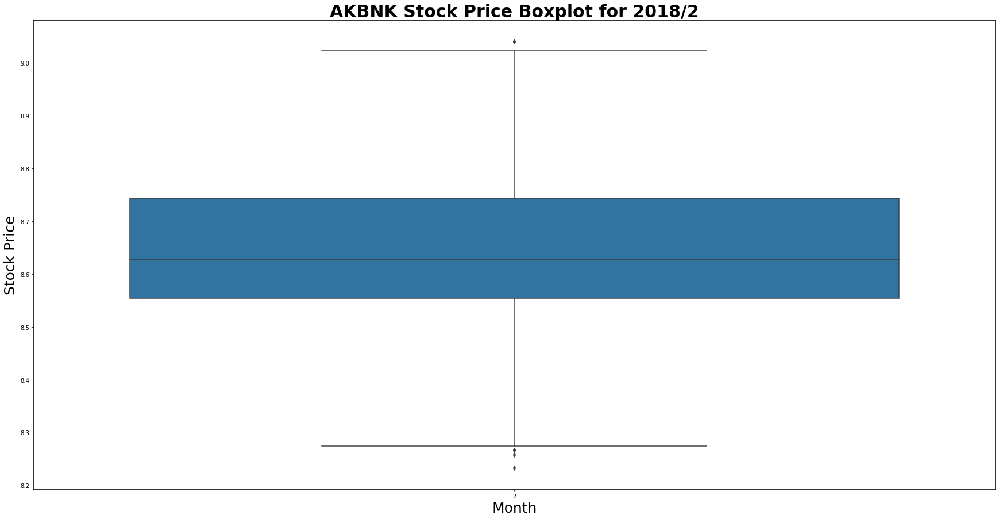

Upper Outliers for VAKBN in 2018/2
Timestamp: 2018-02-01 07:30:00+00:00, Price: 7.5222
Timestamp: 2018-02-01 07:45:00+00:00, Price: 7.5321
Timestamp: 2018-02-01 08:00:00+00:00, Price: 7.5025
Timestamp: 2018-02-01 08:15:00+00:00, Price: 7.4828
Timestamp: 2018-02-01 08:30:00+00:00, Price: 7.5123
Timestamp: 2018-02-01 08:45:00+00:00, Price: 7.4828
Timestamp: 2018-02-01 09:00:00+00:00, Price: 7.4828
Timestamp: 2018-02-01 09:15:00+00:00, Price: 7.4828


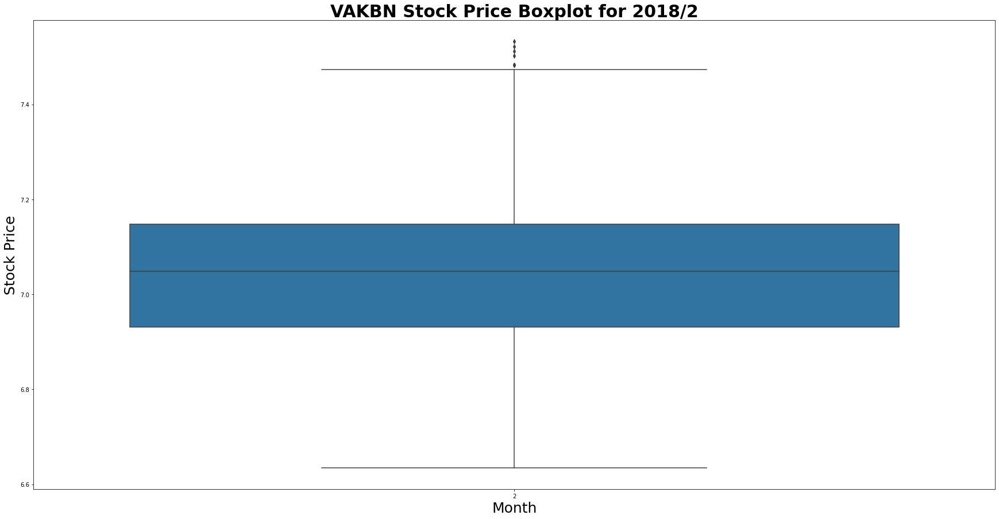

Upper Outliers for ARCLK in 2018/2
Timestamp: 2018-02-01 12:45:00+00:00, Price: 18.8508
Timestamp: 2018-02-01 13:00:00+00:00, Price: 18.8412
Timestamp: 2018-02-01 13:15:00+00:00, Price: 18.8412
Timestamp: 2018-02-05 08:30:00+00:00, Price: 18.9377
Timestamp: 2018-02-05 08:45:00+00:00, Price: 18.957
Timestamp: 2018-02-05 09:00:00+00:00, Price: 18.9859
Timestamp: 2018-02-05 09:15:00+00:00, Price: 18.9859
Timestamp: 2018-02-05 09:30:00+00:00, Price: 18.9377
Timestamp: 2018-02-05 09:45:00+00:00, Price: 18.8508
Timestamp: 2018-02-05 10:45:00+00:00, Price: 18.8508
Timestamp: 2018-02-05 11:00:00+00:00, Price: 18.8218
Timestamp: 2018-02-05 11:15:00+00:00, Price: 18.8508
Timestamp: 2018-02-05 11:30:00+00:00, Price: 18.8991
Timestamp: 2018-02-05 11:45:00+00:00, Price: 18.9184
Timestamp: 2018-02-05 12:00:00+00:00, Price: 18.8508
Timestamp: 2018-02-05 12:15:00+00:00, Price: 18.8412


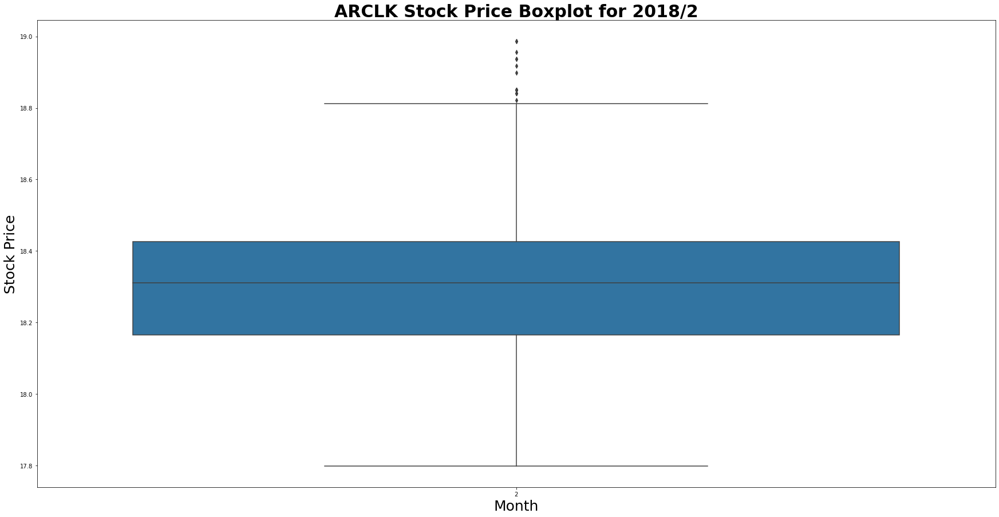

Lower Outliers for TUPRS in 2018/2
Timestamp: 2018-02-06 06:45:00+00:00, Price: 84.9183


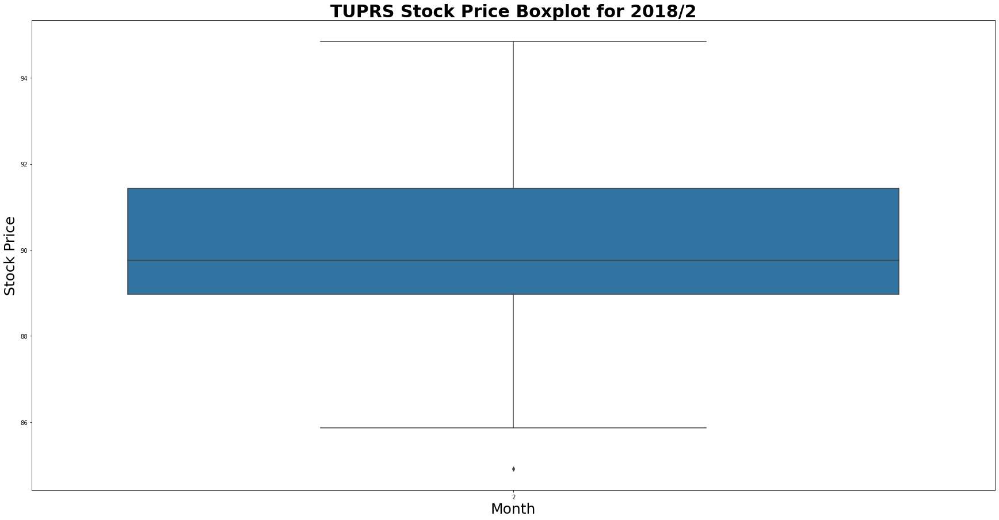

Upper Outliers for TCELL in 2018/2
Timestamp: 2018-02-01 07:00:00+00:00, Price: 14.6434
Timestamp: 2018-02-01 07:15:00+00:00, Price: 14.6434
Timestamp: 2018-02-01 08:30:00+00:00, Price: 14.6248
Timestamp: 2018-02-01 09:45:00+00:00, Price: 14.6248
Timestamp: 2018-02-01 10:45:00+00:00, Price: 14.634
Lower Outliers for TCELL in 2018/2
Timestamp: 2018-02-20 14:45:00+00:00, Price: 13.5483
Timestamp: 2018-02-20 15:00:00+00:00, Price: 13.5576
Timestamp: 2018-02-21 13:45:00+00:00, Price: 13.7153


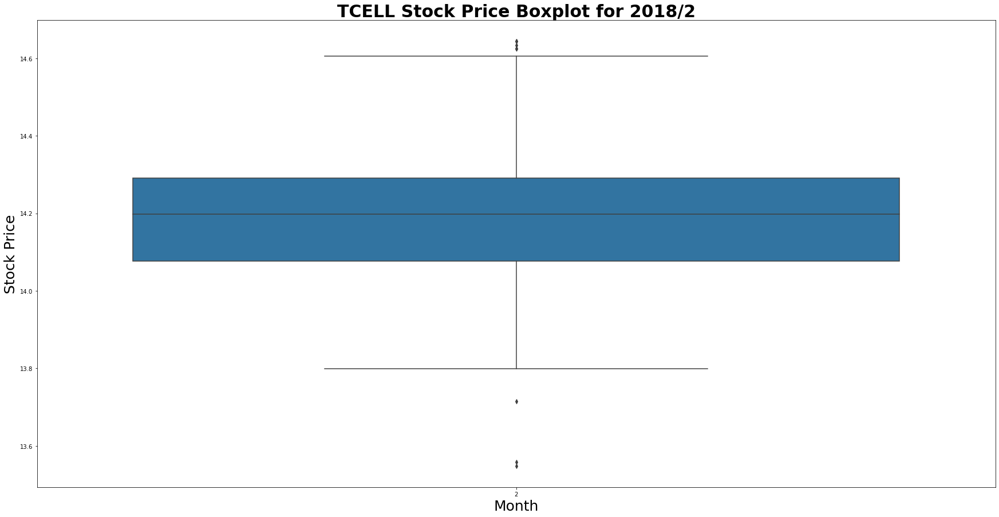

Upper Outliers for THYAO in 2018/2
Timestamp: 2018-02-26 14:45:00+00:00, Price: 18.89
Timestamp: 2018-02-26 15:00:00+00:00, Price: 18.92
Timestamp: 2018-02-27 06:45:00+00:00, Price: 18.92
Timestamp: 2018-02-27 09:45:00+00:00, Price: 18.85
Timestamp: 2018-02-27 10:45:00+00:00, Price: 18.84
Timestamp: 2018-02-27 11:00:00+00:00, Price: 18.83
Timestamp: 2018-02-28 09:00:00+00:00, Price: 18.85
Timestamp: 2018-02-28 09:15:00+00:00, Price: 18.84
Timestamp: 2018-02-28 09:30:00+00:00, Price: 18.84
Timestamp: 2018-02-28 09:45:00+00:00, Price: 18.86
Timestamp: 2018-02-28 10:00:00+00:00, Price: 18.855
Timestamp: 2018-02-28 10:45:00+00:00, Price: 18.85
Timestamp: 2018-02-28 11:00:00+00:00, Price: 18.85
Timestamp: 2018-02-28 11:15:00+00:00, Price: 18.83
Timestamp: 2018-02-28 12:15:00+00:00, Price: 18.91
Timestamp: 2018-02-28 12:30:00+00:00, Price: 18.9
Timestamp: 2018-02-28 12:45:00+00:00, Price: 18.91
Timestamp: 2018-02-28 13:00:00+00:00, Price: 18.92
Timestamp: 2018-02-28 13:15:00+00:00, Price: 18

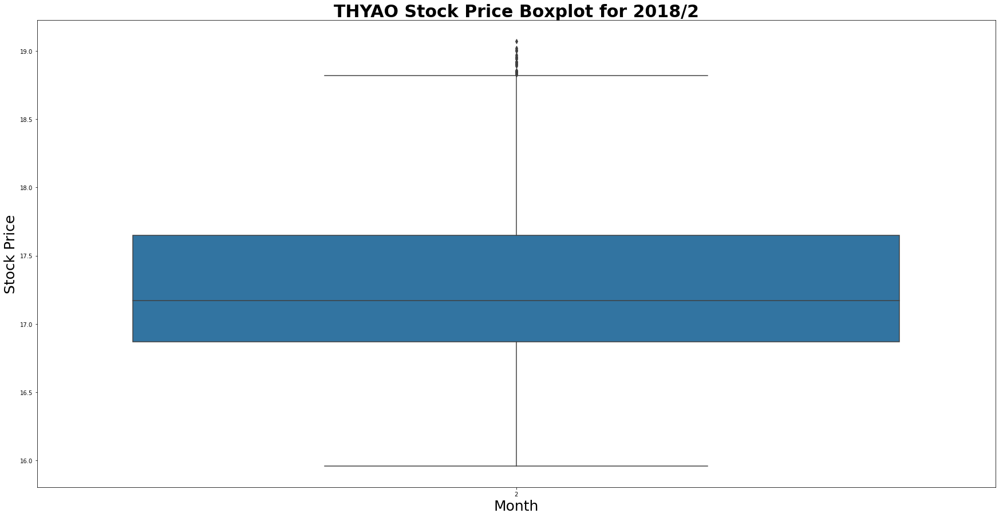

NO OUTLIERS


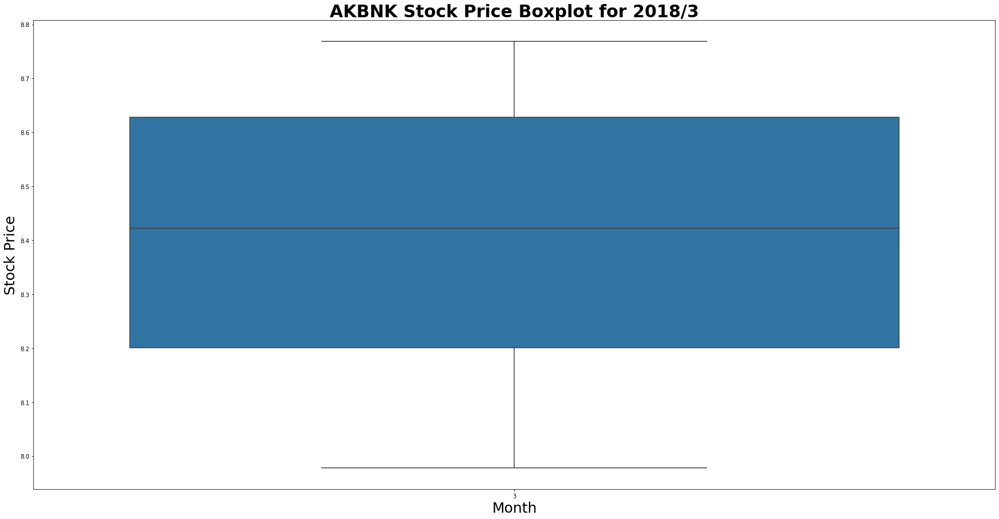

NO OUTLIERS


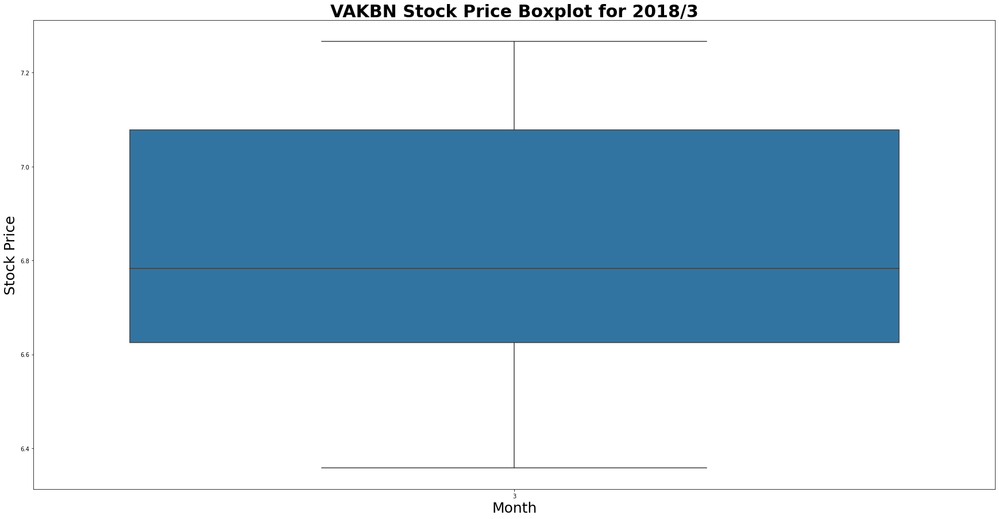

NO OUTLIERS


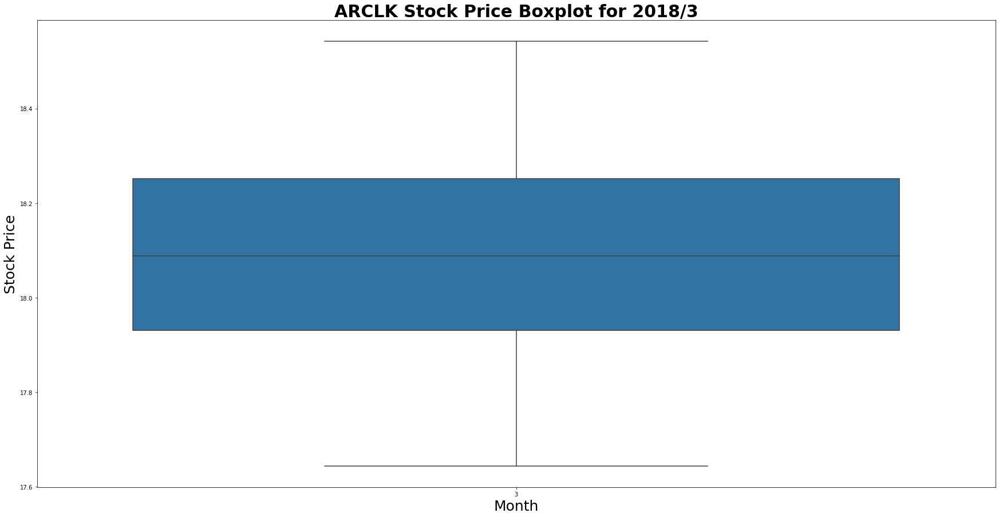

NO OUTLIERS


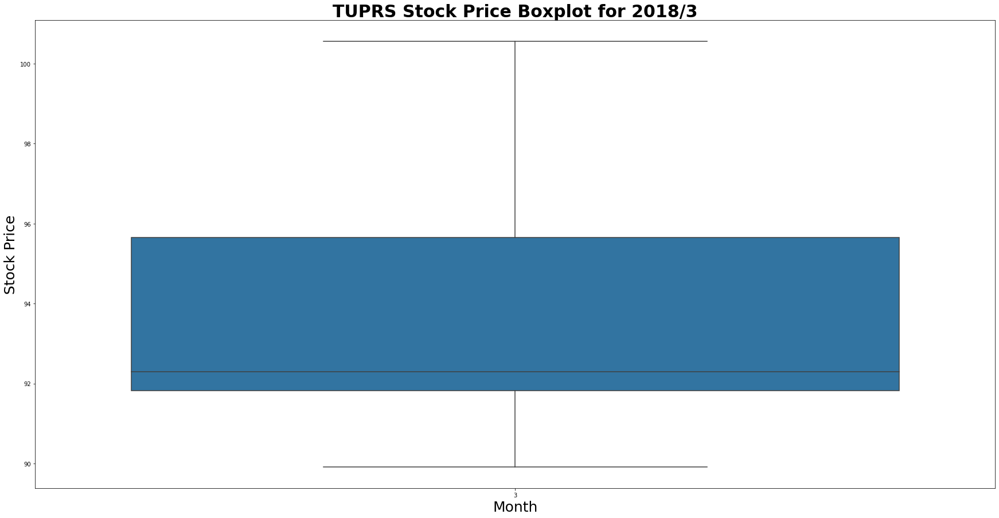

NO OUTLIERS


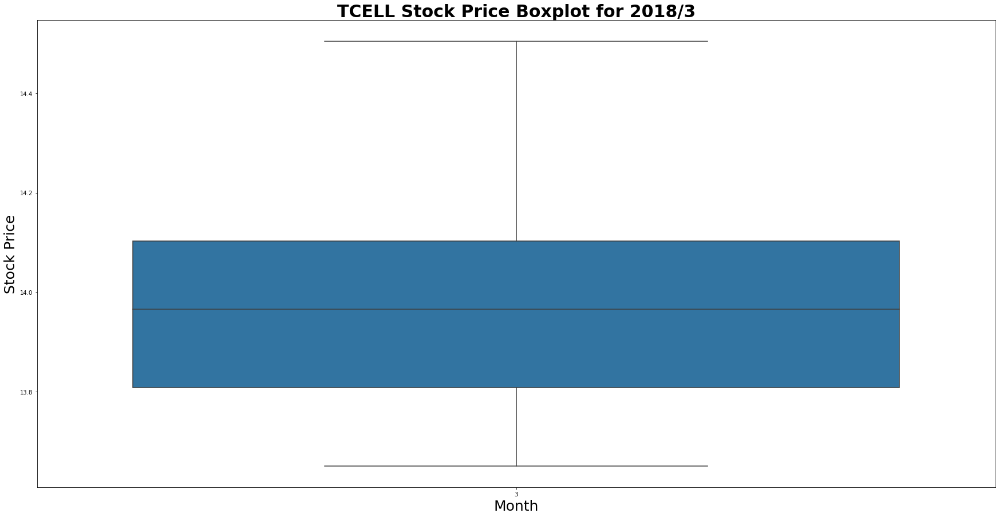

NO OUTLIERS


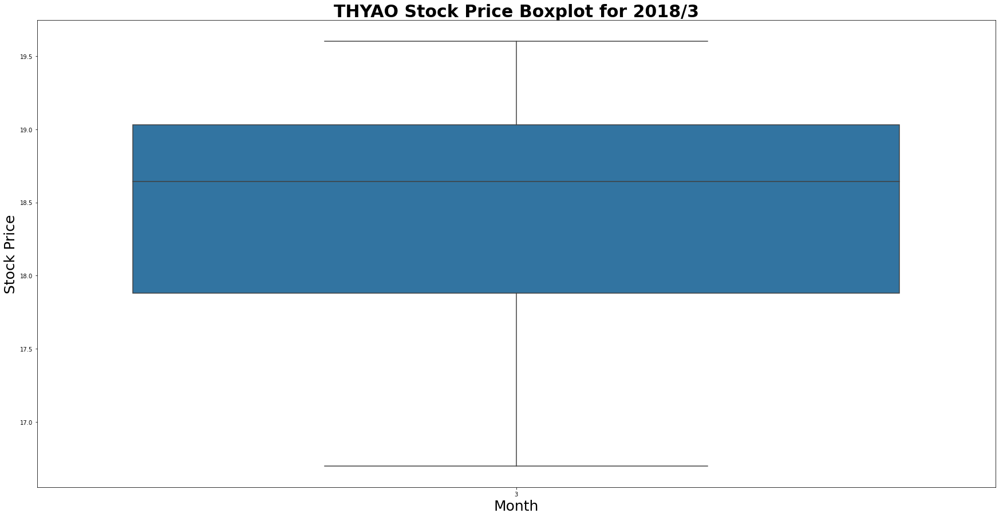

NO OUTLIERS


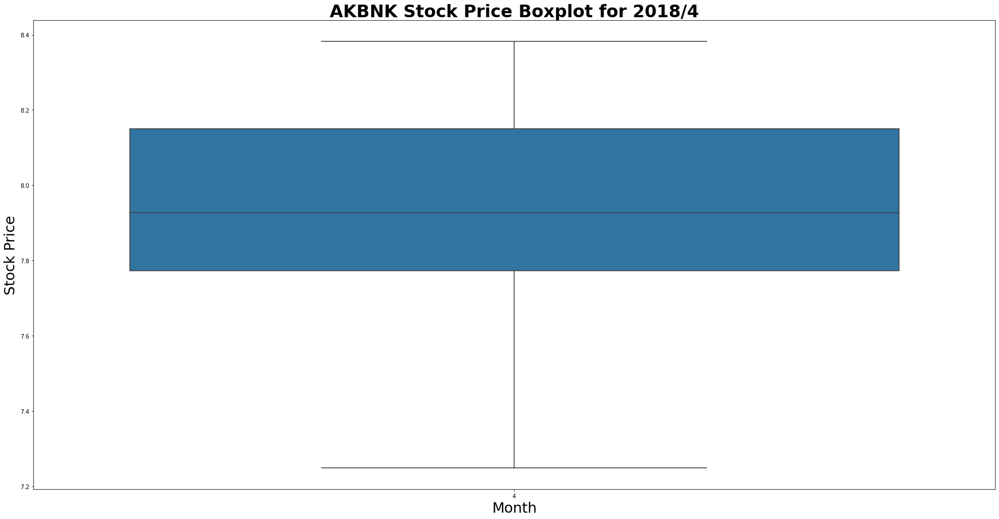

NO OUTLIERS


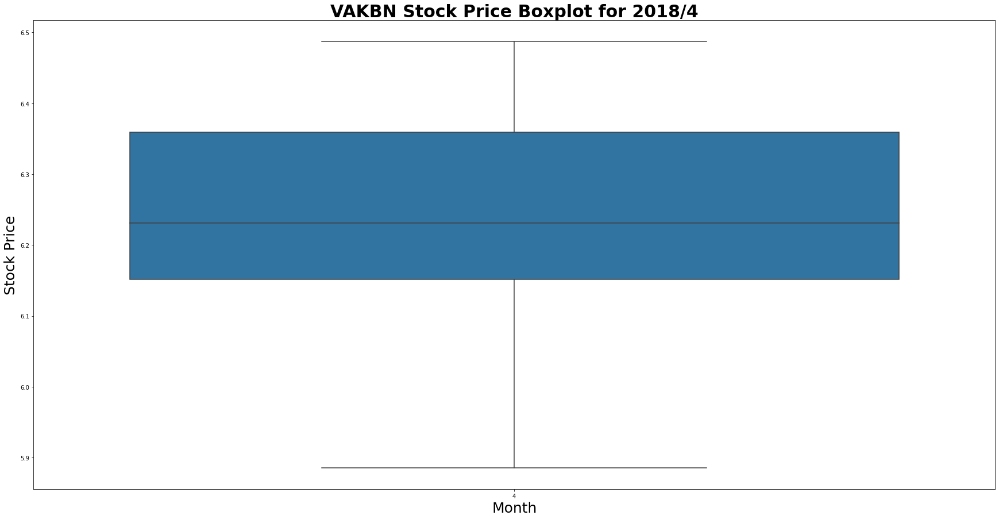

NO OUTLIERS


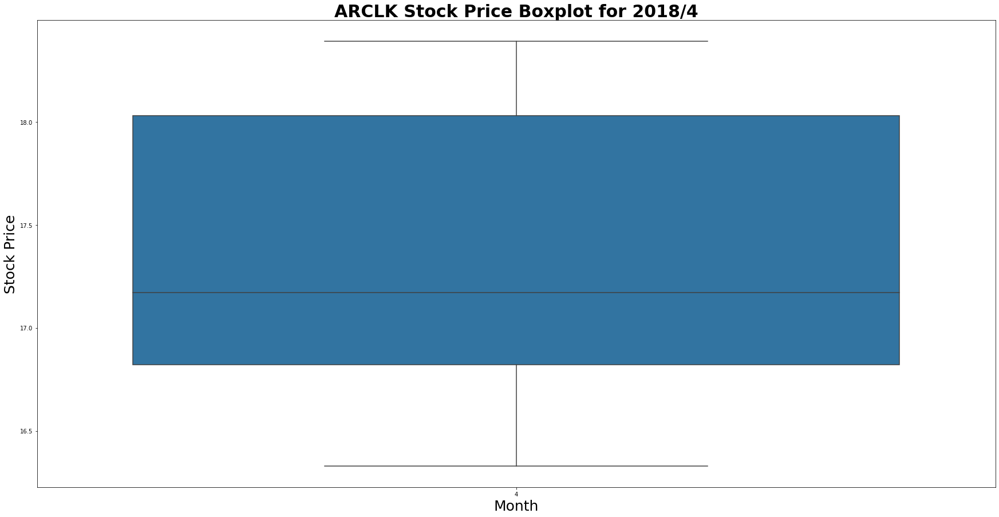

NO OUTLIERS


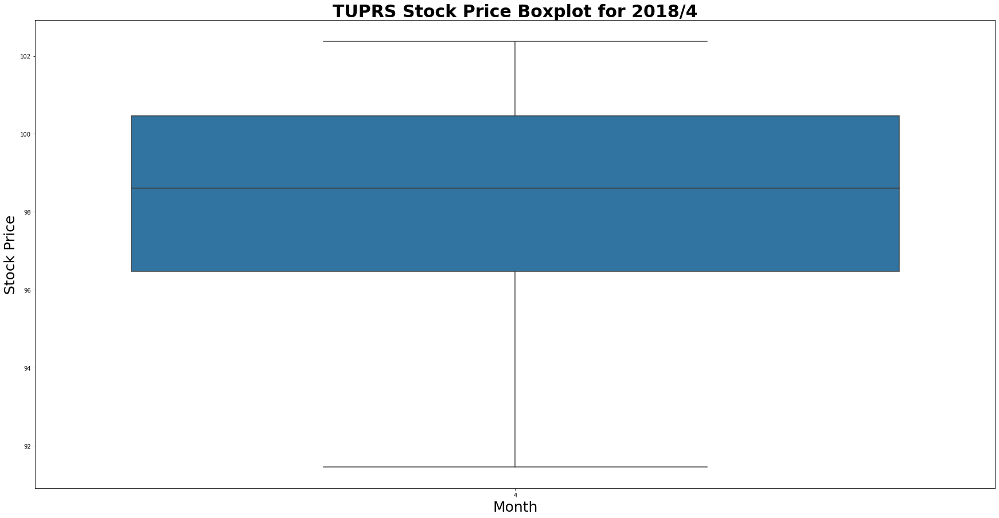

NO OUTLIERS


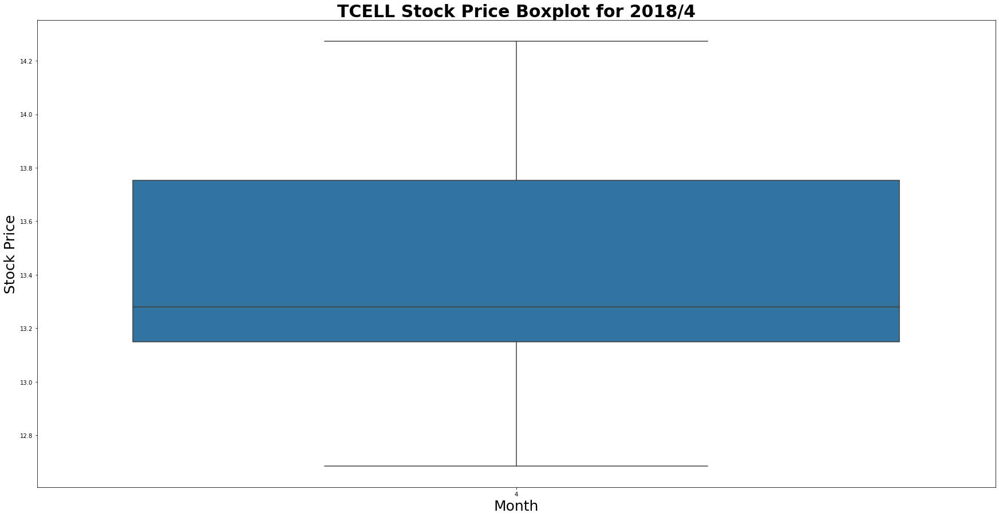

NO OUTLIERS


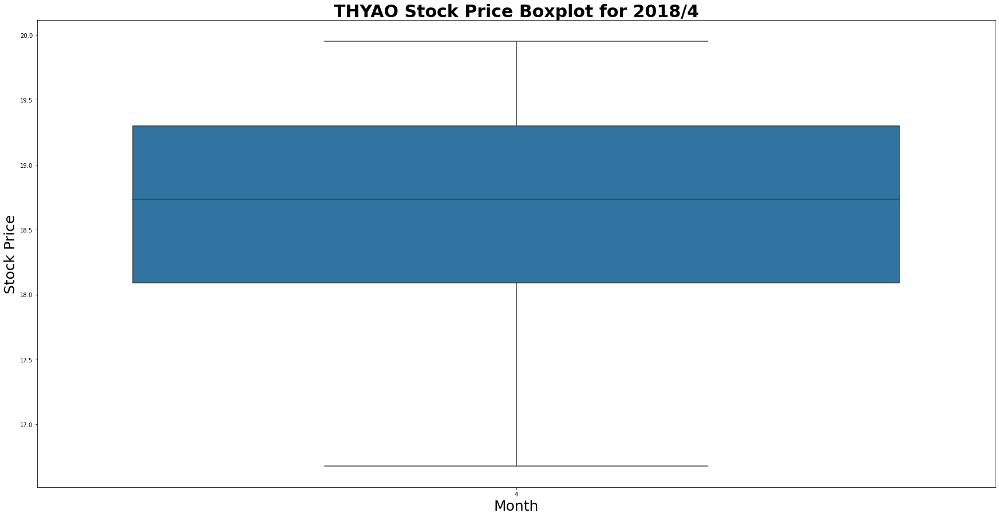

NO OUTLIERS


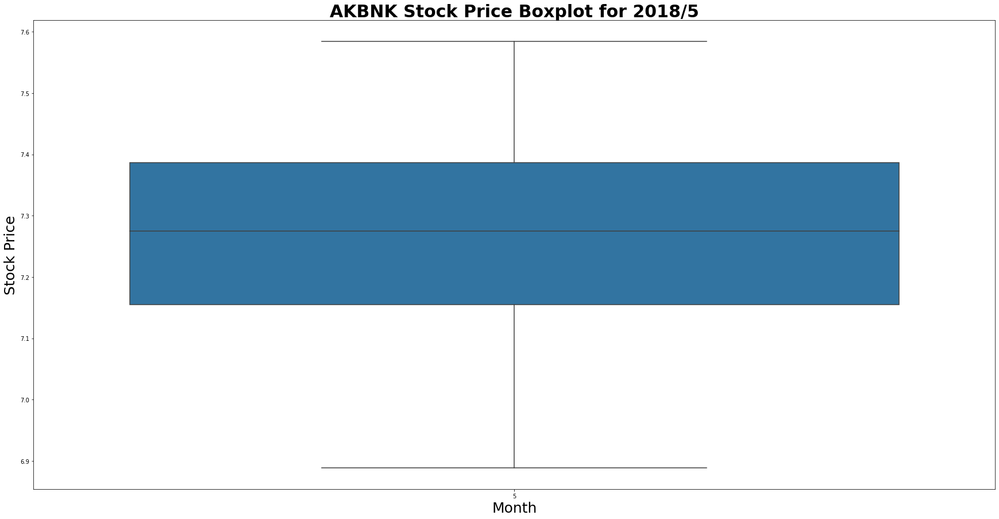

NO OUTLIERS


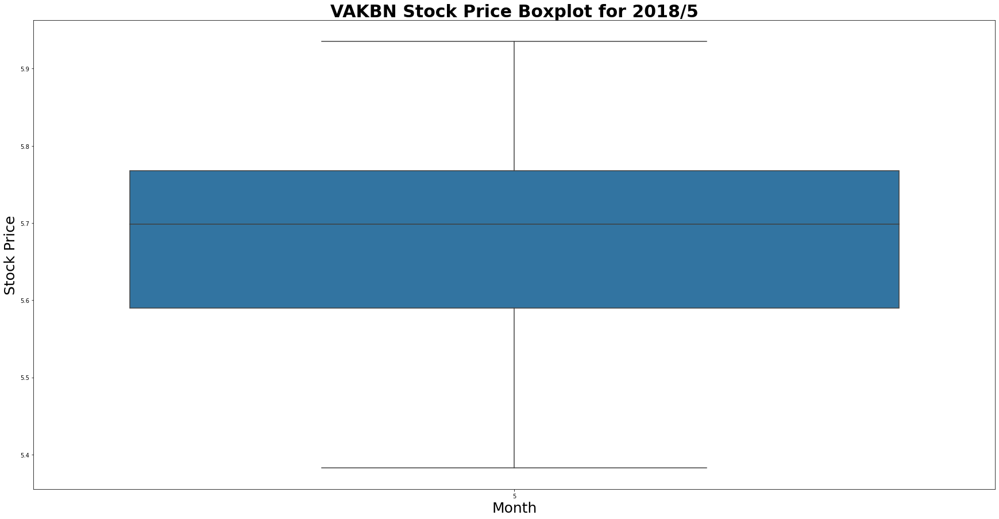

Upper Outliers for ARCLK in 2018/5
Timestamp: 2018-05-02 06:45:00+00:00, Price: 18.08
Timestamp: 2018-05-02 07:00:00+00:00, Price: 18.35
Timestamp: 2018-05-02 07:15:00+00:00, Price: 18.67
Timestamp: 2018-05-02 07:30:00+00:00, Price: 18.7
Timestamp: 2018-05-02 07:45:00+00:00, Price: 18.57
Timestamp: 2018-05-02 08:00:00+00:00, Price: 18.65
Timestamp: 2018-05-02 08:15:00+00:00, Price: 18.57
Timestamp: 2018-05-02 08:30:00+00:00, Price: 18.38
Timestamp: 2018-05-02 08:45:00+00:00, Price: 18.49
Timestamp: 2018-05-02 09:00:00+00:00, Price: 18.27
Timestamp: 2018-05-02 09:15:00+00:00, Price: 18.35
Timestamp: 2018-05-02 09:30:00+00:00, Price: 18.33
Timestamp: 2018-05-02 09:45:00+00:00, Price: 18.33
Timestamp: 2018-05-02 10:00:00+00:00, Price: 18.29
Timestamp: 2018-05-02 10:45:00+00:00, Price: 18.25
Timestamp: 2018-05-02 11:00:00+00:00, Price: 18.12
Timestamp: 2018-05-02 11:15:00+00:00, Price: 18.22
Timestamp: 2018-05-02 11:30:00+00:00, Price: 18.45
Timestamp: 2018-05-02 11:45:00+00:00, Price: 18.

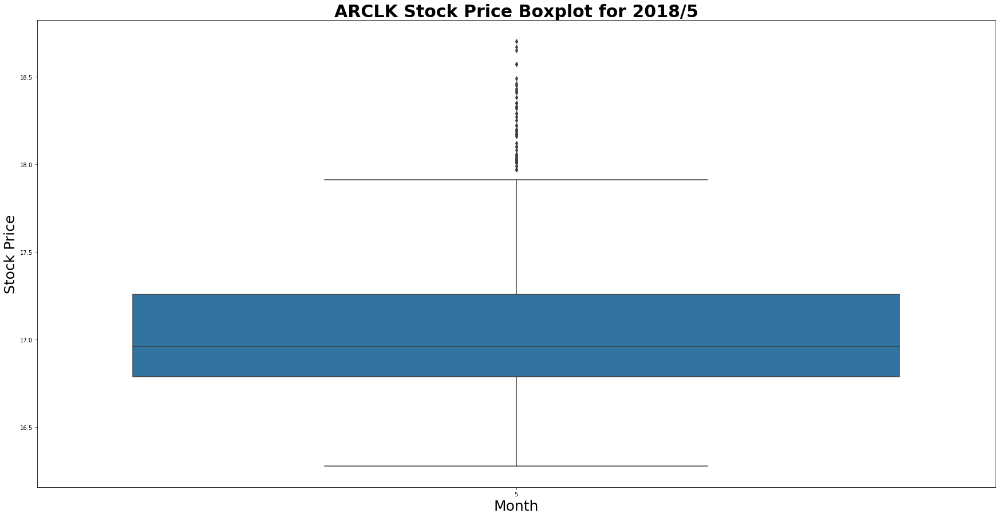

Upper Outliers for TUPRS in 2018/5
Timestamp: 2018-05-29 15:00:00+00:00, Price: 96.5579
Lower Outliers for TUPRS in 2018/5
Timestamp: 2018-05-10 06:45:00+00:00, Price: 84.0411
Timestamp: 2018-05-10 07:00:00+00:00, Price: 84.354
Timestamp: 2018-05-10 07:15:00+00:00, Price: 85.0246
Timestamp: 2018-05-10 07:30:00+00:00, Price: 84.4435
Timestamp: 2018-05-10 07:45:00+00:00, Price: 83.5047
Timestamp: 2018-05-10 08:00:00+00:00, Price: 83.5047
Timestamp: 2018-05-10 08:15:00+00:00, Price: 83.9964
Timestamp: 2018-05-10 08:30:00+00:00, Price: 84.0858
Timestamp: 2018-05-10 08:45:00+00:00, Price: 83.8623
Timestamp: 2018-05-10 09:00:00+00:00, Price: 83.9517
Timestamp: 2018-05-10 09:15:00+00:00, Price: 84.0411
Timestamp: 2018-05-10 09:30:00+00:00, Price: 84.354
Timestamp: 2018-05-10 09:45:00+00:00, Price: 84.354
Timestamp: 2018-05-10 10:45:00+00:00, Price: 84.5776


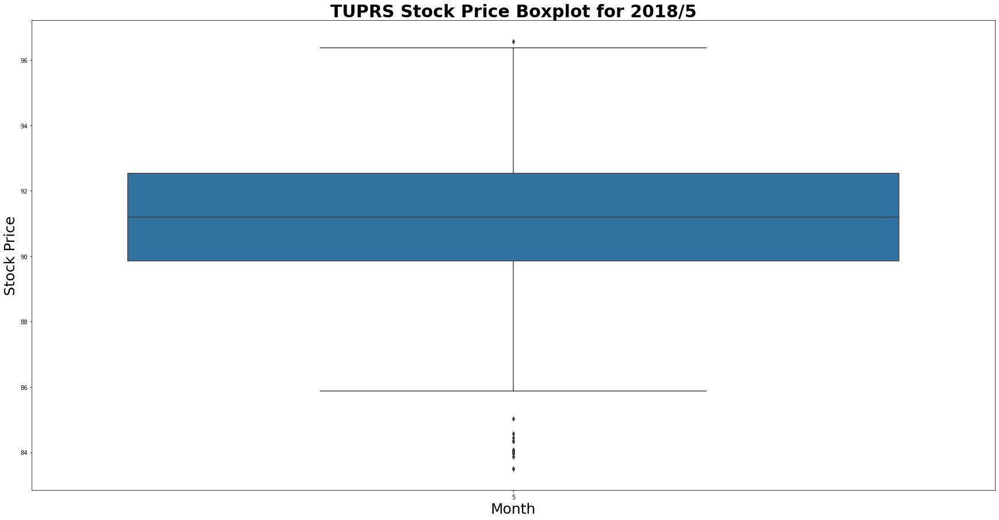

Upper Outliers for TCELL in 2018/5
Timestamp: 2018-05-02 06:45:00+00:00, Price: 12.9823
Timestamp: 2018-05-02 07:00:00+00:00, Price: 12.8987
Timestamp: 2018-05-02 07:15:00+00:00, Price: 12.9173
Timestamp: 2018-05-02 07:30:00+00:00, Price: 12.8338
Timestamp: 2018-05-02 07:45:00+00:00, Price: 12.8152
Timestamp: 2018-05-02 08:00:00+00:00, Price: 12.8616
Timestamp: 2018-05-02 08:15:00+00:00, Price: 12.908
Timestamp: 2018-05-02 08:30:00+00:00, Price: 12.8431
Timestamp: 2018-05-02 08:45:00+00:00, Price: 12.8245
Timestamp: 2018-05-02 09:00:00+00:00, Price: 12.8524
Timestamp: 2018-05-02 09:15:00+00:00, Price: 12.8524
Timestamp: 2018-05-02 09:30:00+00:00, Price: 12.8802
Timestamp: 2018-05-02 09:45:00+00:00, Price: 12.8709
Timestamp: 2018-05-02 10:00:00+00:00, Price: 12.843050000000002
Timestamp: 2018-05-02 10:45:00+00:00, Price: 12.8152
Timestamp: 2018-05-02 11:00:00+00:00, Price: 12.7874
Timestamp: 2018-05-02 11:15:00+00:00, Price: 12.806
Timestamp: 2018-05-02 11:30:00+00:00, Price: 12.6853
Ti

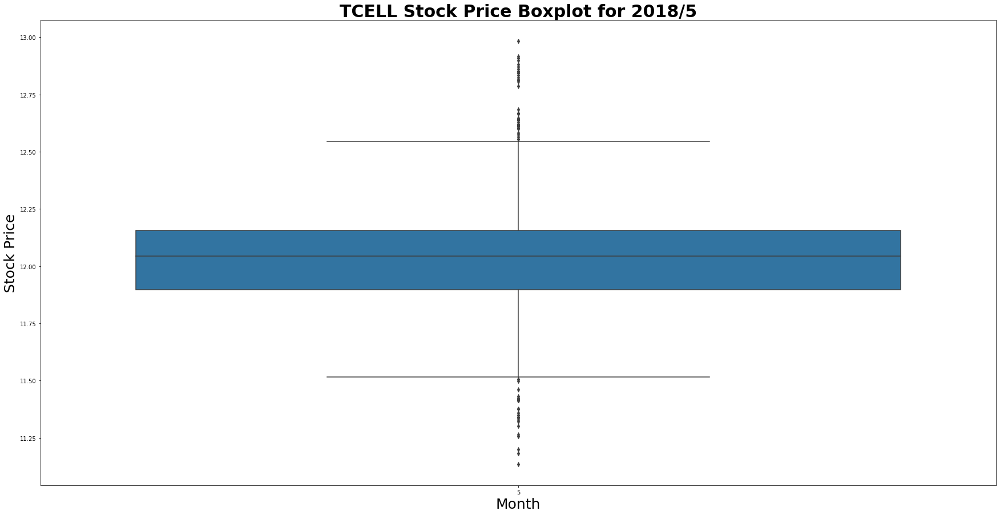

Upper Outliers for THYAO in 2018/5
Timestamp: 2018-05-28 11:00:00+00:00, Price: 17.41
Timestamp: 2018-05-28 11:15:00+00:00, Price: 17.43
Timestamp: 2018-05-28 12:30:00+00:00, Price: 17.41
Timestamp: 2018-05-28 13:15:00+00:00, Price: 17.42
Timestamp: 2018-05-28 14:30:00+00:00, Price: 17.41
Timestamp: 2018-05-28 14:45:00+00:00, Price: 17.53
Timestamp: 2018-05-28 15:00:00+00:00, Price: 17.55
Timestamp: 2018-05-29 06:45:00+00:00, Price: 17.53
Timestamp: 2018-05-29 14:00:00+00:00, Price: 17.55
Timestamp: 2018-05-29 14:15:00+00:00, Price: 17.5
Timestamp: 2018-05-29 14:30:00+00:00, Price: 17.47
Timestamp: 2018-05-29 14:45:00+00:00, Price: 17.49
Timestamp: 2018-05-29 15:00:00+00:00, Price: 17.46
Timestamp: 2018-05-30 06:45:00+00:00, Price: 17.48
Timestamp: 2018-05-30 07:00:00+00:00, Price: 17.51
Timestamp: 2018-05-30 07:15:00+00:00, Price: 17.49
Timestamp: 2018-05-30 07:30:00+00:00, Price: 17.56
Timestamp: 2018-05-30 07:45:00+00:00, Price: 17.58
Timestamp: 2018-05-30 08:00:00+00:00, Price: 17.

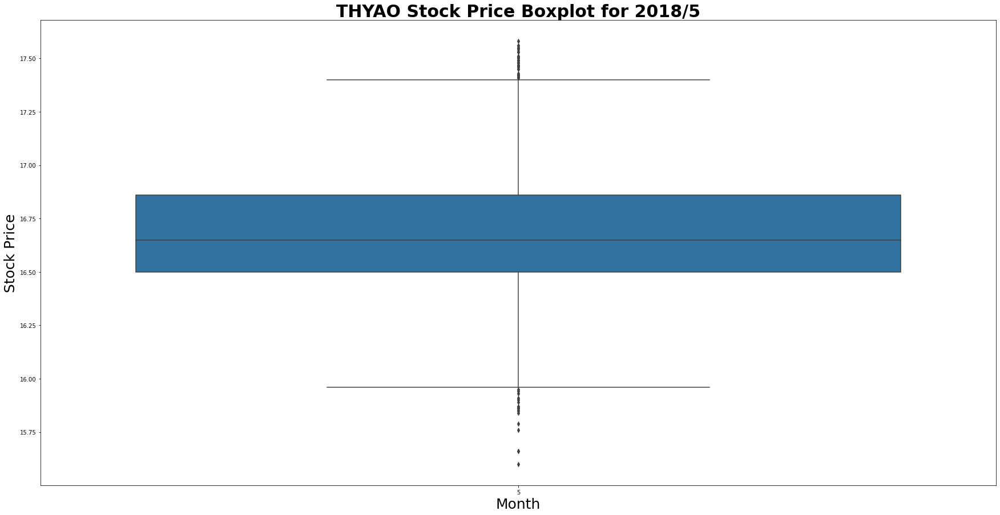

Upper Outliers for AKBNK in 2018/6
Timestamp: 2018-06-01 06:45:00+00:00, Price: 6.8976
Timestamp: 2018-06-01 07:00:00+00:00, Price: 6.8633
Timestamp: 2018-06-04 07:45:00+00:00, Price: 6.7947
Timestamp: 2018-06-04 08:45:00+00:00, Price: 6.7861
Timestamp: 2018-06-04 09:15:00+00:00, Price: 6.8461
Timestamp: 2018-06-04 09:30:00+00:00, Price: 6.8204
Timestamp: 2018-06-04 11:30:00+00:00, Price: 6.7861


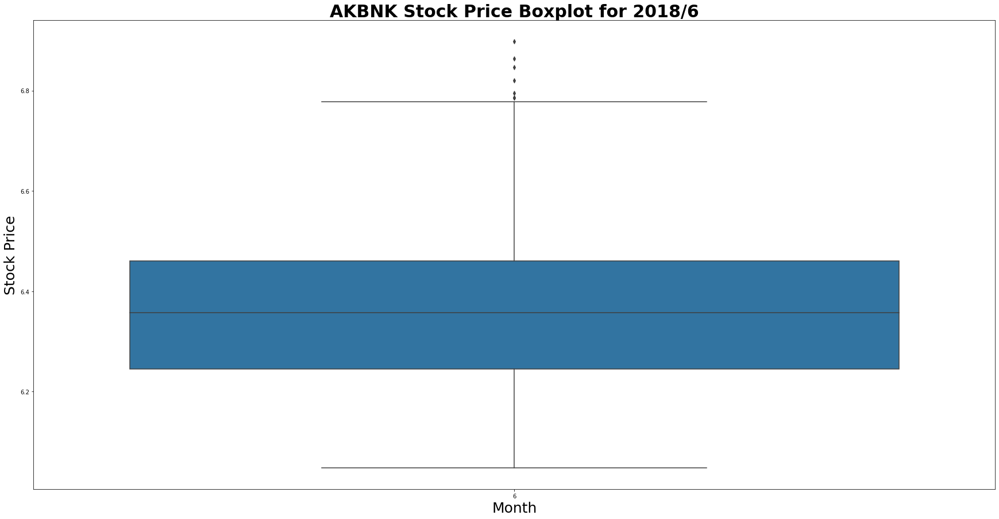

NO OUTLIERS


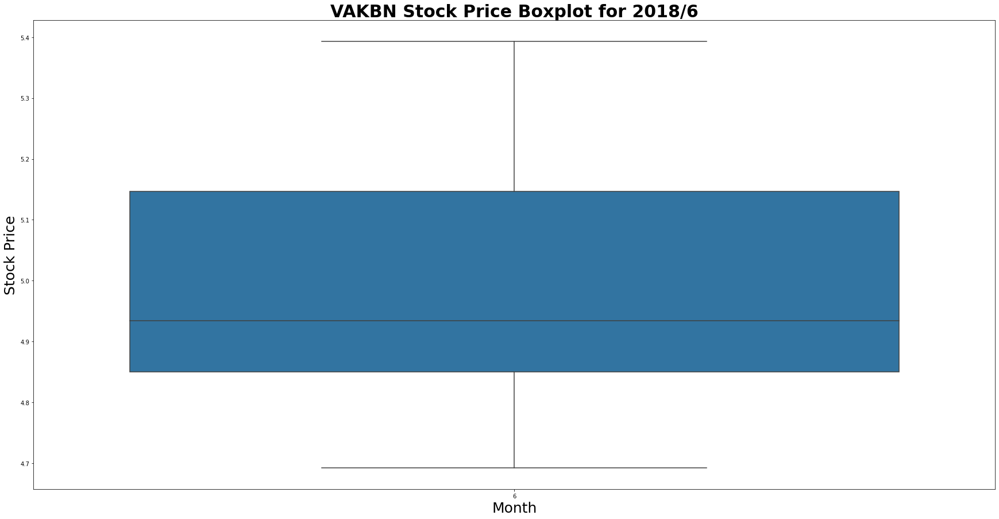

Upper Outliers for ARCLK in 2018/6
Timestamp: 2018-06-01 06:45:00+00:00, Price: 16.62
Timestamp: 2018-06-01 07:00:00+00:00, Price: 16.42
Timestamp: 2018-06-01 09:15:00+00:00, Price: 16.44
Timestamp: 2018-06-01 09:30:00+00:00, Price: 16.45
Timestamp: 2018-06-01 09:45:00+00:00, Price: 16.45
Timestamp: 2018-06-01 10:45:00+00:00, Price: 16.55
Timestamp: 2018-06-01 11:00:00+00:00, Price: 16.5
Timestamp: 2018-06-01 11:30:00+00:00, Price: 16.42
Timestamp: 2018-06-01 12:30:00+00:00, Price: 16.42
Timestamp: 2018-06-01 12:45:00+00:00, Price: 16.48
Timestamp: 2018-06-01 13:00:00+00:00, Price: 16.48
Timestamp: 2018-06-01 13:30:00+00:00, Price: 16.46
Timestamp: 2018-06-01 13:45:00+00:00, Price: 16.49
Timestamp: 2018-06-01 14:00:00+00:00, Price: 16.46
Timestamp: 2018-06-04 07:00:00+00:00, Price: 16.5
Timestamp: 2018-06-04 07:15:00+00:00, Price: 16.46
Timestamp: 2018-06-04 07:30:00+00:00, Price: 16.5
Timestamp: 2018-06-04 07:45:00+00:00, Price: 16.53
Timestamp: 2018-06-04 08:00:00+00:00, Price: 16.51

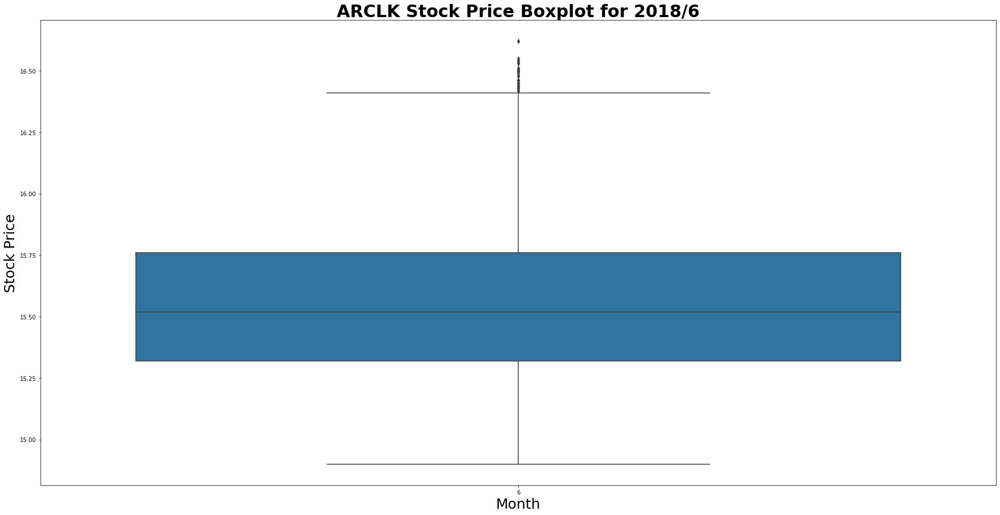

NO OUTLIERS


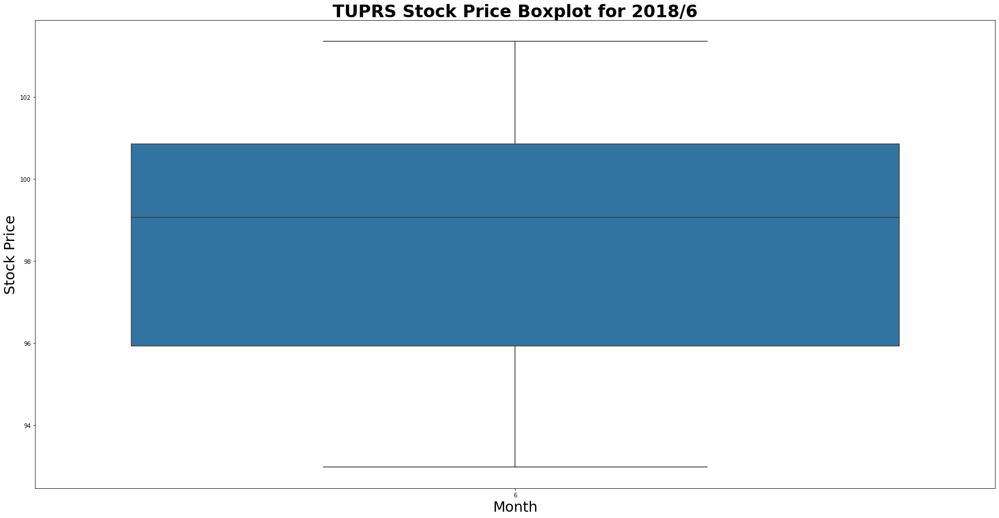

Upper Outliers for TCELL in 2018/6
Timestamp: 2018-06-28 09:15:00+00:00, Price: 11.6377
Timestamp: 2018-06-28 09:45:00+00:00, Price: 11.6471
Timestamp: 2018-06-28 10:45:00+00:00, Price: 11.6567
Timestamp: 2018-06-28 11:00:00+00:00, Price: 11.6662
Timestamp: 2018-06-28 11:15:00+00:00, Price: 11.6377
Timestamp: 2018-06-28 13:00:00+00:00, Price: 11.7138
Timestamp: 2018-06-28 13:15:00+00:00, Price: 11.7613
Timestamp: 2018-06-28 13:30:00+00:00, Price: 11.7518
Timestamp: 2018-06-28 13:45:00+00:00, Price: 11.7233
Timestamp: 2018-06-28 14:00:00+00:00, Price: 11.7613
Timestamp: 2018-06-28 14:15:00+00:00, Price: 11.7233
Timestamp: 2018-06-28 14:30:00+00:00, Price: 11.7518
Timestamp: 2018-06-28 14:45:00+00:00, Price: 11.6947
Timestamp: 2018-06-28 15:00:00+00:00, Price: 11.7138
Timestamp: 2018-06-29 06:45:00+00:00, Price: 11.7994
Timestamp: 2018-06-29 07:00:00+00:00, Price: 11.9136
Timestamp: 2018-06-29 07:15:00+00:00, Price: 11.9041
Timestamp: 2018-06-29 07:30:00+00:00, Price: 11.8851
Timestamp: 

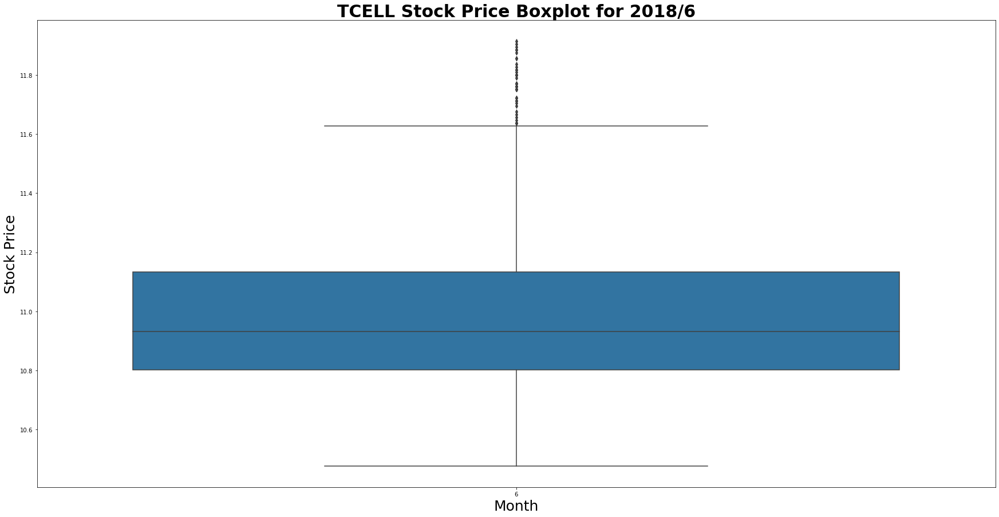

NO OUTLIERS


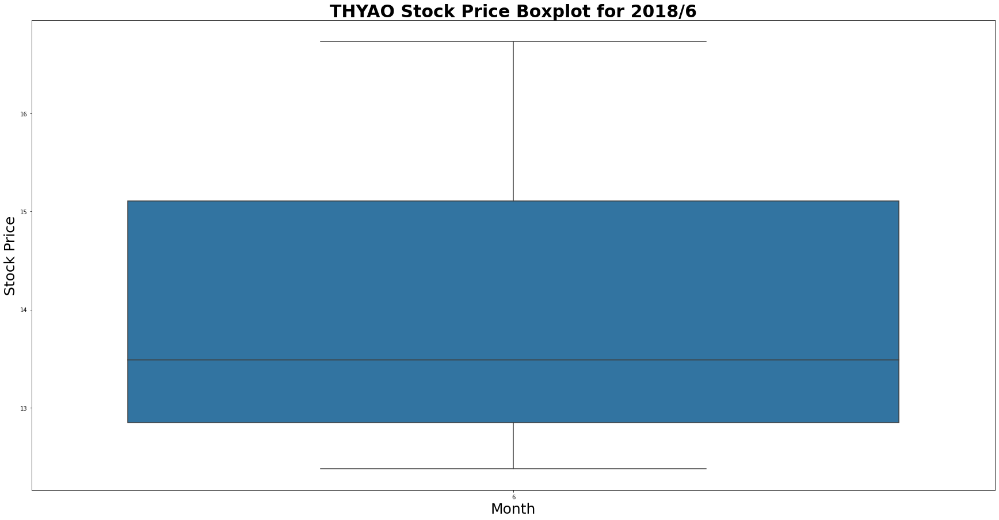

NO OUTLIERS


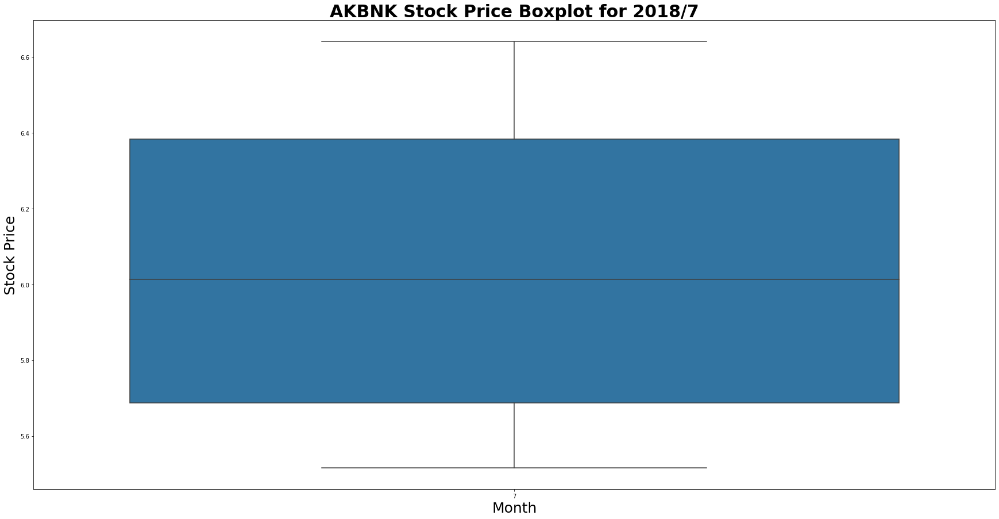

NO OUTLIERS


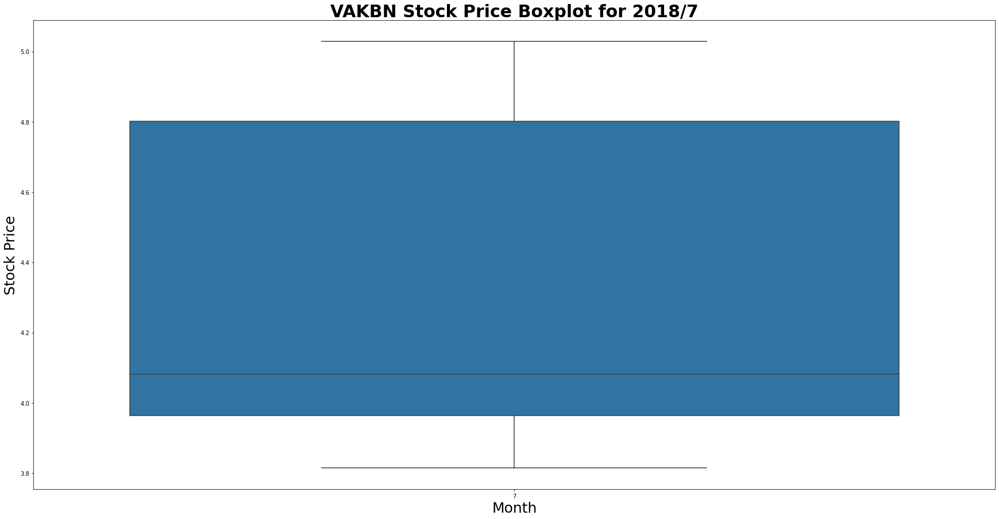

NO OUTLIERS


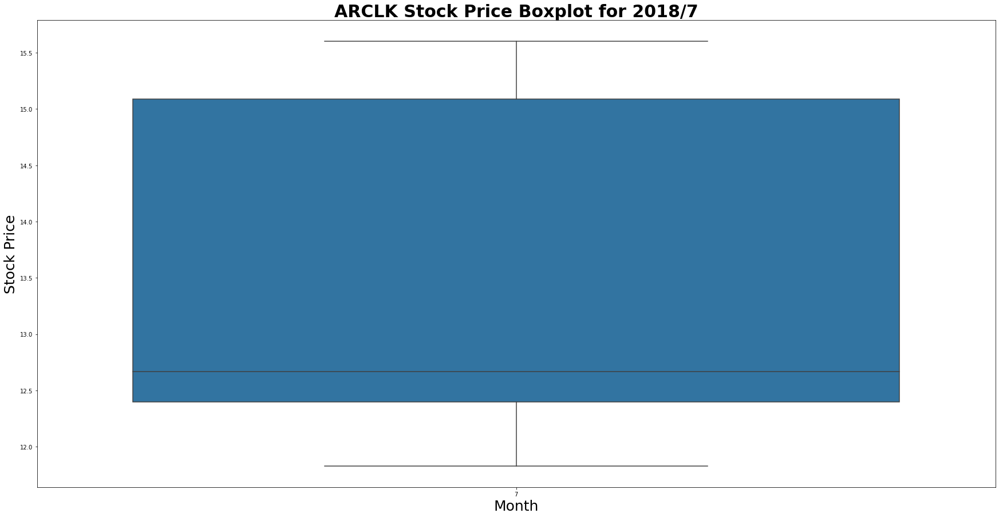

NO OUTLIERS


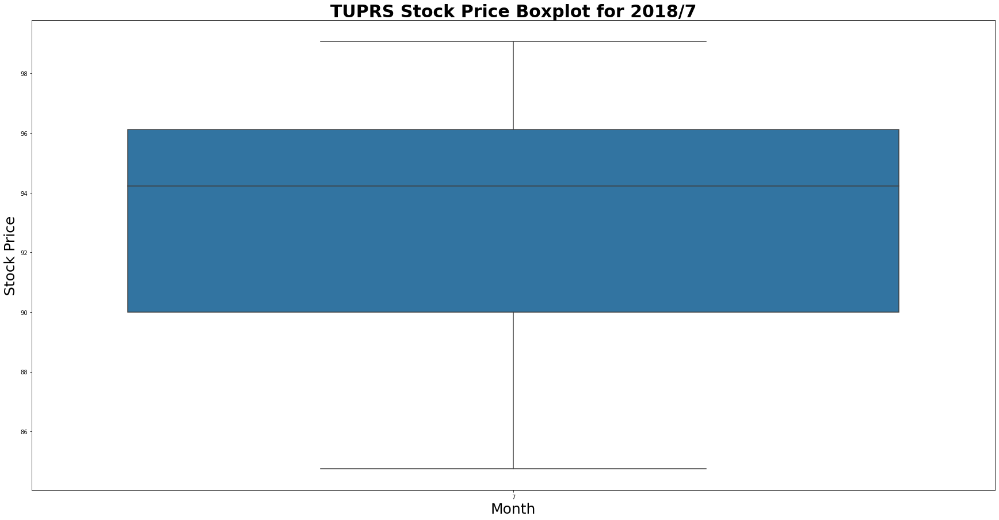

NO OUTLIERS


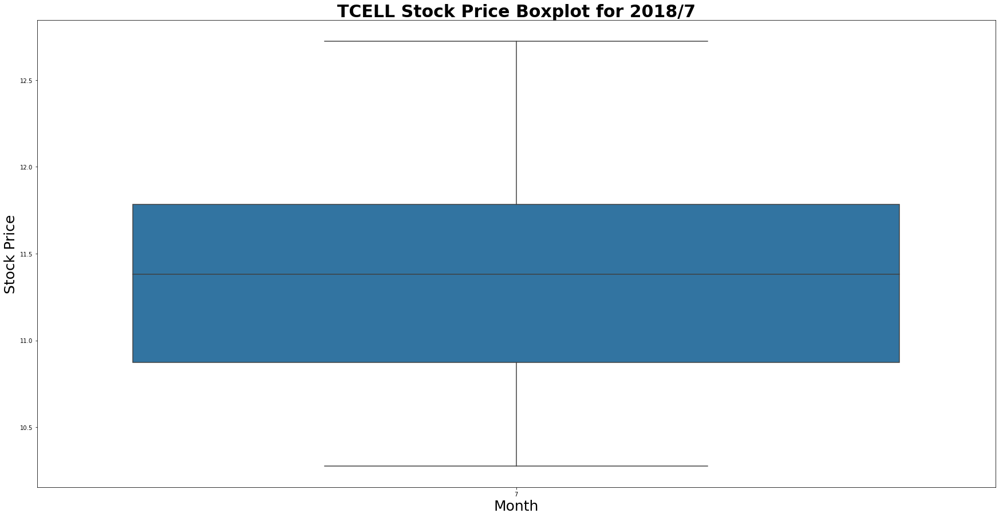

NO OUTLIERS


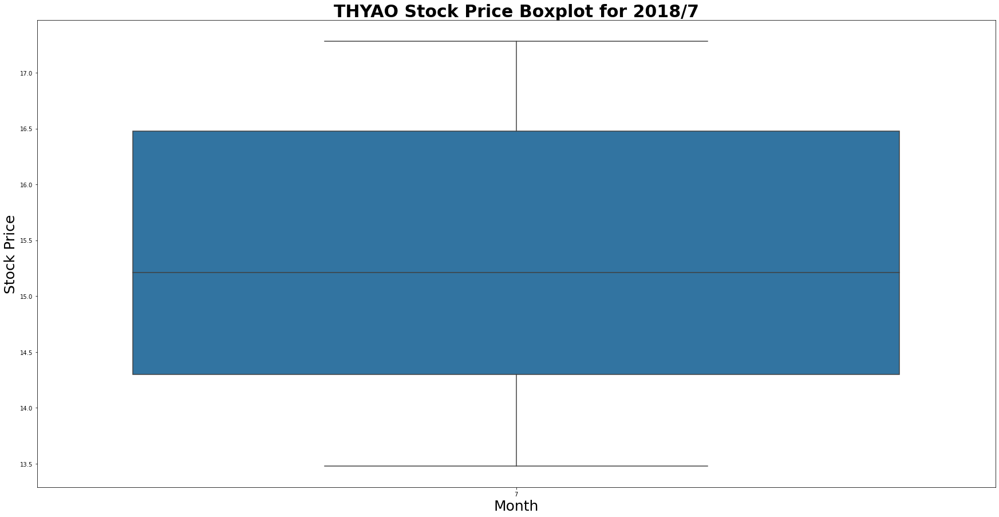

NO OUTLIERS


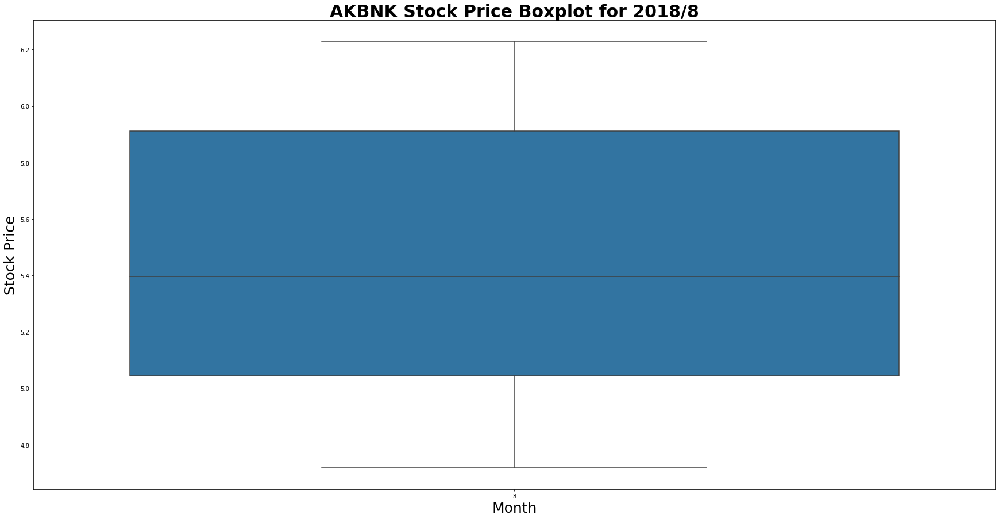

NO OUTLIERS


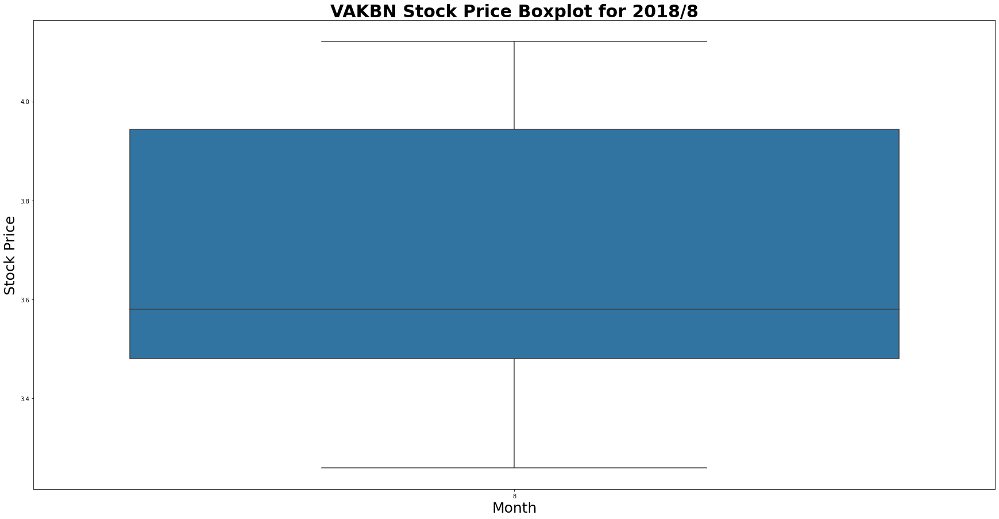

NO OUTLIERS


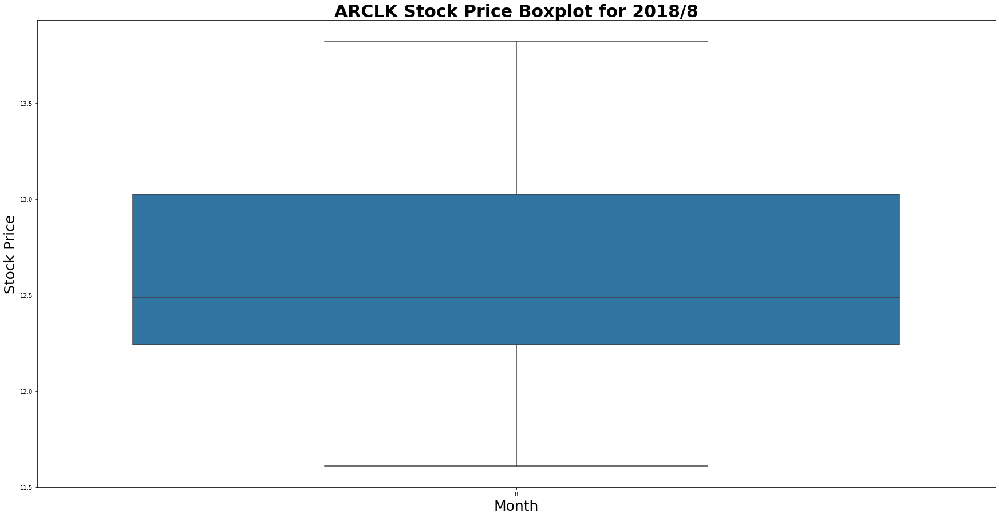

NO OUTLIERS


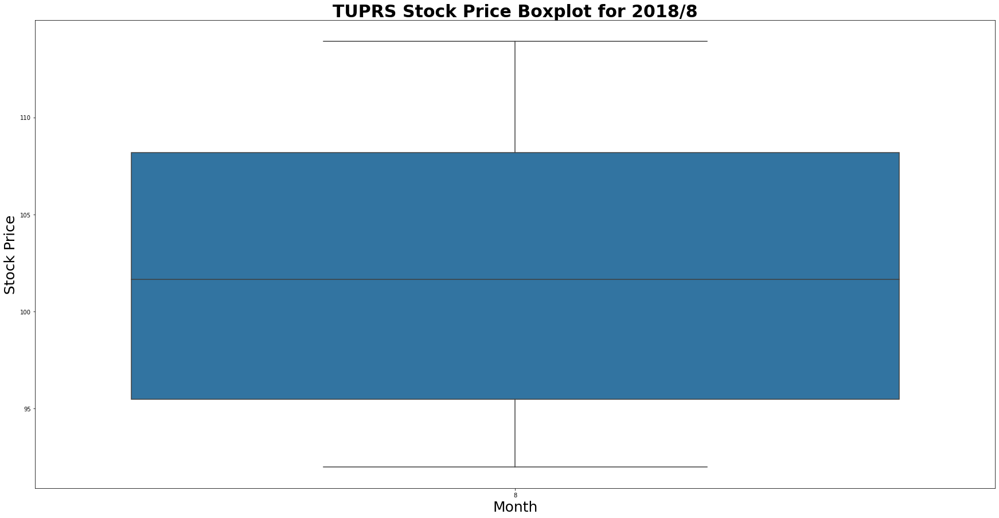

NO OUTLIERS


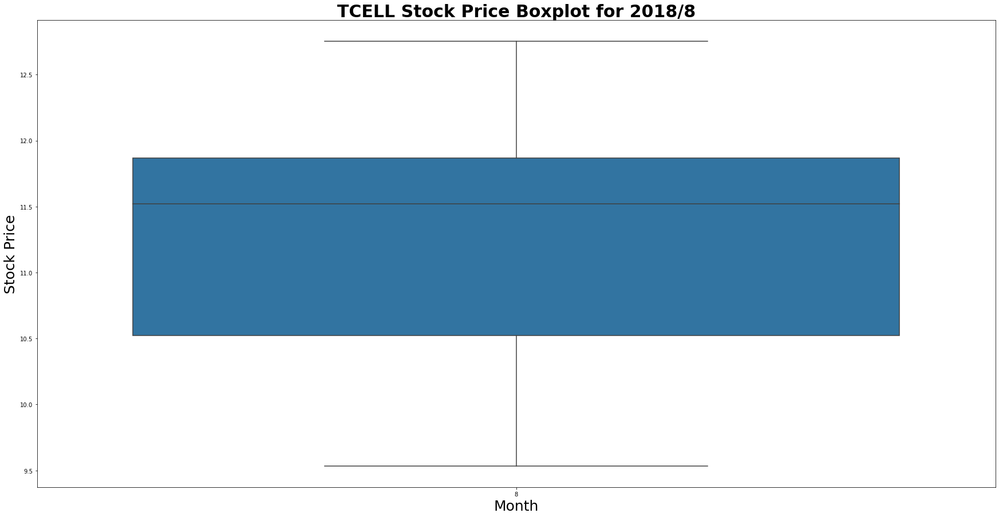

Lower Outliers for THYAO in 2018/8
Timestamp: 2018-08-17 07:00:00+00:00, Price: 15.01
Timestamp: 2018-08-17 07:15:00+00:00, Price: 14.65
Timestamp: 2018-08-17 07:30:00+00:00, Price: 14.35
Timestamp: 2018-08-17 07:45:00+00:00, Price: 14.48
Timestamp: 2018-08-17 08:00:00+00:00, Price: 14.72
Timestamp: 2018-08-17 08:15:00+00:00, Price: 14.67
Timestamp: 2018-08-17 08:30:00+00:00, Price: 14.62
Timestamp: 2018-08-17 08:45:00+00:00, Price: 14.57
Timestamp: 2018-08-17 09:00:00+00:00, Price: 14.6
Timestamp: 2018-08-17 09:15:00+00:00, Price: 14.52
Timestamp: 2018-08-17 09:30:00+00:00, Price: 14.58
Timestamp: 2018-08-17 09:45:00+00:00, Price: 14.57
Timestamp: 2018-08-17 10:00:00+00:00, Price: 14.58
Timestamp: 2018-08-17 10:45:00+00:00, Price: 14.59
Timestamp: 2018-08-17 11:00:00+00:00, Price: 14.91
Timestamp: 2018-08-17 11:15:00+00:00, Price: 15.11
Timestamp: 2018-08-17 11:30:00+00:00, Price: 15.09
Timestamp: 2018-08-17 12:00:00+00:00, Price: 15.07
Timestamp: 2018-08-17 12:15:00+00:00, Price: 15.

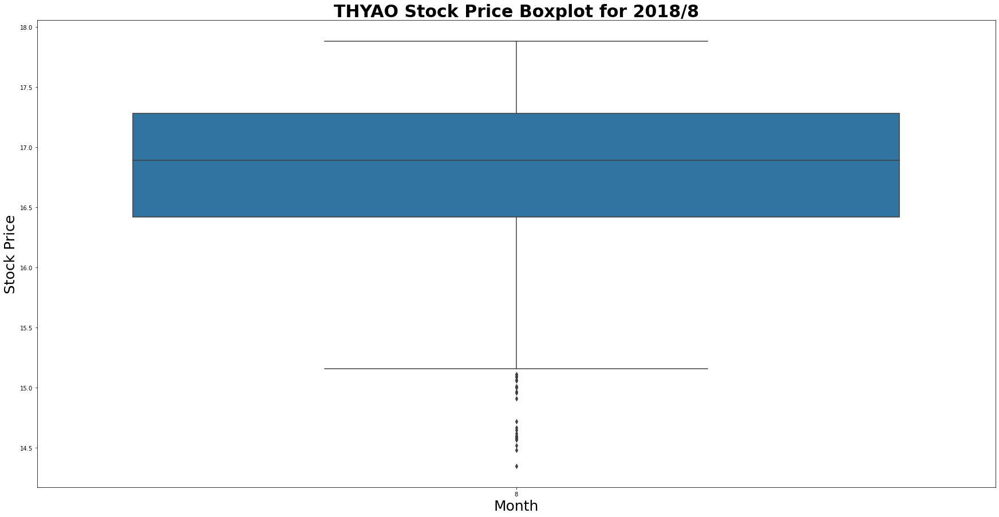

NO OUTLIERS


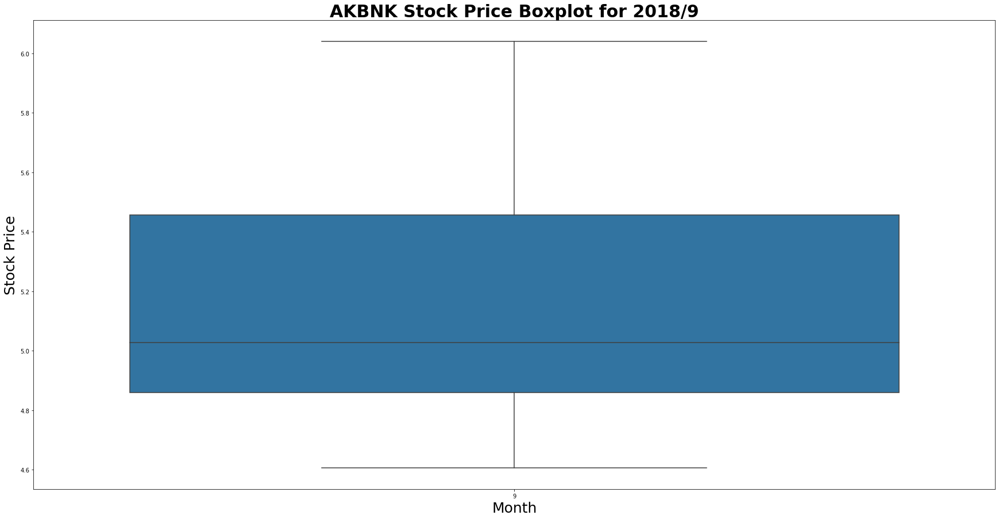

NO OUTLIERS


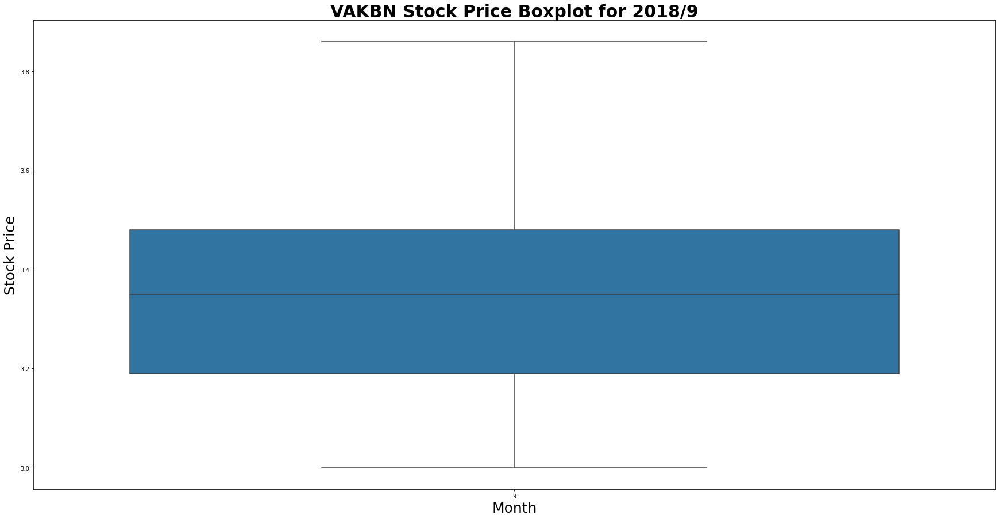

NO OUTLIERS


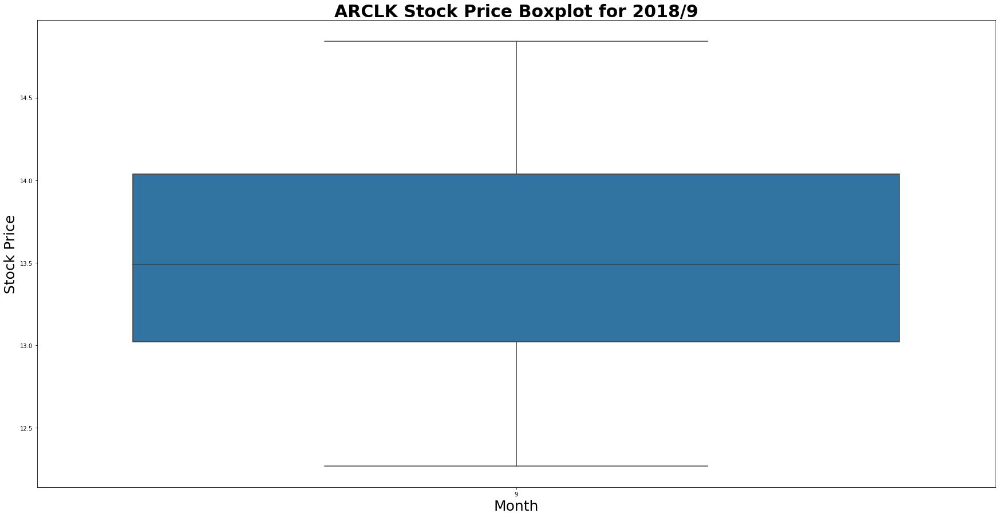

NO OUTLIERS


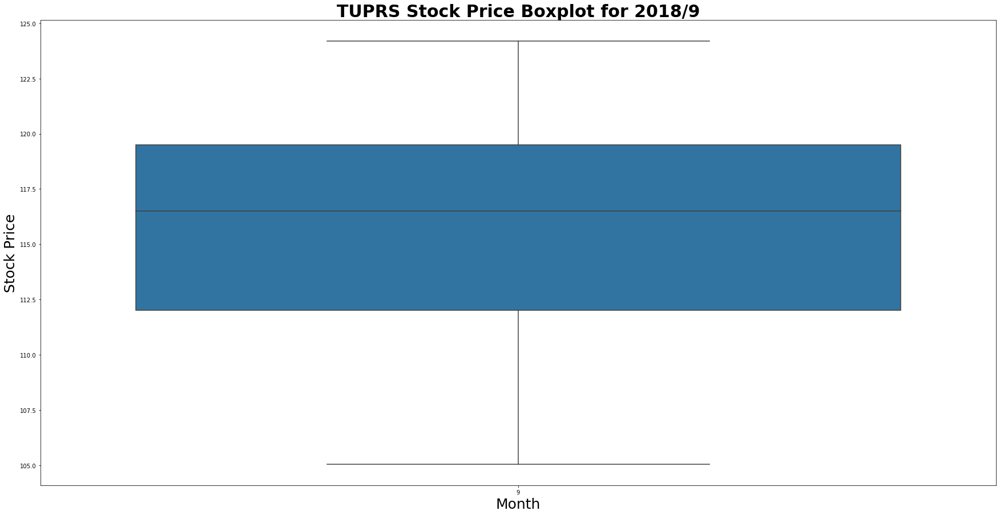

NO OUTLIERS


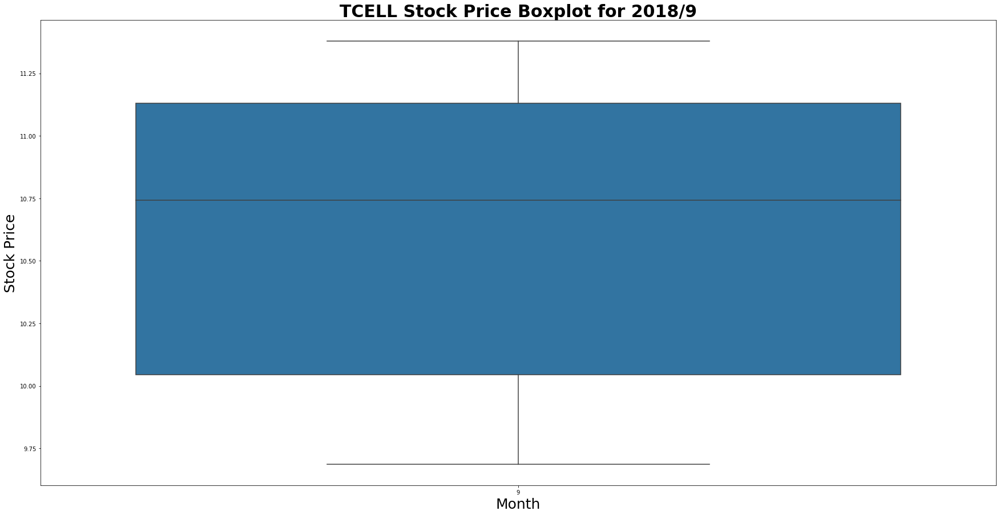

NO OUTLIERS


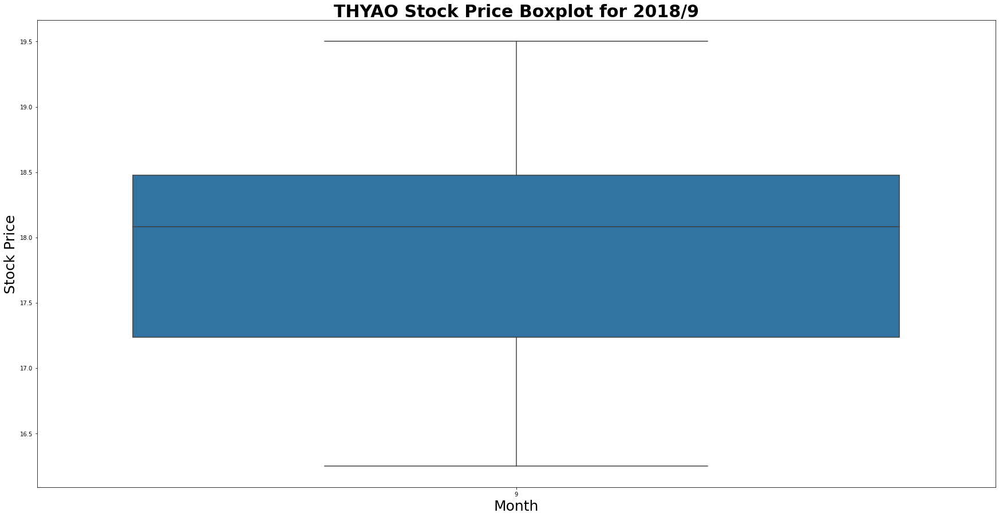

NO OUTLIERS


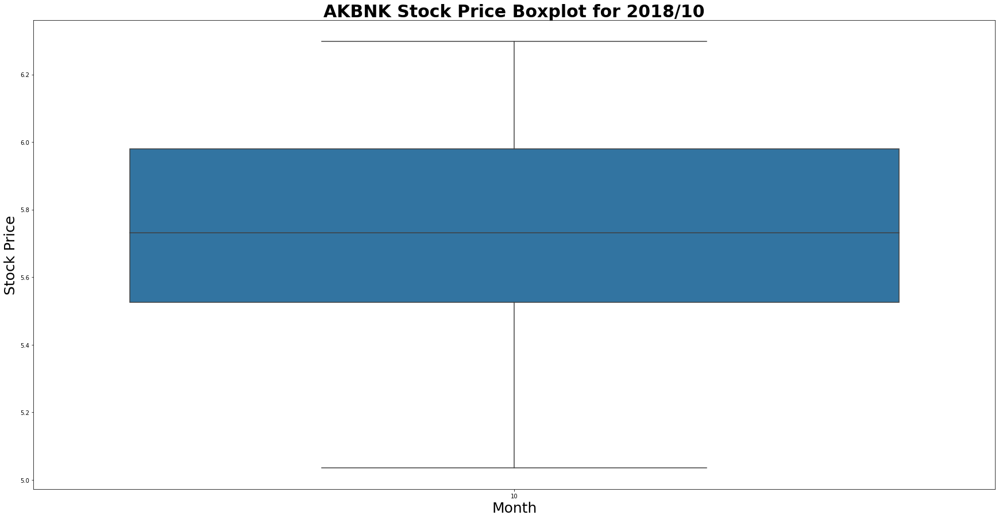

NO OUTLIERS


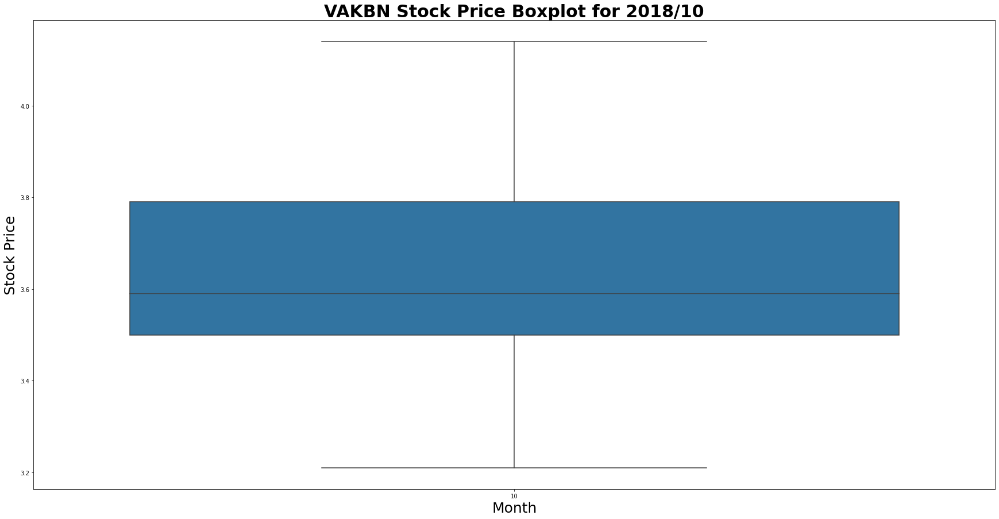

NO OUTLIERS


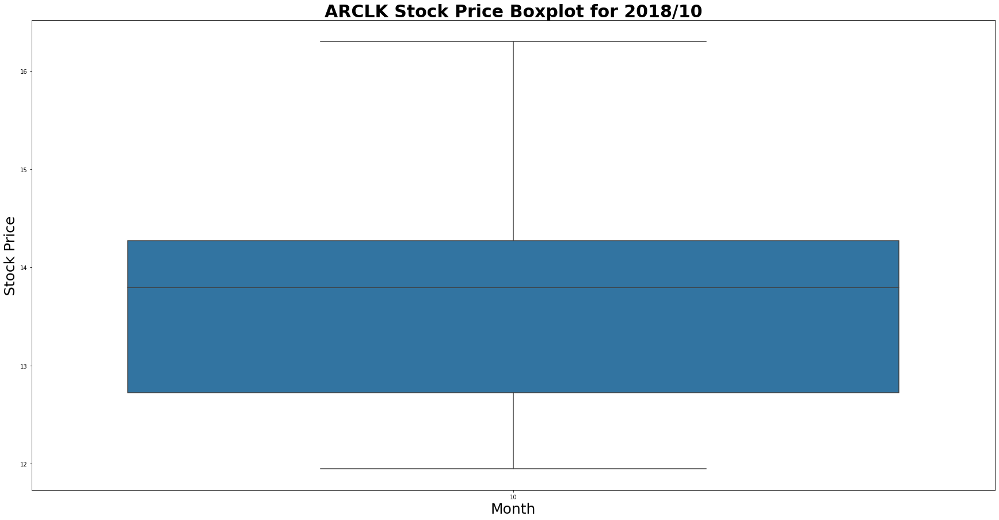

Lower Outliers for TUPRS in 2018/10
Timestamp: 2018-10-30 11:00:00+00:00, Price: 109.9687
Timestamp: 2018-10-30 11:15:00+00:00, Price: 109.3429
Timestamp: 2018-10-30 11:30:00+00:00, Price: 109.5217
Timestamp: 2018-10-30 11:45:00+00:00, Price: 109.6111
Timestamp: 2018-10-30 12:00:00+00:00, Price: 109.5217
Timestamp: 2018-10-30 12:15:00+00:00, Price: 109.5217
Timestamp: 2018-10-30 12:30:00+00:00, Price: 109.8793
Timestamp: 2018-10-30 12:45:00+00:00, Price: 109.6111
Timestamp: 2018-10-30 13:00:00+00:00, Price: 109.7005
Timestamp: 2018-10-30 13:15:00+00:00, Price: 109.9687
Timestamp: 2018-10-30 13:30:00+00:00, Price: 109.7005
Timestamp: 2018-10-30 13:45:00+00:00, Price: 110.1475


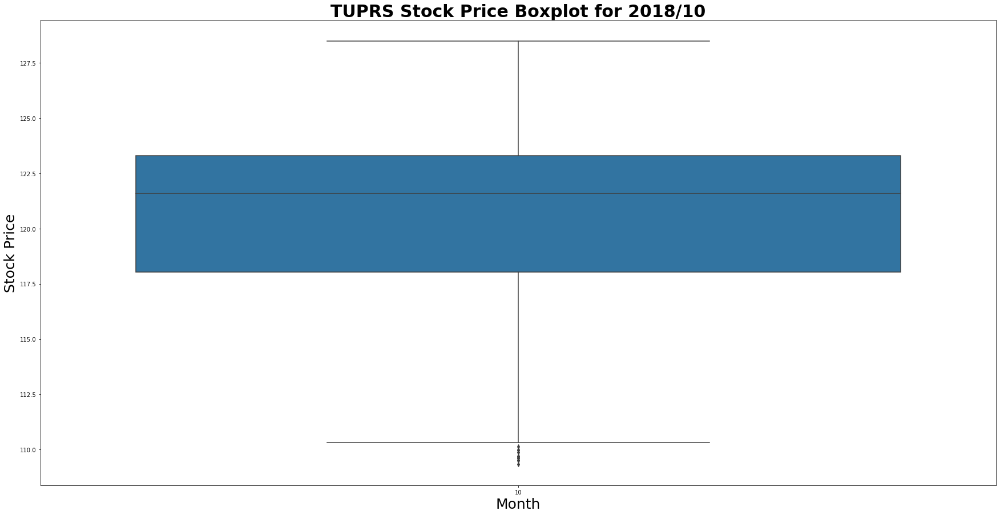

NO OUTLIERS


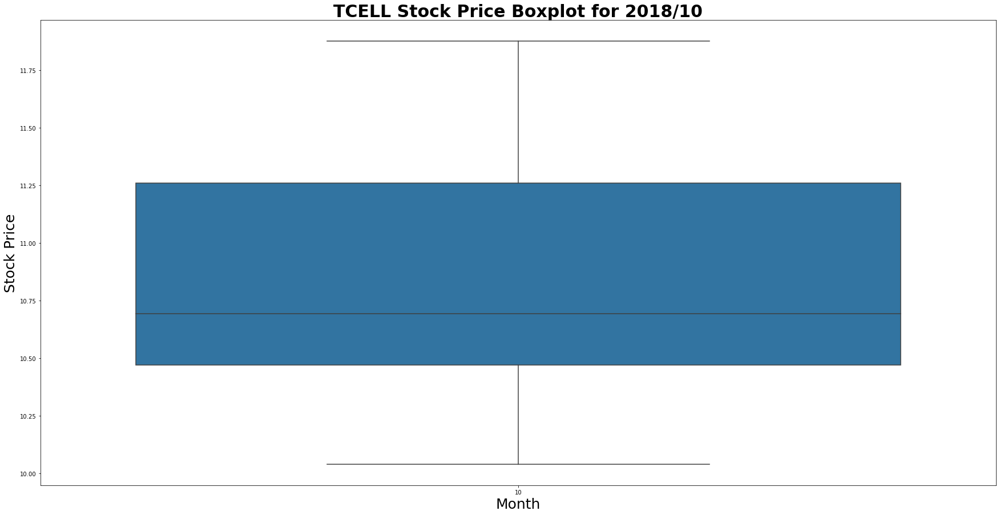

NO OUTLIERS


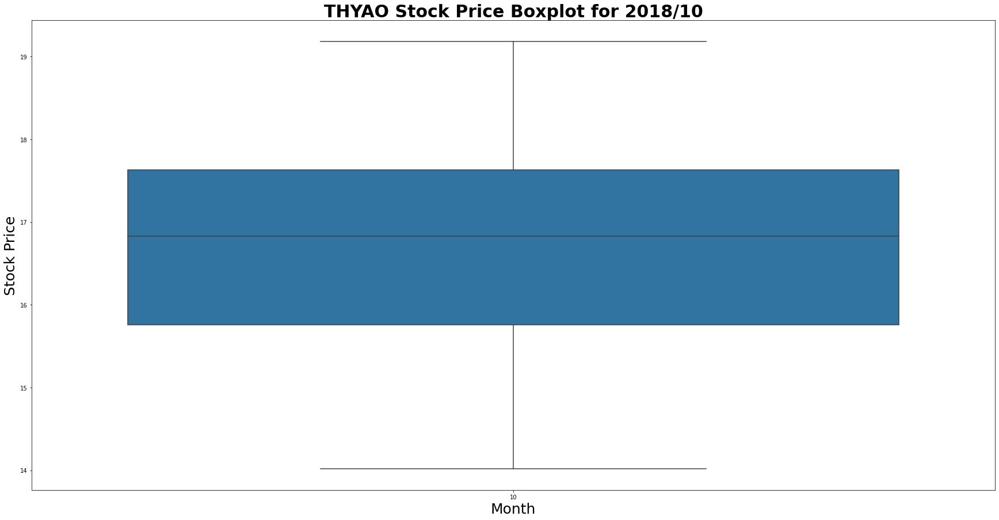

Lower Outliers for AKBNK in 2018/11
Timestamp: 2018-11-01 06:45:00+00:00, Price: 5.6451
Timestamp: 2018-11-01 07:00:00+00:00, Price: 5.6365
Timestamp: 2018-11-01 07:15:00+00:00, Price: 5.5679
Timestamp: 2018-11-01 07:30:00+00:00, Price: 5.5507
Timestamp: 2018-11-01 07:45:00+00:00, Price: 5.5679
Timestamp: 2018-11-01 08:00:00+00:00, Price: 5.6193
Timestamp: 2018-11-01 08:15:00+00:00, Price: 5.6365
Timestamp: 2018-11-01 08:30:00+00:00, Price: 5.6536
Timestamp: 2018-11-01 08:45:00+00:00, Price: 5.7309
Timestamp: 2018-11-01 09:00:00+00:00, Price: 5.7223
Timestamp: 2018-11-01 09:15:00+00:00, Price: 5.7309
Timestamp: 2018-11-01 09:30:00+00:00, Price: 5.7394
Timestamp: 2018-11-01 09:45:00+00:00, Price: 5.7823
Timestamp: 2018-11-01 10:00:00+00:00, Price: 5.7823
Timestamp: 2018-11-01 10:45:00+00:00, Price: 5.7823
Timestamp: 2018-11-01 11:00:00+00:00, Price: 5.7652
Timestamp: 2018-11-01 11:15:00+00:00, Price: 5.7394
Timestamp: 2018-11-01 11:30:00+00:00, Price: 5.7652
Timestamp: 2018-11-01 11:45:

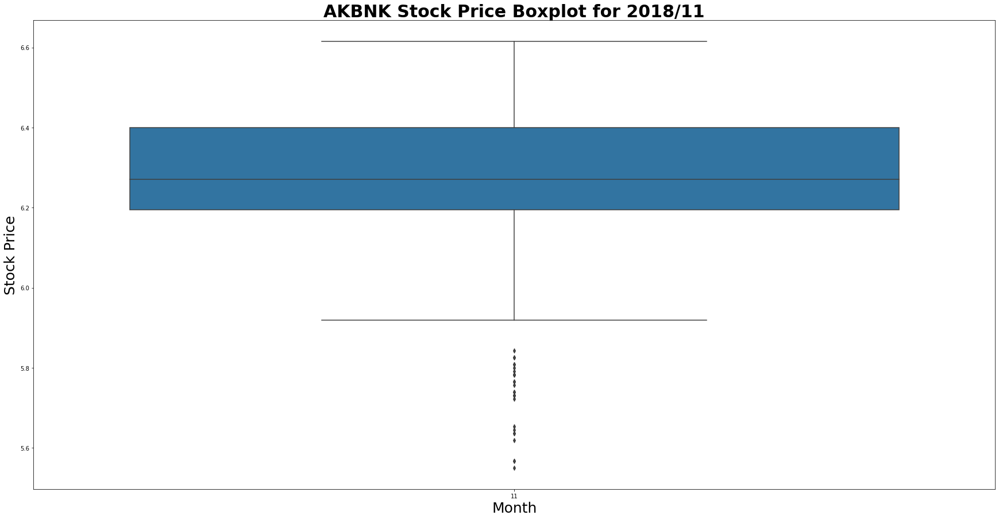

Upper Outliers for VAKBN in 2018/11
Timestamp: 2018-11-30 14:45:00+00:00, Price: 4.03
Lower Outliers for VAKBN in 2018/11
Timestamp: 2018-11-01 07:00:00+00:00, Price: 3.42
Timestamp: 2018-11-01 07:30:00+00:00, Price: 3.42
Timestamp: 2018-11-01 07:45:00+00:00, Price: 3.42
Timestamp: 2018-11-01 08:00:00+00:00, Price: 3.42


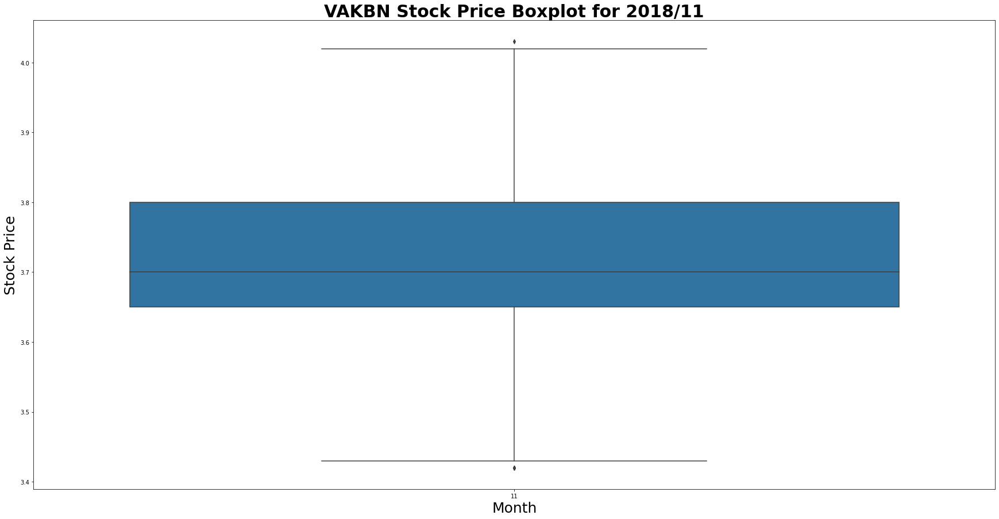

NO OUTLIERS


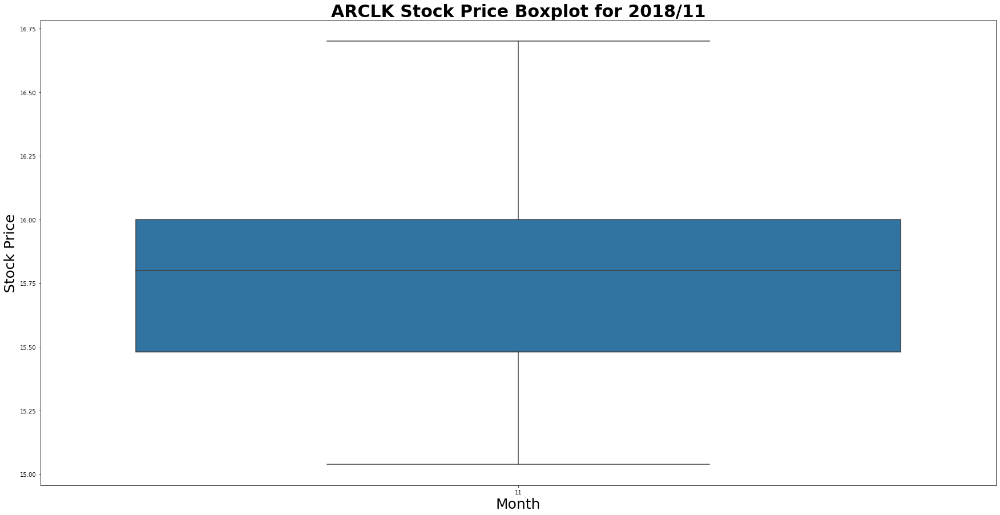

Upper Outliers for TUPRS in 2018/11
Timestamp: 2018-11-05 11:15:00+00:00, Price: 122.3067
Timestamp: 2018-11-05 11:45:00+00:00, Price: 122.6643
Timestamp: 2018-11-05 12:00:00+00:00, Price: 122.3961
Timestamp: 2018-11-05 12:30:00+00:00, Price: 122.4855
Timestamp: 2018-11-05 12:45:00+00:00, Price: 122.4855
Timestamp: 2018-11-05 13:00:00+00:00, Price: 122.3067
Timestamp: 2018-11-05 13:15:00+00:00, Price: 122.3067
Timestamp: 2018-11-05 13:30:00+00:00, Price: 123.1113
Timestamp: 2018-11-05 14:30:00+00:00, Price: 122.4855
Timestamp: 2018-11-05 14:45:00+00:00, Price: 122.5749
Timestamp: 2018-11-05 15:00:00+00:00, Price: 123.2901
Timestamp: 2018-11-06 06:45:00+00:00, Price: 123.2901
Timestamp: 2018-11-06 07:00:00+00:00, Price: 122.3067
Timestamp: 2018-11-06 08:30:00+00:00, Price: 122.3961
Timestamp: 2018-11-07 11:30:00+00:00, Price: 122.3067
Timestamp: 2018-11-07 12:15:00+00:00, Price: 123.1113
Timestamp: 2018-11-07 12:30:00+00:00, Price: 123.3795
Timestamp: 2018-11-07 12:45:00+00:00, Price: 1

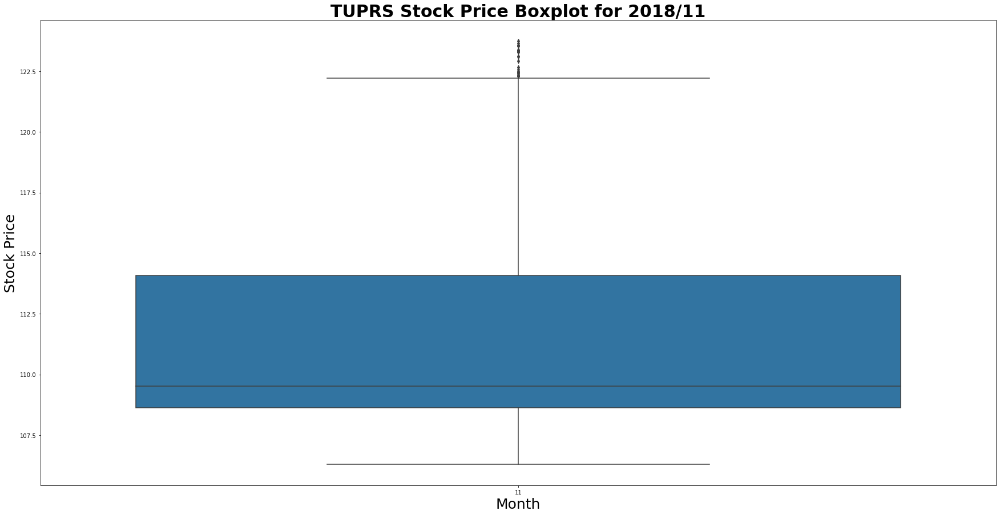

Upper Outliers for TCELL in 2018/11
Timestamp: 2018-11-28 12:45:00+00:00, Price: 12.6381
Timestamp: 2018-11-28 13:00:00+00:00, Price: 12.6869
Timestamp: 2018-11-28 13:15:00+00:00, Price: 12.7064
Timestamp: 2018-11-28 13:30:00+00:00, Price: 12.6967
Timestamp: 2018-11-28 13:45:00+00:00, Price: 12.6576
Timestamp: 2018-11-29 07:15:00+00:00, Price: 12.7064
Timestamp: 2018-11-29 07:30:00+00:00, Price: 12.6967
Timestamp: 2018-11-29 07:45:00+00:00, Price: 12.6869
Timestamp: 2018-11-29 08:00:00+00:00, Price: 12.6381
Timestamp: 2018-11-29 09:15:00+00:00, Price: 12.6674
Timestamp: 2018-11-29 09:30:00+00:00, Price: 12.6478
Timestamp: 2018-11-29 11:00:00+00:00, Price: 12.6381
Timestamp: 2018-11-29 11:15:00+00:00, Price: 12.6478
Timestamp: 2018-11-29 11:30:00+00:00, Price: 12.6478
Timestamp: 2018-11-29 11:45:00+00:00, Price: 12.6381
Timestamp: 2018-11-29 12:00:00+00:00, Price: 12.6381
Timestamp: 2018-11-29 12:15:00+00:00, Price: 12.6478
Timestamp: 2018-11-29 12:30:00+00:00, Price: 12.6576
Timestamp:

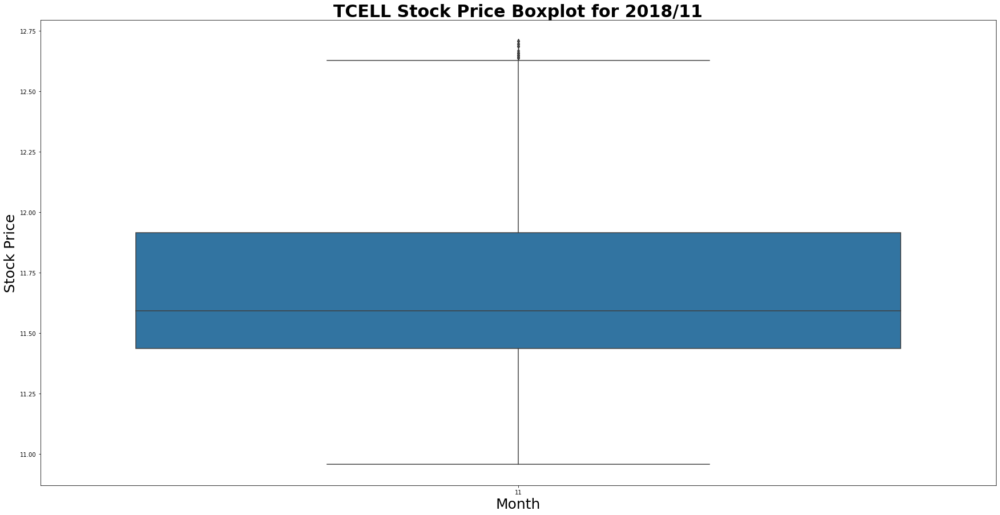

NO OUTLIERS


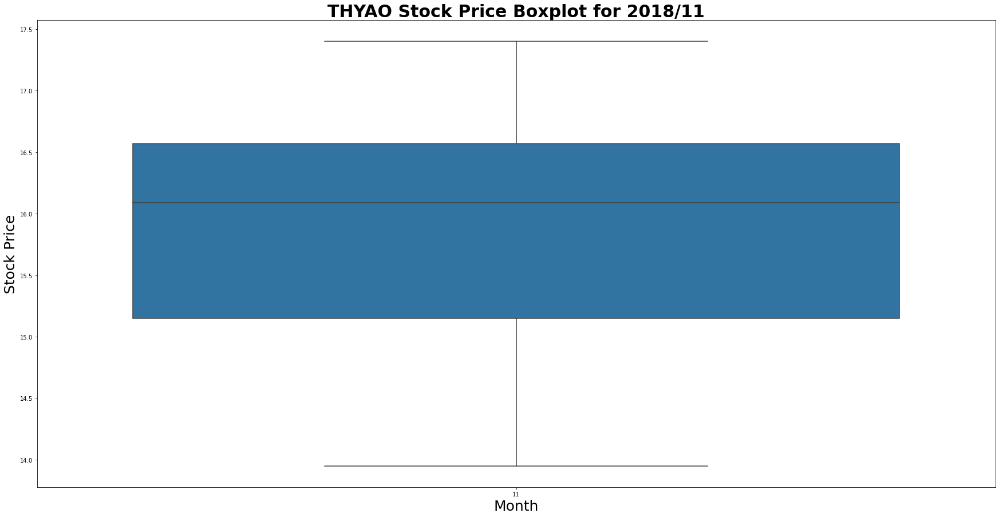

Upper Outliers for AKBNK in 2018/12
Timestamp: 2018-12-03 06:45:00+00:00, Price: 6.6831
Timestamp: 2018-12-03 07:00:00+00:00, Price: 6.7003
Timestamp: 2018-12-03 07:15:00+00:00, Price: 6.6831
Timestamp: 2018-12-03 07:30:00+00:00, Price: 6.6917
Timestamp: 2018-12-03 07:45:00+00:00, Price: 6.6746
Timestamp: 2018-12-03 08:00:00+00:00, Price: 6.7089
Timestamp: 2018-12-03 08:15:00+00:00, Price: 6.7175
Timestamp: 2018-12-03 08:30:00+00:00, Price: 6.6746
Timestamp: 2018-12-03 08:45:00+00:00, Price: 6.6574
Timestamp: 2018-12-03 09:00:00+00:00, Price: 6.6402
Timestamp: 2018-12-03 09:15:00+00:00, Price: 6.6488
Timestamp: 2018-12-03 09:30:00+00:00, Price: 6.6574
Timestamp: 2018-12-03 09:45:00+00:00, Price: 6.6488
Timestamp: 2018-12-03 10:45:00+00:00, Price: 6.6317
Timestamp: 2018-12-03 11:00:00+00:00, Price: 6.5973
Timestamp: 2018-12-03 11:15:00+00:00, Price: 6.5802
Timestamp: 2018-12-03 11:30:00+00:00, Price: 6.563
Timestamp: 2018-12-03 11:45:00+00:00, Price: 6.5545
Timestamp: 2018-12-03 12:00:0

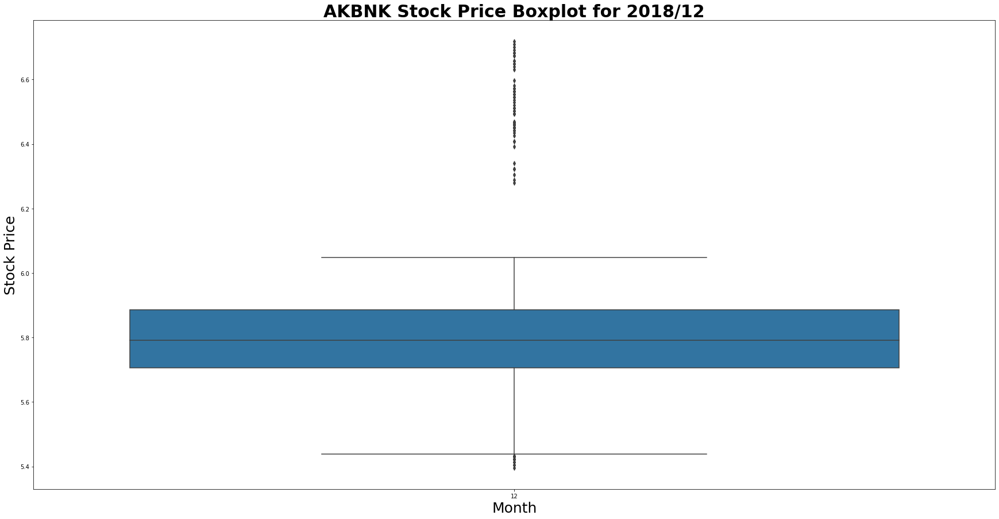

Upper Outliers for VAKBN in 2018/12
Timestamp: 2018-12-03 06:45:00+00:00, Price: 4.1
Timestamp: 2018-12-03 07:00:00+00:00, Price: 4.06
Timestamp: 2018-12-03 07:15:00+00:00, Price: 4.08
Timestamp: 2018-12-03 07:30:00+00:00, Price: 4.11
Timestamp: 2018-12-03 07:45:00+00:00, Price: 4.1
Timestamp: 2018-12-03 08:00:00+00:00, Price: 4.1
Timestamp: 2018-12-03 08:15:00+00:00, Price: 4.09
Timestamp: 2018-12-03 08:30:00+00:00, Price: 4.08
Timestamp: 2018-12-03 08:45:00+00:00, Price: 4.07
Timestamp: 2018-12-03 09:00:00+00:00, Price: 4.07
Timestamp: 2018-12-03 09:15:00+00:00, Price: 4.08
Timestamp: 2018-12-03 09:30:00+00:00, Price: 4.09
Timestamp: 2018-12-03 09:45:00+00:00, Price: 4.08
Timestamp: 2018-12-03 10:45:00+00:00, Price: 4.07
Timestamp: 2018-12-03 11:00:00+00:00, Price: 4.07
Timestamp: 2018-12-03 11:15:00+00:00, Price: 4.07
Timestamp: 2018-12-03 11:30:00+00:00, Price: 4.06
Timestamp: 2018-12-03 11:45:00+00:00, Price: 4.06
Timestamp: 2018-12-03 12:15:00+00:00, Price: 4.07
Timestamp: 2018-1

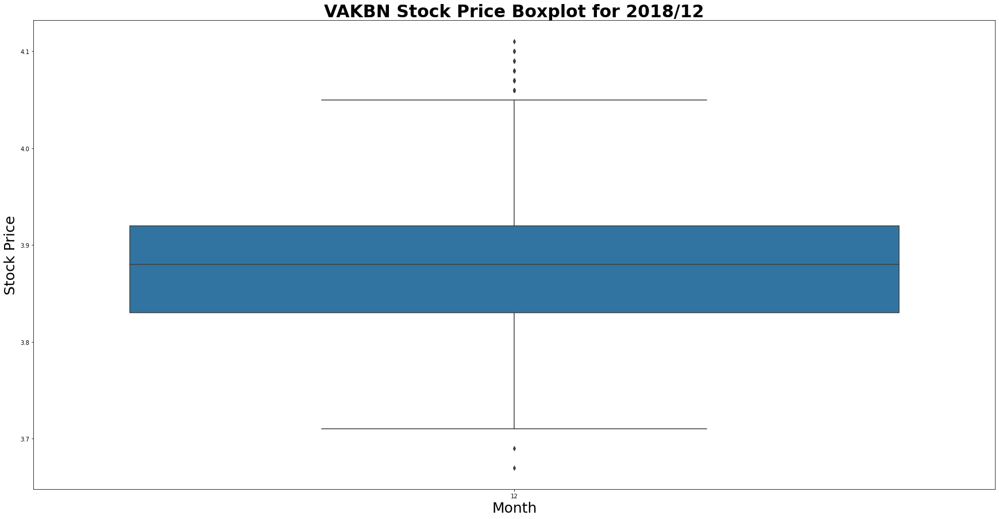

Upper Outliers for ARCLK in 2018/12
Timestamp: 2018-12-03 08:15:00+00:00, Price: 15.9
Lower Outliers for ARCLK in 2018/12
Timestamp: 2018-12-12 13:15:00+00:00, Price: 15.1


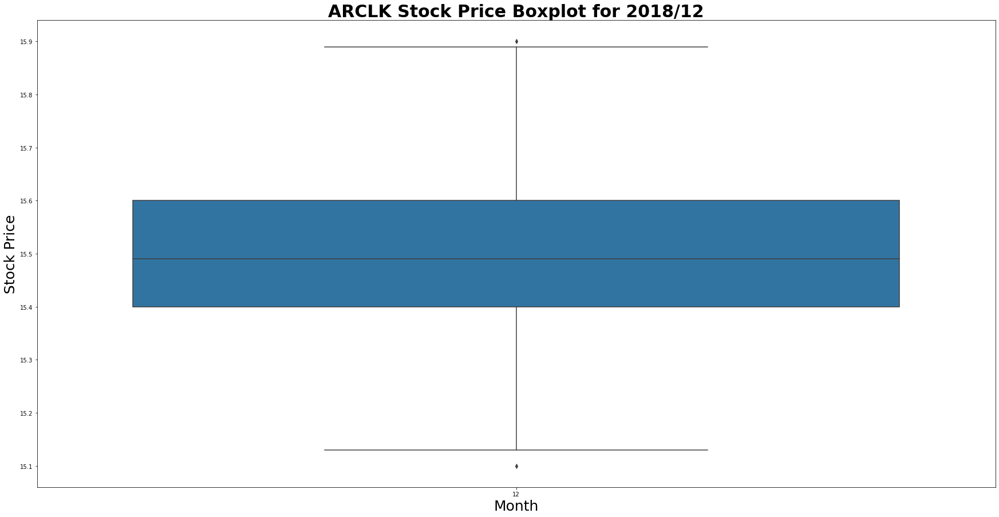

NO OUTLIERS


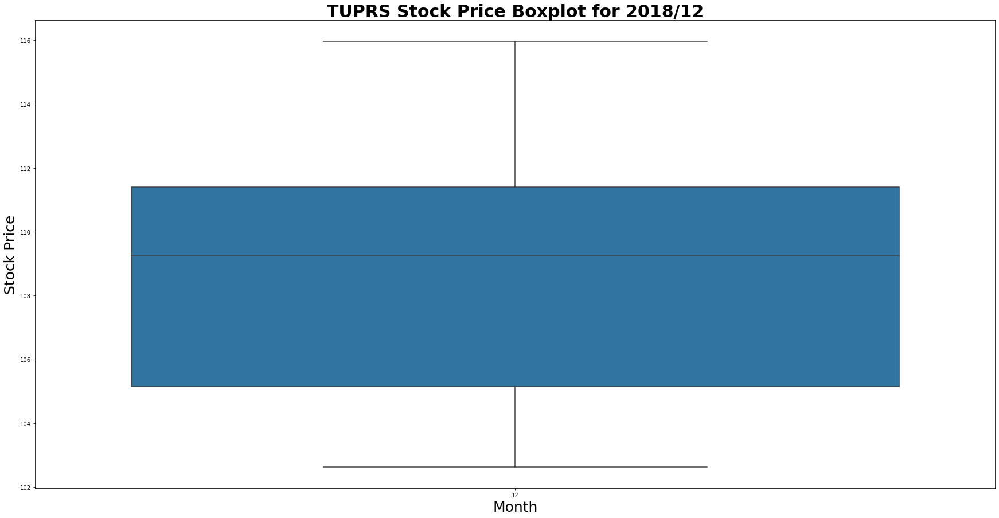

NO OUTLIERS


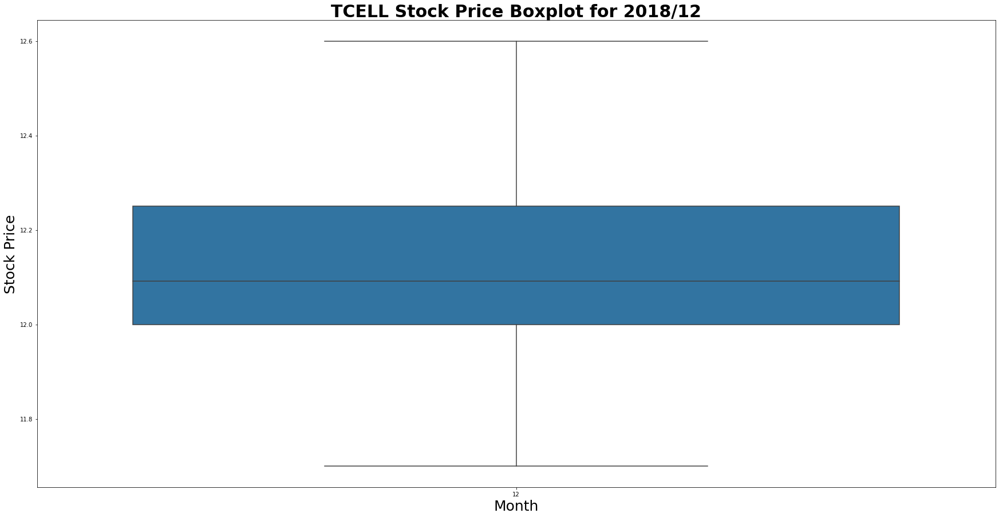

Upper Outliers for THYAO in 2018/12
Timestamp: 2018-12-03 06:45:00+00:00, Price: 17.11
Timestamp: 2018-12-03 07:00:00+00:00, Price: 17.06
Timestamp: 2018-12-03 07:15:00+00:00, Price: 17.07
Timestamp: 2018-12-03 07:30:00+00:00, Price: 17.12
Timestamp: 2018-12-03 07:45:00+00:00, Price: 17.1
Timestamp: 2018-12-03 08:00:00+00:00, Price: 17.08
Timestamp: 2018-12-03 08:15:00+00:00, Price: 17.03
Lower Outliers for THYAO in 2018/12
Timestamp: 2018-12-14 08:15:00+00:00, Price: 14.93
Timestamp: 2018-12-14 08:30:00+00:00, Price: 14.89
Timestamp: 2018-12-14 08:45:00+00:00, Price: 14.88
Timestamp: 2018-12-14 09:00:00+00:00, Price: 14.9
Timestamp: 2018-12-14 09:15:00+00:00, Price: 14.91
Timestamp: 2018-12-14 09:30:00+00:00, Price: 14.84
Timestamp: 2018-12-14 09:45:00+00:00, Price: 14.82
Timestamp: 2018-12-14 10:00:00+00:00, Price: 14.815000000000001
Timestamp: 2018-12-14 10:45:00+00:00, Price: 14.81
Timestamp: 2018-12-14 11:00:00+00:00, Price: 14.79
Timestamp: 2018-12-14 11:15:00+00:00, Price: 14.85

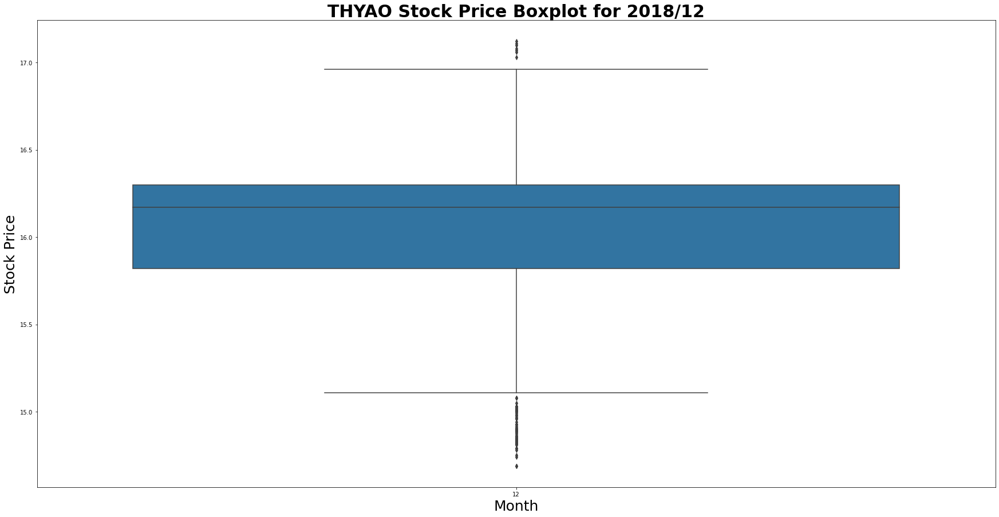

NO OUTLIERS


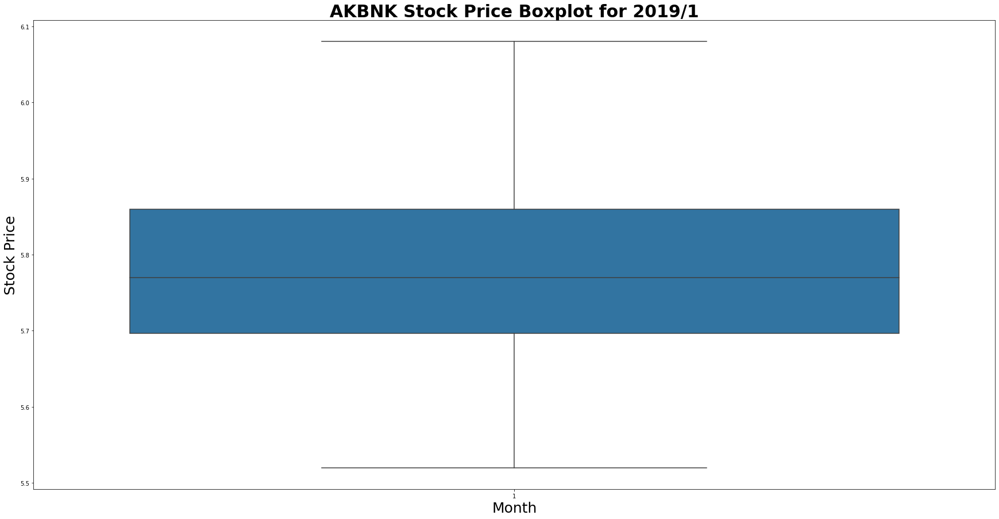

NO OUTLIERS


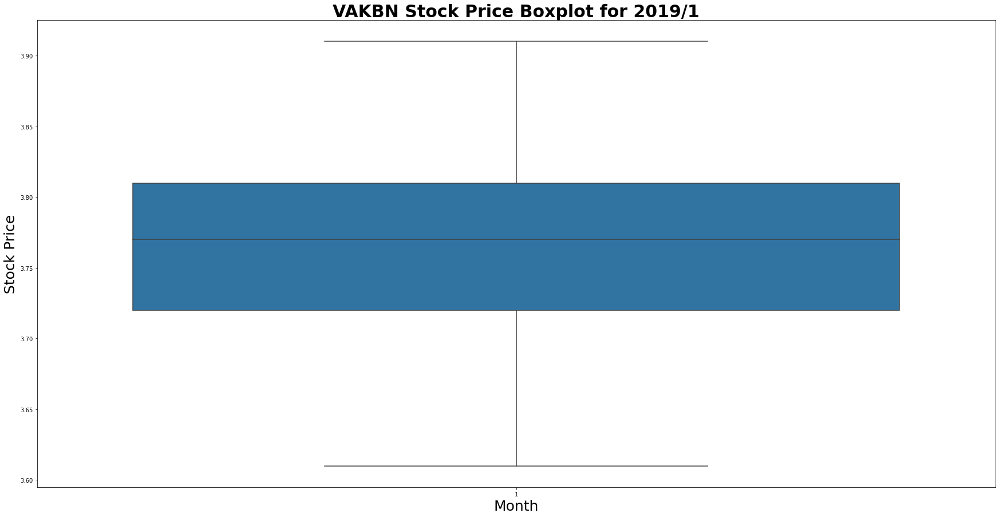

NO OUTLIERS


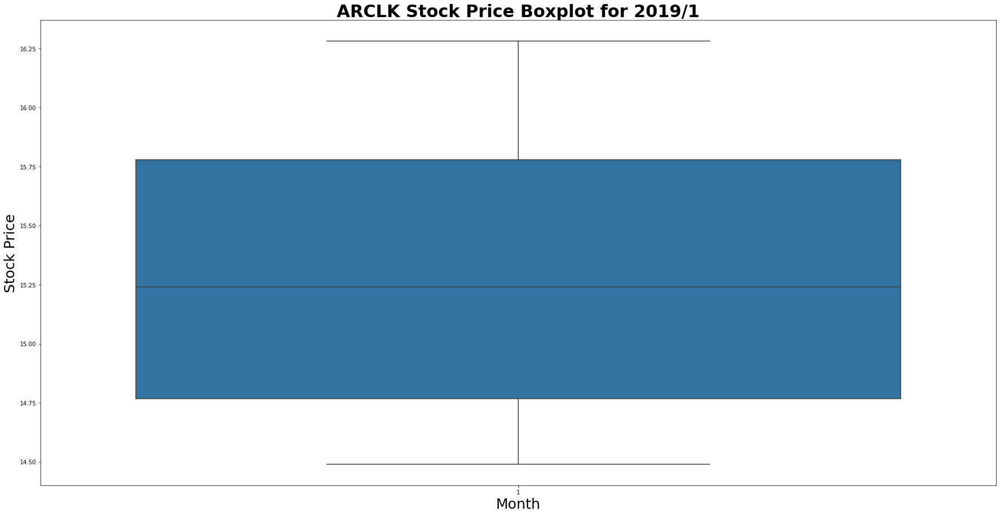

NO OUTLIERS


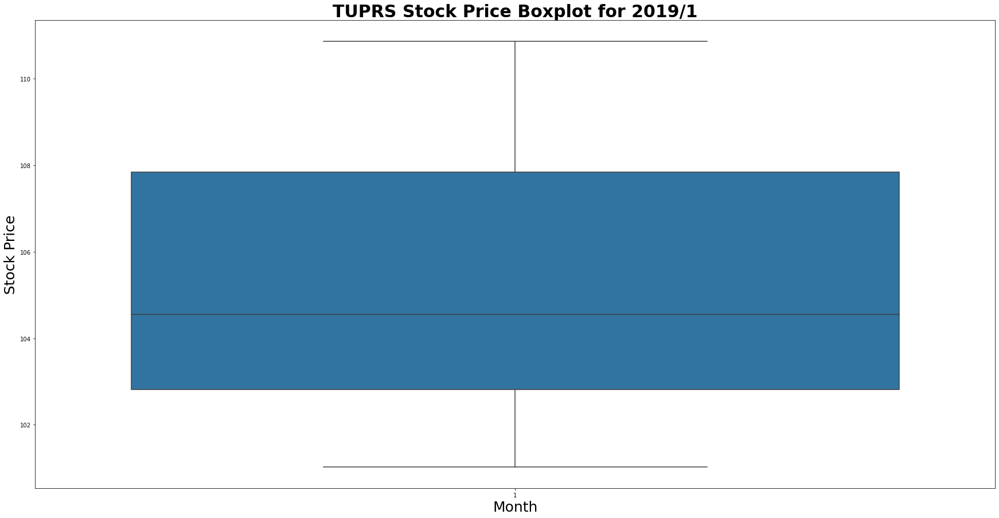

NO OUTLIERS


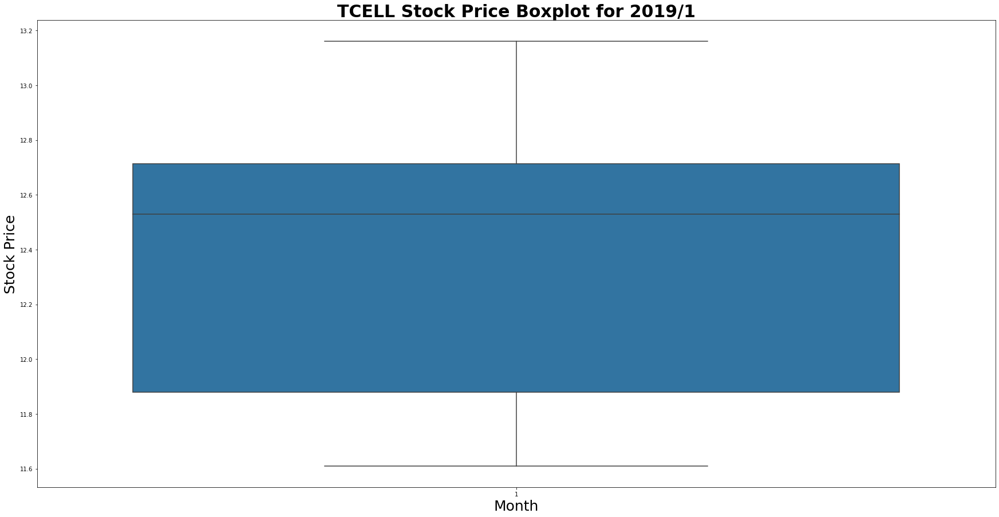

Upper Outliers for THYAO in 2019/1
Timestamp: 2019-01-02 06:45:00+00:00, Price: 16.13
Timestamp: 2019-01-02 07:00:00+00:00, Price: 16.15
Timestamp: 2019-01-02 07:15:00+00:00, Price: 16.17
Timestamp: 2019-01-02 07:30:00+00:00, Price: 16.23
Timestamp: 2019-01-02 07:45:00+00:00, Price: 16.24
Timestamp: 2019-01-02 08:00:00+00:00, Price: 16.15
Timestamp: 2019-01-02 08:15:00+00:00, Price: 16.1
Timestamp: 2019-01-02 08:30:00+00:00, Price: 16.14
Timestamp: 2019-01-02 08:45:00+00:00, Price: 16.12
Timestamp: 2019-01-02 09:00:00+00:00, Price: 16.15
Timestamp: 2019-01-02 09:15:00+00:00, Price: 16.17
Timestamp: 2019-01-02 09:30:00+00:00, Price: 16.04
Timestamp: 2019-01-02 09:45:00+00:00, Price: 16.03
Timestamp: 2019-01-02 10:00:00+00:00, Price: 16.025
Timestamp: 2019-01-02 10:45:00+00:00, Price: 16.02
Timestamp: 2019-01-02 11:00:00+00:00, Price: 15.97
Timestamp: 2019-01-02 11:15:00+00:00, Price: 15.96
Timestamp: 2019-01-02 11:30:00+00:00, Price: 15.93
Timestamp: 2019-01-02 11:45:00+00:00, Price: 15

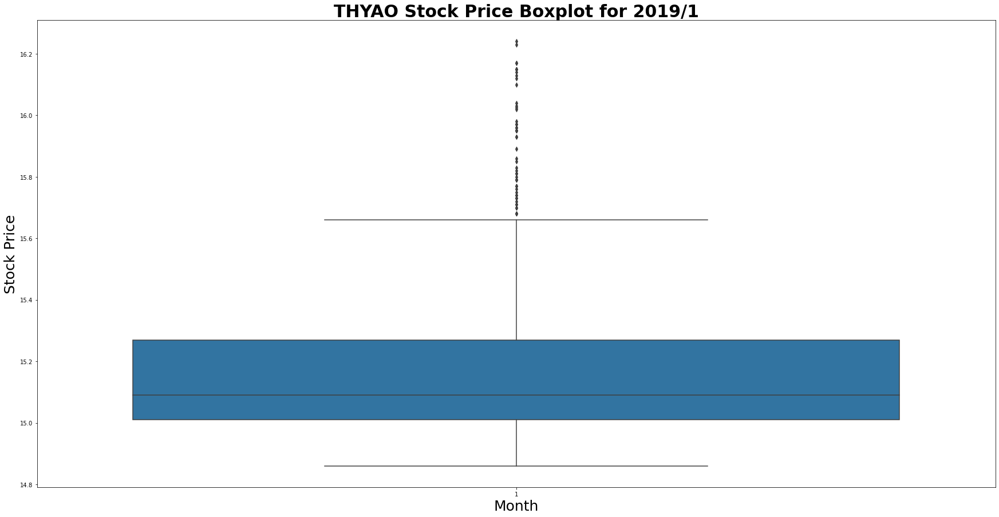

""


In [7]:
# box plot
def plot_box_plot(selected):
    # getting year and month info from df
    year = selected["year"].iloc[0]
    month = selected["month"].iloc[0]
    # looping over stocks
    for index in indexes_selected:
        # initializing the plot, title, x & y axis
        plt.figure(figsize=(30, 15))
        ax = sns.boxplot(data=selected, x='month', y=index)
        plt.title(str(index) + " " + f'Stock Price Boxplot for {year}/{month}', fontsize=30, fontweight='bold')
        plt.xlabel('Month', fontsize=25)
        plt.ylabel('Stock Price', fontsize=25)

        # identifying and marking both upper and lower outliers
        threshold = 1.5  # Adjust this threshold as needed
        upper_outliers = selected[selected[index] > (selected[index].quantile(0.75) + threshold * (selected[index].quantile(0.75) - selected[index].quantile(0.25)))]
        lower_outliers = selected[selected[index] < (selected[index].quantile(0.25) - threshold * (selected[index].quantile(0.75) - selected[index].quantile(0.25)))]
        
        # printing information about the outliers
        if not upper_outliers.empty:
            print('Upper Outliers for ' + str(index) + " in " + str(year) + "/" + str(month))
            for _, row in upper_outliers.iterrows():
                timestamp = row['timestamp']
                price = row[index]
                print(f'Timestamp: {timestamp}, Price: {price}')

        if not lower_outliers.empty:
            print('Lower Outliers for ' + str(index) + " in " + str(year) + "/" + str(month))
            for _, row in lower_outliers.iterrows():
                timestamp = row['timestamp']
                price = row[index]
                print(f'Timestamp: {timestamp}, Price: {price}')
                
        if lower_outliers.empty and upper_outliers.empty:
            print("NO OUTLIERS")

        plt.show()

# group by year, month
grouped = df.groupby(['year', 'month'])

# apply the plot_box_plot function to each group
grouped.apply(plot_box_plot)

# 4. Google Trends

In this part we will use the data we obtained from Google Trends for the stocks that we are interested in and make a line of search volumes and stock prices to identify the causes.

In [17]:
    df_trend = pd.read_csv(f"AKBNK.csv", header=1)

In [18]:
df_trend

,Week,IST:AKBNK: (Türkiye)
0,2017-01-15,0
1,2017-01-22,23
2,2017-01-29,0
3,2017-02-05,25
4,2017-02-12,0
...,...,...
100,2018-12-16,0
101,2018-12-23,0
102,2018-12-30,0
103,2019-01-06,0


In [28]:
get_outliers("VAKBN")

[(Timestamp('2017-02-01 06:45:00+0000', tz='UTC'), 4.8252),
 (Timestamp('2017-02-01 07:45:00+0000', tz='UTC'), 4.8153),
 (Timestamp('2017-02-01 08:15:00+0000', tz='UTC'), 4.8153),
 (Timestamp('2017-02-01 08:30:00+0000', tz='UTC'), 4.8055),
 (Timestamp('2017-03-06 12:15:00+0000', tz='UTC'), 5.4906),
 (Timestamp('2017-03-06 12:30:00+0000', tz='UTC'), 5.5005),
 (Timestamp('2017-03-06 12:45:00+0000', tz='UTC'), 5.5102),
 (Timestamp('2017-03-06 13:00:00+0000', tz='UTC'), 5.5102),
 (Timestamp('2017-03-06 13:15:00+0000', tz='UTC'), 5.52),
 (Timestamp('2017-03-06 13:30:00+0000', tz='UTC'), 5.5102),
 (Timestamp('2017-03-06 13:45:00+0000', tz='UTC'), 5.5102),
 (Timestamp('2017-03-06 15:00:00+0000', tz='UTC'), 5.4906),
 (Timestamp('2017-03-07 06:45:00+0000', tz='UTC'), 5.4906),
 (Timestamp('2017-03-07 07:15:00+0000', tz='UTC'), 5.5005),
 (Timestamp('2017-10-09 07:30:00+0000', tz='UTC'), 5.8462),
 (Timestamp('2017-10-09 07:45:00+0000', tz='UTC'), 5.8462),
 (Timestamp('2017-10-09 08:15:00+0000', tz

In [19]:
# returns outliers obtained from control charts in part 3
def get_outliers(stock_name):
    if stock_name == "AKBNK":
        return outliers_akbnk
    elif stock_name == "VAKBN":
        return outliers_vakbn
    elif stock_name == "ARCLK":
        return outliers_arclk
    elif stock_name == "TUPRS":
        return outliers_tuprs
    elif stock_name == "TCELL":
        return outliers_tcell
    else:
        return outliers_thyao

'''
Below function plots the quarterly trend, stock prices, and outliers 
given the stock name.
'''
def plot_trend(stock_name):
    df_trend = pd.read_csv(f"{stock_name}.csv", header=1)
    df_trend["Week"] = pd.to_datetime(df_trend["Week"])
    
    # start and end dates
    # notice that we observe them quarterly
    # but the outlier data we used is obtained from part 3, therefore monthly
    start = pd.to_datetime("2017-01-15")
    end = start + pd.DateOffset(months=3)
    
    # initialize the figure
    fig, axes = plt.subplots(4, 2, figsize=(22, 22))
    fig.subplots_adjust(hspace=0.5)
    
    # we have 8 quarters (2 years)
    for i in range(8):
        # get the outliers for quarter
        outliers = get_outliers(stock_name)
        outliers_quarter = [i for i in outliers if i[0] >= start.tz_localize('UTC') and i[0] <= end.tz_localize('UTC')]
        outliers_quarter = pd.DataFrame(outliers_quarter, columns=['timestamp', 'value'])
        # copy df
        df = filled_df.copy()
        # filtering with time and adding UTC timezone
        ndf = df[(df['timestamp'] >= start.tz_localize('UTC')) & (df['timestamp'] <= end.tz_localize('UTC'))]
        # filtering the necessary columns 
        df = ndf[['timestamp', 'year', 'month', 'day', stock_name]].copy()
        
        # We must scale both of the df between 0-1 since their scale is very different
        scaler = MinMaxScaler(feature_range=(0, 1))
        df[stock_name] = scaler.fit_transform(df[stock_name].values.reshape(-1, 1))
        # scale outliers
        if len(outliers_quarter) > 0:
            outliers_quarter["value"] = scaler.transform(outliers_quarter["value"].values.reshape(-1, 1))
            
        # filtering df_akbnk with the same timezone
        df_trend_filtered = df_trend[(df_trend['Week'] >= start) & (df_trend['Week'] <= end)]

        # min max scaler 
        scaler = MinMaxScaler(feature_range=(0, 1))
        df_trend_filtered[f"IST:{stock_name}: (Türkiye)"] = scaler.fit_transform(df_trend_filtered[f"IST:{stock_name}: (Türkiye)"].values.reshape(-1, 1))

        row = i // 2
        col = i % 2

        # creating a figure and axis
        ax = axes[row, col]
        # plotting the data from df_akbnk_filtered
        ax.plot(df_trend_filtered["Week"], df_trend_filtered[f"IST:{stock_name}: (Türkiye)"], label="Trend Data", color="green", linewidth=3)

        # plotting the data from df_copy (assuming "timestamp" is your x-axis)
        ax.plot(df["timestamp"], df[stock_name], label="Stock Price", color="orangered")

        # plot outliers as red dots
        if len(outliers_quarter) > 0:
            ax.scatter(outliers_quarter['timestamp'], outliers_quarter['value'], c='red', marker='o', s=100, label='Outliers')

        # x, y axis, title and legend
        ax.set_xlabel(f"Q{i % 4 + 1} {start.year}", fontsize=16)
        ax.set_ylabel("Stock Prices and \nSearch Volume \n(Normalized 0-1)", fontsize=16)
        ax.grid(True)
        ax.set_title(f"{stock_name}\nTrend Data vs. Stock Price", fontsize=18, fontweight="bold")
        ax.legend(loc="upper left")

        # off-setting dates
        start = end
        end = start + relativedelta(months=3)

    plt.show()

## 4.1 IST:AKBNK

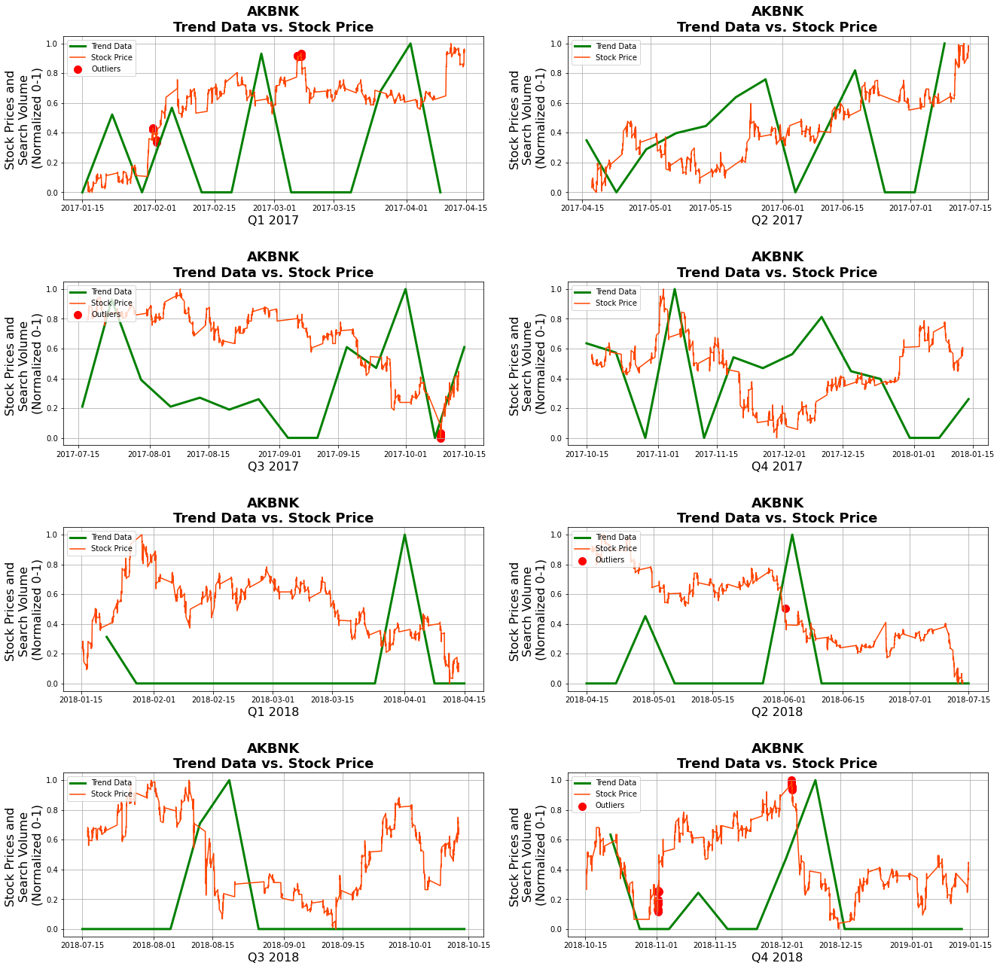

In [20]:
plot_trend("AKBNK")

## 4.2 IST:VAKBN

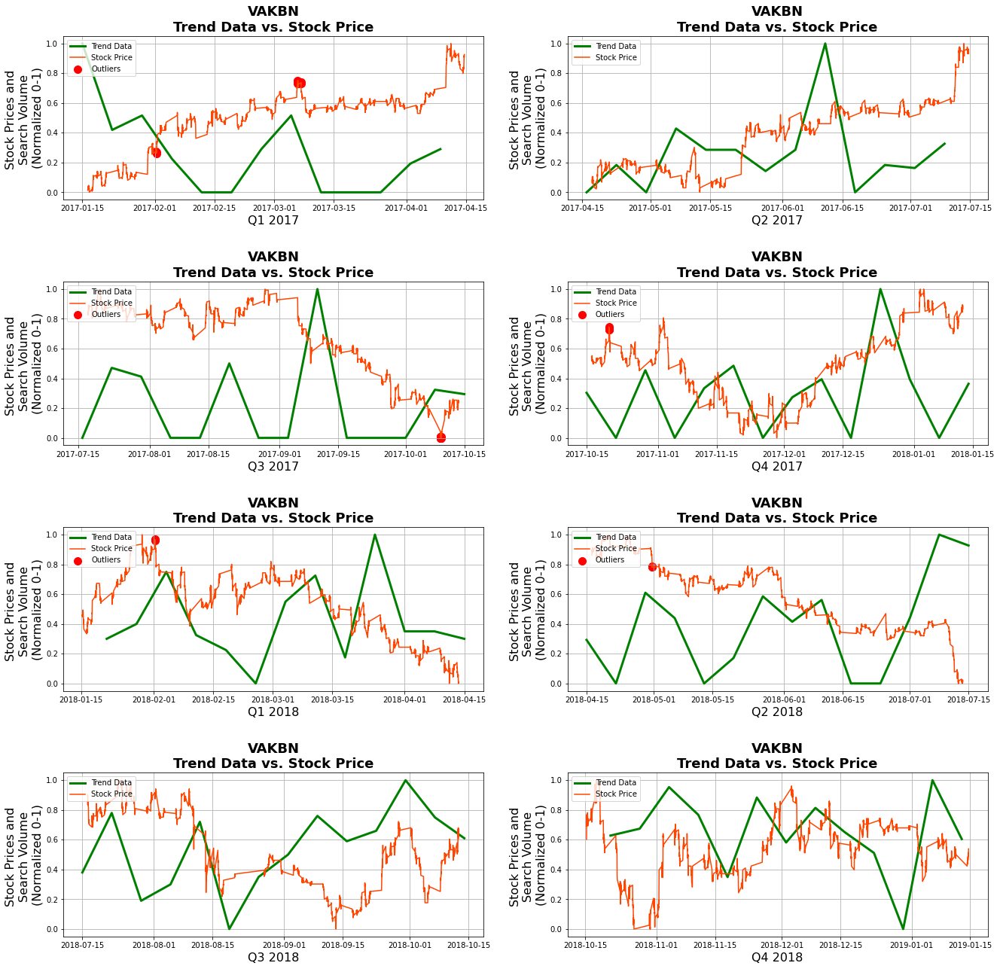

In [21]:
plot_trend("VAKBN")

## 4.3 IST:ARCLK

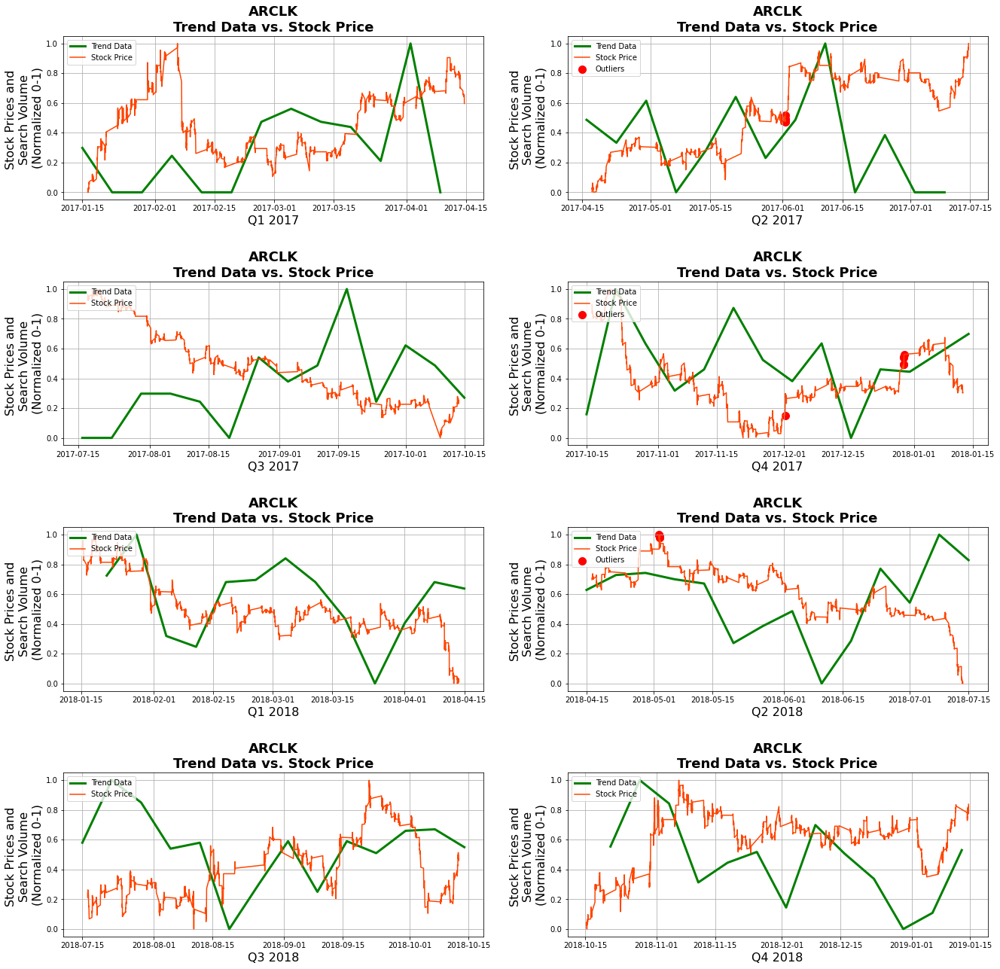

In [22]:
plot_trend("ARCLK")

## 4.4 IST:TUPRS

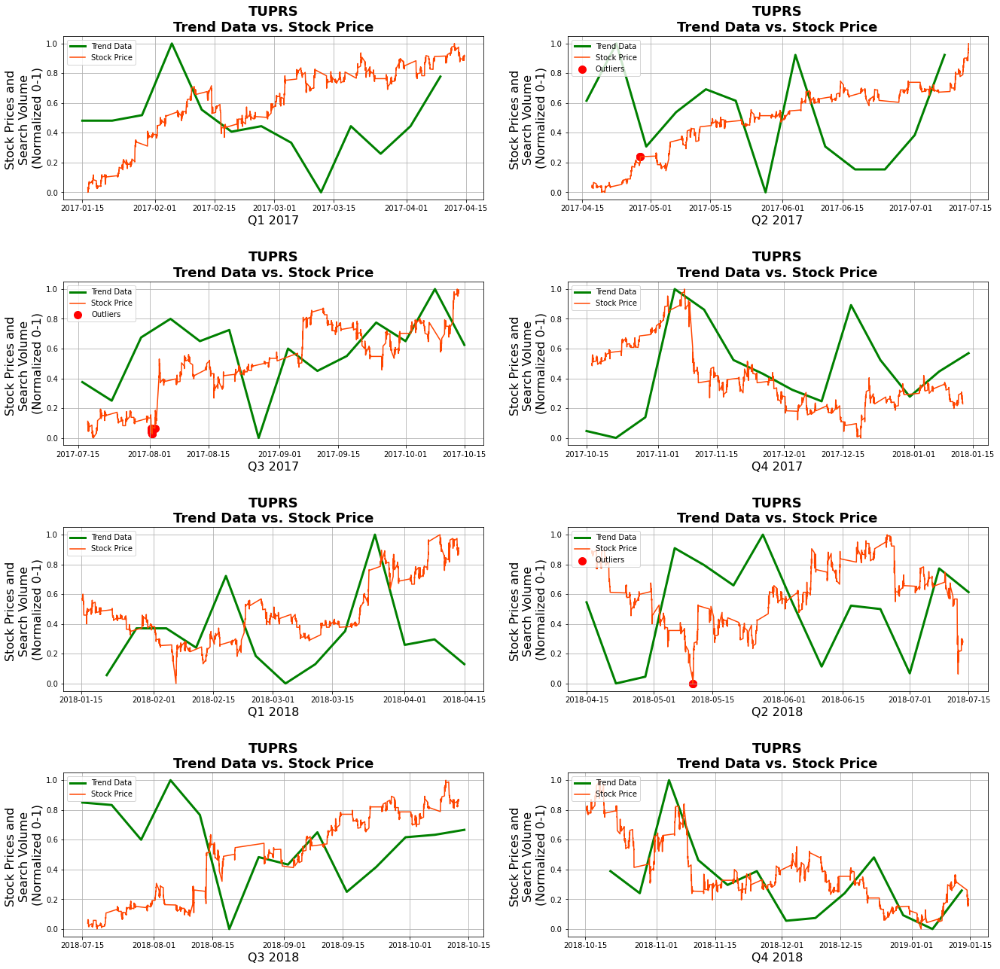

In [23]:
plot_trend("TUPRS")

## 4.5 IST:TCELL

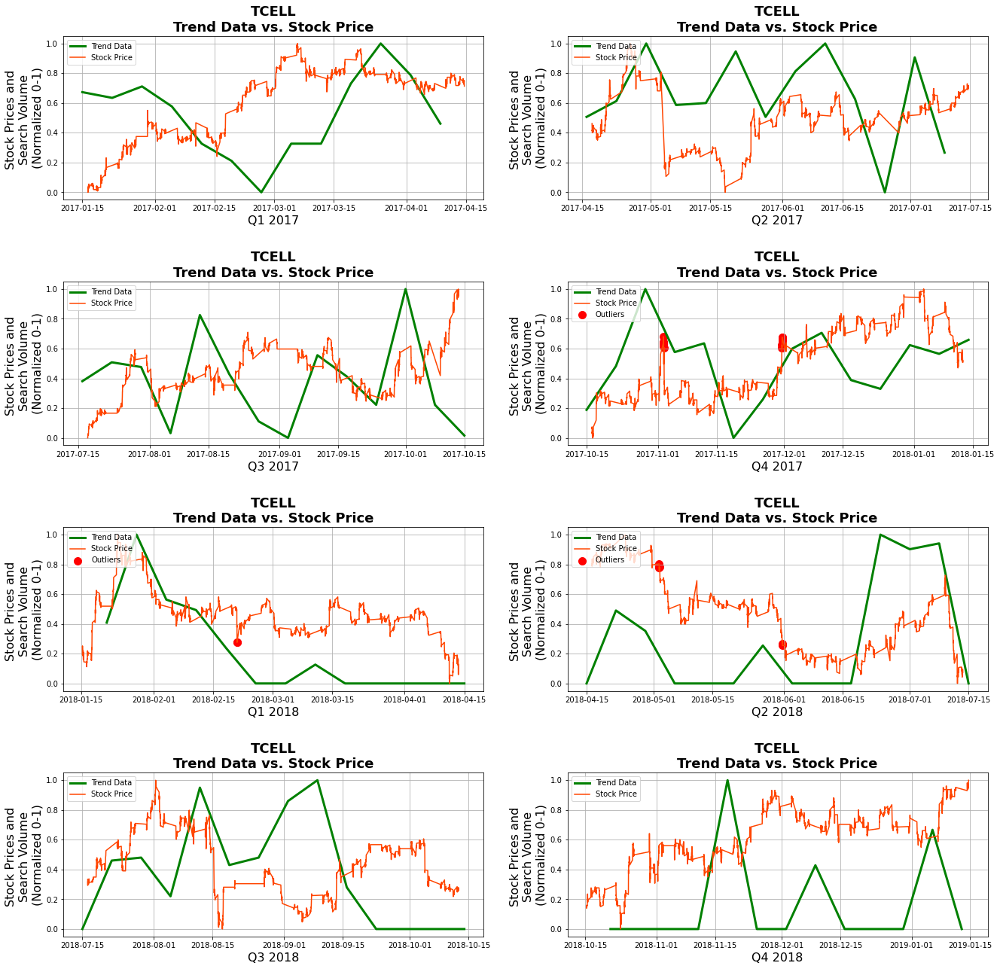

In [24]:
plot_trend("TCELL")

## 4.6 IST:THYAO

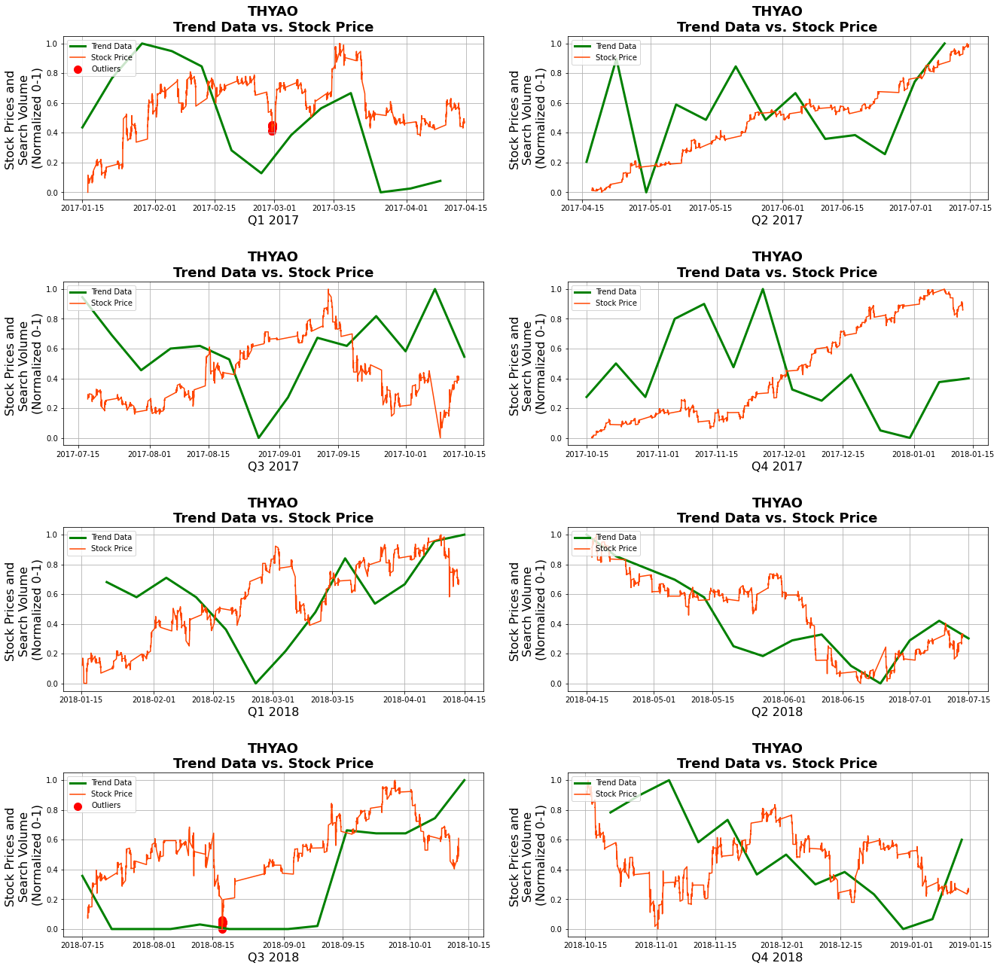

In [25]:
plot_trend("THYAO")

In [29]:
intersection = [value for value in outliers_akbnk if value in outliers_tuprs]
print(intersection)

[]
